<a href="https://colab.research.google.com/github/scespedesa/recherche_segmentation/blob/main/Training_YOLO_different_dataset_size.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!nvidia-smi

/bin/bash: line 1: nvidia-smi: command not found


In [ ]:
!pip install "ultralytics<=8.3.40" supervision

In [ ]:
# ---------------------------------------------
# INSTALLATION OF DEPENDENCIES
# ---------------------------------------------

import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from ultralytics import YOLO
from supervision import Detections
from tqdm import tqdm
from glob import glob
import yaml



Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
base_save_path = "/content/experimentos_dice_final_random"
os.makedirs(base_save_path, exist_ok=True)


In [ ]:
# Storing Dice Scores
dice_all = []

In [ ]:
# VERSIONS TO BE PROCESSED WITH DIFFERENT TRAINING IMAGES
version_ids = list(range(1, 11))
print(version_ids)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10]


In [ ]:
# ---------------------------------------------
# DICE COEFFICIENT
# ---------------------------------------------
def dice_score(true_mask,pred_mask):
  true_mask = (true_mask > 127).astype(np.uint8)
  pred_mask = (pred_mask > 127).astype(np.uint8)

  intersection = np.sum(true_mask * pred_mask)
  total = np.sum(true_mask) + np.sum(pred_mask)

  if total == 0:
      return 1.0  # Si ambas máscaras están vacías, la predicción es perfecta
  return (2. * intersection) / (total + 1e-8)

In [ ]:
# ---------------------------------------------
# MAIN LOOP
# ---------------------------------------------
from ultralytics import YOLO

for version_id in version_ids:
    print(f"\n🔄 Processing version {version_id}...")

    # Dataset path
    dataset_location = f"/content/drive/MyDrive/random_datasets/datasets_1/dataset_v{version_id}"

    # Count how many images are in the training set
    train_count = len(glob(os.path.join(dataset_location, "train", "images", "*")))
    print(f"📦 {train_count} images in training set")

    model = YOLO("yolo11s-seg.pt")

    # Train the model
    model.train(
        project="/content/runs/segment",  # base folder
        name=f"train{version_id}",        # name of the subfolder
        data=f"{dataset_location}/data.yaml",
        epochs=50,
        verbose=True,
        imgsz=320
    )

    # Load the trained model
    model_path = f"/content/runs/segment/train{version_id}/weights/best.pt"
    model = YOLO(model_path)

    # Test directories
    test_images_dir = os.path.join(dataset_location, "test", "images")
    test_labels_dir = os.path.join(dataset_location, "test", "labels")

    # Evaluation
    version_dice = []
    for filename in tqdm(os.listdir(test_images_dir)):
        if not filename.endswith((".jpg", ".png")):
            continue

        image_path = os.path.join(test_images_dir, filename)
        label_path = os.path.join(test_labels_dir, filename.replace(".jpg", ".txt").replace(".png", ".txt"))

        # Predict
        image = Image.open(image_path).convert("RGB")
        results = model.predict(image, conf=0.25)
        result = results[0]
        masks = result.masks.data.cpu().numpy() if result.masks else []

        # Create prediction mask
        pred_mask = np.zeros((image.height, image.width), dtype=np.uint8)
        if masks is not None and len(masks) > 0:
            for mask in masks:
                mask_resized = cv2.resize((mask * 255).astype(np.uint8), (image.width, image.height), interpolation=cv2.INTER_NEAREST)
                pred_mask = np.maximum(pred_mask, mask_resized)

        # Create ground truth mask
        true_mask = np.zeros((image.height, image.width), dtype=np.uint8)
        with open(label_path, "r") as f:
            for line in f:
                parts = list(map(float, line.strip().split()))
                if len(parts) < 7:
                    continue  # invalid polygon

                coords = parts[1:]  # ignore class
                polygon = np.array(coords).reshape(-1, 2)
                polygon[:, 0] *= image.width
                polygon[:, 1] *= image.height
                polygon = polygon.astype(np.int32)

                cv2.fillPoly(true_mask, [polygon], color=255)

        # Calculate DICE score
        score = dice_score(true_mask, pred_mask)
        version_dice.append(score)

        # Log
        print(f"{filename}: DICE = {score:.4f} | true = {np.sum(true_mask)} | pred = {np.sum(pred_mask)}")

        # Save individual result
        dice_all.append({
            "version": version_id,
            "train_images": train_count,
            "image": filename,
            "dice": score
        })

    print(f"✅ Average DICE v{version_id}: {np.mean(version_dice):.4f}")



🔄 Procesando versión 1...
📦 2 imágenes en train
New https://pypi.org/project/ultralytics/8.3.127 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/random_datasets/datasets_1/dataset_v1/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visua

100%|██████████| 755k/755k [00:00<00:00, 23.2MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  3                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  4                  -1  1    103360  ultralytics.nn.modules.block.C3k2            [128, 256, 1, False, 0.25]    
  5                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  6                  -1  1    346112  ultralytics.nn.modules.block.C3k2            [256, 256, 1, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 94.1MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v1/train/labels... 2 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2/2 [00:01<00:00,  1.64it/s]

train: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v1/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v1/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:13<00:00,  1.53it/s]

val: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v1/val/labels.cache


Plotting labels to /content/runs/segment/train1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train1
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/50     0.545G      3.463      5.494      3.529      2.375        297        320: 100%|██████████| 1/1 [00:02<00:00,  2.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.41it/s]

                   all         20       1558     0.0744      0.108      0.041     0.0128     0.0465     0.0679     0.0249    0.00715



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/50     0.409G       3.21      5.487      3.447      2.456        156        320: 100%|██████████| 1/1 [00:00<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.18it/s]

                   all         20       1558     0.0646       0.11     0.0361     0.0122     0.0421     0.0644     0.0226    0.00662



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/50     0.455G      3.302      5.499      3.488      2.401        251        320: 100%|██████████| 1/1 [00:00<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.54it/s]

                   all         20       1558     0.0638      0.109     0.0357     0.0127     0.0533     0.0639      0.028    0.00684



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/50     0.386G      2.974       5.39      3.424      2.369         99        320: 100%|██████████| 1/1 [00:00<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]

                   all         20       1558     0.0514      0.104     0.0292     0.0116     0.0381     0.0633     0.0201    0.00714



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/50     0.434G      3.356      5.646      3.549      2.457        198        320: 100%|██████████| 1/1 [00:00<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]

                   all         20       1558     0.0502      0.103     0.0282     0.0101     0.0415     0.0622     0.0218     0.0069



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/50     0.449G      3.464      5.625      3.559      2.474        274        320: 100%|██████████| 1/1 [00:00<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.97it/s]

                   all         20       1558     0.0636      0.103      0.035     0.0122      0.044     0.0601     0.0232     0.0074



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/50     0.468G       3.33      5.546      3.483      2.264        315        320: 100%|██████████| 1/1 [00:00<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.61it/s]

                   all         20       1558      0.103      0.105     0.0586     0.0254     0.0886     0.0523     0.0471     0.0202



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/50     0.499G      3.356      5.244      3.426      2.415        202        320: 100%|██████████| 1/1 [00:00<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.96it/s]

                   all         20       1558      0.135      0.124     0.0816     0.0345      0.119     0.0768     0.0707     0.0315



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/50     0.499G      3.014      4.939      3.272      2.059        271        320: 100%|██████████| 1/1 [00:00<00:00,  4.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.46it/s]

                   all         20       1558     0.0989      0.165     0.0824     0.0327     0.0797       0.11     0.0686     0.0274



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/50     0.493G      3.037      5.045      3.355      2.487        110        320: 100%|██████████| 1/1 [00:00<00:00,  3.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.91it/s]

                   all         20       1558     0.0823      0.172     0.0767     0.0291     0.0659      0.118     0.0642     0.0258



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/50     0.474G        2.5      4.859      3.028      2.107        106        320: 100%|██████████| 1/1 [00:00<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]

                   all         20       1558      0.124      0.101     0.0732     0.0265      0.128     0.0635     0.0591     0.0231



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/50     0.487G      2.825      4.825      2.905      2.184        141        320: 100%|██████████| 1/1 [00:00<00:00,  4.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.67it/s]

                   all         20       1558      0.113      0.105     0.0705      0.025      0.119     0.0694     0.0558     0.0204



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/50     0.512G      2.968       4.75      2.906      2.309        186        320: 100%|██████████| 1/1 [00:00<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.33it/s]

                   all         20       1558      0.155     0.0873     0.0647     0.0239      0.293      0.068     0.0531     0.0193



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/50     0.516G      2.991      4.623       2.84      2.232        197        320: 100%|██████████| 1/1 [00:00<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.57it/s]

                   all         20       1558      0.201     0.0819     0.0608     0.0216      0.243     0.0659     0.0472     0.0165



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/50     0.535G      3.278      4.713      2.938       2.18        359        320: 100%|██████████| 1/1 [00:00<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.59it/s]

                   all         20       1558     0.0841      0.147      0.059     0.0197      0.182     0.0822     0.0453     0.0154



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/50     0.566G      3.178      4.521      2.631      2.023        364        320: 100%|██████████| 1/1 [00:00<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.22it/s]

                   all         20       1558     0.0823      0.152     0.0633       0.02      0.599     0.0736     0.0526     0.0183



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/50     0.512G      2.881      4.549      2.439       2.17        177        320: 100%|██████████| 1/1 [00:00<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]

                   all         20       1558       0.33     0.0942     0.0678     0.0224       0.61      0.072     0.0573     0.0219



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/50     0.482G      2.926      4.496      2.401      2.213        138        320: 100%|██████████| 1/1 [00:00<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.66it/s]

                   all         20       1558       0.33     0.0942     0.0678     0.0224       0.61      0.072     0.0573     0.0219



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/50     0.596G      2.938      4.354      2.427      1.991        280        320: 100%|██████████| 1/1 [00:00<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.89it/s]

                   all         20       1558      0.091      0.102     0.0757     0.0257      0.612     0.0768     0.0642      0.026



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/50     0.491G      2.615      4.295      2.405      1.959        155        320: 100%|██████████| 1/1 [00:00<00:00,  3.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.00it/s]

                   all         20       1558      0.091      0.102     0.0757     0.0257      0.612     0.0768     0.0642      0.026



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/50     0.577G      3.057      4.451      2.446       2.04        350        320: 100%|██████████| 1/1 [00:00<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.93it/s]

                   all         20       1558      0.262     0.0992     0.0835     0.0283      0.107     0.0918     0.0672     0.0279



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/50     0.524G      2.896      4.403      2.433      2.069        220        320: 100%|██████████| 1/1 [00:00<00:00,  3.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.39it/s]

                   all         20       1558      0.262     0.0992     0.0835     0.0283      0.107     0.0918     0.0672     0.0279



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/50     0.535G      2.667      4.172      2.426      1.932        236        320: 100%|██████████| 1/1 [00:00<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.75it/s]

                   all         20       1558     0.0868       0.18     0.0874     0.0313      0.155      0.109     0.0758     0.0324



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/50     0.524G      2.988      4.336      2.248       1.97        275        320: 100%|██████████| 1/1 [00:00<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.48it/s]

                   all         20       1558     0.0868       0.18     0.0874     0.0313      0.155      0.109     0.0758     0.0324



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/50     0.537G      2.705      4.215      2.062      1.906        190        320: 100%|██████████| 1/1 [00:00<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.15it/s]

                   all         20       1558      0.121      0.157     0.0902      0.033      0.118      0.134     0.0841     0.0375



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/50     0.539G      2.827      4.402      2.183       1.88        302        320: 100%|██████████| 1/1 [00:00<00:00,  7.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]

                   all         20       1558      0.121      0.157     0.0902      0.033      0.118      0.134     0.0841     0.0375



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/50     0.581G       2.86      4.393      2.267      1.886        283        320: 100%|██████████| 1/1 [00:00<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.72it/s]

                   all         20       1558      0.118      0.168     0.0949     0.0347      0.132      0.138      0.091     0.0397



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/50     0.495G      2.655      4.186      2.248      1.999        144        320: 100%|██████████| 1/1 [00:00<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.57it/s]

                   all         20       1558      0.118      0.168     0.0949     0.0347      0.132      0.138      0.091     0.0397



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/50     0.558G      2.879       4.13      2.433      2.032        173        320: 100%|██████████| 1/1 [00:00<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]

                   all         20       1558      0.122      0.155     0.0911     0.0336      0.117      0.155      0.089     0.0389



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/50     0.549G      2.586      4.032      1.919      1.654        368        320: 100%|██████████| 1/1 [00:00<00:00,  5.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.13it/s]

                   all         20       1558      0.122      0.155     0.0911     0.0336      0.117      0.155      0.089     0.0389



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/50     0.558G      2.647       4.17      1.939      1.781        288        320: 100%|██████████| 1/1 [00:00<00:00,  4.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.31it/s]

                   all         20       1558      0.133      0.151     0.0902     0.0347      0.124      0.156     0.0893     0.0383



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/50     0.491G      2.591      4.048      2.076      2.012        131        320: 100%|██████████| 1/1 [00:00<00:00,  5.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.17it/s]

                   all         20       1558      0.133      0.151     0.0902     0.0347      0.124      0.156     0.0893     0.0383



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/50     0.549G      2.668      3.814      1.935      1.915        201        320: 100%|██████████| 1/1 [00:00<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.29it/s]

                   all         20       1558      0.133      0.158     0.0891     0.0349      0.137      0.146     0.0914     0.0377



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/50     0.516G      2.696      4.133       2.02      1.812        247        320: 100%|██████████| 1/1 [00:00<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.15it/s]

                   all         20       1558      0.133      0.158     0.0891     0.0349      0.137      0.146     0.0914     0.0377



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/50     0.535G      2.613      3.959      1.858      1.879        186        320: 100%|██████████| 1/1 [00:00<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.05it/s]

                   all         20       1558       0.13      0.155     0.0907     0.0364      0.145      0.129     0.0859     0.0358



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/50     0.482G      2.505      3.804      1.817      1.899        129        320: 100%|██████████| 1/1 [00:00<00:00,  7.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]

                   all         20       1558       0.13      0.155     0.0907     0.0364      0.145      0.129     0.0859     0.0358



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/50     0.556G      2.378      3.733      1.799      1.744        200        320: 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.49it/s]

                   all         20       1558      0.133       0.15     0.0912     0.0374      0.128      0.136      0.085      0.035



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/50     0.549G      2.538       3.81      1.751      1.778        236        320: 100%|██████████| 1/1 [00:00<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.42it/s]

                   all         20       1558      0.133       0.15     0.0912     0.0374      0.128      0.136      0.085      0.035



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      39/50     0.547G      2.555      3.689      1.957      1.794        190        320: 100%|██████████| 1/1 [00:00<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.82it/s]

                   all         20       1558      0.124      0.178     0.0924     0.0382      0.127      0.139     0.0884     0.0362



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      40/50     0.516G      2.418      3.637      1.758      1.747        236        320: 100%|██████████| 1/1 [00:00<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]

                   all         20       1558      0.124      0.178     0.0924     0.0382      0.127      0.139     0.0884     0.0362


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      41/50     0.516G      2.138      3.192      1.649      1.562        153        320: 100%|██████████| 1/1 [00:00<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.95it/s]

                   all         20       1558      0.134      0.169     0.0954     0.0398      0.127      0.143     0.0919     0.0374



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      42/50      0.48G      2.243      3.289      1.723      1.638        125        320: 100%|██████████| 1/1 [00:00<00:00,  5.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.16it/s]

                   all         20       1558      0.134      0.169     0.0954     0.0398      0.127      0.143     0.0919     0.0374



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      43/50     0.518G      2.534      3.906      1.949      1.887         99        320: 100%|██████████| 1/1 [00:00<00:00,  5.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.25it/s]

                   all         20       1558      0.139      0.165     0.0958       0.04      0.124      0.154     0.0905     0.0377



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      44/50     0.487G      2.383      3.583      1.818      1.829        119        320: 100%|██████████| 1/1 [00:00<00:00,  7.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.50it/s]

                   all         20       1558      0.139      0.165     0.0958       0.04      0.124      0.154     0.0905     0.0377



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      45/50     0.505G      2.175      3.353      1.725      1.594        125        320: 100%|██████████| 1/1 [00:00<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.05it/s]

                   all         20       1558      0.158      0.158     0.0962     0.0395      0.134      0.149     0.0873     0.0372



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      46/50     0.482G      2.287      3.513       1.62      1.653        130        320: 100%|██████████| 1/1 [00:00<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.78it/s]

                   all         20       1558      0.158      0.158     0.0962     0.0395      0.134      0.149     0.0873     0.0372



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      47/50     0.535G      2.225       3.38      1.576      1.664        159        320: 100%|██████████| 1/1 [00:00<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.68it/s]

                   all         20       1558      0.166       0.15     0.0949     0.0384      0.143      0.135     0.0842     0.0359



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      48/50     0.482G      2.335       3.56       1.87      1.707        130        320: 100%|██████████| 1/1 [00:00<00:00,  5.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.93it/s]

                   all         20       1558      0.166       0.15     0.0949     0.0384      0.143      0.135     0.0842     0.0359



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      49/50     0.531G      2.164      3.247      1.674      1.593        161        320: 100%|██████████| 1/1 [00:00<00:00,  5.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]

                   all         20       1558       0.16      0.145     0.0965     0.0389      0.143      0.135     0.0864     0.0363



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      50/50     0.491G      1.928      3.094       1.52       1.43        161        320: 100%|██████████| 1/1 [00:00<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.78it/s]

                   all         20       1558       0.16      0.145     0.0965     0.0389      0.143      0.135     0.0864     0.0363



50 epochs completed in 0.026 hours.
Optimizer stripped from /content/runs/segment/train1/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train1/weights/best.pt, 20.5MB

Validating /content/runs/segment/train1/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.31it/s]


                   all         20       1558      0.141      0.164      0.096     0.0403       0.13      0.152     0.0912     0.0377
                 crack         20        621     0.0694     0.0853     0.0382     0.0129     0.0424     0.0531     0.0271    0.00831
                grains         20        937      0.213      0.243      0.154     0.0677      0.218      0.251      0.155      0.067
Speed: 0.1ms preprocess, 2.4ms inference, 0.0ms loss, 2.8ms postprocess per image
Results saved to /content/runs/segment/train1


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 5 grainss, 14.4ms
Speed: 0.9ms preprocess, 14.4ms inference, 5.7ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:00<00:16,  1.18it/s]

00799.png: DICE = 0.1362 | true = 18591795 | pred = 1585335

0: 320x320 1 crack, 5 grainss, 13.6ms
Speed: 1.1ms preprocess, 13.6ms inference, 3.5ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:01<00:14,  1.28it/s]

00739.png: DICE = 0.3937 | true = 15401745 | pred = 5425380

0: 320x320 4 grainss, 12.6ms
Speed: 1.3ms preprocess, 12.6ms inference, 3.5ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:02<00:12,  1.40it/s]

00705.png: DICE = 0.2553 | true = 14798160 | pred = 3180870

0: 320x320 2 cracks, 3 grainss, 14.2ms
Speed: 1.1ms preprocess, 14.2ms inference, 3.6ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:02<00:10,  1.47it/s]

00747.png: DICE = 0.1377 | true = 15472890 | pred = 1769190

0: 320x320 1 crack, 3 grainss, 12.5ms
Speed: 1.0ms preprocess, 12.5ms inference, 3.1ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:03<00:09,  1.54it/s]

00779.png: DICE = 0.1485 | true = 20113125 | pred = 1738845

0: 320x320 4 grainss, 14.0ms
Speed: 1.4ms preprocess, 14.0ms inference, 3.1ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:04<00:08,  1.60it/s]

00768.png: DICE = 0.2393 | true = 16563270 | pred = 2693310

0: 320x320 11 cracks, 7 grainss, 14.5ms
Speed: 1.1ms preprocess, 14.5ms inference, 4.0ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:04<00:08,  1.54it/s]

00730.png: DICE = 0.2651 | true = 13958445 | pred = 2395725

0: 320x320 3 cracks, 4 grainss, 25.6ms
Speed: 2.7ms preprocess, 25.6ms inference, 3.8ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:05<00:07,  1.55it/s]

00787.png: DICE = 0.1981 | true = 20695545 | pred = 2559945

0: 320x320 4 grainss, 16.0ms
Speed: 1.0ms preprocess, 16.0ms inference, 4.4ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:06<00:07,  1.55it/s]

00764.png: DICE = 0.2954 | true = 16599990 | pred = 3106920

0: 320x320 5 grainss, 17.5ms
Speed: 1.0ms preprocess, 17.5ms inference, 3.8ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:06<00:06,  1.51it/s]

00773.png: DICE = 0.1690 | true = 18700425 | pred = 2010675

0: 320x320 1 crack, 6 grainss, 12.9ms
Speed: 1.1ms preprocess, 12.9ms inference, 3.0ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:07<00:06,  1.29it/s]

00758.png: DICE = 0.2844 | true = 15770475 | pred = 3074535

0: 320x320 5 grainss, 12.8ms
Speed: 1.0ms preprocess, 12.8ms inference, 3.1ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:08<00:06,  1.31it/s]

00794.png: DICE = 0.1280 | true = 19852260 | pred = 1727115

0: 320x320 2 cracks, 2 grainss, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 3.1ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:09<00:05,  1.35it/s]

00719.png: DICE = 0.1313 | true = 13222515 | pred = 1164840

0: 320x320 6 grainss, 15.5ms
Speed: 1.1ms preprocess, 15.5ms inference, 3.9ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:09<00:04,  1.40it/s]

00776.png: DICE = 0.1984 | true = 19565130 | pred = 2531385

0: 320x320 10 cracks, 6 grainss, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 3.8ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:10<00:03,  1.33it/s]

00731.png: DICE = 0.2052 | true = 13928100 | pred = 2044335

0: 320x320 4 grainss, 12.2ms
Speed: 1.3ms preprocess, 12.2ms inference, 2.9ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:11<00:03,  1.30it/s]

00791.png: DICE = 0.0890 | true = 21394500 | pred = 1192890

0: 320x320 4 cracks, 4 grainss, 14.7ms
Speed: 1.4ms preprocess, 14.7ms inference, 3.3ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:12<00:02,  1.37it/s]

00742.png: DICE = 0.2702 | true = 15937500 | pred = 3389970

0: 320x320 2 cracks, 8 grainss, 12.4ms
Speed: 1.0ms preprocess, 12.4ms inference, 3.2ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:12<00:01,  1.47it/s]

00725.png: DICE = 0.2556 | true = 13110825 | pred = 2083860

0: 320x320 1 crack, 3 grainss, 12.7ms
Speed: 1.0ms preprocess, 12.7ms inference, 3.0ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:13<00:00,  1.40it/s]

00745.png: DICE = 0.1465 | true = 16060665 | pred = 1714110

0: 320x320 4 grainss, 14.3ms
Speed: 1.1ms preprocess, 14.3ms inference, 3.4ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:14<00:00,  1.42it/s]

00723.png: DICE = 0.1234 | true = 12770655 | pred = 1350225
✅ Average DICE v1: 0.2035

🔄 Procesando versión 2...


📦 8 imágenes en train
New https://pypi.org/project/ultralytics/8.3.127 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/random_datasets/datasets_1/dataset_v2/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, 

train: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v2/train/labels... 8 images, 0 backgrounds, 0 corrupt: 100%|██████████| 8/8 [00:04<00:00,  1.63it/s]

train: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v2/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v2/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:11<00:00,  1.82it/s]

val: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v2/val/labels.cache


Plotting labels to /content/runs/segment/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train2
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/50      1.39G      2.964      5.303      3.413      2.161        840        320: 100%|██████████| 1/1 [00:00<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.04s/it]

                   all         20       1610     0.0472      0.102      0.027      0.012     0.0338     0.0618     0.0181    0.00724



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/50      1.02G      2.968      5.279      3.412      2.286        615        320: 100%|██████████| 1/1 [00:00<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         20       1610      0.045      0.105     0.0258     0.0119     0.0269     0.0626     0.0146    0.00502



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/50      1.02G       2.94      5.405      3.417       2.17        768        320: 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.30s/it]

                   all         20       1610     0.0674      0.107     0.0379     0.0159     0.0443     0.0649     0.0233    0.00726



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/50      1.02G      2.988      5.318      3.381      2.293        706        320: 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.55it/s]

                   all         20       1610     0.0539      0.106     0.0322     0.0151     0.0371     0.0629     0.0196    0.00711



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/50      1.02G      2.904      5.456      3.389      2.217        830        320: 100%|██████████| 1/1 [00:00<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.55it/s]

                   all         20       1610     0.0578      0.104     0.0342     0.0144     0.0379     0.0634     0.0199    0.00706



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/50      1.04G      2.935      5.275       3.46      2.175        670        320: 100%|██████████| 1/1 [00:00<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]

                   all         20       1610     0.0538        0.1      0.032     0.0131     0.0308     0.0644     0.0164    0.00631



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/50      1.01G      2.951      5.305      3.395      2.194        750        320: 100%|██████████| 1/1 [00:00<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]

                   all         20       1610       0.07      0.106     0.0404     0.0142     0.0479      0.068     0.0252    0.00842



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/50      1.01G       3.04      5.228      3.384      2.214        806        320: 100%|██████████| 1/1 [00:00<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]

                   all         20       1610     0.0675      0.106     0.0372      0.014     0.0589     0.0673     0.0307     0.0101



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/50         1G      2.979      5.451      3.378      2.342        621        320: 100%|██████████| 1/1 [00:00<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]

                   all         20       1610      0.053       0.13     0.0319     0.0132      0.043     0.0959     0.0261     0.0105



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/50      1.09G      2.911      4.969       3.28      2.268        712        320: 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.17it/s]

                   all         20       1610      0.068      0.178     0.0501     0.0211      0.057      0.137     0.0414     0.0157



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/50      1.13G      2.818      4.934       3.17      2.156        664        320: 100%|██████████| 1/1 [00:00<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.44it/s]

                   all         20       1610      0.121     0.0868     0.0592      0.026      0.114     0.0824     0.0553      0.021



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/50      1.08G      2.604      4.792      2.964      2.123        516        320: 100%|██████████| 1/1 [00:00<00:00,  4.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.31it/s]

                   all         20       1610      0.104     0.0737     0.0637     0.0272      0.632     0.0654     0.0606      0.024



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/50      1.06G      2.534      4.621      2.729      1.998        641        320: 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]

                   all         20       1610      0.598     0.0727     0.0648     0.0287      0.618     0.0758     0.0611     0.0255



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/50      1.12G      2.482        4.5      2.641      1.901        889        320: 100%|██████████| 1/1 [00:00<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]

                   all         20       1610      0.556      0.119     0.0538     0.0241      0.552      0.113     0.0577     0.0253



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/50      1.09G      2.458      4.437      2.528      1.914        877        320: 100%|██████████| 1/1 [00:00<00:00,  3.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]

                   all         20       1610      0.224     0.0374     0.0523      0.023      0.248     0.0415     0.0561     0.0244



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/50      1.12G      2.376      4.261      2.301      1.873        809        320: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1610      0.236     0.0395     0.0568     0.0266      0.261     0.0436      0.059     0.0265



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/50       1.1G      2.234      4.155      2.167      1.756        765        320: 100%|██████████| 1/1 [00:00<00:00,  2.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.44it/s]

                   all         20       1610     0.0365       0.18     0.0645     0.0292      0.117     0.0961     0.0668     0.0309



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/50      1.07G      2.312      4.104      2.274      1.836        668        320: 100%|██████████| 1/1 [00:00<00:00,  5.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.44it/s]

                   all         20       1610     0.0365       0.18     0.0645     0.0292      0.117     0.0961     0.0668     0.0309



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/50      1.17G        2.4      4.185      2.251      1.872        842        320: 100%|██████████| 1/1 [00:00<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.49it/s]

                   all         20       1610      0.543      0.177       0.07     0.0322      0.541      0.168     0.0716     0.0334



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/50       1.1G      2.217       4.08      2.105      1.824        577        320: 100%|██████████| 1/1 [00:00<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.49it/s]

                   all         20       1610      0.543      0.177       0.07     0.0322      0.541      0.168     0.0716     0.0334



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/50      1.14G      2.282      4.064      1.987      1.804        764        320: 100%|██████████| 1/1 [00:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]

                   all         20       1610      0.557      0.161      0.105     0.0409      0.557      0.159      0.107     0.0404



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/50      1.06G      2.332      3.959       2.13      1.813        600        320: 100%|██████████| 1/1 [00:00<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.16it/s]

                   all         20       1610      0.557      0.161      0.105     0.0409      0.557      0.159      0.107     0.0404



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/50      1.18G      2.212      3.895       1.92       1.78        614        320: 100%|██████████| 1/1 [00:00<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.29it/s]

                   all         20       1610      0.571      0.163      0.114     0.0454      0.572      0.163      0.105     0.0426



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/50       1.1G      2.232      3.857      1.918      1.731        707        320: 100%|██████████| 1/1 [00:00<00:00,  5.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.39it/s]

                   all         20       1610      0.571      0.163      0.114     0.0454      0.572      0.163      0.105     0.0426



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/50      1.14G      2.217      3.935      1.941      1.789        470        320: 100%|██████████| 1/1 [00:00<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

                   all         20       1610        0.6      0.164      0.155     0.0691      0.603      0.169      0.136     0.0589



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/50      1.12G      2.207      3.785      1.752      1.673        851        320: 100%|██████████| 1/1 [00:00<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.51it/s]

                   all         20       1610        0.6      0.164      0.155     0.0691      0.603      0.169      0.136     0.0589



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/50      1.12G      2.033      3.612      1.756      1.593        692        320: 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]

                   all         20       1610      0.608      0.178       0.16     0.0747      0.612      0.185       0.14     0.0606



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/50      1.11G      2.182      3.629       1.74      1.649        862        320: 100%|██████████| 1/1 [00:00<00:00,  4.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.77it/s]

                   all         20       1610      0.608      0.178       0.16     0.0747      0.612      0.185       0.14     0.0606



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/50      1.16G      2.232      3.768      1.976      1.764        518        320: 100%|██████████| 1/1 [00:00<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.03it/s]

                   all         20       1610      0.316      0.172      0.178     0.0835      0.147      0.183      0.183     0.0801



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/50       1.1G      2.063      3.469      1.619      1.601        813        320: 100%|██████████| 1/1 [00:00<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.54it/s]

                   all         20       1610      0.316      0.172      0.178     0.0835      0.147      0.183      0.183     0.0801



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/50      1.14G      2.002      3.446      1.601      1.553        721        320: 100%|██████████| 1/1 [00:00<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]

                   all         20       1610      0.372       0.17      0.191     0.0886      0.257      0.191      0.214     0.0907



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/50      1.07G       2.02      3.415      1.668      1.614        620        320: 100%|██████████| 1/1 [00:00<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.35it/s]

                   all         20       1610      0.372       0.17      0.191     0.0886      0.257      0.191      0.214     0.0907



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/50      1.12G       2.08      3.428      1.754      1.647        568        320: 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.15s/it]

                   all         20       1610      0.338      0.178      0.195     0.0939      0.432      0.201       0.21     0.0955



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/50      1.11G      2.026      3.278      1.528      1.562        622        320: 100%|██████████| 1/1 [00:00<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.41it/s]

                   all         20       1610      0.338      0.178      0.195     0.0939      0.432      0.201       0.21     0.0955



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/50      1.18G      2.002      3.411      1.548      1.565        757        320: 100%|██████████| 1/1 [00:00<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]

                   all         20       1610      0.322      0.225      0.192      0.094      0.367      0.235      0.218     0.0993



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/50      1.06G      2.023      3.263      1.553      1.542        676        320: 100%|██████████| 1/1 [00:00<00:00,  4.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.36it/s]

                   all         20       1610      0.322      0.225      0.192      0.094      0.367      0.235      0.218     0.0993



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/50      1.12G      1.872      3.205      1.477       1.51        685        320: 100%|██████████| 1/1 [00:00<00:00,  3.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]

                   all         20       1610      0.318      0.249      0.197     0.0957      0.351      0.266      0.221      0.101



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/50      1.11G       1.86      3.094      1.503       1.54        553        320: 100%|██████████| 1/1 [00:00<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.22it/s]

                   all         20       1610      0.318      0.249      0.197     0.0957      0.351      0.266      0.221      0.101



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      39/50      1.19G      1.991      3.314      1.546      1.536        957        320: 100%|██████████| 1/1 [00:00<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1610      0.311      0.266        0.2     0.0973      0.372      0.283      0.231      0.105



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      40/50       1.1G      1.929      3.299      1.502      1.521        562        320: 100%|██████████| 1/1 [00:00<00:00,  3.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.36it/s]

                   all         20       1610      0.311      0.266        0.2     0.0973      0.372      0.283      0.231      0.105


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      41/50       1.1G      1.637       2.75      1.308      1.343        473        320: 100%|██████████| 1/1 [00:01<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         20       1610      0.301      0.268      0.205     0.0998      0.359      0.291      0.237       0.11



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      42/50      1.05G      1.653      2.768      1.362        1.4        410        320: 100%|██████████| 1/1 [00:00<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.36it/s]

                   all         20       1610      0.301      0.268      0.205     0.0998      0.359      0.291      0.237       0.11



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      43/50      1.11G       1.66      2.624      1.332      1.374        446        320: 100%|██████████| 1/1 [00:00<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.10it/s]

                   all         20       1610      0.276        0.3      0.212      0.104      0.329      0.313       0.25      0.115



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      44/50      1.05G      1.591      2.763      1.329       1.37        444        320: 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.39it/s]

                   all         20       1610      0.276        0.3      0.212      0.104      0.329      0.313       0.25      0.115



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      45/50      1.09G      1.687      2.794      1.346       1.39        440        320: 100%|██████████| 1/1 [00:00<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.16it/s]

                   all         20       1610      0.305      0.276       0.22      0.109      0.352      0.296      0.257       0.12



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      46/50      1.07G      1.544      2.537      1.217      1.261        511        320: 100%|██████████| 1/1 [00:00<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.37it/s]

                   all         20       1610      0.305      0.276       0.22      0.109      0.352      0.296      0.257       0.12



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      47/50      1.09G      1.551      2.641      1.264      1.352        432        320: 100%|██████████| 1/1 [00:00<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.18it/s]

                   all         20       1610      0.332      0.277      0.234      0.115      0.332      0.322      0.263      0.125



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      48/50      1.09G      1.543       2.48      1.257      1.303        482        320: 100%|██████████| 1/1 [00:00<00:00,  3.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.10it/s]

                   all         20       1610      0.332      0.277      0.234      0.115      0.332      0.322      0.263      0.125



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      49/50      1.12G      1.561      2.595      1.221      1.293        474        320: 100%|██████████| 1/1 [00:00<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.57it/s]

                   all         20       1610      0.355      0.279      0.241       0.12      0.361      0.313      0.271      0.129



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      50/50      1.06G      1.597      2.555      1.222      1.315        459        320: 100%|██████████| 1/1 [00:00<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.56it/s]

                   all         20       1610      0.355      0.279      0.241       0.12      0.361      0.313      0.271      0.129



50 epochs completed in 0.040 hours.
Optimizer stripped from /content/runs/segment/train2/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train2/weights/best.pt, 20.5MB

Validating /content/runs/segment/train2/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]


                   all         20       1610      0.353       0.28      0.241       0.12      0.359      0.316      0.271      0.129
                 crack         20        647      0.299      0.148      0.138     0.0592      0.296      0.165      0.152     0.0616
                grains         20        963      0.408      0.411      0.344      0.181      0.421      0.466      0.389      0.196
Speed: 0.1ms preprocess, 2.4ms inference, 0.0ms loss, 3.0ms postprocess per image
Results saved to /content/runs/segment/train2


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 25 cracks, 62 grainss, 11.3ms
Speed: 0.7ms preprocess, 11.3ms inference, 10.0ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:00<00:15,  1.20it/s]

00736.png: DICE = 0.7627 | true = 15002415 | pred = 12465930

0: 320x320 30 cracks, 64 grainss, 14.7ms
Speed: 1.1ms preprocess, 14.7ms inference, 9.8ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:01<00:12,  1.43it/s]

00737.png: DICE = 0.7800 | true = 14660205 | pred = 13123065

0: 320x320 28 cracks, 71 grainss, 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 20.5ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:02<00:10,  1.56it/s]

00738.png: DICE = 0.7793 | true = 15404805 | pred = 12993015

0: 320x320 23 cracks, 60 grainss, 15.6ms
Speed: 1.1ms preprocess, 15.6ms inference, 9.3ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:02<00:09,  1.62it/s]

00733.png: DICE = 0.7730 | true = 13885770 | pred = 12191295

0: 320x320 15 cracks, 61 grainss, 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 13.0ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:03<00:09,  1.53it/s]

00714.png: DICE = 0.7414 | true = 14578350 | pred = 11284515

0: 320x320 17 cracks, 62 grainss, 15.6ms
Speed: 1.1ms preprocess, 15.6ms inference, 8.8ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:04<00:09,  1.41it/s]

00715.png: DICE = 0.7653 | true = 14547495 | pred = 11585670

0: 320x320 17 cracks, 47 grainss, 14.2ms
Speed: 1.5ms preprocess, 14.2ms inference, 7.3ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:04<00:09,  1.35it/s]

00788.png: DICE = 0.8842 | true = 21740790 | pred = 20077680

0: 320x320 23 cracks, 53 grainss, 15.4ms
Speed: 1.2ms preprocess, 15.4ms inference, 11.0ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:05<00:08,  1.48it/s]

00744.png: DICE = 0.7708 | true = 15902055 | pred = 13047585

0: 320x320 17 cracks, 56 grainss, 15.5ms
Speed: 1.2ms preprocess, 15.5ms inference, 8.3ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:06<00:07,  1.56it/s]

00766.png: DICE = 0.8592 | true = 16570665 | pred = 16363605

0: 320x320 20 cracks, 51 grainss, 15.9ms
Speed: 1.1ms preprocess, 15.9ms inference, 7.8ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:06<00:06,  1.54it/s]

00717.png: DICE = 0.7341 | true = 13657545 | pred = 10527930

0: 320x320 14 cracks, 43 grainss, 16.9ms
Speed: 1.2ms preprocess, 16.9ms inference, 8.1ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:07<00:05,  1.65it/s]

00784.png: DICE = 0.8746 | true = 20982930 | pred = 18948030

0: 320x320 17 cracks, 52 grainss, 14.4ms
Speed: 1.1ms preprocess, 14.4ms inference, 7.7ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:07<00:05,  1.56it/s]

00770.png: DICE = 0.8529 | true = 17320875 | pred = 17019210

0: 320x320 14 cracks, 47 grainss, 16.2ms
Speed: 3.2ms preprocess, 16.2ms inference, 7.2ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:08<00:04,  1.56it/s]

00778.png: DICE = 0.9114 | true = 19871895 | pred = 19829565

0: 320x320 22 cracks, 66 grainss, 12.9ms
Speed: 1.1ms preprocess, 12.9ms inference, 9.0ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:09<00:03,  1.66it/s]

00751.png: DICE = 0.8176 | true = 14727780 | pred = 14059935

0: 320x320 16 cracks, 60 grainss, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 8.1ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:09<00:02,  1.69it/s]

00725.png: DICE = 0.7225 | true = 13110825 | pred = 9918990

0: 320x320 29 cracks, 65 grainss, 13.6ms
Speed: 1.7ms preprocess, 13.6ms inference, 9.3ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:10<00:02,  1.75it/s]

00742.png: DICE = 0.7829 | true = 15937500 | pred = 13352055

0: 320x320 12 cracks, 49 grainss, 14.8ms
Speed: 1.1ms preprocess, 14.8ms inference, 7.0ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:10<00:01,  1.79it/s]

00773.png: DICE = 0.8649 | true = 18700425 | pred = 17220915

0: 320x320 13 cracks, 42 grainss, 12.3ms
Speed: 1.0ms preprocess, 12.3ms inference, 8.8ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:11<00:01,  1.85it/s]

00768.png: DICE = 0.8578 | true = 16563270 | pred = 16506405

0: 320x320 24 cracks, 65 grainss, 13.2ms
Speed: 1.1ms preprocess, 13.2ms inference, 9.0ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:11<00:00,  1.83it/s]

00731.png: DICE = 0.7727 | true = 13928100 | pred = 11783550

0: 320x320 10 cracks, 59 grainss, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 8.8ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:12<00:00,  1.61it/s]

00797.png: DICE = 0.8592 | true = 19064820 | pred = 18465315
✅ Average DICE v2: 0.8083

🔄 Procesando versión 3...


📦 14 imágenes en train
New https://pypi.org/project/ultralytics/8.3.127 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/random_datasets/datasets_1/dataset_v3/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False,

train: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v3/train/labels... 14 images, 0 backgrounds, 0 corrupt: 100%|██████████| 14/14 [00:06<00:00,  2.04it/s]

train: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v3/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v3/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:09<00:00,  2.02it/s]

val: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v3/val/labels.cache


Plotting labels to /content/runs/segment/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train3
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/50      1.94G      2.923      5.438      3.442      2.169       1350        320: 100%|██████████| 1/1 [00:01<00:00,  1.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.20s/it]

                   all         20       1481       0.06      0.117     0.0338     0.0104     0.0313     0.0727     0.0173    0.00514



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/50      1.61G      3.057      5.246      3.447      2.356       1134        320: 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]

                   all         20       1481     0.0389      0.115     0.0233    0.00756     0.0278     0.0718     0.0154    0.00534



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/50      1.64G      3.133      5.292      3.434      2.295       1722        320: 100%|██████████| 1/1 [00:00<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]

                   all         20       1481     0.0531      0.118     0.0306    0.00771     0.0369     0.0738     0.0201     0.0054



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/50      1.61G      2.977      5.221      3.389      2.192       1406        320: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]

                   all         20       1481     0.0404      0.118     0.0238    0.00751     0.0242     0.0709     0.0134    0.00439



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/50      1.63G       3.06      5.402       3.43      2.313       1354        320: 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]

                   all         20       1481      0.048      0.117     0.0274    0.00757     0.0331     0.0711     0.0179    0.00517



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/50      1.59G      3.118      5.316      3.379      2.275       1467        320: 100%|██████████| 1/1 [00:00<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]

                   all         20       1481     0.0592      0.117      0.033    0.00954     0.0403     0.0695     0.0215    0.00646



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/50      1.58G       3.11      5.345      3.397       2.28       1288        320: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.00s/it]

                   all         20       1481     0.0655      0.116      0.036     0.0108     0.0476     0.0706     0.0255    0.00805



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/50      1.62G      3.134      5.457      3.469        2.3       1469        320: 100%|██████████| 1/1 [00:00<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]

                   all         20       1481      0.061      0.117     0.0338    0.00997     0.0442     0.0715     0.0237    0.00768



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/50      1.68G      3.072      5.348      3.395      2.219       1712        320: 100%|██████████| 1/1 [00:00<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.06it/s]

                   all         20       1481     0.0594      0.113     0.0329     0.0107     0.0471     0.0694     0.0249    0.00888



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/50      1.67G      3.128      5.387      3.424      2.328       1584        320: 100%|██████████| 1/1 [00:00<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.74it/s]

                   all         20       1481     0.0852      0.158      0.056     0.0246     0.0748      0.106     0.0488     0.0208



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/50       1.7G      2.992      4.967      3.335      2.265       1472        320: 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]

                   all         20       1481     0.0606      0.153      0.056     0.0244      0.101     0.0628     0.0495     0.0199



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/50      1.61G      2.859        4.8      3.109      2.191       1116        320: 100%|██████████| 1/1 [00:00<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.11s/it]

                   all         20       1481      0.138     0.0786     0.0701     0.0311      0.137     0.0686     0.0611     0.0272



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/50      1.64G      2.617      4.645      2.938      2.022       1216        320: 100%|██████████| 1/1 [00:00<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]

                   all         20       1481      0.604     0.0812     0.0766     0.0356      0.611     0.0937     0.0698     0.0318



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/50      1.76G      2.696      4.508       2.82       2.06       1450        320: 100%|██████████| 1/1 [00:00<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.41it/s]

                   all         20       1481       0.57      0.139     0.0629     0.0296      0.573      0.143     0.0688     0.0331



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/50      1.68G       2.54      4.383      2.565      1.966       1210        320: 100%|██████████| 1/1 [00:00<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]

                   all         20       1481     0.0594      0.169     0.0648     0.0294       0.11      0.126     0.0716     0.0327



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/50      1.76G      2.552      4.376      2.408      1.916       1675        320: 100%|██████████| 1/1 [00:00<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]

                   all         20       1481      0.229     0.0561     0.0732     0.0347      0.244     0.0599     0.0781     0.0358



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/50      1.74G      2.661      4.358      2.524      1.968       1264        320: 100%|██████████| 1/1 [00:00<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.01s/it]

                   all         20       1481       0.55      0.203     0.0828     0.0385      0.586       0.17     0.0899      0.042



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/50       1.7G      2.442      4.058      2.179      1.838       1427        320: 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]

                   all         20       1481       0.55      0.203     0.0828     0.0385      0.586       0.17     0.0899      0.042



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/50      1.67G      2.484      4.232      2.272      1.882        996        320: 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.29it/s]

                   all         20       1481      0.565      0.194      0.164     0.0752      0.566      0.197      0.119     0.0473



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/50      1.67G      2.504      4.102      2.128      1.806       1350        320: 100%|██████████| 1/1 [00:00<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]

                   all         20       1481      0.565      0.194      0.164     0.0752      0.566      0.197      0.119     0.0473



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/50      1.75G      2.523      4.154      2.058      1.806       1564        320: 100%|██████████| 1/1 [00:00<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]

                   all         20       1481      0.321      0.174      0.132     0.0554      0.323      0.178     0.0936     0.0421



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/50      1.61G      2.381      4.056      2.057      1.829        909        320: 100%|██████████| 1/1 [00:00<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.23s/it]

                   all         20       1481      0.321      0.174      0.132     0.0554      0.323      0.178     0.0936     0.0421



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/50       1.8G      2.528      4.147      2.082      1.777       1750        320: 100%|██████████| 1/1 [00:00<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]

                   all         20       1481      0.254      0.204      0.141     0.0571     0.0741      0.202      0.108     0.0434



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/50      1.75G      2.385      3.978      1.972        1.7       1591        320: 100%|██████████| 1/1 [00:00<00:00,  3.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.52it/s]

                   all         20       1481      0.254      0.204      0.141     0.0571     0.0741      0.202      0.108     0.0434



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/50      1.77G      2.391      3.904      1.912      1.699       1581        320: 100%|██████████| 1/1 [00:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.45it/s]

                   all         20       1481      0.284      0.243      0.172     0.0749      0.209      0.242      0.158     0.0633



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/50      1.68G      2.364      3.863      1.863      1.691       1338        320: 100%|██████████| 1/1 [00:00<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.47it/s]

                   all         20       1481      0.284      0.243      0.172     0.0749      0.209      0.242      0.158     0.0633



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/50      1.81G      2.462      3.863       1.89      1.701       1781        320: 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.04it/s]

                   all         20       1481      0.254      0.262      0.232     0.0996      0.256      0.269      0.202     0.0922



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/50      1.73G      2.298      3.742      1.797      1.664       1465        320: 100%|██████████| 1/1 [00:00<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.99it/s]

                   all         20       1481      0.254      0.262      0.232     0.0996      0.256      0.269      0.202     0.0922



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/50      1.81G      2.265      3.612      1.736      1.631       1756        320: 100%|██████████| 1/1 [00:00<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]

                   all         20       1481      0.249      0.271      0.294       0.16      0.251      0.278      0.259      0.126



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/50      1.73G      2.159      3.484       1.62      1.586       1384        320: 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]

                   all         20       1481      0.249      0.271      0.294       0.16      0.251      0.278      0.259      0.126



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/50       1.8G      2.266      3.624       1.74      1.636       1621        320: 100%|██████████| 1/1 [00:00<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.39it/s]

                   all         20       1481      0.592      0.267      0.288       0.12      0.594      0.271      0.293      0.123



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/50      1.74G      2.228      3.497      1.679      1.634       1559        320: 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.02it/s]

                   all         20       1481      0.592      0.267      0.288       0.12      0.594      0.271      0.293      0.123



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/50      1.79G      2.163      3.528      1.604      1.587       1639        320: 100%|██████████| 1/1 [00:00<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.22it/s]

                   all         20       1481      0.637      0.241       0.31      0.136      0.643      0.252      0.303      0.128



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/50      1.65G      2.033      3.314      1.564      1.558       1177        320: 100%|██████████| 1/1 [00:00<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.38it/s]

                   all         20       1481      0.637      0.241       0.31      0.136      0.643      0.252      0.303      0.128



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/50      1.72G      2.102      3.343      1.588      1.586       1243        320: 100%|██████████| 1/1 [00:00<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.33it/s]

                   all         20       1481      0.602      0.228      0.285      0.132      0.607      0.243       0.28      0.121



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/50      1.74G      2.183      3.414      1.585      1.614       1550        320: 100%|██████████| 1/1 [00:00<00:00,  3.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.22it/s]

                   all         20       1481      0.602      0.228      0.285      0.132      0.607      0.243       0.28      0.121



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/50      1.77G       2.15      3.327      1.574       1.55       1636        320: 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.21it/s]

                   all         20       1481      0.497      0.234      0.243      0.115      0.514      0.243      0.247      0.112



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/50      1.67G      1.988      3.205      1.512      1.511       1203        320: 100%|██████████| 1/1 [00:00<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.31it/s]

                   all         20       1481      0.497      0.234      0.243      0.115      0.514      0.243      0.247      0.112



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      39/50      1.67G      2.006      3.231      1.564      1.547       1083        320: 100%|██████████| 1/1 [00:00<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]

                   all         20       1481      0.427      0.255      0.244      0.116      0.422      0.255      0.246      0.114



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      40/50      1.71G      1.999       3.13      1.467      1.511       1314        320: 100%|██████████| 1/1 [00:00<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.47it/s]

                   all         20       1481      0.427      0.255      0.244      0.116      0.422      0.255      0.246      0.114


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      41/50      1.66G       1.84       2.84      1.453      1.404        950        320: 100%|██████████| 1/1 [00:03<00:00,  3.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.42s/it]

                   all         20       1481      0.323      0.311      0.238      0.113      0.346      0.274       0.24      0.113



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      42/50      1.65G      1.846      2.897      1.434      1.443        849        320: 100%|██████████| 1/1 [00:00<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.23it/s]

                   all         20       1481      0.323      0.311      0.238      0.113      0.346      0.274       0.24      0.113



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      43/50      1.71G       1.89      2.922      1.491      1.398        905        320: 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

                   all         20       1481      0.312        0.3      0.238      0.116      0.342      0.285      0.249      0.118



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      44/50      1.69G      1.754      2.761      1.357      1.364        924        320: 100%|██████████| 1/1 [00:00<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

                   all         20       1481      0.312        0.3      0.238      0.116      0.342      0.285      0.249      0.118



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      45/50      1.66G      1.847      2.818      1.429      1.457        836        320: 100%|██████████| 1/1 [00:00<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1481      0.323      0.305      0.246      0.119      0.334      0.305      0.258      0.124



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      46/50      1.64G      1.738      2.615      1.336      1.369        886        320: 100%|██████████| 1/1 [00:00<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.08s/it]

                   all         20       1481      0.323      0.305      0.246      0.119      0.334      0.305      0.258      0.124



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      47/50      1.67G      1.692       2.74      1.337      1.319        938        320: 100%|██████████| 1/1 [00:00<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.32it/s]

                   all         20       1481      0.339      0.311      0.255      0.125      0.356      0.321      0.269      0.128



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      48/50      1.61G      1.692      2.585      1.299      1.363        924        320: 100%|██████████| 1/1 [00:00<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.00it/s]

                   all         20       1481      0.339      0.311      0.255      0.125      0.356      0.321      0.269      0.128



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      49/50      1.67G      1.716      2.637      1.344      1.347        926        320: 100%|██████████| 1/1 [00:00<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.55it/s]

                   all         20       1481      0.354      0.318      0.263      0.129      0.362      0.324      0.281      0.133



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      50/50      1.61G      1.721      2.662       1.31       1.33        927        320: 100%|██████████| 1/1 [00:00<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.19it/s]

                   all         20       1481      0.354      0.318      0.263      0.129      0.362      0.324      0.281      0.133



50 epochs completed in 0.047 hours.
Optimizer stripped from /content/runs/segment/train3/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train3/weights/best.pt, 20.5MB

Validating /content/runs/segment/train3/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.36it/s]


                   all         20       1481      0.254      0.272      0.294      0.161      0.255      0.277       0.26      0.126
                 crack         20        563      0.381    0.00135      0.336      0.202      0.381    0.00135      0.253      0.126
                grains         20        918      0.126      0.542      0.252      0.119      0.128      0.553      0.267      0.126
Speed: 0.1ms preprocess, 2.3ms inference, 0.0ms loss, 3.1ms postprocess per image
Results saved to /content/runs/segment/train3


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 300 grainss, 11.7ms
Speed: 1.0ms preprocess, 11.7ms inference, 25.3ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:00<00:18,  1.05it/s]

00713.png: DICE = 0.7171 | true = 14947335 | pred = 14914440

0: 320x320 300 grainss, 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 25.0ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:01<00:15,  1.14it/s]

00732.png: DICE = 0.7255 | true = 13994145 | pred = 15122010

0: 320x320 300 grainss, 15.6ms
Speed: 1.1ms preprocess, 15.6ms inference, 24.5ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:02<00:15,  1.11it/s]

00727.png: DICE = 0.6567 | true = 13468845 | pred = 13394640

0: 320x320 1 crack, 299 grainss, 16.3ms
Speed: 1.1ms preprocess, 16.3ms inference, 24.9ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:03<00:13,  1.17it/s]

00759.png: DICE = 0.7442 | true = 16009920 | pred = 17886210

0: 320x320 300 grainss, 17.0ms
Speed: 1.3ms preprocess, 17.0ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:04<00:11,  1.29it/s]

00783.png: DICE = 0.7400 | true = 22047045 | pred = 17774010

0: 320x320 300 grainss, 14.8ms
Speed: 1.1ms preprocess, 14.8ms inference, 25.6ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:04<00:10,  1.36it/s]

00737.png: DICE = 0.7497 | true = 14660205 | pred = 15438210

0: 320x320 300 grainss, 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 25.2ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:05<00:09,  1.38it/s]

00772.png: DICE = 0.6262 | true = 18276615 | pred = 14438610

0: 320x320 300 grainss, 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 25.0ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:06<00:09,  1.33it/s]

00726.png: DICE = 0.6951 | true = 13341090 | pred = 13485675

0: 320x320 300 grainss, 28.9ms
Speed: 1.2ms preprocess, 28.9ms inference, 26.5ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:06<00:07,  1.39it/s]

00731.png: DICE = 0.7082 | true = 13928100 | pred = 15885735

0: 320x320 300 grainss, 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 25.5ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:07<00:07,  1.34it/s]

00743.png: DICE = 0.7649 | true = 16010175 | pred = 16185105

0: 320x320 300 grainss, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:08<00:06,  1.42it/s]

00702.png: DICE = 0.7744 | true = 15186015 | pred = 16754520

0: 320x320 300 grainss, 17.0ms
Speed: 1.1ms preprocess, 17.0ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:09<00:05,  1.41it/s]

00757.png: DICE = 0.7034 | true = 15673575 | pred = 15962490

0: 320x320 1 crack, 299 grainss, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:09<00:04,  1.47it/s]

00791.png: DICE = 0.7556 | true = 21394500 | pred = 18506115

0: 320x320 300 grainss, 16.2ms
Speed: 1.1ms preprocess, 16.2ms inference, 25.6ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:10<00:04,  1.40it/s]

00721.png: DICE = 0.7089 | true = 12908865 | pred = 14783625

0: 320x320 300 grainss, 15.3ms
Speed: 1.4ms preprocess, 15.3ms inference, 25.0ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:11<00:03,  1.46it/s]

00714.png: DICE = 0.6909 | true = 14578350 | pred = 14416680

0: 320x320 2 cracks, 298 grainss, 15.7ms
Speed: 1.1ms preprocess, 15.7ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:11<00:02,  1.51it/s]

00796.png: DICE = 0.6820 | true = 19003365 | pred = 15898485

0: 320x320 300 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:12<00:02,  1.44it/s]

00740.png: DICE = 0.7521 | true = 15217380 | pred = 15086820

0: 320x320 1 crack, 299 grainss, 17.2ms
Speed: 1.1ms preprocess, 17.2ms inference, 25.0ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:13<00:01,  1.47it/s]

00744.png: DICE = 0.7331 | true = 15902055 | pred = 16199130

0: 320x320 300 grainss, 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 25.0ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:13<00:00,  1.38it/s]

00722.png: DICE = 0.6806 | true = 12682170 | pred = 13755465

0: 320x320 2 cracks, 298 grainss, 15.4ms
Speed: 1.4ms preprocess, 15.4ms inference, 24.8ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:14<00:00,  1.36it/s]

00798.png: DICE = 0.6781 | true = 18717765 | pred = 15649605
✅ Average DICE v3: 0.7143

🔄 Procesando versión 4...


📦 20 imágenes en train
New https://pypi.org/project/ultralytics/8.3.127 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/random_datasets/datasets_1/dataset_v4/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False,

train: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v4/train/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:09<00:00,  2.21it/s]

train: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v4/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v4/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:09<00:00,  2.06it/s]

val: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v4/val/labels.cache


Plotting labels to /content/runs/segment/train4/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train4
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.25G       3.02      5.544       3.35      2.324        211        320: 100%|██████████| 2/2 [00:02<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.02it/s]

                   all         20       1486     0.0768      0.114     0.0426     0.0166     0.0469     0.0765     0.0252    0.00702



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/50      1.94G      2.962      5.463      3.368      2.192        439        320: 100%|██████████| 2/2 [00:01<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         20       1486     0.0749      0.117     0.0412      0.014     0.0516     0.0782     0.0273    0.00796



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/50       1.9G      2.951      5.413       3.37      2.322        245        320: 100%|██████████| 2/2 [00:01<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.09it/s]

                   all         20       1486     0.0634      0.114     0.0353     0.0123     0.0476     0.0771     0.0251    0.00715



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/50      1.87G      2.956      5.391      3.352      2.173        533        320: 100%|██████████| 2/2 [00:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.36it/s]

                   all         20       1486     0.0591      0.147      0.049     0.0201     0.0538      0.106     0.0457     0.0175



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/50         2G      2.853      5.061      3.258      2.179        287        320: 100%|██████████| 2/2 [00:01<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.30s/it]

                   all         20       1486     0.0728      0.101     0.0511      0.021      0.103     0.0617     0.0438     0.0154



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/50      1.97G        2.7      4.743      2.985      2.043        437        320: 100%|██████████| 2/2 [00:00<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]

                   all         20       1486     0.0633     0.0945     0.0431     0.0196     0.0664     0.0956     0.0438     0.0198



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/50      1.94G      2.547      4.561      2.719      1.945        439        320: 100%|██████████| 2/2 [00:00<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

                   all         20       1486     0.0872     0.0764     0.0338      0.015     0.0943     0.0826     0.0356      0.015



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/50      1.93G      2.364      4.263      2.412      1.831        465        320: 100%|██████████| 2/2 [00:00<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]

                   all         20       1486      0.222      0.052     0.0622     0.0288      0.227     0.0532     0.0636      0.028



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/50         2G      2.227      4.206      2.229      1.771        297        320: 100%|██████████| 2/2 [00:01<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.24s/it]

                   all         20       1486      0.258      0.227      0.185     0.0526      0.106      0.207      0.114     0.0426



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.06G      2.255       4.12      2.109      1.733        397        320: 100%|██████████| 2/2 [00:00<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.50it/s]

                   all         20       1486     0.0817      0.225     0.0982     0.0386      0.102      0.216      0.102       0.04



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.06G       2.39      4.052      2.099      1.774        321        320: 100%|██████████| 2/2 [00:00<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.16it/s]

                   all         20       1486     0.0931      0.243      0.118     0.0461     0.0915      0.234      0.115      0.044



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.07G      2.314      4.029      2.025      1.765        218        320: 100%|██████████| 2/2 [00:00<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]

                   all         20       1486      0.111      0.247      0.111     0.0456     0.0804      0.236      0.107     0.0451



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.08G      2.137      3.809      1.776      1.589        424        320: 100%|██████████| 2/2 [00:01<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.29s/it]

                   all         20       1486       0.24       0.22      0.114     0.0485      0.209      0.218       0.12     0.0469



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.05G      2.059      3.699      1.685      1.555        417        320: 100%|██████████| 2/2 [00:00<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.16it/s]

                   all         20       1486      0.181      0.197      0.105     0.0449      0.227       0.22      0.126     0.0473



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.11G      2.023      3.554      1.661      1.533        415        320: 100%|██████████| 2/2 [00:00<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.29it/s]

                   all         20       1486      0.168      0.198      0.111     0.0496      0.223      0.202      0.133     0.0516



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/50         2G      2.034      3.418      1.633      1.522        449        320: 100%|██████████| 2/2 [00:00<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.17it/s]

                   all         20       1486      0.189       0.19       0.12     0.0554      0.202      0.193       0.13     0.0571



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/50         2G      1.904      3.265      1.556      1.484        338        320: 100%|██████████| 2/2 [00:00<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]

                   all         20       1486      0.168       0.16      0.112     0.0558      0.189      0.164      0.121     0.0601



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.07G      1.892      3.199      1.451      1.472        301        320: 100%|██████████| 2/2 [00:00<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

                   all         20       1486      0.181      0.135      0.101     0.0534      0.187      0.141      0.112     0.0575



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/50      1.95G      1.852       3.03       1.48      1.466        301        320: 100%|██████████| 2/2 [00:00<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]

                   all         20       1486      0.146      0.109     0.0701     0.0372      0.125      0.107     0.0691      0.037



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.05G      1.754      3.093      1.366       1.36        297        320: 100%|██████████| 2/2 [00:00<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.21it/s]

                   all         20       1486     0.0288     0.0989     0.0161    0.00754      0.023     0.0748     0.0127     0.0068



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/50       2.1G      1.749       3.03      1.392      1.361        332        320: 100%|██████████| 2/2 [00:00<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.10s/it]

                   all         20       1486     0.0216     0.0996     0.0124    0.00508     0.0175      0.085    0.00992    0.00404



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.06G      1.758      2.796      1.395      1.377        262        320: 100%|██████████| 2/2 [00:00<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]

                   all         20       1486     0.0269     0.0962     0.0148    0.00602     0.0194     0.0816     0.0106     0.0038



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.03G      1.665      2.741      1.308      1.364        334        320: 100%|██████████| 2/2 [00:00<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

                   all         20       1486      0.042      0.172     0.0253     0.0107     0.0367       0.16     0.0221    0.00984



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.06G      1.703      2.806      1.297       1.36        403        320: 100%|██████████| 2/2 [00:00<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.21it/s]

                   all         20       1486      0.064      0.246      0.041     0.0189     0.0649      0.263      0.043     0.0185



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/50      1.98G      1.647      2.684      1.255      1.334        429        320: 100%|██████████| 2/2 [00:00<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.43it/s]

                   all         20       1486      0.163      0.233      0.102     0.0491      0.169      0.244      0.113     0.0523



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.08G      1.669      2.677      1.251        1.3        497        320: 100%|██████████| 2/2 [00:01<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.16it/s]

                   all         20       1486      0.247      0.249      0.161     0.0755      0.251      0.275      0.178      0.081



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/50      1.98G      1.632      2.701      1.214      1.299        455        320: 100%|██████████| 2/2 [00:00<00:00,  2.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]

                   all         20       1486      0.199       0.27      0.133     0.0649      0.199      0.271      0.136     0.0632



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.05G      1.643      2.538      1.154      1.296        460        320: 100%|██████████| 2/2 [00:00<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.19it/s]

                   all         20       1486      0.199       0.27      0.133     0.0649      0.199      0.271      0.136     0.0632



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.06G      1.557      2.586      1.134      1.254        408        320: 100%|██████████| 2/2 [00:00<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.31it/s]

                   all         20       1486      0.193       0.28      0.126     0.0615      0.219      0.258       0.13     0.0593



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.11G      1.536      2.556       1.13      1.264        436        320: 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         20       1486      0.201       0.27      0.126      0.062       0.21      0.295      0.129     0.0591



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.01G      1.542      2.557      1.201       1.26        346        320: 100%|██████████| 2/2 [00:00<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

                   all         20       1486      0.201       0.27      0.126      0.062       0.21      0.295      0.129     0.0591



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.04G      1.549      2.511      1.188      1.262        248        320: 100%|██████████| 2/2 [00:00<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.26it/s]

                   all         20       1486       0.26      0.257       0.16     0.0813      0.257      0.274      0.168      0.077



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.04G      1.517      2.427      1.189       1.26        306        320: 100%|██████████| 2/2 [00:00<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

                   all         20       1486      0.254        0.3       0.19     0.0976      0.254       0.31      0.199      0.091



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/50         2G      1.437      2.339      1.103      1.231        275        320: 100%|██████████| 2/2 [00:00<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.31s/it]

                   all         20       1486      0.254        0.3       0.19     0.0976      0.254       0.31      0.199      0.091



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.06G      1.573      2.448      1.124      1.234        518        320: 100%|██████████| 2/2 [00:00<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.33it/s]

                   all         20       1486      0.272      0.336      0.229       0.12      0.293      0.365       0.26      0.122



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.04G      1.499      2.349       1.14      1.263        216        320: 100%|██████████| 2/2 [00:00<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.29it/s]

                   all         20       1486       0.28      0.347      0.251      0.131       0.31      0.364      0.284      0.138



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.06G      1.438      2.421      1.083      1.192        334        320: 100%|██████████| 2/2 [00:00<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.59it/s]

                   all         20       1486       0.28      0.347      0.251      0.131       0.31      0.364      0.284      0.138



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.06G      1.396       2.28      1.083      1.218        233        320: 100%|██████████| 2/2 [00:01<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]

                   all         20       1486      0.288      0.305       0.24      0.125      0.299      0.333      0.268      0.127



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      39/50         2G       1.41      2.641      1.136      1.233        195        320: 100%|██████████| 2/2 [00:00<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.16it/s]

                   all         20       1486      0.276      0.302      0.218      0.114      0.309      0.306      0.248      0.112



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      40/50         2G       1.41       2.22      1.017      1.181        334        320: 100%|██████████| 2/2 [00:00<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]

                   all         20       1486      0.276      0.302      0.218      0.114      0.309      0.306      0.248      0.112


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      41/50      1.99G      1.293      2.144      1.026      1.133        213        320: 100%|██████████| 2/2 [00:01<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.61s/it]

                   all         20       1486      0.293      0.338       0.24      0.128      0.308      0.357       0.27      0.127



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      42/50      1.99G      1.391       2.27      1.116      1.168        178        320: 100%|██████████| 2/2 [00:01<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.46it/s]

                   all         20       1486      0.346      0.375      0.284      0.157      0.385      0.406      0.333      0.165



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      43/50      1.97G      1.238      2.014     0.9667      1.106        230        320: 100%|██████████| 2/2 [00:00<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]

                   all         20       1486      0.346      0.375      0.284      0.157      0.385      0.406      0.333      0.165



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      44/50      1.91G      1.341      2.174      1.038       1.13        258        320: 100%|██████████| 2/2 [00:00<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.15it/s]

                   all         20       1486      0.433      0.367      0.332      0.188      0.425      0.441      0.379      0.205



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      45/50       1.9G      1.324      2.121     0.9998      1.095        267        320: 100%|██████████| 2/2 [00:00<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.17it/s]

                   all         20       1486      0.433      0.367      0.332      0.188      0.425      0.441      0.379      0.205



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      46/50      1.96G      1.407      2.272      1.094       1.18        256        320: 100%|██████████| 2/2 [00:01<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]

                   all         20       1486      0.447      0.408      0.362      0.206       0.48      0.451      0.409      0.223



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.02G      1.281      2.047      1.013      1.129        195        320: 100%|██████████| 2/2 [00:00<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.24it/s]

                   all         20       1486      0.447      0.408      0.362      0.206       0.48      0.451      0.409      0.223



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      48/50      1.98G      1.218       2.06     0.9783      1.092        192        320: 100%|██████████| 2/2 [00:00<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.55it/s]

                   all         20       1486      0.473      0.419      0.379      0.219      0.509      0.462      0.436      0.235



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      49/50      1.95G      1.302      2.194      1.011      1.125        251        320: 100%|██████████| 2/2 [00:00<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.13it/s]

                   all         20       1486      0.473      0.419      0.379      0.219      0.509      0.462      0.436      0.235



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      50/50      1.96G       1.28      2.114      1.011      1.137        201        320: 100%|██████████| 2/2 [00:00<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.74it/s]

                   all         20       1486      0.491      0.418      0.394      0.227      0.527      0.469      0.455      0.243



50 epochs completed in 0.053 hours.
Optimizer stripped from /content/runs/segment/train4/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train4/weights/best.pt, 20.5MB

Validating /content/runs/segment/train4/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]


                   all         20       1486      0.492      0.418      0.394      0.226      0.527       0.47      0.455      0.243
                 crack         20        602      0.422      0.279      0.243      0.117      0.466      0.331       0.31      0.144
                grains         20        884      0.563      0.557      0.545      0.335      0.589      0.609        0.6      0.342
Speed: 0.1ms preprocess, 2.4ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to /content/runs/segment/train4


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 7 cracks, 24 grainss, 12.8ms
Speed: 1.1ms preprocess, 12.8ms inference, 5.2ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:00<00:13,  1.40it/s]

00781.png: DICE = 0.8939 | true = 22507830 | pred = 20050905

0: 320x320 19 cracks, 57 grainss, 15.8ms
Speed: 1.1ms preprocess, 15.8ms inference, 8.1ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:01<00:11,  1.61it/s]

00718.png: DICE = 0.8726 | true = 13483635 | pred = 14131845

0: 320x320 23 cracks, 44 grainss, 18.7ms
Speed: 2.1ms preprocess, 18.7ms inference, 8.7ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:01<00:09,  1.79it/s]

00758.png: DICE = 0.8425 | true = 15770475 | pred = 15016950

0: 320x320 15 cracks, 56 grainss, 16.6ms
Speed: 2.2ms preprocess, 16.6ms inference, 8.9ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:02<00:08,  1.86it/s]

00712.png: DICE = 0.8192 | true = 14895825 | pred = 13691460

0: 320x320 21 cracks, 46 grainss, 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 8.2ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:02<00:07,  1.91it/s]

00755.png: DICE = 0.8582 | true = 15206925 | pred = 15347685

0: 320x320 19 cracks, 39 grainss, 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 7.5ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:03<00:07,  1.91it/s]

00705.png: DICE = 0.8538 | true = 14798160 | pred = 14549535

0: 320x320 19 cracks, 55 grainss, 15.4ms
Speed: 1.1ms preprocess, 15.4ms inference, 8.5ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:03<00:06,  1.95it/s]

00752.png: DICE = 0.8708 | true = 14727780 | pred = 15340035

0: 320x320 11 cracks, 42 grainss, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 6.5ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:04<00:06,  1.97it/s]

00798.png: DICE = 0.9027 | true = 18717765 | pred = 19455990

0: 320x320 25 cracks, 48 grainss, 12.3ms
Speed: 0.9ms preprocess, 12.3ms inference, 7.9ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:04<00:05,  2.01it/s]

00744.png: DICE = 0.8642 | true = 15902055 | pred = 15634815

0: 320x320 25 cracks, 43 grainss, 15.0ms
Speed: 1.1ms preprocess, 15.0ms inference, 7.6ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:05<00:04,  2.00it/s]

00745.png: DICE = 0.8551 | true = 16060665 | pred = 15497880

0: 320x320 24 cracks, 51 grainss, 14.4ms
Speed: 1.1ms preprocess, 14.4ms inference, 8.1ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:05<00:04,  2.01it/s]

00726.png: DICE = 0.8465 | true = 13341090 | pred = 13200585

0: 320x320 11 cracks, 53 grainss, 15.8ms
Speed: 1.0ms preprocess, 15.8ms inference, 7.2ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:06<00:03,  2.05it/s]

00700.png: DICE = 0.8224 | true = 15085290 | pred = 13456095

0: 320x320 24 cracks, 54 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 8.2ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:06<00:03,  2.04it/s]

00732.png: DICE = 0.8613 | true = 13994145 | pred = 14252715

0: 320x320 6 cracks, 34 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 5.6ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:07<00:03,  1.83it/s]

00785.png: DICE = 0.9128 | true = 20821260 | pred = 19759185

0: 320x320 14 cracks, 35 grainss, 14.5ms
Speed: 1.1ms preprocess, 14.5ms inference, 6.2ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:08<00:02,  1.67it/s]

00777.png: DICE = 0.9162 | true = 19916010 | pred = 19951965

0: 320x320 30 cracks, 47 grainss, 17.4ms
Speed: 1.1ms preprocess, 17.4ms inference, 8.3ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:08<00:02,  1.75it/s]

00748.png: DICE = 0.8761 | true = 15246195 | pred = 16434750

0: 320x320 21 cracks, 49 grainss, 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 7.8ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:09<00:01,  1.85it/s]

00736.png: DICE = 0.8092 | true = 15002415 | pred = 13380105

0: 320x320 24 cracks, 45 grainss, 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 8.2ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:09<00:01,  1.75it/s]

00754.png: DICE = 0.8627 | true = 15493035 | pred = 15349725

0: 320x320 3 cracks, 38 grainss, 17.3ms
Speed: 1.1ms preprocess, 17.3ms inference, 6.4ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:10<00:00,  1.74it/s]

00793.png: DICE = 0.8992 | true = 19850730 | pred = 18937575

0: 320x320 17 cracks, 45 grainss, 14.4ms
Speed: 1.1ms preprocess, 14.4ms inference, 7.1ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:10<00:00,  1.86it/s]

00753.png: DICE = 0.8434 | true = 15088860 | pred = 14411070
✅ Average DICE v4: 0.8641

🔄 Procesando versión 5...


📦 26 imágenes en train
New https://pypi.org/project/ultralytics/8.3.127 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/random_datasets/datasets_1/dataset_v5/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False,

train: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v5/train/labels... 26 images, 0 backgrounds, 0 corrupt: 100%|██████████| 26/26 [00:11<00:00,  2.20it/s]

train: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v5/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v5/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:08<00:00,  2.25it/s]

val: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v5/val/labels.cache


Plotting labels to /content/runs/segment/train5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train5
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/50       2.2G      3.034      5.384      3.412      2.231        657        320: 100%|██████████| 2/2 [00:02<00:00,  1.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.37s/it]

                   all         20       1616     0.0631      0.106     0.0353     0.0138     0.0268     0.0668     0.0154    0.00649



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/50      1.88G      3.076      5.376      3.438      2.243        829        320: 100%|██████████| 2/2 [00:01<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.34s/it]

                   all         20       1616     0.0701        0.1     0.0388     0.0138     0.0232     0.0618      0.013     0.0056



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/50      1.89G      3.009       5.48      3.387      2.182        985        320: 100%|██████████| 2/2 [00:01<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         20       1616     0.0672      0.101     0.0367     0.0121     0.0325     0.0628     0.0177    0.00563



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/50      1.86G      3.132      5.397      3.448      2.288        834        320: 100%|██████████| 2/2 [00:01<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]

                   all         20       1616     0.0691     0.0969     0.0373     0.0122     0.0429      0.063     0.0231    0.00783



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/50      1.89G      3.076      5.351      3.428      2.288        884        320: 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1616     0.0466      0.138     0.0349     0.0134     0.0403      0.106     0.0293      0.012



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/50      1.93G      2.786      4.825      3.181      2.078        955        320: 100%|██████████| 2/2 [00:00<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.03it/s]

                   all         20       1616     0.0633     0.0941     0.0569     0.0234     0.0861     0.0875     0.0597     0.0241



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/50      1.89G       2.52      4.465      2.748      1.914        979        320: 100%|██████████| 2/2 [00:01<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.17it/s]

                   all         20       1616      0.572     0.0772     0.0598     0.0287      0.589     0.0918     0.0659     0.0273



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/50      1.89G      2.348      4.171      2.416      1.854        695        320: 100%|██████████| 2/2 [00:01<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.29s/it]

                   all         20       1616     0.0802     0.0977     0.0671     0.0325       0.09      0.107     0.0748     0.0322



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/50      1.92G      2.241      4.053      2.018      1.748        750        320: 100%|██████████| 2/2 [00:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]

                   all         20       1616      0.199      0.114     0.0791     0.0396        0.1      0.121      0.083     0.0389



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/50      1.98G      2.283      4.018      1.926      1.703        955        320: 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         20       1616     0.0938      0.161     0.0971     0.0465      0.105      0.173      0.101     0.0449



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.04G      2.284       3.91      1.881      1.658       1119        320: 100%|██████████| 2/2 [00:00<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.38s/it]

                   all         20       1616     0.0568      0.218     0.0976     0.0365     0.0609      0.231     0.0918     0.0357



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/50      1.98G      2.143      3.673      1.735      1.564       1037        320: 100%|██████████| 2/2 [00:01<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.11s/it]

                   all         20       1616     0.0357      0.232     0.0681     0.0244     0.0387      0.251     0.0836     0.0277



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/50      1.99G      2.173      3.601      1.678      1.577        850        320: 100%|██████████| 2/2 [00:00<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.16it/s]

                   all         20       1616     0.0342      0.221     0.0477     0.0172     0.0374      0.242     0.0615     0.0225



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/50      1.99G      2.094      3.455      1.606      1.531        858        320: 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.09it/s]

                   all         20       1616     0.0367      0.238     0.0542      0.021     0.0423      0.274     0.0722     0.0284



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.02G      2.054      3.375      1.543      1.536        680        320: 100%|██████████| 2/2 [00:01<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.56s/it]

                   all         20       1616     0.0762      0.218     0.0841     0.0355      0.087      0.248      0.107     0.0462



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/50      1.94G      1.918      3.198      1.492      1.495        665        320: 100%|██████████| 2/2 [00:00<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1616      0.613      0.153     0.0883     0.0408      0.625      0.167      0.106     0.0498



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/50      1.96G      1.968      3.168       1.47      1.463       1131        320: 100%|██████████| 2/2 [00:00<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.07s/it]

                   all         20       1616      0.111      0.146     0.0866     0.0404      0.126      0.156      0.106     0.0504



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/50      1.99G      1.827       2.99      1.408      1.421        890        320: 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.35it/s]

                   all         20       1616      0.222      0.161      0.127     0.0551      0.137      0.174      0.127      0.058



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/50      1.85G      1.754      2.895      1.372      1.397        861        320: 100%|██████████| 2/2 [00:01<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.06s/it]

                   all         20       1616      0.172      0.187      0.141     0.0677      0.174      0.198      0.153     0.0724



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/50      1.99G      1.778      2.945      1.306      1.374        898        320: 100%|██████████| 2/2 [00:00<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]

                   all         20       1616      0.204      0.203      0.173     0.0836      0.219       0.22      0.191     0.0947



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.05G      1.843      2.924      1.342      1.388        965        320: 100%|██████████| 2/2 [00:00<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.17it/s]

                   all         20       1616      0.267      0.257        0.2     0.0954      0.281      0.265      0.216      0.107



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/50      1.97G      1.767      2.691      1.272      1.341       1035        320: 100%|██████████| 2/2 [00:01<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.54s/it]

                   all         20       1616      0.291      0.274      0.219      0.105      0.325      0.268      0.231      0.112



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/50      1.91G       1.67      2.702      1.247       1.32        893        320: 100%|██████████| 2/2 [00:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.17it/s]

                   all         20       1616      0.282      0.302      0.224      0.111      0.297      0.298      0.243      0.114



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.03G       1.71      2.625      1.208      1.336        890        320: 100%|██████████| 2/2 [00:00<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.00s/it]

                   all         20       1616      0.312        0.3      0.237      0.116      0.342      0.287      0.254      0.115



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/50       1.9G       1.63      2.507      1.223      1.324        872        320: 100%|██████████| 2/2 [00:00<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.03s/it]

                   all         20       1616      0.303      0.319      0.228      0.105      0.311      0.314      0.236      0.103



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.05G      1.692      2.593      1.208      1.323        707        320: 100%|██████████| 2/2 [00:01<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.28s/it]

                   all         20       1616      0.335      0.332      0.234      0.106       0.35       0.34      0.252      0.109



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/50      1.93G      1.672      2.502      1.208      1.322        995        320: 100%|██████████| 2/2 [00:00<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]

                   all         20       1616      0.302      0.338      0.219      0.101       0.31      0.339      0.232      0.106



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/50      1.99G      1.596      2.506      1.158      1.289        837        320: 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1616      0.302      0.338      0.219      0.101       0.31      0.339      0.232      0.106



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/50         2G      1.584      2.443      1.133      1.263       1038        320: 100%|██████████| 2/2 [00:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.49s/it]

                   all         20       1616      0.309      0.346      0.233      0.112      0.332      0.349      0.251      0.116



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.08G      1.549      2.378       1.12      1.271        811        320: 100%|██████████| 2/2 [00:01<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         20       1616      0.375      0.352      0.269      0.134       0.39      0.368      0.287      0.128



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/50      1.95G      1.507      2.326      1.098      1.239        941        320: 100%|██████████| 2/2 [00:00<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1616      0.375      0.352      0.269      0.134       0.39      0.368      0.287      0.128



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/50      1.96G       1.55      2.389      1.095      1.243       1055        320: 100%|██████████| 2/2 [00:00<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]

                   all         20       1616      0.402      0.371      0.297      0.149      0.424      0.385      0.326      0.145



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.03G      1.469      2.215      1.089      1.237       1063        320: 100%|██████████| 2/2 [00:01<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.28s/it]

                   all         20       1616      0.428      0.377      0.317      0.159      0.462      0.399      0.355      0.163



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/50      1.99G      1.639      2.386      1.146      1.284        912        320: 100%|██████████| 2/2 [00:00<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]

                   all         20       1616      0.428      0.377      0.317      0.159      0.462      0.399      0.355      0.163



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/50         2G      1.523      2.202       1.06      1.222        958        320: 100%|██████████| 2/2 [00:00<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.01s/it]

                   all         20       1616      0.432      0.392      0.328      0.171       0.48      0.416      0.374      0.177



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/50         2G      1.545      2.326      1.087      1.252        769        320: 100%|██████████| 2/2 [00:01<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.41s/it]

                   all         20       1616      0.415      0.387      0.321       0.17      0.453       0.42      0.365      0.172



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.06G       1.59      2.399      1.108      1.268       1000        320: 100%|██████████| 2/2 [00:00<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.23it/s]

                   all         20       1616      0.415      0.387      0.321       0.17      0.453       0.42      0.365      0.172



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.06G      1.452      2.176      1.042      1.216        771        320: 100%|██████████| 2/2 [00:00<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.18it/s]

                   all         20       1616      0.433      0.363      0.319      0.169      0.457       0.41       0.36      0.167



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      39/50      1.97G      1.507      2.273      1.066      1.233        940        320: 100%|██████████| 2/2 [00:00<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1616      0.444      0.386      0.337      0.177      0.467      0.415      0.373      0.178



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      40/50      1.96G      1.518       2.25      1.071      1.258        794        320: 100%|██████████| 2/2 [00:00<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.43s/it]

                   all         20       1616      0.444      0.386      0.337      0.177      0.467      0.415      0.373      0.178


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      41/50      1.84G      1.378      2.068      1.052       1.17        625        320: 100%|██████████| 2/2 [00:02<00:00,  1.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]

                   all         20       1616      0.448      0.413      0.359      0.191      0.478      0.447      0.404      0.199



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      42/50      1.88G      1.371      2.046      1.056      1.169        574        320: 100%|██████████| 2/2 [00:01<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.10it/s]

                   all         20       1616      0.481      0.424      0.387      0.208      0.512      0.463      0.441      0.224



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      43/50      1.97G      1.366      2.116      1.068      1.157        548        320: 100%|██████████| 2/2 [00:01<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         20       1616      0.481      0.424      0.387      0.208      0.512      0.463      0.441      0.224



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      44/50      1.89G      1.349      2.168      1.047      1.153        601        320: 100%|██████████| 2/2 [00:00<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]

                   all         20       1616      0.496      0.433      0.406      0.221      0.547      0.475      0.459      0.237



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      45/50      1.95G      1.268      1.963      0.986      1.117        625        320: 100%|██████████| 2/2 [00:00<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]

                   all         20       1616      0.496      0.433      0.406      0.221      0.547      0.475      0.459      0.237



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      46/50      1.89G      1.297      2.011      1.034      1.133        549        320: 100%|██████████| 2/2 [00:00<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.96it/s]

                   all         20       1616      0.499      0.442      0.411      0.226      0.554      0.486      0.466      0.239



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      47/50      1.96G      1.289      1.931     0.9736      1.129        536        320: 100%|██████████| 2/2 [00:00<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]

                   all         20       1616      0.499      0.442      0.411      0.226      0.554      0.486      0.466      0.239



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      48/50      1.88G      1.402      2.127      1.053      1.149        656        320: 100%|██████████| 2/2 [00:01<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

                   all         20       1616      0.472      0.467       0.42      0.234       0.54      0.497      0.473      0.243



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      49/50      1.88G      1.255      1.979      0.963      1.089        516        320: 100%|██████████| 2/2 [00:00<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]

                   all         20       1616      0.472      0.467       0.42      0.234       0.54      0.497      0.473      0.243



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      50/50      1.93G      1.201      1.868     0.9284      1.077        583        320: 100%|██████████| 2/2 [00:00<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.12it/s]

                   all         20       1616      0.484      0.473      0.426       0.24      0.541      0.512      0.483      0.249



50 epochs completed in 0.061 hours.
Optimizer stripped from /content/runs/segment/train5/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train5/weights/best.pt, 20.5MB

Validating /content/runs/segment/train5/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.60it/s]


                   all         20       1616      0.483      0.473      0.426      0.241      0.539      0.512      0.482       0.25
                 crack         20        690      0.428       0.28      0.252      0.112      0.523      0.339      0.331      0.141
                grains         20        926      0.537      0.666      0.599       0.37      0.555      0.685      0.634      0.358
Speed: 0.1ms preprocess, 2.3ms inference, 0.0ms loss, 2.5ms postprocess per image
Results saved to /content/runs/segment/train5


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 22 cracks, 66 grainss, 14.3ms
Speed: 0.9ms preprocess, 14.3ms inference, 9.5ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:00<00:13,  1.38it/s]

00712.png: DICE = 0.8797 | true = 14895825 | pred = 15391290

0: 320x320 22 cracks, 46 grainss, 15.8ms
Speed: 1.2ms preprocess, 15.8ms inference, 7.6ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:01<00:10,  1.69it/s]

00744.png: DICE = 0.8587 | true = 15902055 | pred = 14875170

0: 320x320 19 cracks, 53 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 7.9ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:01<00:09,  1.78it/s]

00718.png: DICE = 0.8614 | true = 13483635 | pred = 13400250

0: 320x320 19 cracks, 53 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 7.7ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:02<00:10,  1.48it/s]

00734.png: DICE = 0.8828 | true = 14300145 | pred = 14808105

0: 320x320 20 cracks, 61 grainss, 16.8ms
Speed: 1.1ms preprocess, 16.8ms inference, 8.5ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:03<00:09,  1.58it/s]

00710.png: DICE = 0.8895 | true = 15058260 | pred = 15942855

0: 320x320 21 cracks, 55 grainss, 17.0ms
Speed: 1.1ms preprocess, 17.0ms inference, 8.1ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:03<00:08,  1.62it/s]

00754.png: DICE = 0.8784 | true = 15493035 | pred = 15325755

0: 320x320 3 cracks, 41 grainss, 15.5ms
Speed: 1.0ms preprocess, 15.5ms inference, 5.8ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:04<00:07,  1.78it/s]

00790.png: DICE = 0.9144 | true = 21540615 | pred = 19722975

0: 320x320 3 cracks, 48 grainss, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 6.4ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:04<00:06,  1.90it/s]

00795.png: DICE = 0.8910 | true = 19799475 | pred = 18014730

0: 320x320 23 cracks, 64 grainss, 15.2ms
Speed: 1.1ms preprocess, 15.2ms inference, 9.6ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:05<00:05,  1.92it/s]

00711.png: DICE = 0.8948 | true = 15396645 | pred = 16092285

0: 320x320 18 cracks, 61 grainss, 17.8ms
Speed: 1.1ms preprocess, 17.8ms inference, 8.3ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:05<00:05,  1.87it/s]

00724.png: DICE = 0.8681 | true = 12679875 | pred = 13269945

0: 320x320 22 cracks, 51 grainss, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 7.9ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:06<00:05,  1.76it/s]

00743.png: DICE = 0.8743 | true = 16010175 | pred = 15288015

0: 320x320 15 cracks, 41 grainss, 15.3ms
Speed: 1.1ms preprocess, 15.3ms inference, 6.7ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:06<00:04,  1.87it/s]

00770.png: DICE = 0.9142 | true = 17320875 | pred = 17011815

0: 320x320 22 cracks, 54 grainss, 18.2ms
Speed: 2.1ms preprocess, 18.2ms inference, 8.7ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:07<00:03,  1.88it/s]

00755.png: DICE = 0.8913 | true = 15206925 | pred = 15894915

0: 320x320 22 cracks, 38 grainss, 18.9ms
Speed: 1.3ms preprocess, 18.9ms inference, 8.1ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:07<00:03,  1.96it/s]

00762.png: DICE = 0.8954 | true = 16601775 | pred = 16491615

0: 320x320 26 cracks, 59 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 9.3ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:08<00:02,  1.99it/s]

00740.png: DICE = 0.8655 | true = 15217380 | pred = 15149040

0: 320x320 18 cracks, 49 grainss, 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 9.0ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:08<00:02,  1.99it/s]

00700.png: DICE = 0.8907 | true = 15085290 | pred = 15664395

0: 320x320 19 cracks, 42 grainss, 27.4ms
Speed: 1.2ms preprocess, 27.4ms inference, 8.3ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:09<00:01,  2.03it/s]

00771.png: DICE = 0.9035 | true = 17868360 | pred = 17234685

0: 320x320 27 cracks, 44 grainss, 16.5ms
Speed: 1.3ms preprocess, 16.5ms inference, 7.7ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:09<00:00,  2.09it/s]

00764.png: DICE = 0.9062 | true = 16599990 | pred = 16994220

0: 320x320 22 cracks, 42 grainss, 16.2ms
Speed: 1.1ms preprocess, 16.2ms inference, 7.1ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:10<00:00,  2.10it/s]

00766.png: DICE = 0.9052 | true = 16570665 | pred = 17143905

0: 320x320 9 cracks, 50 grainss, 16.8ms
Speed: 1.1ms preprocess, 16.8ms inference, 7.1ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:10<00:00,  1.84it/s]

00799.png: DICE = 0.8924 | true = 18591795 | pred = 17649315
✅ Average DICE v5: 0.8879

🔄 Procesando versión 6...


📦 32 imágenes en train
New https://pypi.org/project/ultralytics/8.3.127 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/random_datasets/datasets_1/dataset_v6/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train6, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False,

train: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v6/train/labels... 32 images, 0 backgrounds, 0 corrupt: 100%|██████████| 32/32 [00:14<00:00,  2.27it/s]

train: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v6/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v6/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:08<00:00,  2.25it/s]

val: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v6/val/labels.cache


Plotting labels to /content/runs/segment/train6/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train6
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.14G      3.009      5.434      3.416      2.217       1376        320: 100%|██████████| 2/2 [00:01<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.91s/it]

                   all         20       1630     0.0375     0.0966     0.0221    0.00742     0.0279     0.0705     0.0157    0.00327



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/50      1.87G      3.007      5.325      3.422      2.252       1517        320: 100%|██████████| 2/2 [00:01<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.70s/it]

                   all         20       1630     0.0332     0.0945       0.02    0.00682     0.0244     0.0663      0.014    0.00298



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/50      1.91G      2.938      5.393      3.448      2.268       1337        320: 100%|██████████| 2/2 [00:01<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]

                   all         20       1630     0.0407     0.0998     0.0233    0.00772     0.0322     0.0688     0.0177    0.00456



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/50      1.88G       3.08      5.362       3.44      2.253       1727        320: 100%|██████████| 2/2 [00:01<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.10it/s]

                   all         20       1630     0.0392     0.0949     0.0224     0.0092     0.0364     0.0707     0.0198    0.00441



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/50      1.89G      3.064      5.379      3.467      2.291       1377        320: 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.41s/it]

                   all         20       1630     0.0537      0.133     0.0337     0.0143     0.0487        0.1     0.0295     0.0119



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/50      1.91G      2.839      4.802      3.184      2.125       1441        320: 100%|██████████| 2/2 [00:01<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.03s/it]

                   all         20       1630     0.0864     0.0783     0.0649     0.0294      0.111     0.0869     0.0796     0.0305



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.02G      2.546      4.472      2.767      1.955       1861        320: 100%|██████████| 2/2 [00:00<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.26it/s]

                   all         20       1630      0.705     0.0443     0.0581     0.0284      0.733     0.0502      0.131     0.0566



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/50      1.98G      2.392      4.258      2.382      1.839       1485        320: 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.43s/it]

                   all         20       1630      0.156     0.0875     0.0666     0.0315       0.17      0.095     0.0759     0.0329



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.09G      2.362      4.053      2.081      1.767       1477        320: 100%|██████████| 2/2 [00:00<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.06it/s]

                   all         20       1630      0.198     0.0664     0.0722     0.0333      0.211     0.0707     0.0766     0.0351



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/50      1.98G      2.245      3.881      1.936      1.706       1188        320: 100%|██████████| 2/2 [00:00<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.13it/s]

                   all         20       1630       0.24     0.0437     0.0775     0.0364      0.254     0.0464     0.0811     0.0393



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.25G      2.324      3.794       1.88      1.683       1650        320: 100%|██████████| 2/2 [00:01<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.35s/it]

                   all         20       1630     0.0383      0.248     0.0731     0.0358      0.725     0.0405     0.0761     0.0363



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.16G      2.258      3.694      1.722      1.643       1888        320: 100%|██████████| 2/2 [00:01<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.03s/it]

                   all         20       1630      0.319      0.272      0.213      0.115      0.263      0.266      0.189     0.0701



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/50         2G      2.109      3.554       1.67      1.574       1335        320: 100%|██████████| 2/2 [00:01<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.29it/s]

                   all         20       1630      0.316      0.284      0.211      0.101      0.134      0.282      0.126     0.0484



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.01G      2.035       3.41      1.569      1.508       1714        320: 100%|██████████| 2/2 [00:00<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.19it/s]

                   all         20       1630      0.284      0.275      0.161     0.0768      0.167      0.283      0.143     0.0438



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.05G      1.987      3.311      1.528      1.488       1455        320: 100%|██████████| 2/2 [00:01<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.06it/s]

                   all         20       1630      0.215      0.268      0.151     0.0628     0.0866      0.276        0.1     0.0406



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/50       2.1G      1.961      3.231      1.563      1.516       1393        320: 100%|██████████| 2/2 [00:00<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         20       1630      0.167      0.196       0.12     0.0566     0.0805      0.194      0.114     0.0491



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/50      1.94G      1.922      3.085      1.424      1.467       1569        320: 100%|██████████| 2/2 [00:00<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.10it/s]

                   all         20       1630      0.125      0.174     0.0978     0.0482      0.139      0.168      0.116     0.0524



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/50      1.96G      1.842      2.979      1.371      1.422       1606        320: 100%|██████████| 2/2 [00:01<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.42s/it]

                   all         20       1630      0.149      0.191      0.116     0.0594      0.198      0.162      0.138     0.0649



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.04G      1.822      2.878      1.364      1.421       1568        320: 100%|██████████| 2/2 [00:00<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.15it/s]

                   all         20       1630      0.191      0.204      0.138     0.0726      0.201      0.216      0.165     0.0809



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/50         2G       1.78      2.918      1.301      1.367       1523        320: 100%|██████████| 2/2 [00:01<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.17it/s]

                   all         20       1630      0.201      0.239      0.161      0.081      0.223      0.264      0.186     0.0919



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.02G      1.754      2.703       1.26      1.364       1666        320: 100%|██████████| 2/2 [00:01<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.42s/it]

                   all         20       1630      0.237       0.25       0.17     0.0814      0.263      0.249      0.195     0.0918



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/50      1.98G      1.686      2.642      1.226      1.331       1581        320: 100%|██████████| 2/2 [00:00<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.03it/s]

                   all         20       1630       0.23       0.25      0.167     0.0789      0.252      0.261      0.189     0.0832



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.15G      1.707      2.574      1.248      1.342       1435        320: 100%|██████████| 2/2 [00:00<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.09it/s]

                   all         20       1630      0.213      0.251      0.162     0.0765      0.267      0.249      0.191     0.0817



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/50         2G       1.71      2.576      1.204      1.322       1507        320: 100%|██████████| 2/2 [00:01<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.31s/it]

                   all         20       1630      0.203      0.267      0.159     0.0738       0.24        0.3      0.199     0.0833



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/50       1.9G      1.596      2.521      1.213      1.303       1248        320: 100%|██████████| 2/2 [00:00<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]

                   all         20       1630       0.22      0.276      0.173      0.083      0.261      0.295      0.211     0.0921



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/50         2G       1.55      2.471      1.163      1.255       1231        320: 100%|██████████| 2/2 [00:00<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]

                   all         20       1630      0.224      0.257      0.182     0.0903      0.251      0.287      0.211     0.0982



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.09G      1.664      2.584      1.193      1.296       1941        320: 100%|██████████| 2/2 [00:01<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.50s/it]

                   all         20       1630      0.243      0.299      0.206      0.105      0.296      0.316      0.242      0.118



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.17G      1.585      2.465      1.108      1.252       1546        320: 100%|██████████| 2/2 [00:00<00:00,  2.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]

                   all         20       1630      0.243      0.299      0.206      0.105      0.296      0.316      0.242      0.118



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.06G      1.524      2.328      1.102      1.235       1567        320: 100%|██████████| 2/2 [00:00<00:00,  2.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.03it/s]

                   all         20       1630      0.244      0.311      0.213      0.109       0.28      0.327      0.246       0.12



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/50      1.98G       1.56      2.402      1.138      1.276       1112        320: 100%|██████████| 2/2 [00:01<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.03s/it]

                   all         20       1630      0.295       0.32       0.23      0.113      0.357      0.338      0.269      0.126



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/50      1.95G      1.506      2.316      1.079      1.238       1278        320: 100%|██████████| 2/2 [00:00<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1630      0.295       0.32       0.23      0.113      0.357      0.338      0.269      0.126



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/50      1.98G      1.539      2.411      1.074      1.234       1615        320: 100%|██████████| 2/2 [00:00<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

                   all         20       1630      0.329      0.349      0.243      0.119       0.38      0.382      0.301       0.14



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/50      1.99G      1.495      2.255      1.071      1.229       1605        320: 100%|██████████| 2/2 [00:01<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.10it/s]

                   all         20       1630       0.34      0.358      0.249       0.12      0.402      0.383      0.307       0.14



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.01G       1.51       2.32      1.075      1.239       1646        320: 100%|██████████| 2/2 [00:01<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         20       1630       0.34      0.358      0.249       0.12      0.402      0.383      0.307       0.14



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.17G      1.497      2.254      1.027      1.216       1609        320: 100%|██████████| 2/2 [00:01<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         20       1630      0.354      0.349      0.256      0.127      0.423      0.381      0.312      0.141



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/50      1.96G      1.449       2.27      1.018      1.199       1594        320: 100%|██████████| 2/2 [00:01<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.19it/s]

                   all         20       1630      0.376      0.348      0.267      0.136      0.433      0.377      0.318      0.147



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/50         2G      1.465      2.219      1.029      1.206       1342        320: 100%|██████████| 2/2 [00:01<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1630      0.376      0.348      0.267      0.136      0.433      0.377      0.318      0.147



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/50         2G      1.428      2.162      0.982      1.181       1492        320: 100%|██████████| 2/2 [00:00<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         20       1630       0.41      0.357       0.29      0.152      0.472      0.398      0.345      0.165



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.04G      1.428       2.19      1.018      1.192       1627        320: 100%|██████████| 2/2 [00:00<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]

                   all         20       1630      0.409      0.381        0.3      0.158      0.502      0.416      0.364      0.175



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.07G      1.463      2.257       1.04       1.22       1364        320: 100%|██████████| 2/2 [00:01<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.39s/it]

                   all         20       1630      0.409      0.381        0.3      0.158      0.502      0.416      0.364      0.175


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      41/50      1.82G      1.392      2.183      1.064      1.151       1038        320: 100%|██████████| 2/2 [00:02<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.59s/it]

                   all         20       1630      0.447      0.404      0.324      0.168      0.502      0.455      0.393       0.19



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      42/50      1.91G       1.35      2.052      1.028      1.146        974        320: 100%|██████████| 2/2 [00:01<00:00,  1.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.87s/it]

                   all         20       1630      0.464      0.429      0.364      0.189      0.521      0.481      0.427      0.209



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      43/50      1.82G      1.343      2.032     0.9906       1.15        962        320: 100%|██████████| 2/2 [00:00<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]

                   all         20       1630      0.464      0.429      0.364      0.189      0.521      0.481      0.427      0.209



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      44/50      1.87G      1.396      2.205      1.071      1.177        813        320: 100%|██████████| 2/2 [00:01<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.13it/s]

                   all         20       1630      0.502      0.435      0.394       0.21      0.554      0.478      0.454      0.226



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      45/50       1.8G      1.402      2.227      1.021      1.195        994        320: 100%|██████████| 2/2 [00:00<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]

                   all         20       1630      0.502      0.435      0.394       0.21      0.554      0.478      0.454      0.226



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      46/50      1.89G      1.297      2.062      0.955      1.111       1012        320: 100%|██████████| 2/2 [00:01<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.12s/it]

                   all         20       1630      0.508      0.436      0.408       0.22      0.561      0.479      0.469      0.233



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      47/50      1.87G      1.258      1.932     0.9379      1.107       1088        320: 100%|██████████| 2/2 [00:00<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.31it/s]

                   all         20       1630      0.508      0.436      0.408       0.22      0.561      0.479      0.469      0.233



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      48/50      1.93G      1.294          2     0.9536      1.129        880        320: 100%|██████████| 2/2 [00:01<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.56it/s]

                   all         20       1630      0.511      0.439      0.409      0.222      0.568      0.486      0.475      0.236



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      49/50      1.89G      1.307      2.062     0.9583      1.128        988        320: 100%|██████████| 2/2 [00:00<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.45it/s]

                   all         20       1630      0.511      0.439      0.409      0.222      0.568      0.486      0.475      0.236



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      50/50      1.84G      1.253      1.916     0.9298      1.117        935        320: 100%|██████████| 2/2 [00:01<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.21it/s]

                   all         20       1630      0.533      0.439       0.42      0.229      0.586      0.482      0.483      0.244



50 epochs completed in 0.068 hours.
Optimizer stripped from /content/runs/segment/train6/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train6/weights/best.pt, 20.5MB

Validating /content/runs/segment/train6/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]


                   all         20       1630      0.532      0.439      0.419      0.229      0.582      0.483      0.483      0.244
                 crack         20        704      0.471      0.294      0.294      0.127      0.549      0.353      0.375      0.172
                grains         20        926      0.593      0.584      0.545      0.331      0.614      0.612      0.592      0.316
Speed: 0.1ms preprocess, 2.3ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to /content/runs/segment/train6


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 5 cracks, 31 grainss, 14.2ms
Speed: 0.9ms preprocess, 14.2ms inference, 5.8ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:00<00:15,  1.26it/s]

00783.png: DICE = 0.9174 | true = 22047045 | pred = 19986135

0: 320x320 4 cracks, 27 grainss, 15.2ms
Speed: 1.1ms preprocess, 15.2ms inference, 4.8ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:01<00:11,  1.61it/s]

00781.png: DICE = 0.8946 | true = 22507830 | pred = 19413660

0: 320x320 29 cracks, 44 grainss, 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 9.7ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:01<00:11,  1.54it/s]

00736.png: DICE = 0.8173 | true = 15002415 | pred = 13563960

0: 320x320 24 cracks, 46 grainss, 30.3ms
Speed: 1.1ms preprocess, 30.3ms inference, 9.0ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:02<00:09,  1.64it/s]

00746.png: DICE = 0.8638 | true = 15642465 | pred = 15148785

0: 320x320 6 cracks, 35 grainss, 19.0ms
Speed: 2.4ms preprocess, 19.0ms inference, 7.2ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:03<00:08,  1.76it/s]

00790.png: DICE = 0.9225 | true = 21540615 | pred = 20354865

0: 320x320 28 cracks, 54 grainss, 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 11.0ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:03<00:07,  1.77it/s]

00732.png: DICE = 0.8584 | true = 13994145 | pred = 14058405

0: 320x320 35 cracks, 59 grainss, 16.3ms
Speed: 2.1ms preprocess, 16.3ms inference, 11.8ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:04<00:07,  1.82it/s]

00731.png: DICE = 0.8719 | true = 13928100 | pred = 14575800

0: 320x320 30 cracks, 49 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 9.0ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:04<00:06,  1.88it/s]

00741.png: DICE = 0.8555 | true = 15606255 | pred = 14983545

0: 320x320 25 cracks, 47 grainss, 17.8ms
Speed: 1.2ms preprocess, 17.8ms inference, 8.0ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:05<00:05,  1.91it/s]

00723.png: DICE = 0.8708 | true = 12770655 | pred = 13339815

0: 320x320 4 cracks, 39 grainss, 15.9ms
Speed: 1.1ms preprocess, 15.9ms inference, 5.7ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:05<00:05,  2.00it/s]

00792.png: DICE = 0.8974 | true = 20001690 | pred = 18339855

0: 320x320 22 cracks, 36 grainss, 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 8.1ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:06<00:04,  2.01it/s]

00764.png: DICE = 0.8697 | true = 16599990 | pred = 15575910

0: 320x320 22 cracks, 38 grainss, 15.4ms
Speed: 1.1ms preprocess, 15.4ms inference, 6.9ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:06<00:03,  2.02it/s]

00757.png: DICE = 0.8798 | true = 15673575 | pred = 15421125

0: 320x320 27 cracks, 47 grainss, 17.8ms
Speed: 1.1ms preprocess, 17.8ms inference, 8.4ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:07<00:03,  2.01it/s]

00756.png: DICE = 0.8599 | true = 15607275 | pred = 15017205

0: 320x320 8 cracks, 33 grainss, 16.6ms
Speed: 1.1ms preprocess, 16.6ms inference, 5.8ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:07<00:03,  1.94it/s]

00777.png: DICE = 0.9202 | true = 19916010 | pred = 19954770

0: 320x320 15 cracks, 42 grainss, 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 8.0ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:08<00:02,  1.98it/s]

00765.png: DICE = 0.8580 | true = 16828215 | pred = 15303825

0: 320x320 34 cracks, 51 grainss, 15.8ms
Speed: 1.1ms preprocess, 15.8ms inference, 8.9ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:08<00:02,  1.98it/s]

00737.png: DICE = 0.8594 | true = 14660205 | pred = 15080445

0: 320x320 17 cracks, 41 grainss, 17.5ms
Speed: 1.3ms preprocess, 17.5ms inference, 6.8ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:09<00:01,  2.01it/s]

00705.png: DICE = 0.8457 | true = 14798160 | pred = 13907700

0: 320x320 14 cracks, 30 grainss, 17.2ms
Speed: 1.1ms preprocess, 17.2ms inference, 5.8ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:09<00:00,  2.06it/s]

00767.png: DICE = 0.8848 | true = 17113560 | pred = 15947445

0: 320x320 25 cracks, 49 grainss, 16.6ms
Speed: 1.0ms preprocess, 16.6ms inference, 8.1ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:09<00:00,  2.08it/s]

00753.png: DICE = 0.8595 | true = 15088860 | pred = 14805810

0: 320x320 3 cracks, 27 grainss, 16.6ms
Speed: 1.0ms preprocess, 16.6ms inference, 5.9ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:10<00:00,  1.92it/s]

00780.png: DICE = 0.9271 | true = 20363280 | pred = 19517955
✅ Average DICE v6: 0.8767

🔄 Procesando versión 7...


📦 38 imágenes en train
New https://pypi.org/project/ultralytics/8.3.127 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/random_datasets/datasets_1/dataset_v7/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train7, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False,

train: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v7/train/labels... 38 images, 0 backgrounds, 0 corrupt: 100%|██████████| 38/38 [00:16<00:00,  2.36it/s]

train: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v7/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v7/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:08<00:00,  2.29it/s]

val: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v7/val/labels.cache


Plotting labels to /content/runs/segment/train7/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train7
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.13G      3.127      5.415      3.412      2.289        666        320: 100%|██████████| 3/3 [00:02<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.73s/it]

                   all         20       1601     0.0927     0.0977     0.0502     0.0138     0.0551     0.0658     0.0294     0.0106



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/50      1.98G      3.012       5.36      3.415      2.234        552        320: 100%|██████████| 3/3 [00:01<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

                   all         20       1601     0.0739       0.09     0.0399     0.0121     0.0454      0.063     0.0243    0.00961



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/50      1.83G      3.009      5.513      3.429       2.27        472        320: 100%|██████████| 3/3 [00:02<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

                   all         20       1601     0.0978      0.101     0.0531     0.0239     0.0913     0.0725     0.0483     0.0208



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.07G      2.915      4.952      3.281      2.193        423        320: 100%|██████████| 3/3 [00:01<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.33it/s]

                   all         20       1601      0.123      0.115     0.0616     0.0289      0.101     0.0798     0.0646      0.028



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/50       1.9G      2.648       4.46      2.763      2.037        475        320: 100%|██████████| 3/3 [00:01<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.20s/it]

                   all         20       1601      0.115     0.0825     0.0479     0.0218      0.132     0.0951     0.0559     0.0244



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/50       1.9G      2.447      4.213      2.283      1.848        667        320: 100%|██████████| 3/3 [00:01<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.20it/s]

                   all         20       1601      0.181     0.0617     0.0693      0.033      0.198     0.0678     0.0801     0.0368



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/50      1.92G      2.355      4.062      2.125      1.778        486        320: 100%|██████████| 3/3 [00:01<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.32it/s]

                   all         20       1601     0.0579      0.211     0.0882     0.0361     0.0649      0.232     0.0805     0.0374



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/50      1.93G      2.189      3.763      1.897      1.655        381        320: 100%|██████████| 3/3 [00:01<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.32s/it]

                   all         20       1601     0.0801      0.236     0.0955     0.0459     0.0685      0.259      0.104     0.0445



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.04G      2.203      3.628      1.756      1.601        777        320: 100%|██████████| 3/3 [00:01<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.35it/s]

                   all         20       1601     0.0705       0.23     0.0827     0.0356     0.0786       0.25      0.101      0.046



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.02G      2.055      3.346      1.607       1.55        524        320: 100%|██████████| 3/3 [00:01<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.00s/it]

                   all         20       1601     0.0949      0.172      0.152     0.0815      0.114      0.184      0.173     0.0818



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/50      1.94G       1.94       3.25      1.502      1.461        844        320: 100%|██████████| 3/3 [00:01<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]

                   all         20       1601      0.199      0.183      0.137      0.066      0.223      0.164       0.15     0.0635



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.08G      1.866      3.023      1.444      1.431        525        320: 100%|██████████| 3/3 [00:01<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.07it/s]

                   all         20       1601      0.209      0.232      0.154     0.0732      0.209       0.21      0.155     0.0726



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.19G      1.906      3.048      1.472      1.449        437        320: 100%|██████████| 3/3 [00:01<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]

                   all         20       1601      0.215       0.24      0.163     0.0729      0.228      0.226      0.172     0.0777



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/50      1.95G      1.862      2.786      1.395      1.416        622        320: 100%|██████████| 3/3 [00:01<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]

                   all         20       1601      0.241      0.202      0.148     0.0643      0.236      0.196      0.149     0.0587



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/50      1.98G      1.768      2.772      1.324      1.376        698        320: 100%|██████████| 3/3 [00:01<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.31it/s]

                   all         20       1601      0.376      0.284       0.23      0.114       0.37       0.29      0.246      0.103



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/50       1.9G      1.679      2.602      1.246      1.333        531        320: 100%|██████████| 3/3 [00:01<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

                   all         20       1601      0.399      0.295      0.241      0.119      0.412      0.302      0.264      0.108



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.04G      1.717      2.623       1.22        1.3        721        320: 100%|██████████| 3/3 [00:02<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]

                   all         20       1601      0.388      0.354      0.282      0.125      0.382      0.345       0.28      0.117



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/50       2.1G      1.658      2.455      1.178      1.278        528        320: 100%|██████████| 3/3 [00:01<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.38it/s]

                   all         20       1601      0.353      0.371      0.272       0.13      0.366      0.372       0.29      0.122



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.08G      1.635      2.509      1.189      1.296        473        320: 100%|██████████| 3/3 [00:01<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.03it/s]

                   all         20       1601      0.333      0.366      0.252      0.124      0.347      0.376      0.277      0.109



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/50      1.98G      1.603      2.452      1.162      1.297        442        320: 100%|██████████| 3/3 [00:01<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]

                   all         20       1601      0.364      0.396      0.275      0.133      0.379      0.417      0.309      0.137



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/50      1.89G      1.551      2.367       1.15      1.264        544        320: 100%|██████████| 3/3 [00:01<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]

                   all         20       1601      0.406      0.394        0.3      0.146       0.44      0.427      0.349      0.164



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.08G      1.594      2.436      1.153      1.284        521        320: 100%|██████████| 3/3 [00:01<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.41it/s]

                   all         20       1601      0.371      0.414      0.307      0.153      0.434      0.422      0.363      0.175



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/50      1.99G      1.566      2.434       1.14      1.247        751        320: 100%|██████████| 3/3 [00:02<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1601      0.341      0.364      0.254      0.127      0.381      0.378      0.305      0.141



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.08G      1.527      2.337      1.134      1.255        367        320: 100%|██████████| 3/3 [00:01<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]

                   all         20       1601      0.322      0.369      0.243       0.12      0.411      0.363      0.296      0.133



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.08G      1.502      2.289      1.058      1.226        620        320: 100%|██████████| 3/3 [00:01<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.51it/s]

                   all         20       1601      0.443      0.412      0.327      0.163      0.493      0.431      0.373      0.181



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/50         2G      1.482      2.311      1.098      1.239        430        320: 100%|██████████| 3/3 [00:02<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.21it/s]

                   all         20       1601      0.451      0.436      0.361       0.18      0.493      0.467      0.409      0.195



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/50      1.97G      1.512      2.285       1.07      1.232        523        320: 100%|██████████| 3/3 [00:01<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.29it/s]

                   all         20       1601      0.406      0.397       0.31      0.153      0.445      0.425      0.354      0.157



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/50      1.97G      1.433       2.15     0.9859      1.184        635        320: 100%|██████████| 3/3 [00:01<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.35it/s]

                   all         20       1601      0.402      0.374      0.292      0.142      0.449      0.401      0.337       0.14



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/50      1.97G      1.431      2.149     0.9972      1.184        700        320: 100%|██████████| 3/3 [00:01<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.04it/s]

                   all         20       1601      0.402      0.374      0.292      0.142      0.449      0.401      0.337       0.14



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.13G      1.466      2.187      1.009      1.189        688        320: 100%|██████████| 3/3 [00:01<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1601      0.461      0.426      0.351      0.175      0.501      0.459        0.4      0.175



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/50      1.98G       1.46      2.184      1.007      1.195        569        320: 100%|██████████| 3/3 [00:01<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]

                   all         20       1601      0.529      0.473      0.409      0.205      0.569      0.498      0.463      0.214



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/50       2.1G       1.42      2.179     0.9769       1.16        558        320: 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]

                   all         20       1601      0.532      0.489      0.415       0.21      0.576      0.506       0.47      0.218



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/50      1.95G       1.43      2.117      1.006        1.2        388        320: 100%|██████████| 3/3 [00:01<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.43it/s]

                   all         20       1601      0.532      0.489      0.415       0.21      0.576      0.506       0.47      0.218



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.07G      1.441      2.141      1.047      1.203        471        320: 100%|██████████| 3/3 [00:01<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]

                   all         20       1601      0.521      0.482       0.42      0.211       0.58      0.494      0.465      0.211



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/50      1.94G      1.394      2.287      1.055      1.185        413        320: 100%|██████████| 3/3 [00:01<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.03s/it]

                   all         20       1601      0.505      0.475      0.404        0.2      0.553      0.482      0.439        0.2



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/50      1.96G      1.396      2.073     0.9857      1.158        720        320: 100%|██████████| 3/3 [00:01<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]

                   all         20       1601      0.527      0.472      0.413      0.208      0.566      0.496      0.459      0.217



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/50      1.92G      1.419      2.174      1.021      1.204        403        320: 100%|██████████| 3/3 [00:01<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.17it/s]

                   all         20       1601      0.527      0.472      0.413      0.208      0.566      0.496      0.459      0.217



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.11G      1.338      2.112     0.9554      1.144        533        320: 100%|██████████| 3/3 [00:01<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.09it/s]

                   all         20       1601      0.531      0.477      0.431      0.224      0.577        0.5      0.477      0.235



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      39/50      1.98G       1.38      2.063     0.9757      1.168        640        320: 100%|██████████| 3/3 [00:01<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1601       0.57      0.461      0.446      0.234      0.602      0.487      0.482      0.241



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      40/50      1.95G      1.352      2.025     0.9353      1.159        497        320: 100%|██████████| 3/3 [00:02<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.29s/it]

                   all         20       1601      0.583      0.464      0.454      0.244      0.623      0.481      0.491      0.243


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      41/50      1.85G      1.325      2.036      1.021      1.129        351        320: 100%|██████████| 3/3 [00:03<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.76s/it]

                   all         20       1601      0.583      0.464      0.454      0.244      0.623      0.481      0.491      0.243



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      42/50      1.89G      1.241      1.866     0.9515      1.097        357        320: 100%|██████████| 3/3 [00:01<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         20       1601      0.593      0.486       0.48      0.265      0.623      0.505      0.516      0.265



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      43/50      1.87G      1.232      1.865     0.9211        1.1        370        320: 100%|██████████| 3/3 [00:01<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]

                   all         20       1601      0.644      0.485        0.5      0.285      0.667      0.507      0.534       0.28



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      44/50      1.91G      1.282      1.875     0.9553      1.132        315        320: 100%|██████████| 3/3 [00:01<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.46it/s]

                   all         20       1601       0.63      0.502      0.504       0.29      0.639      0.507      0.524      0.277



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      45/50      1.89G      1.218      1.833     0.8934      1.091        303        320: 100%|██████████| 3/3 [00:01<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.55it/s]

                   all         20       1601       0.63      0.502      0.504       0.29      0.639      0.507      0.524      0.277



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      46/50      1.92G      1.216      1.812     0.9035      1.074        404        320: 100%|██████████| 3/3 [00:01<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.07s/it]

                   all         20       1601      0.626      0.503      0.505      0.294      0.621      0.508      0.521      0.277



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      47/50      1.87G      1.207      1.838     0.9066      1.087        313        320: 100%|██████████| 3/3 [00:01<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.32it/s]

                   all         20       1601       0.62      0.506      0.509      0.301       0.63      0.505      0.527      0.284



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      48/50      1.87G      1.225      1.791     0.8993      1.098        296        320: 100%|██████████| 3/3 [00:01<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]

                   all         20       1601      0.634      0.508      0.516      0.304      0.653      0.505      0.537      0.288



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      49/50      1.87G      1.124      1.707     0.8481      1.041        350        320: 100%|██████████| 3/3 [00:01<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.36it/s]

                   all         20       1601      0.634      0.508      0.516      0.304      0.653      0.505      0.537      0.288



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      50/50      1.88G      1.173      1.741     0.8764      1.082        328        320: 100%|██████████| 3/3 [00:01<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.03s/it]

                   all         20       1601      0.627      0.523      0.522      0.309      0.646      0.516      0.539      0.293



50 epochs completed in 0.074 hours.
Optimizer stripped from /content/runs/segment/train7/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train7/weights/best.pt, 20.5MB

Validating /content/runs/segment/train7/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]


                   all         20       1601      0.628      0.523      0.521      0.309      0.633      0.524      0.539      0.294
                 crack         20        686      0.564      0.389      0.386      0.189      0.578      0.395      0.419      0.207
                grains         20        915      0.691      0.658      0.657      0.429      0.688      0.652       0.66      0.381
Speed: 0.1ms preprocess, 2.7ms inference, 0.0ms loss, 2.0ms postprocess per image
Results saved to /content/runs/segment/train7


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 8 cracks, 34 grainss, 17.7ms
Speed: 1.2ms preprocess, 17.7ms inference, 7.3ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:00<00:14,  1.34it/s]

00789.png: DICE = 0.8974 | true = 21729060 | pred = 19126785

0: 320x320 20 cracks, 41 grainss, 16.4ms
Speed: 1.1ms preprocess, 16.4ms inference, 8.1ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:01<00:10,  1.69it/s]

00718.png: DICE = 0.8891 | true = 13483635 | pred = 13377300

0: 320x320 21 cracks, 29 grainss, 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 6.8ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:01<00:09,  1.87it/s]

00771.png: DICE = 0.9026 | true = 17868360 | pred = 16871310

0: 320x320 27 cracks, 39 grainss, 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 9.3ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:02<00:08,  1.86it/s]

00743.png: DICE = 0.8846 | true = 16010175 | pred = 15421890

0: 320x320 6 cracks, 37 grainss, 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 7.5ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:02<00:07,  1.93it/s]

00790.png: DICE = 0.9205 | true = 21540615 | pred = 19979250

0: 320x320 5 cracks, 28 grainss, 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 8.6ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:03<00:07,  1.92it/s]

00780.png: DICE = 0.8873 | true = 20363280 | pred = 17799510

0: 320x320 39 cracks, 38 grainss, 18.0ms
Speed: 2.2ms preprocess, 18.0ms inference, 16.2ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:03<00:06,  1.93it/s]

00739.png: DICE = 0.8758 | true = 15401745 | pred = 14889450

0: 320x320 14 cracks, 36 grainss, 15.6ms
Speed: 1.1ms preprocess, 15.6ms inference, 6.2ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:04<00:06,  1.99it/s]

00775.png: DICE = 0.8662 | true = 19411875 | pred = 16665780

0: 320x320 7 cracks, 41 grainss, 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 6.2ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:04<00:05,  2.01it/s]

00795.png: DICE = 0.8527 | true = 19799475 | pred = 16276905

0: 320x320 7 cracks, 41 grainss, 15.9ms
Speed: 1.1ms preprocess, 15.9ms inference, 6.0ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:05<00:04,  2.06it/s]

00796.png: DICE = 0.8672 | true = 19003365 | pred = 16278945

0: 320x320 20 cracks, 40 grainss, 15.5ms
Speed: 1.1ms preprocess, 15.5ms inference, 6.9ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:05<00:04,  2.08it/s]

00705.png: DICE = 0.8836 | true = 14798160 | pred = 14670660

0: 320x320 26 cracks, 54 grainss, 17.0ms
Speed: 1.1ms preprocess, 17.0ms inference, 8.4ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:06<00:03,  2.09it/s]

00728.png: DICE = 0.8549 | true = 13455075 | pred = 12946095

0: 320x320 23 cracks, 42 grainss, 15.6ms
Speed: 1.1ms preprocess, 15.6ms inference, 8.2ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:06<00:03,  2.00it/s]

00717.png: DICE = 0.8780 | true = 13657545 | pred = 13525965

0: 320x320 17 cracks, 41 grainss, 15.4ms
Speed: 1.1ms preprocess, 15.4ms inference, 6.7ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:07<00:02,  2.05it/s]

00735.png: DICE = 0.8926 | true = 14563815 | pred = 14520975

0: 320x320 17 cracks, 43 grainss, 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 6.9ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:07<00:02,  2.11it/s]

00715.png: DICE = 0.8724 | true = 14547495 | pred = 13594305

0: 320x320 7 cracks, 47 grainss, 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 7.0ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:08<00:01,  2.11it/s]

00797.png: DICE = 0.8754 | true = 19064820 | pred = 16653795

0: 320x320 12 cracks, 36 grainss, 17.0ms
Speed: 1.1ms preprocess, 17.0ms inference, 6.0ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:08<00:01,  2.13it/s]

00777.png: DICE = 0.9252 | true = 19916010 | pred = 19255560

0: 320x320 16 cracks, 30 grainss, 18.8ms
Speed: 2.1ms preprocess, 18.8ms inference, 6.9ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:09<00:00,  2.06it/s]

00772.png: DICE = 0.9248 | true = 18276615 | pred = 17782680

0: 320x320 19 cracks, 39 grainss, 15.9ms
Speed: 1.1ms preprocess, 15.9ms inference, 6.7ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:09<00:00,  2.07it/s]

00737.png: DICE = 0.8822 | true = 14660205 | pred = 14416170

0: 320x320 20 cracks, 41 grainss, 16.2ms
Speed: 1.1ms preprocess, 16.2ms inference, 7.1ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:09<00:00,  2.00it/s]

00752.png: DICE = 0.8816 | true = 14727780 | pred = 14234610
✅ Average DICE v7: 0.8857

🔄 Procesando versión 8...


📦 46 imágenes en train
New https://pypi.org/project/ultralytics/8.3.127 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/random_datasets/datasets_1/dataset_v8/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train8, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False,

train: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v8/train/labels... 46 images, 0 backgrounds, 0 corrupt: 100%|██████████| 46/46 [00:19<00:00,  2.37it/s]

train: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v8/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v8/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:08<00:00,  2.31it/s]

val: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v8/val/labels.cache


Plotting labels to /content/runs/segment/train8/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train8
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.19G      3.013      5.361      3.417      2.247       1484        320: 100%|██████████| 3/3 [00:02<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.24s/it]

                   all         20       1647     0.0399       0.11     0.0258    0.00924     0.0214     0.0676     0.0125    0.00459



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/50      1.98G       3.01      5.331      3.434      2.273       1217        320: 100%|██████████| 3/3 [00:02<00:00,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]

                   all         20       1647     0.0352      0.102     0.0218    0.00847     0.0338     0.0667     0.0182    0.00528



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/50      1.86G      3.039      5.315      3.426      2.221       1440        320: 100%|██████████| 3/3 [00:01<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.00it/s]

                   all         20       1647     0.0382     0.0995     0.0224    0.00906     0.0338     0.0619     0.0184    0.00615



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/50      1.96G      2.812      4.934      3.246      2.117       1058        320: 100%|██████████| 3/3 [00:02<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.65s/it]

                   all         20       1647      0.302      0.093     0.0767     0.0377      0.577     0.0821     0.0813       0.03



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.01G      2.491      4.345      2.616      1.913       1127        320: 100%|██████████| 3/3 [00:01<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]

                   all         20       1647     0.0311      0.179     0.0502     0.0242     0.0329       0.19     0.0554     0.0247



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.01G      2.289      3.998      2.117      1.739       1138        320: 100%|██████████| 3/3 [00:01<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.06s/it]

                   all         20       1647     0.0374      0.229     0.0711     0.0298     0.0399      0.244     0.0769     0.0324



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/50      1.96G      2.291      3.828      1.953        1.7       1624        320: 100%|██████████| 3/3 [00:02<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.09s/it]

                   all         20       1647     0.0514       0.27      0.109     0.0442     0.0521      0.274      0.114     0.0474



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/50         2G      2.129      3.551      1.683      1.591       1360        320: 100%|██████████| 3/3 [00:01<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]

                   all         20       1647     0.0496      0.274      0.106      0.048     0.0528      0.292       0.12     0.0525



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/50       2.2G       2.04      3.356      1.562      1.533       1698        320: 100%|██████████| 3/3 [00:01<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.52s/it]

                   all         20       1647       0.59      0.163     0.0787     0.0368      0.596      0.192      0.093     0.0445



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.12G      1.931       3.15       1.48      1.462       1123        320: 100%|██████████| 3/3 [00:01<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         20       1647      0.595      0.119      0.169     0.0934       0.59      0.145       0.15     0.0593



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.12G      1.868      3.015      1.426      1.454       1288        320: 100%|██████████| 3/3 [00:01<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.02it/s]

                   all         20       1647      0.395      0.152      0.164      0.085      0.232      0.162      0.153     0.0713



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.05G      1.809      2.881      1.357      1.411       1315        320: 100%|██████████| 3/3 [00:02<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.44s/it]

                   all         20       1647      0.352      0.169      0.199     0.0987      0.275      0.161      0.174     0.0768



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/50      1.95G      1.817      2.786      1.322      1.388       1220        320: 100%|██████████| 3/3 [00:01<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.19it/s]

                   all         20       1647      0.256      0.199      0.199      0.104       0.25      0.197      0.196     0.0972



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.11G      1.714      2.663       1.23      1.321       1526        320: 100%|██████████| 3/3 [00:01<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.33s/it]

                   all         20       1647      0.297      0.244      0.205      0.108      0.267      0.243      0.209      0.106



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.03G      1.639      2.497      1.188      1.303       1343        320: 100%|██████████| 3/3 [00:01<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]

                   all         20       1647       0.33      0.276      0.224      0.117      0.312       0.26      0.221      0.111



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.02G      1.649      2.532      1.232      1.314       1220        320: 100%|██████████| 3/3 [00:01<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

                   all         20       1647      0.296      0.279      0.199        0.1      0.302      0.268      0.197     0.0913



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/50         2G      1.602      2.462      1.189      1.295       1151        320: 100%|██████████| 3/3 [00:02<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.23s/it]

                   all         20       1647      0.287      0.237      0.166     0.0748      0.283      0.237      0.168     0.0699



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.05G      1.613      2.463      1.206      1.309       1097        320: 100%|██████████| 3/3 [00:01<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.01s/it]

                   all         20       1647      0.282      0.247      0.167     0.0749      0.299       0.24      0.172     0.0666



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/50      1.95G      1.603      2.463       1.17      1.286       1424        320: 100%|██████████| 3/3 [00:01<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]

                   all         20       1647       0.26      0.215      0.152     0.0683      0.303      0.192      0.154      0.058



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.04G      1.589       2.38      1.135      1.278       1072        320: 100%|██████████| 3/3 [00:01<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.10it/s]

                   all         20       1647      0.226      0.261      0.153     0.0745      0.241      0.287      0.167     0.0669



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/50         2G      1.532      2.246      1.099      1.236       1319        320: 100%|██████████| 3/3 [00:01<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.30it/s]

                   all         20       1647      0.236      0.301      0.178     0.0873      0.268      0.331      0.203     0.0812



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/50         2G       1.53      2.254      1.088      1.238       1288        320: 100%|██████████| 3/3 [00:01<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.49s/it]

                   all         20       1647      0.291       0.32      0.211     0.0992       0.31      0.349       0.23     0.0929



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/50      1.97G      1.492      2.209      1.072      1.221       1184        320: 100%|██████████| 3/3 [00:01<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.18it/s]

                   all         20       1647      0.334      0.345      0.234      0.108      0.344      0.354      0.241      0.094



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.04G      1.444      2.168      1.046      1.197       1240        320: 100%|██████████| 3/3 [00:01<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.10it/s]

                   all         20       1647      0.358      0.389      0.264      0.123      0.381       0.39      0.277      0.115



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.06G      1.475      2.201      1.021      1.201       1532        320: 100%|██████████| 3/3 [00:02<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         20       1647      0.384      0.368      0.262      0.124      0.422      0.394      0.298      0.128



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.06G       1.52      2.218      1.093      1.252       1243        320: 100%|██████████| 3/3 [00:01<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         20       1647      0.408      0.366      0.281      0.136      0.449       0.41      0.332      0.146



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/50      1.99G      1.507      2.212      1.028       1.21       1205        320: 100%|██████████| 3/3 [00:02<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.42s/it]

                   all         20       1647      0.398      0.365      0.285      0.137      0.463      0.404      0.344       0.15



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.16G      1.484      2.179      1.021      1.216       1089        320: 100%|██████████| 3/3 [00:01<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.09it/s]

                   all         20       1647      0.395      0.385      0.299      0.145      0.439      0.417      0.346       0.15



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/50      1.97G      1.472      2.121      1.003      1.197       1285        320: 100%|██████████| 3/3 [00:01<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.08s/it]

                   all         20       1647      0.395      0.385      0.299      0.145      0.439      0.417      0.346       0.15



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.17G      1.438      2.114     0.9875      1.184       1657        320: 100%|██████████| 3/3 [00:01<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.09it/s]

                   all         20       1647      0.448      0.419      0.342      0.174      0.481      0.443      0.373      0.174



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.03G      1.421      2.127     0.9978      1.194       1289        320: 100%|██████████| 3/3 [00:01<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.02it/s]

                   all         20       1647       0.45      0.419      0.329       0.17      0.473      0.439      0.361      0.162



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/50       2.2G      1.427      2.014     0.9787      1.174       1298        320: 100%|██████████| 3/3 [00:01<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.31s/it]

                   all         20       1647      0.451       0.41      0.338      0.175      0.466       0.42      0.353      0.158



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.04G      1.344       1.98     0.9473       1.16       1084        320: 100%|██████████| 3/3 [00:01<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]

                   all         20       1647      0.451       0.41      0.338      0.175      0.466       0.42      0.353      0.158



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/50      1.97G      1.368      1.957     0.9389      1.154       1276        320: 100%|██████████| 3/3 [00:01<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]

                   all         20       1647      0.469      0.415      0.355      0.188      0.496      0.427      0.375      0.173



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/50       2.1G      1.362      2.006     0.9133      1.159       1453        320: 100%|██████████| 3/3 [00:02<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1647      0.548      0.457      0.419      0.229      0.577      0.496       0.46      0.233



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.04G      1.384      2.085     0.9333      1.145       1598        320: 100%|██████████| 3/3 [00:01<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.06s/it]

                   all         20       1647      0.544      0.478      0.431      0.232      0.573      0.514       0.48      0.247



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.11G      1.369      2.036     0.9373      1.147       1276        320: 100%|██████████| 3/3 [00:01<00:00,  2.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.20s/it]

                   all         20       1647      0.544      0.478      0.431      0.232      0.573      0.514       0.48      0.247



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/50      1.97G      1.363      2.002      0.926      1.147       1324        320: 100%|██████████| 3/3 [00:01<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.01s/it]

                   all         20       1647       0.55       0.45       0.41       0.22      0.609      0.492       0.47      0.231



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.06G       1.34      1.965      0.926      1.149       1405        320: 100%|██████████| 3/3 [00:01<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         20       1647      0.571      0.445       0.41      0.222      0.616      0.483      0.463      0.226



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.13G      1.315      1.945     0.9098      1.131       1226        320: 100%|██████████| 3/3 [00:02<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.42s/it]

                   all         20       1647      0.587      0.464      0.437      0.241      0.627      0.506      0.489       0.25


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      41/50      1.84G      1.265       1.97     0.9408      1.106        786        320: 100%|██████████| 3/3 [00:03<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.77s/it]

                   all         20       1647      0.587      0.464      0.437      0.241      0.627      0.506      0.489       0.25



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      42/50      1.89G      1.275      1.898     0.9351      1.118        789        320: 100%|██████████| 3/3 [00:01<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.21it/s]

                   all         20       1647      0.602      0.494      0.477      0.263      0.632      0.532      0.526      0.278



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      43/50       1.9G      1.275      1.928     0.9342      1.118        903        320: 100%|██████████| 3/3 [00:01<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]

                   all         20       1647      0.622      0.508      0.501      0.284      0.643      0.541       0.54      0.284



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      44/50      1.82G      1.275      1.927     0.9238      1.122        831        320: 100%|██████████| 3/3 [00:01<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]

                   all         20       1647      0.642      0.508      0.509      0.297      0.658      0.537      0.545      0.288



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      45/50      1.82G      1.262      1.955     0.9293      1.102        797        320: 100%|██████████| 3/3 [00:01<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]

                   all         20       1647      0.642      0.508      0.509      0.297      0.658      0.537      0.545      0.288



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      46/50      1.84G      1.181       1.78       0.88      1.067        863        320: 100%|██████████| 3/3 [00:01<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]

                   all         20       1647      0.652      0.505       0.51      0.306      0.655       0.54      0.545      0.293



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      47/50      1.88G      1.194      1.784     0.8858      1.072        886        320: 100%|██████████| 3/3 [00:01<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.32it/s]

                   all         20       1647      0.615      0.524      0.507      0.303       0.64       0.54      0.537      0.294



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      48/50      1.84G      1.212      1.762     0.8739      1.077        837        320: 100%|██████████| 3/3 [00:01<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]

                   all         20       1647      0.604       0.53      0.506      0.302      0.637      0.538      0.537      0.292



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      49/50      1.82G      1.173      1.697      0.848      1.068        783        320: 100%|██████████| 3/3 [00:01<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]

                   all         20       1647      0.604       0.53      0.506      0.302      0.637      0.538      0.537      0.292



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      50/50       1.9G      1.167      1.691     0.8472      1.061        773        320: 100%|██████████| 3/3 [00:01<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]

                   all         20       1647      0.611      0.531       0.51      0.305      0.638      0.542      0.543      0.294



50 epochs completed in 0.082 hours.
Optimizer stripped from /content/runs/segment/train8/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train8/weights/best.pt, 20.5MB

Validating /content/runs/segment/train8/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]


                   all         20       1647      0.642       0.51       0.51      0.306      0.657       0.54      0.544      0.293
                 crack         20        666      0.586      0.356      0.364      0.186      0.615       0.39       0.41      0.188
                grains         20        981      0.697      0.665      0.656      0.425        0.7      0.691      0.679      0.398
Speed: 0.1ms preprocess, 2.3ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to /content/runs/segment/train8


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 3 cracks, 23 grainss, 15.2ms
Speed: 1.2ms preprocess, 15.2ms inference, 5.9ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:00<00:14,  1.32it/s]

00784.png: DICE = 0.9345 | true = 20982930 | pred = 20181975

0: 320x320 17 cracks, 26 grainss, 16.4ms
Speed: 1.1ms preprocess, 16.4ms inference, 5.8ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:01<00:12,  1.45it/s]

00762.png: DICE = 0.9020 | true = 16601775 | pred = 16539810

0: 320x320 2 cracks, 31 grainss, 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 5.0ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:01<00:10,  1.69it/s]

00795.png: DICE = 0.8919 | true = 19799475 | pred = 17861985

0: 320x320 16 cracks, 29 grainss, 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 6.1ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:02<00:08,  1.84it/s]

00766.png: DICE = 0.9095 | true = 16570665 | pred = 17261205

0: 320x320 6 cracks, 24 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 5.5ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:02<00:07,  1.90it/s]

00773.png: DICE = 0.9075 | true = 18700425 | pred = 17923695

0: 320x320 18 cracks, 28 grainss, 15.7ms
Speed: 1.1ms preprocess, 15.7ms inference, 6.7ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:03<00:07,  1.98it/s]

00758.png: DICE = 0.8852 | true = 15770475 | pred = 15736305

0: 320x320 16 cracks, 26 grainss, 15.4ms
Speed: 1.1ms preprocess, 15.4ms inference, 5.8ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:03<00:06,  1.95it/s]

00763.png: DICE = 0.9024 | true = 16475805 | pred = 16643595

0: 320x320 10 cracks, 37 grainss, 16.5ms
Speed: 1.0ms preprocess, 16.5ms inference, 6.8ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:04<00:05,  2.02it/s]

00711.png: DICE = 0.8573 | true = 15396645 | pred = 14733645

0: 320x320 14 cracks, 33 grainss, 29.2ms
Speed: 1.1ms preprocess, 29.2ms inference, 7.8ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:04<00:05,  2.02it/s]

00733.png: DICE = 0.8811 | true = 13885770 | pred = 14848905

0: 320x320 4 cracks, 30 grainss, 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 5.4ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:05<00:04,  2.08it/s]

00797.png: DICE = 0.9013 | true = 19064820 | pred = 17950470

0: 320x320 5 cracks, 27 grainss, 16.4ms
Speed: 1.0ms preprocess, 16.4ms inference, 5.0ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:05<00:04,  2.08it/s]

00787.png: DICE = 0.9400 | true = 20695545 | pred = 20654235

0: 320x320 12 cracks, 32 grainss, 16.8ms
Speed: 1.1ms preprocess, 16.8ms inference, 5.8ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:06<00:03,  2.10it/s]

00734.png: DICE = 0.8826 | true = 14300145 | pred = 14834370

0: 320x320 6 cracks, 28 grainss, 17.2ms
Speed: 1.1ms preprocess, 17.2ms inference, 5.7ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:06<00:03,  2.11it/s]

00799.png: DICE = 0.8833 | true = 18591795 | pred = 17260185

0: 320x320 16 cracks, 41 grainss, 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 6.8ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:07<00:02,  2.13it/s]

00752.png: DICE = 0.8728 | true = 14727780 | pred = 15293115

0: 320x320 18 cracks, 29 grainss, 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 6.8ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:07<00:02,  2.09it/s]

00760.png: DICE = 0.8944 | true = 16023690 | pred = 16047915

0: 320x320 12 cracks, 32 grainss, 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 5.8ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:08<00:01,  2.04it/s]

00714.png: DICE = 0.8389 | true = 14578350 | pred = 13223280

0: 320x320 2 cracks, 23 grainss, 15.1ms
Speed: 1.1ms preprocess, 15.1ms inference, 4.5ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:08<00:01,  2.07it/s]

00783.png: DICE = 0.9200 | true = 22047045 | pred = 20104200

0: 320x320 9 cracks, 33 grainss, 17.2ms
Speed: 1.1ms preprocess, 17.2ms inference, 5.7ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:09<00:00,  2.03it/s]

00702.png: DICE = 0.8908 | true = 15186015 | pred = 16039755

0: 320x320 21 cracks, 34 grainss, 17.4ms
Speed: 1.3ms preprocess, 17.4ms inference, 7.1ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:09<00:00,  2.12it/s]

00749.png: DICE = 0.8870 | true = 15420870 | pred = 15695250

0: 320x320 10 cracks, 29 grainss, 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 7.8ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:10<00:00,  2.00it/s]

00703.png: DICE = 0.8668 | true = 15205140 | pred = 14921070
✅ Average DICE v8: 0.8925

🔄 Procesando versión 9...


📦 54 imágenes en train
New https://pypi.org/project/ultralytics/8.3.127 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/random_datasets/datasets_1/dataset_v9/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train9, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False,

train: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v9/train/labels... 54 images, 0 backgrounds, 0 corrupt: 100%|██████████| 54/54 [00:22<00:00,  2.44it/s]

train: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v9/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v9/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:17<00:00,  1.12it/s]

val: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v9/val/labels.cache


Plotting labels to /content/runs/segment/train9/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train9
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.17G       3.05      5.372      3.425      2.258        462        320: 100%|██████████| 4/4 [00:03<00:00,  1.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.94s/it]

                   all         20       1682     0.0517     0.0987     0.0291    0.00903     0.0382     0.0603     0.0203    0.00679



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/50      1.98G      3.034       5.33      3.397      2.261        574        320: 100%|██████████| 4/4 [00:02<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.18it/s]

                   all         20       1682     0.0516      0.094     0.0291     0.0111      0.057     0.0675     0.0302    0.00979



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.11G      2.899      5.104      3.308      2.159        647        320: 100%|██████████| 4/4 [00:02<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.55s/it]

                   all         20       1682     0.0928     0.0776     0.0582     0.0244      0.106     0.0801     0.0617     0.0253



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/50         2G      2.455      4.339      2.553      1.902        395        320: 100%|██████████| 4/4 [00:01<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.09it/s]

                   all         20       1682      0.554      0.168      0.107     0.0508     0.0608      0.159     0.0905     0.0359



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/50      1.94G      2.272      4.019      2.054      1.728        641        320: 100%|██████████| 4/4 [00:02<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         20       1682      0.191      0.168      0.118      0.059      0.134      0.167      0.105     0.0423



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.19G      2.158      3.692      1.788      1.617        394        320: 100%|██████████| 4/4 [00:02<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         20       1682      0.608      0.212      0.197      0.101      0.616      0.221       0.12      0.049



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.19G       2.08      3.478      1.679      1.564        417        320: 100%|██████████| 4/4 [00:02<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.06s/it]

                   all         20       1682      0.272      0.204      0.128     0.0514      0.182      0.211      0.104     0.0414



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.19G      1.945      3.196      1.511      1.487        583        320: 100%|██████████| 4/4 [00:02<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.30it/s]

                   all         20       1682      0.255      0.181      0.172     0.0766      0.226      0.175      0.165     0.0752



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.13G      1.823       2.94      1.412      1.432        351        320: 100%|██████████| 4/4 [00:01<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.10s/it]

                   all         20       1682      0.206      0.212      0.134     0.0564      0.212      0.193      0.136     0.0564



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/50      1.95G      1.745      2.824      1.364      1.367        476        320: 100%|██████████| 4/4 [00:02<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.40s/it]

                   all         20       1682      0.142      0.249      0.118     0.0508      0.176      0.251      0.132     0.0548



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/50      1.98G      1.773      2.742      1.298      1.363        694        320: 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.20it/s]

                   all         20       1682      0.177      0.277      0.139     0.0606      0.165      0.273      0.137     0.0555



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.06G      1.628      2.527      1.219      1.303        525        320: 100%|██████████| 4/4 [00:02<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.34s/it]

                   all         20       1682      0.205      0.286      0.155     0.0667      0.196      0.272      0.151     0.0601



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/50      1.99G      1.619      2.516      1.202      1.291        688        320: 100%|██████████| 4/4 [00:02<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

                   all         20       1682      0.218      0.298      0.186     0.0889      0.222       0.28      0.178     0.0774



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/50      1.95G      1.635      2.522      1.203        1.3        562        320: 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         20       1682       0.22      0.265      0.169     0.0864      0.225      0.256      0.163     0.0689



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.17G       1.62      2.484      1.163      1.283        623        320: 100%|██████████| 4/4 [00:02<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.00it/s]

                   all         20       1682     0.0716      0.242      0.045     0.0196      0.074       0.24     0.0459     0.0193



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.14G      1.594      2.454      1.145       1.26        649        320: 100%|██████████| 4/4 [00:02<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.18it/s]

                   all         20       1682     0.0335      0.108     0.0186    0.00727     0.0221       0.07     0.0119    0.00448



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.06G      1.539      2.386      1.123      1.242        586        320: 100%|██████████| 4/4 [00:02<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.13it/s]

                   all         20       1682      0.039       0.12     0.0241    0.00967      0.024     0.0821     0.0131    0.00459



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.18G      1.519       2.31       1.13       1.24        374        320: 100%|██████████| 4/4 [00:02<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.03s/it]

                   all         20       1682      0.245      0.258      0.135     0.0569      0.249       0.27      0.142     0.0574



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/50      1.96G      1.625      2.598      1.137      1.252        615        320: 100%|██████████| 4/4 [00:02<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.46s/it]

                   all         20       1682      0.294      0.324      0.182     0.0846      0.337      0.338      0.201     0.0876



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.15G      1.555      2.366      1.106      1.242        615        320: 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         20       1682       0.23      0.299      0.173     0.0824      0.244      0.306      0.187     0.0751



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/50      1.97G       1.51      2.362      1.081      1.224        582        320: 100%|██████████| 4/4 [00:02<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.60s/it]

                   all         20       1682      0.311      0.345      0.211      0.095      0.325      0.363      0.233      0.091



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.01G      1.494      2.217      1.052      1.232        412        320: 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.22it/s]

                   all         20       1682      0.367      0.393       0.27      0.132      0.383      0.407      0.291      0.126



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.03G       1.51      2.264      1.076      1.234        477        320: 100%|██████████| 4/4 [00:02<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1682        0.4      0.407      0.307      0.159      0.438      0.434      0.335      0.143



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.14G      1.478      2.219      1.053      1.208        695        320: 100%|██████████| 4/4 [00:01<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.07s/it]

                   all         20       1682      0.345      0.409      0.313       0.16      0.368      0.432       0.33      0.148



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.08G      1.469      2.189      1.044      1.204        493        320: 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.00s/it]

                   all         20       1682      0.337      0.402      0.297       0.15      0.376       0.43      0.318      0.136



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.12G      1.432      2.139     0.9808      1.165        601        320: 100%|██████████| 4/4 [00:02<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1682      0.396      0.407       0.31      0.157      0.443      0.433      0.338      0.156



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/50      1.97G      1.449       2.11     0.9932      1.175        554        320: 100%|██████████| 4/4 [00:01<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1682      0.472      0.443      0.349      0.182      0.496      0.483      0.386      0.186



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.13G      1.426       2.08     0.9852       1.16        569        320: 100%|██████████| 4/4 [00:02<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.48s/it]

                   all         20       1682      0.433      0.435      0.339      0.178      0.457      0.466       0.37      0.175



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.14G      1.368      2.078     0.9814      1.166        392        320: 100%|██████████| 4/4 [00:01<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1682      0.428      0.451      0.357      0.195      0.428      0.475      0.378      0.178



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.03G      1.328      2.026     0.9352      1.149        462        320: 100%|██████████| 4/4 [00:02<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.44s/it]

                   all         20       1682      0.475      0.482      0.417      0.244      0.488      0.495      0.441      0.222



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.15G      1.352      2.025     0.9454      1.146        476        320: 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.47it/s]

                   all         20       1682      0.541      0.508      0.455      0.264      0.573      0.531      0.488      0.257



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.12G      1.397      2.077     0.9747      1.169        435        320: 100%|██████████| 4/4 [00:01<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.04s/it]

                   all         20       1682       0.58      0.514       0.48      0.272      0.624      0.524      0.517      0.273



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.11G      1.374      2.056     0.9265      1.148        497        320: 100%|██████████| 4/4 [00:02<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.32it/s]

                   all         20       1682      0.548      0.509      0.459      0.254      0.625      0.506      0.506      0.249



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.02G      1.342      2.018     0.9337       1.14        643        320: 100%|██████████| 4/4 [00:02<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.04s/it]

                   all         20       1682      0.563      0.499      0.453      0.251      0.594      0.517      0.484      0.236



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/50       2.1G      1.323          2     0.9208      1.146        704        320: 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]

                   all         20       1682      0.573      0.512      0.473      0.273      0.607      0.524        0.5      0.258



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.12G      1.321      1.936      0.898      1.139        726        320: 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1682      0.584      0.521      0.493      0.287      0.587      0.535       0.51      0.275



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.15G      1.309      1.968      0.891      1.126        562        320: 100%|██████████| 4/4 [00:03<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         20       1682      0.559      0.516      0.486      0.281      0.594       0.54      0.517      0.273



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/50      1.95G      1.321      1.951     0.9103      1.136        431        320: 100%|██████████| 4/4 [00:02<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         20       1682      0.582      0.497      0.469      0.263      0.617      0.524      0.503      0.258



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      39/50      1.95G      1.294      1.858     0.8844      1.133        522        320: 100%|██████████| 4/4 [00:02<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.28s/it]

                   all         20       1682      0.581      0.504      0.468      0.262      0.633      0.529       0.51      0.259



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.03G      1.246      1.898     0.8723      1.117        495        320: 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.04it/s]

                   all         20       1682      0.613      0.524      0.489      0.281      0.647       0.55       0.53      0.273


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      41/50       1.9G      1.217      1.821     0.9367      1.095        282        320: 100%|██████████| 4/4 [00:06<00:00,  1.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.41s/it]

                   all         20       1682      0.618      0.529      0.508        0.3      0.656      0.556      0.549      0.285



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      42/50      1.84G      1.196      1.802     0.8966      1.072        314        320: 100%|██████████| 4/4 [00:01<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.47it/s]

                   all         20       1682      0.599      0.522      0.515        0.3      0.603      0.541      0.536      0.272



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      43/50      1.85G      1.238      1.846     0.9093      1.091        368        320: 100%|██████████| 4/4 [00:02<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.29it/s]

                   all         20       1682      0.608      0.506      0.517        0.3      0.603      0.512      0.524      0.267



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      44/50       1.9G      1.225       1.83     0.8804      1.079        316        320: 100%|██████████| 4/4 [00:02<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.59it/s]

                   all         20       1682      0.613      0.519      0.532      0.314      0.636      0.517      0.543      0.284



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      45/50      1.84G       1.19      1.733     0.8697      1.051        347        320: 100%|██████████| 4/4 [00:02<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]

                   all         20       1682      0.628      0.536      0.543       0.33      0.649      0.546      0.561      0.303



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      46/50      1.89G      1.182       1.66     0.8637      1.071        373        320: 100%|██████████| 4/4 [00:01<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]

                   all         20       1682      0.615      0.546      0.535      0.326       0.64      0.566      0.557      0.305



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      47/50      1.86G      1.163      1.673     0.8354      1.076        373        320: 100%|██████████| 4/4 [00:02<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.29it/s]

                   all         20       1682      0.616      0.546      0.527      0.317       0.65      0.551      0.548      0.294



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      48/50      1.84G      1.138      1.706     0.8306      1.034        367        320: 100%|██████████| 4/4 [00:02<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]

                   all         20       1682      0.606      0.546      0.524      0.312      0.639      0.552      0.543      0.289



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      49/50      1.86G      1.165      1.728     0.8506      1.049        317        320: 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.19it/s]

                   all         20       1682      0.615      0.547      0.529      0.315      0.652      0.542      0.546      0.291



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      50/50      1.88G      1.236      1.862     0.8864      1.078        351        320: 100%|██████████| 4/4 [00:02<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.35it/s]

                   all         20       1682      0.611      0.558      0.534       0.32      0.656      0.542      0.549      0.294



50 epochs completed in 0.092 hours.
Optimizer stripped from /content/runs/segment/train9/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train9/weights/best.pt, 20.5MB

Validating /content/runs/segment/train9/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]


                   all         20       1682      0.625      0.538      0.543       0.33      0.648      0.547      0.561      0.303
                 crack         20        696      0.622      0.342      0.384      0.198      0.627      0.325      0.384      0.163
                grains         20        986      0.628      0.733      0.702      0.462       0.67      0.768      0.738      0.443
Speed: 0.1ms preprocess, 2.5ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to /content/runs/segment/train9


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 29 cracks, 54 grainss, 13.0ms
Speed: 1.0ms preprocess, 13.0ms inference, 9.2ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:00<00:17,  1.10it/s]

00742.png: DICE = 0.8702 | true = 15937500 | pred = 15692700

0: 320x320 25 cracks, 62 grainss, 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 9.8ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:01<00:12,  1.43it/s]

00721.png: DICE = 0.8763 | true = 12908865 | pred = 14245320

0: 320x320 25 cracks, 48 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 8.4ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:02<00:10,  1.55it/s]

00743.png: DICE = 0.8822 | true = 16010175 | pred = 15807960

0: 320x320 21 cracks, 60 grainss, 16.8ms
Speed: 1.1ms preprocess, 16.8ms inference, 9.0ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:02<00:09,  1.65it/s]

00754.png: DICE = 0.8830 | true = 15493035 | pred = 15843660

0: 320x320 24 cracks, 65 grainss, 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 9.3ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:03<00:08,  1.72it/s]

00714.png: DICE = 0.8870 | true = 14578350 | pred = 15396900

0: 320x320 19 cracks, 66 grainss, 16.7ms
Speed: 1.1ms preprocess, 16.7ms inference, 9.8ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:03<00:07,  1.77it/s]

00710.png: DICE = 0.8816 | true = 15058260 | pred = 16027005

0: 320x320 6 cracks, 42 grainss, 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 6.1ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:04<00:07,  1.73it/s]

00781.png: DICE = 0.9109 | true = 22507830 | pred = 20120265

0: 320x320 21 cracks, 67 grainss, 15.4ms
Speed: 1.0ms preprocess, 15.4ms inference, 8.9ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:04<00:06,  1.77it/s]

00730.png: DICE = 0.8394 | true = 13958445 | pred = 14224155

0: 320x320 14 cracks, 45 grainss, 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 6.8ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:05<00:06,  1.79it/s]

00770.png: DICE = 0.9130 | true = 17320875 | pred = 17877030

0: 320x320 19 cracks, 50 grainss, 16.9ms
Speed: 1.2ms preprocess, 16.9ms inference, 8.2ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:05<00:05,  1.74it/s]

00700.png: DICE = 0.8960 | true = 15085290 | pred = 15731205

0: 320x320 19 cracks, 66 grainss, 15.6ms
Speed: 1.1ms preprocess, 15.6ms inference, 9.7ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:06<00:04,  1.81it/s]

00706.png: DICE = 0.8808 | true = 14915970 | pred = 16029300

0: 320x320 7 cracks, 58 grainss, 16.8ms
Speed: 1.1ms preprocess, 16.8ms inference, 7.5ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:06<00:04,  1.84it/s]

00798.png: DICE = 0.8744 | true = 18717765 | pred = 17759730

0: 320x320 10 cracks, 41 grainss, 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 6.4ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:07<00:03,  1.84it/s]

00786.png: DICE = 0.9392 | true = 20814885 | pred = 20740935

0: 320x320 27 cracks, 47 grainss, 16.5ms
Speed: 1.1ms preprocess, 16.5ms inference, 8.4ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:08<00:03,  1.89it/s]

00748.png: DICE = 0.8676 | true = 15246195 | pred = 15436680

0: 320x320 26 cracks, 58 grainss, 16.2ms
Speed: 1.1ms preprocess, 16.2ms inference, 9.4ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:08<00:02,  1.91it/s]

00720.png: DICE = 0.8671 | true = 13038915 | pred = 14148675

0: 320x320 24 cracks, 50 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 8.2ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:09<00:02,  1.92it/s]

00757.png: DICE = 0.8922 | true = 15673575 | pred = 16197345

0: 320x320 16 cracks, 49 grainss, 17.0ms
Speed: 1.1ms preprocess, 17.0ms inference, 7.2ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:09<00:01,  1.92it/s]

00764.png: DICE = 0.8890 | true = 16599990 | pred = 16302405

0: 320x320 20 cracks, 54 grainss, 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 8.8ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:10<00:01,  1.85it/s]

00705.png: DICE = 0.8701 | true = 14798160 | pred = 15328050

0: 320x320 15 cracks, 37 grainss, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 6.6ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:10<00:00,  1.86it/s]

00777.png: DICE = 0.9370 | true = 19916010 | pred = 20060595

0: 320x320 14 cracks, 55 grainss, 24.5ms
Speed: 1.0ms preprocess, 24.5ms inference, 8.3ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:11<00:00,  1.79it/s]

00799.png: DICE = 0.8815 | true = 18591795 | pred = 17767125
✅ Average DICE v9: 0.8869

🔄 Procesando versión 10...


📦 60 imágenes en train
New https://pypi.org/project/ultralytics/8.3.127 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/random_datasets/datasets_1/dataset_v10/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train10, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=Fals

train: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v10/train/labels... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:26<00:00,  2.25it/s]

train: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v10/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/random_datasets/datasets_1/dataset_v10/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:08<00:00,  2.36it/s]

val: New cache created: /content/drive/MyDrive/random_datasets/datasets_1/dataset_v10/val/labels.cache


Plotting labels to /content/runs/segment/train10/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train10
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/50       2.2G       3.04      5.368       3.42      2.246       1004        320: 100%|██████████| 4/4 [00:06<00:00,  1.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.63s/it]

                   all         20       1542     0.0602      0.102     0.0332     0.0117     0.0314     0.0626      0.017    0.00663



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.04G      3.003      5.314      3.411      2.245       1099        320: 100%|██████████| 4/4 [00:02<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]

                   all         20       1542     0.0572      0.102     0.0315    0.00929     0.0262     0.0639     0.0141    0.00594



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.14G      2.926      5.055      3.312      2.188        949        320: 100%|██████████| 4/4 [00:02<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.52s/it]

                   all         20       1542     0.0882     0.0851     0.0609     0.0248      0.601     0.0851     0.0548     0.0222



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.03G      2.434      4.283       2.54      1.869       1333        320: 100%|██████████| 4/4 [00:02<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.15it/s]

                   all         20       1542     0.0384      0.145     0.0755     0.0323     0.0356      0.134     0.0604     0.0274



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/50      1.96G      2.334      4.007       2.06      1.733       1085        320: 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         20       1542     0.0675      0.156     0.0833     0.0365     0.0675      0.151     0.0761     0.0337



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.24G      2.212      3.691      1.826       1.63       1366        320: 100%|██████████| 4/4 [00:02<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.18it/s]

                   all         20       1542      0.415      0.208      0.133     0.0579      0.248      0.204      0.121     0.0475



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.02G      2.067      3.412       1.58       1.53       1129        320: 100%|██████████| 4/4 [00:02<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.23s/it]

                   all         20       1542      0.195      0.208       0.11     0.0495      0.191      0.185      0.118     0.0484



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.01G      1.918      3.138      1.436      1.446       1252        320: 100%|██████████| 4/4 [00:02<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1542       0.19      0.146     0.0993     0.0451      0.193      0.147      0.106     0.0479



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.14G      1.827      2.969      1.357      1.407       1032        320: 100%|██████████| 4/4 [00:02<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.15it/s]

                   all         20       1542      0.123      0.189      0.106     0.0474      0.145      0.167      0.125     0.0526



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.08G      1.737      2.796      1.308      1.357        941        320: 100%|██████████| 4/4 [00:02<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.32it/s]

                   all         20       1542      0.187      0.206      0.134     0.0611      0.203      0.218      0.152     0.0686



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/50       2.2G      1.735      2.671      1.242      1.326       1041        320: 100%|██████████| 4/4 [00:02<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.33it/s]

                   all         20       1542      0.213      0.249      0.146     0.0669      0.226      0.252      0.159     0.0676



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.05G      1.648      2.565      1.186      1.306       1137        320: 100%|██████████| 4/4 [00:02<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         20       1542      0.204       0.22      0.127     0.0555      0.225      0.231      0.144     0.0607



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/50       2.2G      1.657      2.483      1.184      1.305       1081        320: 100%|██████████| 4/4 [00:02<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.11s/it]

                   all         20       1542      0.146      0.277      0.107     0.0474      0.154      0.253      0.109     0.0414



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.06G      1.558      2.401      1.141      1.277        945        320: 100%|██████████| 4/4 [00:02<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]

                   all         20       1542      0.104      0.337     0.0923     0.0389      0.105      0.282     0.0828     0.0285



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/50         2G      1.617      2.397      1.121      1.288        969        320: 100%|██████████| 4/4 [00:03<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.02it/s]

                   all         20       1542      0.238      0.233      0.141     0.0549      0.275       0.19       0.15     0.0487



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.23G      1.555      2.312      1.085      1.244       1145        320: 100%|██████████| 4/4 [00:02<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         20       1542     0.0845      0.279     0.0951     0.0328      0.167        0.2      0.107     0.0336



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.15G      1.503      2.267      1.084      1.239        812        320: 100%|██████████| 4/4 [00:02<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.13it/s]

                   all         20       1542     0.0926      0.185     0.0704      0.022      0.182       0.11     0.0672     0.0196



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.19G      1.529      2.258      1.066      1.242       1218        320: 100%|██████████| 4/4 [00:02<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.03it/s]

                   all         20       1542      0.243      0.181      0.129     0.0521      0.215      0.144     0.0974       0.03



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.02G      1.493      2.251      1.039      1.213       1227        320: 100%|██████████| 4/4 [00:02<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1542      0.259      0.263      0.177     0.0813      0.243      0.231      0.148     0.0534



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.16G      1.483      2.211      1.006      1.209       1220        320: 100%|██████████| 4/4 [00:02<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         20       1542      0.324      0.288      0.239      0.116      0.337      0.305      0.243      0.104



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/50      1.96G      1.462      2.203     0.9989      1.182       1039        320: 100%|██████████| 4/4 [00:02<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         20       1542      0.289      0.294      0.201     0.0829      0.328      0.306      0.226     0.0891



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/50      1.97G      1.513      2.291      1.044      1.221       1146        320: 100%|██████████| 4/4 [00:02<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.01s/it]

                   all         20       1542      0.312      0.303      0.218     0.0887      0.349      0.306      0.237     0.0956



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/50      1.99G       1.47      2.182      1.023      1.196        913        320: 100%|██████████| 4/4 [00:02<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.02it/s]

                   all         20       1542      0.384      0.374      0.295      0.143      0.425      0.398      0.327      0.152



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.03G       1.48      2.185      1.052      1.206       1123        320: 100%|██████████| 4/4 [00:02<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]

                   all         20       1542      0.414      0.415      0.333      0.178      0.432      0.441      0.353      0.173



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.14G      1.479      2.227      1.022      1.193       1077        320: 100%|██████████| 4/4 [00:01<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

                   all         20       1542      0.413       0.43      0.351       0.18      0.422      0.435      0.373       0.18



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.27G      1.407      2.052     0.9585      1.162       1085        320: 100%|██████████| 4/4 [00:02<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.07s/it]

                   all         20       1542      0.402       0.42      0.348      0.179      0.408      0.421      0.361      0.164



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.19G      1.402        2.1     0.9626      1.168        985        320: 100%|██████████| 4/4 [00:01<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1542      0.421      0.425      0.359      0.197      0.427      0.441      0.376       0.18



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.06G      1.387       2.01     0.9409      1.155       1066        320: 100%|██████████| 4/4 [00:03<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]

                   all         20       1542      0.487       0.47      0.414      0.226      0.494      0.491      0.438      0.218



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.11G      1.385      2.055     0.9264      1.143       1236        320: 100%|██████████| 4/4 [00:02<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.31it/s]

                   all         20       1542      0.536      0.498      0.432      0.237       0.54      0.511      0.453      0.225



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.18G      1.332      2.016     0.9277      1.137        751        320: 100%|██████████| 4/4 [00:03<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.45s/it]

                   all         20       1542      0.526      0.508      0.454      0.247      0.551      0.504      0.466      0.217



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.22G      1.357      1.964     0.9142      1.147       1071        320: 100%|██████████| 4/4 [00:02<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.04it/s]

                   all         20       1542      0.528      0.513      0.454      0.247      0.552      0.502       0.48      0.224



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/50       2.3G      1.358      2.026     0.9302      1.136       1069        320: 100%|██████████| 4/4 [00:02<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.35s/it]

                   all         20       1542      0.569      0.537       0.48      0.271      0.604      0.544      0.512      0.265



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.17G      1.341      1.912     0.9188      1.148        886        320: 100%|██████████| 4/4 [00:02<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]

                   all         20       1542       0.61      0.525      0.505      0.296      0.637      0.543      0.539      0.291



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.01G      1.326      1.956     0.8996      1.134       1128        320: 100%|██████████| 4/4 [00:02<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.52s/it]

                   all         20       1542      0.629      0.539      0.527      0.311      0.656      0.549      0.553      0.304



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.07G      1.303      1.849     0.8867      1.129        996        320: 100%|██████████| 4/4 [00:02<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]

                   all         20       1542      0.598      0.539      0.507       0.29      0.624      0.559      0.541      0.292



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.15G      1.294      1.909     0.8901       1.13       1090        320: 100%|██████████| 4/4 [00:02<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.36s/it]

                   all         20       1542      0.576       0.55      0.502      0.287      0.633       0.54      0.534      0.283



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.03G      1.353      1.977     0.9237      1.127       1441        320: 100%|██████████| 4/4 [00:02<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]

                   all         20       1542      0.624      0.543      0.515      0.305      0.654       0.57      0.559      0.303



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.08G      1.275      1.841     0.8672      1.098       1129        320: 100%|██████████| 4/4 [00:02<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.47s/it]

                   all         20       1542      0.634      0.537      0.519      0.298      0.655      0.572      0.559      0.304



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      39/50      1.96G      1.285      1.898     0.8656      1.112       1134        320: 100%|██████████| 4/4 [00:02<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.04s/it]

                   all         20       1542      0.608      0.543      0.513      0.297       0.65      0.576      0.556      0.302



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      40/50      1.93G      1.255      1.839     0.8555      1.099       1181        320: 100%|██████████| 4/4 [00:02<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.06s/it]

                   all         20       1542      0.591      0.532      0.505      0.289      0.625      0.561      0.542      0.284


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      41/50      1.87G      1.217      1.844     0.9454      1.087        675        320: 100%|██████████| 4/4 [00:05<00:00,  1.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.62s/it]

                   all         20       1542      0.597      0.538      0.508       0.29      0.624       0.56      0.541      0.278



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      42/50      1.86G      1.208      1.834       0.92      1.084        698        320: 100%|██████████| 4/4 [00:03<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         20       1542      0.627       0.54      0.522      0.295      0.655       0.55       0.55      0.285



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      43/50       1.9G       1.18      1.719     0.8597      1.064        703        320: 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         20       1542      0.632      0.545      0.543      0.312      0.657       0.55      0.568      0.301



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      44/50      1.86G      1.152      1.723      0.839      1.054        789        320: 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.02it/s]

                   all         20       1542      0.648      0.535      0.554      0.323      0.694      0.541       0.58      0.309



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      45/50      1.85G      1.179      1.784     0.8582      1.044        791        320: 100%|██████████| 4/4 [00:02<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.38s/it]

                   all         20       1542      0.662      0.531      0.554      0.327      0.684      0.549       0.58      0.317



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      46/50      1.85G      1.192      1.798     0.8975      1.071        582        320: 100%|██████████| 4/4 [00:01<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.06it/s]

                   all         20       1542       0.67      0.539       0.56       0.33      0.677       0.56      0.578      0.316



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      47/50      1.85G       1.14      1.681     0.8367      1.054        620        320: 100%|██████████| 4/4 [00:01<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.23it/s]

                   all         20       1542      0.637      0.551      0.544      0.323       0.66      0.565      0.569      0.314



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      48/50      1.85G      1.139      1.627      0.826      1.061        688        320: 100%|██████████| 4/4 [00:02<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.32s/it]

                   all         20       1542      0.626      0.552      0.531      0.319      0.654      0.576      0.568      0.307



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      49/50      1.87G      1.126      1.667     0.8156      1.055        666        320: 100%|██████████| 4/4 [00:02<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]

                   all         20       1542      0.632      0.557      0.536      0.319      0.651      0.576      0.567      0.306



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      50/50      1.88G       1.13      1.657     0.8091      1.053        743        320: 100%|██████████| 4/4 [00:02<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]

                   all         20       1542      0.635      0.559       0.54      0.321      0.659      0.577      0.573       0.31



50 epochs completed in 0.099 hours.
Optimizer stripped from /content/runs/segment/train10/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train10/weights/best.pt, 20.5MB

Validating /content/runs/segment/train10/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.55it/s]


                   all         20       1542      0.653      0.549       0.56       0.33      0.675       0.56      0.577      0.316
                 crack         20        655      0.601      0.389      0.417      0.196      0.639      0.409      0.435      0.202
                grains         20        887      0.705      0.709      0.702      0.465       0.71      0.711      0.719       0.43
Speed: 0.1ms preprocess, 2.5ms inference, 0.0ms loss, 2.0ms postprocess per image
Results saved to /content/runs/segment/train10


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 21 cracks, 49 grainss, 11.8ms
Speed: 0.8ms preprocess, 11.8ms inference, 8.3ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:00<00:13,  1.36it/s]

00799.png: DICE = 0.8493 | true = 18591795 | pred = 16518645

0: 320x320 23 cracks, 53 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 9.3ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:01<00:11,  1.61it/s]

00720.png: DICE = 0.8835 | true = 13038915 | pred = 13672080

0: 320x320 34 cracks, 55 grainss, 17.2ms
Speed: 1.1ms preprocess, 17.2ms inference, 9.3ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:01<00:09,  1.78it/s]

00726.png: DICE = 0.8645 | true = 13341090 | pred = 13554015

0: 320x320 30 cracks, 58 grainss, 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 9.1ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:02<00:08,  1.84it/s]

00754.png: DICE = 0.8880 | true = 15493035 | pred = 15752370

0: 320x320 41 cracks, 50 grainss, 15.9ms
Speed: 1.1ms preprocess, 15.9ms inference, 10.2ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:02<00:08,  1.84it/s]

00741.png: DICE = 0.8782 | true = 15606255 | pred = 15532815

0: 320x320 25 cracks, 47 grainss, 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 8.2ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:03<00:07,  1.94it/s]

00746.png: DICE = 0.8902 | true = 15642465 | pred = 15247725

0: 320x320 21 cracks, 45 grainss, 17.1ms
Speed: 1.1ms preprocess, 17.1ms inference, 8.2ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:03<00:06,  1.93it/s]

00705.png: DICE = 0.8508 | true = 14798160 | pred = 14164485

0: 320x320 20 cracks, 40 grainss, 17.3ms
Speed: 1.1ms preprocess, 17.3ms inference, 7.8ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:04<00:06,  1.85it/s]

00766.png: DICE = 0.8791 | true = 16570665 | pred = 15921180

0: 320x320 31 cracks, 62 grainss, 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 10.1ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:04<00:06,  1.83it/s]

00731.png: DICE = 0.8784 | true = 13928100 | pred = 14438610

0: 320x320 10 cracks, 41 grainss, 16.9ms
Speed: 1.1ms preprocess, 16.9ms inference, 7.0ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:05<00:06,  1.64it/s]

00791.png: DICE = 0.8796 | true = 21394500 | pred = 18604800

0: 320x320 15 cracks, 42 grainss, 15.9ms
Speed: 1.1ms preprocess, 15.9ms inference, 7.3ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:06<00:05,  1.74it/s]

00773.png: DICE = 0.8906 | true = 18700425 | pred = 17660535

0: 320x320 29 cracks, 41 grainss, 17.1ms
Speed: 1.0ms preprocess, 17.1ms inference, 8.4ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:07<00:06,  1.25it/s]

00761.png: DICE = 0.9032 | true = 16285065 | pred = 16361055

0: 320x320 27 cracks, 42 grainss, 16.4ms
Speed: 0.9ms preprocess, 16.4ms inference, 8.6ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:07<00:04,  1.43it/s]

00704.png: DICE = 0.8848 | true = 15148275 | pred = 15093195

0: 320x320 12 cracks, 36 grainss, 16.8ms
Speed: 1.1ms preprocess, 16.8ms inference, 6.9ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:08<00:03,  1.58it/s]

00783.png: DICE = 0.9261 | true = 22047045 | pred = 20421930

0: 320x320 28 cracks, 43 grainss, 16.8ms
Speed: 1.1ms preprocess, 16.8ms inference, 8.5ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:08<00:02,  1.68it/s]

00759.png: DICE = 0.9000 | true = 16009920 | pred = 15979575

0: 320x320 29 cracks, 46 grainss, 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 8.9ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:09<00:02,  1.77it/s]

00735.png: DICE = 0.8818 | true = 14563815 | pred = 14622465

0: 320x320 24 cracks, 44 grainss, 17.2ms
Speed: 1.1ms preprocess, 17.2ms inference, 8.3ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:10<00:01,  1.79it/s]

00701.png: DICE = 0.8863 | true = 15581775 | pred = 15239310

0: 320x320 13 cracks, 49 grainss, 16.4ms
Speed: 1.1ms preprocess, 16.4ms inference, 7.2ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:10<00:01,  1.89it/s]

00798.png: DICE = 0.8209 | true = 18717765 | pred = 15878340

0: 320x320 26 cracks, 40 grainss, 19.3ms
Speed: 1.2ms preprocess, 19.3ms inference, 7.5ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:10<00:00,  1.90it/s]

00762.png: DICE = 0.9061 | true = 16601775 | pred = 16453110

0: 320x320 22 cracks, 62 grainss, 18.1ms
Speed: 2.3ms preprocess, 18.1ms inference, 8.7ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:11<00:00,  1.74it/s]

00709.png: DICE = 0.8929 | true = 14984565 | pred = 15856920
✅ Average DICE v10: 0.8817


In [ ]:
# ---------------------------------------------
# MAIN LOOP with best hyperparameters
# ---------------------------------------------
from ultralytics import YOLO

for version_id in version_ids:
    print(f"\n🔄 Processing version {version_id}...")

    # Dataset path
    dataset_location = f"/content/drive/MyDrive/all_datasets/dataset-test_v{version_id}"

    # Count how many images are in the training set
    train_count = len(glob(os.path.join(dataset_location, "train", "images", "*")))
    print(f"📦 {train_count} images in training set")

    model = YOLO("yolo11s-seg.pt")

    # Train the model with tuned hyperparameters
    model.train(
        project="/content/runs/segment",  # base folder
        name=f"train{version_id}",        # name of the subfolder
        data=f"{dataset_location}/data.yaml",
        epochs=25,
        lr0=0.00725,
        lrf=0.00761,
        momentum=0.88016,
        weight_decay=0.00064,
        warmup_epochs=2.87856,
        warmup_momentum=0.72389,
        box=7.84694,
        cls=0.51406,
        dfl=1.59664,
        hsv_h=0.01601,
        hsv_s=0.67869,
        hsv_v=0.27271,
        degrees=0.0,
        translate=0.09562,
        scale=0.44553,
        shear=0.0,
        perspective=0.0,
        flipud=0.0,
        fliplr=0.54951,
        bgr=0.0,
        mosaic=0.7869,
        mixup=0.0,
        copy_paste=0.0,
        imgsz=320
    )

    # Load the trained model
    model_path = f"/content/runs/segment/train{version_id}/weights/best.pt"
    model = YOLO(model_path)

    # Test directories
    test_images_dir = os.path.join(dataset_location, "test", "images")
    test_labels_dir = os.path.join(dataset_location, "test", "labels")

    # Evaluation
    version_dice = []
    for filename in tqdm(os.listdir(test_images_dir)):
        if not filename.endswith((".jpg", ".png")):
            continue

        image_path = os.path.join(test_images_dir, filename)
        label_path = os.path.join(test_labels_dir, filename.replace(".jpg", ".txt").replace(".png", ".txt"))

        # Predict
        image = Image.open(image_path).convert("RGB")
        results = model.predict(image, conf=0.25)
        result = results[0]
        masks = result.masks.data.cpu().numpy() if result.masks else []

        # Create prediction mask
        pred_mask = np.zeros((image.height, image.width), dtype=np.uint8)
        if masks is not None and len(masks) > 0:
            for mask in masks:
                mask_resized = cv2.resize((mask * 255).astype(np.uint8), (image.width, image.height), interpolation=cv2.INTER_NEAREST)
                pred_mask = np.maximum(pred_mask, mask_resized)

        # Create ground truth mask
        true_mask = np.zeros((image.height, image.width), dtype=np.uint8)
        with open(label_path, "r") as f:
            for line in f:
                parts = list(map(float, line.strip().split()))
                if len(parts) < 7:
                    continue  # invalid polygon

                coords = parts[1:]  # ignore class
                polygon = np.array(coords).reshape(-1, 2)
                polygon[:, 0] *= image.width
                polygon[:, 1] *= image.height
                polygon = polygon.astype(np.int32)

                cv2.fillPoly(true_mask, [polygon], color=255)

        # Calculate DICE score
        score = dice_score(true_mask, pred_mask)
        version_dice.append(score)

        # Log
        print(f"{filename}: DICE = {score:.4f} | true = {np.sum(true_mask)} | pred = {np.sum(pred_mask)}")

        # Save individual result
        dice_all.append({
            "version": version_id,
            "train_images": train_count,
            "image": filename,
            "dice": score
        })

    print(f"✅ Average DICE v{version_id}: {np.mean(version_dice):.4f}")



🔄 Procesando versión 1...
📦 1 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v1/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=Fals

100%|██████████| 755k/755k [00:00<00:00, 154MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  3                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  4                  -1  1    103360  ultralytics.nn.modules.block.C3k2            [128, 256, 1, False, 0.25]    
  5                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  6                  -1  1    346112  ultralytics.nn.modules.block.C3k2            [256, 256, 1, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 262MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v1/train/labels.cache... 1 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1/1 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v1/val/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]


Plotting labels to /content/runs/segment/train1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train1
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25     0.451G      3.877      6.114      3.586       2.64        241        320: 100%|██████████| 1/1 [00:02<00:00,  2.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.43s/it]

                   all         20       1893     0.0753     0.0759     0.0402     0.0125     0.0246     0.0477     0.0135    0.00382



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25     0.331G      3.321      5.535      3.585      2.391        112        320: 100%|██████████| 1/1 [00:00<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.31it/s]

                   all         20       1893     0.0722     0.0793     0.0395     0.0133     0.0242     0.0517     0.0136    0.00288



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25     0.312G      3.526      5.742      3.484      2.544         86        320: 100%|██████████| 1/1 [00:00<00:00,  5.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.45it/s]

                   all         20       1893      0.061     0.0782     0.0338     0.0125     0.0253     0.0493      0.014    0.00414



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25     0.308G      3.446      5.988      3.426      2.641         73        320: 100%|██████████| 1/1 [00:00<00:00,  5.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.52it/s]

                   all         20       1893     0.0608     0.0776     0.0342     0.0123     0.0323     0.0515     0.0177    0.00564



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25     0.298G      3.018      5.075      3.546      1.974         91        320: 100%|██████████| 1/1 [00:00<00:00,  5.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.65it/s]

                   all         20       1893     0.0626     0.0792     0.0353     0.0119     0.0313     0.0526     0.0172    0.00533



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25     0.296G      3.183      5.601      3.459      2.567         54        320: 100%|██████████| 1/1 [00:00<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.94it/s]

                   all         20       1893     0.0677     0.0801     0.0381     0.0131      0.043     0.0546     0.0236    0.00701



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25     0.354G      3.417      5.464      3.626      2.517         90        320: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]

                   all         20       1893     0.0528     0.0832     0.0315     0.0111     0.0455     0.0573     0.0276    0.00844



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25     0.382G       3.46      5.715      3.385       2.68         63        320: 100%|██████████| 1/1 [00:00<00:00,  5.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.35it/s]

                   all         20       1893     0.0575     0.0901      0.036     0.0131     0.0538     0.0658     0.0325     0.0118



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25     0.392G      3.281      5.041      3.416      2.597         65        320: 100%|██████████| 1/1 [00:00<00:00,  6.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.58it/s]

                   all         20       1893     0.0489     0.0967     0.0334     0.0108     0.0359     0.0672      0.026    0.00889



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25     0.426G      3.755      5.337      3.429      2.458        152        320: 100%|██████████| 1/1 [00:00<00:00,  4.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.60it/s]

                   all         20       1893     0.0504      0.122      0.037     0.0131     0.0395     0.0902     0.0295    0.00992



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25     0.398G      3.145      5.162      3.223      2.421         72        320: 100%|██████████| 1/1 [00:00<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.54it/s]

                   all         20       1893     0.0444      0.134     0.0361      0.013     0.0337     0.0987     0.0293    0.00903



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25     0.424G      3.683      5.382      3.321      2.486        145        320: 100%|██████████| 1/1 [00:00<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.84it/s]

                   all         20       1893     0.0433      0.142     0.0376     0.0125     0.0376      0.111     0.0328    0.00995



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25     0.388G      3.299      4.998      2.991      2.467         65        320: 100%|██████████| 1/1 [00:00<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.68it/s]

                   all         20       1893     0.0613      0.096     0.0398     0.0134       0.09     0.0532     0.0339     0.0105



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25     0.415G      3.393      5.048      2.958      2.297        131        320: 100%|██████████| 1/1 [00:00<00:00,  5.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.36it/s]

                   all         20       1893     0.0837     0.0789     0.0381     0.0126      0.075     0.0693     0.0347     0.0103



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25     0.392G      3.268      4.992      2.837      2.479         71        320: 100%|██████████| 1/1 [00:00<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.64it/s]

                   all         20       1893     0.0924     0.0801     0.0378     0.0127     0.0789     0.0862      0.034    0.00988


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25     0.382G      2.763      4.689      2.853      2.229         52        320: 100%|██████████| 1/1 [00:00<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.49it/s]

                   all         20       1893       0.11     0.0718     0.0383     0.0125     0.0853     0.0802     0.0323    0.00918



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25     0.403G      2.747      4.568      2.582       2.03         93        320: 100%|██████████| 1/1 [00:00<00:00,  5.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]

                   all         20       1893      0.116     0.0792     0.0413     0.0141      0.126     0.0807     0.0346     0.0101



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25     0.403G      2.845      4.582       2.41      1.904         93        320: 100%|██████████| 1/1 [00:00<00:00,  7.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.34it/s]

                   all         20       1893      0.116     0.0792     0.0413     0.0141      0.126     0.0807     0.0346     0.0101



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25     0.428G      3.037      4.872      2.398      2.246         61        320: 100%|██████████| 1/1 [00:00<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]

                   all         20       1893      0.139     0.0749     0.0449     0.0146      0.136     0.0796     0.0394     0.0107



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25     0.392G      2.555      4.709      2.277      2.101         64        320: 100%|██████████| 1/1 [00:00<00:00,  8.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.61it/s]

                   all         20       1893      0.139     0.0749     0.0449     0.0146      0.136     0.0796     0.0394     0.0107



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25     0.438G      2.825      4.546      2.333      2.089         92        320: 100%|██████████| 1/1 [00:00<00:00,  5.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.07it/s]

                   all         20       1893      0.154     0.0761     0.0552     0.0174       0.15     0.0826     0.0436     0.0124



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25     0.382G      2.922      4.437      2.276       1.89         94        320: 100%|██████████| 1/1 [00:00<00:00,  4.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]

                   all         20       1893      0.154     0.0761     0.0552     0.0174       0.15     0.0826     0.0436     0.0124



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25     0.409G       2.93       4.85      2.762       1.76         91        320: 100%|██████████| 1/1 [00:00<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]

                   all         20       1893      0.137     0.0696     0.0583     0.0195      0.137     0.0841     0.0468     0.0133



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      0.39G      2.747      4.623      2.421      2.028         85        320: 100%|██████████| 1/1 [00:00<00:00,  8.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.51it/s]

                   all         20       1893      0.137     0.0696     0.0583     0.0195      0.137     0.0841     0.0468     0.0133



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25     0.426G      2.803      4.471      2.673       1.83         94        320: 100%|██████████| 1/1 [00:00<00:00,  5.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]

                   all         20       1893      0.114     0.0682     0.0503     0.0176      0.147     0.0876     0.0484      0.014



25 epochs completed in 0.018 hours.
Optimizer stripped from /content/runs/segment/train1/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train1/weights/best.pt, 20.5MB

Validating /content/runs/segment/train1/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.55it/s]


                   all         20       1893      0.137     0.0696     0.0583     0.0195      0.136     0.0846     0.0467     0.0133
                 crack         20        887      0.135    0.00113     0.0569     0.0184      0.124    0.00113      0.025    0.00557
                grains         20       1006      0.138      0.138     0.0597     0.0206      0.149      0.168     0.0684     0.0211
Speed: 0.1ms preprocess, 2.3ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to /content/runs/segment/train1


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 300 grainss, 11.1ms
Speed: 0.7ms preprocess, 11.1ms inference, 24.9ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:02<00:46,  2.43s/it]

00718.png: DICE = 0.6683 | true = 13483635 | pred = 19363680

0: 320x320 299 grainss, 13.1ms
Speed: 1.2ms preprocess, 13.1ms inference, 25.3ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:04<00:39,  2.20s/it]

00712.png: DICE = 0.7077 | true = 14895825 | pred = 19000050

0: 320x320 203 grainss, 12.9ms
Speed: 1.1ms preprocess, 12.9ms inference, 17.2ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:06<00:35,  2.06s/it]

00706.png: DICE = 0.7310 | true = 14915970 | pred = 16229220

0: 320x320 2 cracks, 298 grainss, 12.9ms
Speed: 1.2ms preprocess, 12.9ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:08<00:32,  2.03s/it]

00717.png: DICE = 0.6839 | true = 13657545 | pred = 19865010

0: 320x320 1 crack, 226 grainss, 17.6ms
Speed: 1.1ms preprocess, 17.6ms inference, 19.7ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:10<00:29,  2.00s/it]

00705.png: DICE = 0.7370 | true = 14798160 | pred = 17026095

0: 320x320 297 grainss, 16.5ms
Speed: 1.4ms preprocess, 16.5ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:12<00:29,  2.09s/it]

00711.png: DICE = 0.7280 | true = 15396645 | pred = 18220005

0: 320x320 195 grainss, 12.4ms
Speed: 1.2ms preprocess, 12.4ms inference, 16.7ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:14<00:26,  2.00s/it]

00702.png: DICE = 0.6923 | true = 15186015 | pred = 14832585

0: 320x320 260 grainss, 12.7ms
Speed: 1.1ms preprocess, 12.7ms inference, 21.3ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:16<00:23,  1.96s/it]

00708.png: DICE = 0.7335 | true = 15428775 | pred = 16311075

0: 320x320 1 crack, 278 grainss, 12.6ms
Speed: 1.1ms preprocess, 12.6ms inference, 22.6ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:18<00:21,  1.96s/it]

00703.png: DICE = 0.7293 | true = 15205140 | pred = 18974040

0: 320x320 300 grainss, 12.8ms
Speed: 1.2ms preprocess, 12.8ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:21<00:22,  2.27s/it]

00715.png: DICE = 0.7134 | true = 14547495 | pred = 18961800

0: 320x320 266 grainss, 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 24.5ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:22<00:19,  2.12s/it]

00707.png: DICE = 0.7320 | true = 15273990 | pred = 17561595

0: 320x320 300 grainss, 12.6ms
Speed: 1.1ms preprocess, 12.6ms inference, 24.0ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:24<00:16,  2.07s/it]

00716.png: DICE = 0.6903 | true = 14067075 | pred = 19153815

0: 320x320 300 grainss, 12.3ms
Speed: 1.1ms preprocess, 12.3ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:27<00:14,  2.08s/it]

00709.png: DICE = 0.7183 | true = 14984565 | pred = 18074910

0: 320x320 300 grainss, 12.3ms
Speed: 1.2ms preprocess, 12.3ms inference, 24.0ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:28<00:11,  1.96s/it]

00714.png: DICE = 0.7131 | true = 14578350 | pred = 20433915

0: 320x320 2 cracks, 233 grainss, 12.6ms
Speed: 1.1ms preprocess, 12.6ms inference, 19.4ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:30<00:09,  1.89s/it]

00704.png: DICE = 0.7224 | true = 15148275 | pred = 16561995

0: 320x320 4 cracks, 264 grainss, 12.6ms
Speed: 1.2ms preprocess, 12.6ms inference, 21.9ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:32<00:07,  1.80s/it]

00719.png: DICE = 0.6704 | true = 13222515 | pred = 19234395

0: 320x320 300 grainss, 12.4ms
Speed: 1.2ms preprocess, 12.4ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:33<00:05,  1.80s/it]

00710.png: DICE = 0.7008 | true = 15058260 | pred = 19247400

0: 320x320 2 cracks, 275 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 23.2ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:35<00:03,  1.82s/it]

00713.png: DICE = 0.6989 | true = 14947335 | pred = 17853060

0: 320x320 2 cracks, 180 grainss, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 15.7ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:37<00:01,  1.81s/it]

00701.png: DICE = 0.6801 | true = 15581775 | pred = 14085435

0: 320x320 2 cracks, 184 grainss, 12.7ms
Speed: 1.3ms preprocess, 12.7ms inference, 16.0ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:39<00:00,  1.97s/it]

00700.png: DICE = 0.6918 | true = 15085290 | pred = 13875060
✅ Average DICE v1: 0.7071

🔄 Procesando versión 2...


📦 2 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v2/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v2/train/labels.cache... 2 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2/2 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v2/val/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]


Plotting labels to /content/runs/segment/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train2
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      1.51G      3.556      5.904      3.548      2.605        322        320: 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:08<00:00,  8.36s/it]

                   all         20       1893     0.0658     0.0773     0.0362     0.0124     0.0139     0.0478    0.00846    0.00327



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25     0.491G      3.077      5.448      3.452      2.353        186        320: 100%|██████████| 1/1 [00:00<00:00,  3.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.97it/s]

                   all         20       1893     0.0652     0.0835     0.0363     0.0129     0.0285     0.0584     0.0161    0.00407



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25     0.489G      3.177      5.327      3.549      2.202        176        320: 100%|██████████| 1/1 [00:00<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]

                   all         20       1893     0.0651     0.0823     0.0359     0.0129     0.0214     0.0545     0.0125    0.00377



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25     0.489G      3.368      5.754      3.474      2.812        120        320: 100%|██████████| 1/1 [00:00<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.55it/s]

                   all         20       1893     0.0599     0.0784     0.0331     0.0121     0.0266     0.0567     0.0153    0.00399



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25     0.489G      3.264      5.582       3.44      2.571        133        320: 100%|██████████| 1/1 [00:00<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.09it/s]

                   all         20       1893     0.0507      0.075     0.0286     0.0118     0.0381     0.0571     0.0209    0.00598



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25     0.516G      3.534      5.695      3.535      2.484        295        320: 100%|██████████| 1/1 [00:00<00:00,  4.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.60it/s]

                   all         20       1893     0.0581     0.0743     0.0324     0.0121     0.0413     0.0565     0.0225    0.00664



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25     0.495G      3.345      5.833      3.378      2.684        138        320: 100%|██████████| 1/1 [00:00<00:00,  4.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.59it/s]

                   all         20       1893     0.0519     0.0965     0.0316    0.00995     0.0221     0.0599     0.0144    0.00437



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25     0.583G      3.587      5.359      3.494      2.547        226        320: 100%|██████████| 1/1 [00:00<00:00,  4.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.06it/s]

                   all         20       1893     0.0544     0.0966     0.0345     0.0104      0.024     0.0614     0.0151    0.00427



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25     0.604G      3.337      5.546      3.533      2.431        300        320: 100%|██████████| 1/1 [00:00<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]

                   all         20       1893      0.045       0.12     0.0311     0.0107     0.0195     0.0698     0.0159    0.00508



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25     0.564G      3.356      5.303      3.364      2.573        133        320: 100%|██████████| 1/1 [00:00<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.31it/s]

                   all         20       1893     0.0409      0.117     0.0305     0.0107     0.0215     0.0749     0.0177    0.00603



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25     0.564G      3.206      4.915      3.189      2.287        154        320: 100%|██████████| 1/1 [00:00<00:00,  4.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.71it/s]

                   all         20       1893     0.0418       0.12     0.0307     0.0113     0.0215     0.0773     0.0205    0.00627



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25      0.56G      2.916      4.743      3.098        2.1        166        320: 100%|██████████| 1/1 [00:00<00:00,  4.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.49it/s]

                   all         20       1893     0.0447      0.137     0.0339      0.012     0.0311      0.102     0.0283    0.00868



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25     0.564G      3.068      5.119      3.177       2.48        145        320: 100%|██████████| 1/1 [00:00<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.69it/s]

                   all         20       1893     0.0482      0.152     0.0367     0.0133     0.0367      0.118     0.0335     0.0103



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25     0.612G      3.225      5.011        3.2      2.364        257        320: 100%|██████████| 1/1 [00:00<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.28it/s]

                   all         20       1893     0.0493      0.156       0.04     0.0148     0.0382      0.121     0.0385     0.0117



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25     0.558G      3.139      5.097      2.828      2.282        129        320: 100%|██████████| 1/1 [00:00<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]

                   all         20       1893     0.0495      0.156     0.0411     0.0149     0.0466      0.109     0.0429     0.0126


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25     0.564G      3.016      4.808      2.795      2.152        157        320: 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.51it/s]

                   all         20       1893     0.0474      0.148     0.0418     0.0147     0.0669     0.0857     0.0399     0.0119



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25     0.535G      2.748      4.589      2.494      1.812        180        320: 100%|██████████| 1/1 [00:00<00:00,  4.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]

                   all         20       1893     0.0517      0.129     0.0431     0.0152     0.0778     0.0679     0.0401     0.0116



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25      0.56G        2.9      4.594      2.591      2.241        146        320: 100%|██████████| 1/1 [00:00<00:00,  6.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]

                   all         20       1893     0.0517      0.129     0.0431     0.0152     0.0778     0.0679     0.0401     0.0116



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25     0.612G      2.969      4.494      2.595      1.991        184        320: 100%|██████████| 1/1 [00:00<00:00,  4.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]

                   all         20       1893     0.0651     0.0976     0.0403     0.0136     0.0687     0.0706     0.0356     0.0105



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25     0.564G      2.693       4.46      2.808       2.11        118        320: 100%|██████████| 1/1 [00:00<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.47it/s]

                   all         20       1893     0.0651     0.0976     0.0403     0.0136     0.0687     0.0706     0.0356     0.0105



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25     0.591G      2.786      4.535      2.538      2.033        149        320: 100%|██████████| 1/1 [00:00<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.59it/s]

                   all         20       1893     0.0674     0.0917     0.0402     0.0134     0.0768     0.0689     0.0386     0.0109



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25     0.573G      2.813      4.666        2.5      2.157        111        320: 100%|██████████| 1/1 [00:00<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.51it/s]

                   all         20       1893     0.0674     0.0917     0.0402     0.0134     0.0768     0.0689     0.0386     0.0109



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25     0.608G      2.829      4.561      2.629      1.977        155        320: 100%|██████████| 1/1 [00:00<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]

                   all         20       1893     0.0638      0.108      0.041     0.0137      0.077     0.0745     0.0375     0.0107



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25     0.564G      2.633       4.33      2.485      1.936        164        320: 100%|██████████| 1/1 [00:00<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]

                   all         20       1893     0.0638      0.108      0.041     0.0137      0.077     0.0745     0.0375     0.0107



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25     0.612G      2.657      4.391      2.386      2.015        146        320: 100%|██████████| 1/1 [00:00<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.39it/s]

                   all         20       1893     0.0717     0.0886     0.0419     0.0137     0.0769     0.0699     0.0394     0.0112



25 epochs completed in 0.022 hours.
Optimizer stripped from /content/runs/segment/train2/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train2/weights/best.pt, 20.5MB

Validating /content/runs/segment/train2/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.30it/s]


                   all         20       1893     0.0494      0.156      0.041     0.0148     0.0432      0.111     0.0428     0.0125
                 crack         20        887     0.0477       0.14     0.0361     0.0132     0.0447     0.0992     0.0348    0.00914
                grains         20       1006     0.0512      0.173      0.046     0.0165     0.0418      0.123     0.0508     0.0159
Speed: 0.1ms preprocess, 2.4ms inference, 0.0ms loss, 2.6ms postprocess per image
Results saved to /content/runs/segment/train2


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 1 crack, 19 grainss, 11.1ms
Speed: 0.7ms preprocess, 11.1ms inference, 4.4ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:02<00:41,  2.17s/it]

00716.png: DICE = 0.3596 | true = 14067075 | pred = 5513610

0: 320x320 27 grainss, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 5.1ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:03<00:31,  1.77s/it]

00715.png: DICE = 0.3863 | true = 14547495 | pred = 4842450

0: 320x320 2 cracks, 10 grainss, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 3.5ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:05<00:28,  1.70s/it]

00706.png: DICE = 0.3808 | true = 14915970 | pred = 3974940

0: 320x320 9 cracks, 16 grainss, 12.8ms
Speed: 1.1ms preprocess, 12.8ms inference, 4.6ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:06<00:26,  1.65s/it]

00704.png: DICE = 0.4273 | true = 15148275 | pred = 4974540

0: 320x320 3 cracks, 20 grainss, 12.8ms
Speed: 1.1ms preprocess, 12.8ms inference, 4.3ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:08<00:24,  1.63s/it]

00709.png: DICE = 0.4394 | true = 14984565 | pred = 5712000

0: 320x320 2 cracks, 12 grainss, 15.5ms
Speed: 1.4ms preprocess, 15.5ms inference, 4.0ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:09<00:21,  1.56s/it]

00717.png: DICE = 0.2142 | true = 13657545 | pred = 2169795

0: 320x320 16 grainss, 12.9ms
Speed: 1.1ms preprocess, 12.9ms inference, 4.0ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:11<00:19,  1.46s/it]

00719.png: DICE = 0.3126 | true = 13222515 | pred = 3525375

0: 320x320 30 grainss, 16.0ms
Speed: 4.0ms preprocess, 16.0ms inference, 5.4ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:12<00:18,  1.51s/it]

00710.png: DICE = 0.4074 | true = 15058260 | pred = 5682675

0: 320x320 1 crack, 8 grainss, 12.8ms
Speed: 1.1ms preprocess, 12.8ms inference, 3.6ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:14<00:17,  1.60s/it]

00700.png: DICE = 0.3847 | true = 15085290 | pred = 5734695

0: 320x320 2 cracks, 42 grainss, 12.9ms
Speed: 1.2ms preprocess, 12.9ms inference, 5.8ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:16<00:15,  1.57s/it]

00713.png: DICE = 0.4977 | true = 14947335 | pred = 8965290

0: 320x320 10 grainss, 13.2ms
Speed: 1.1ms preprocess, 13.2ms inference, 3.3ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:17<00:14,  1.65s/it]

00707.png: DICE = 0.3943 | true = 15273990 | pred = 4355655

0: 320x320 10 cracks, 22 grainss, 15.5ms
Speed: 1.1ms preprocess, 15.5ms inference, 4.9ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:19<00:13,  1.65s/it]

00703.png: DICE = 0.4916 | true = 15205140 | pred = 5999895

0: 320x320 18 grainss, 12.9ms
Speed: 1.1ms preprocess, 12.9ms inference, 4.0ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:20<00:11,  1.58s/it]

00714.png: DICE = 0.3645 | true = 14578350 | pred = 4996980

0: 320x320 4 cracks, 10 grainss, 13.2ms
Speed: 1.3ms preprocess, 13.2ms inference, 3.6ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:22<00:10,  1.72s/it]

00702.png: DICE = 0.3700 | true = 15186015 | pred = 3911190

0: 320x320 16 grainss, 17.0ms
Speed: 1.1ms preprocess, 17.0ms inference, 4.9ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:24<00:08,  1.62s/it]

00701.png: DICE = 0.4277 | true = 15581775 | pred = 5149980

0: 320x320 1 crack, 30 grainss, 12.7ms
Speed: 1.1ms preprocess, 12.7ms inference, 5.0ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:25<00:06,  1.53s/it]

00712.png: DICE = 0.4759 | true = 14895825 | pred = 7264185

0: 320x320 17 grainss, 13.3ms
Speed: 1.1ms preprocess, 13.3ms inference, 3.9ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:27<00:04,  1.58s/it]

00711.png: DICE = 0.3830 | true = 15396645 | pred = 4378860

0: 320x320 2 cracks, 22 grainss, 13.0ms
Speed: 1.1ms preprocess, 13.0ms inference, 4.6ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:28<00:03,  1.53s/it]

00705.png: DICE = 0.4154 | true = 14798160 | pred = 4545375

0: 320x320 3 cracks, 8 grainss, 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 3.7ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:30<00:01,  1.65s/it]

00708.png: DICE = 0.2123 | true = 15428775 | pred = 2303670

0: 320x320 2 cracks, 17 grainss, 12.5ms
Speed: 1.1ms preprocess, 12.5ms inference, 4.0ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:32<00:00,  1.60s/it]

00718.png: DICE = 0.3270 | true = 13483635 | pred = 3582495
✅ Average DICE v2: 0.3836

🔄 Procesando versión 3...


📦 3 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v3/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v3/train/labels.cache... 3 images, 0 backgrounds, 0 corrupt: 100%|██████████| 3/3 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v3/val/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]


Plotting labels to /content/runs/segment/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train3
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25     0.833G      3.462      5.593      3.621      2.427        416        320: 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:09<00:00,  9.80s/it]

                   all         20       1893     0.0704     0.0756     0.0381     0.0124     0.0302     0.0539     0.0167    0.00498



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25     0.524G      3.303      5.679      3.431      2.615        236        320: 100%|██████████| 1/1 [00:00<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.46it/s]

                   all         20       1893     0.0728     0.0789     0.0394     0.0127     0.0215     0.0534     0.0123    0.00365



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25     0.522G      3.191      5.607      3.473      2.581        229        320: 100%|██████████| 1/1 [00:00<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]

                   all         20       1893     0.0672     0.0823     0.0375     0.0134     0.0264     0.0539     0.0146    0.00497



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25     0.556G      3.729      5.719      3.569      2.727        367        320: 100%|██████████| 1/1 [00:00<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.57it/s]

                   all         20       1893     0.0535     0.0801     0.0304     0.0114     0.0344      0.056     0.0187    0.00629



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25     0.501G      3.323      5.706      3.491      2.493        206        320: 100%|██████████| 1/1 [00:00<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]

                   all         20       1893     0.0531     0.0755     0.0305     0.0127     0.0311     0.0527      0.017    0.00622



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25     0.516G      3.511      5.415       3.54      2.615        287        320: 100%|██████████| 1/1 [00:00<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]

                   all         20       1893     0.0541     0.0754     0.0309     0.0117     0.0427     0.0564     0.0229    0.00716



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25     0.522G       3.42      5.546      3.466      2.313        389        320: 100%|██████████| 1/1 [00:00<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.32it/s]

                   all         20       1893     0.0485     0.0733      0.028     0.0118     0.0362     0.0537     0.0199    0.00675



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25     0.514G      3.252      5.422      3.315       2.46        228        320: 100%|██████████| 1/1 [00:00<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.39it/s]

                   all         20       1893     0.0475     0.0964     0.0276    0.00868     0.0272     0.0636     0.0159    0.00441



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25     0.573G      3.166       5.61      3.421       2.53        211        320: 100%|██████████| 1/1 [00:00<00:00,  4.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.91it/s]

                   all         20       1893     0.0471      0.128       0.03     0.0109     0.0335     0.0895     0.0212    0.00642



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25     0.617G      3.293      5.408      3.328      2.502        321        320: 100%|██████████| 1/1 [00:00<00:00,  4.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.00it/s]

                   all         20       1893      0.046      0.125     0.0292     0.0104     0.0319     0.0873     0.0205    0.00617



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25     0.652G      3.411      5.206      3.357      2.401        420        320: 100%|██████████| 1/1 [00:00<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]

                   all         20       1893     0.0469      0.146     0.0314     0.0114     0.0344      0.107     0.0241    0.00696



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25     0.591G      3.004      4.678      3.097      2.156        307        320: 100%|██████████| 1/1 [00:00<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]

                   all         20       1893     0.0606       0.14     0.0389      0.014     0.0493      0.112     0.0335     0.0097



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25     0.585G      2.984       5.23      3.109      2.369        196        320: 100%|██████████| 1/1 [00:00<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.13it/s]

                   all         20       1893      0.545     0.0482      0.037     0.0141      0.557     0.0447     0.0461      0.011



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25     0.608G      2.976      4.857      2.916      2.296        282        320: 100%|██████████| 1/1 [00:00<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.32it/s]

                   all         20       1893      0.548     0.0621     0.0583     0.0241       0.55     0.0539     0.0585      0.016



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25      0.61G      3.229      4.933      2.914      2.314        319        320: 100%|██████████| 1/1 [00:00<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.18it/s]

                   all         20       1893      0.541     0.0706     0.0613      0.022      0.546     0.0601     0.0556     0.0142


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25     0.587G      2.787      4.579      2.638       2.05        246        320: 100%|██████████| 1/1 [00:00<00:00,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.50it/s]

                   all         20       1893      0.536     0.0755     0.0589      0.019      0.541     0.0706     0.0445     0.0103



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25       0.6G      2.776      4.481      2.493      1.976        262        320: 100%|██████████| 1/1 [00:00<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]

                   all         20       1893     0.0984      0.138     0.0501     0.0183     0.0381      0.076     0.0354     0.0106



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25     0.575G       2.77      4.429      2.431      1.868        247        320: 100%|██████████| 1/1 [00:00<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]

                   all         20       1893     0.0984      0.138     0.0501     0.0183     0.0381      0.076     0.0354     0.0106



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25     0.627G      2.909      4.449      2.464       2.11        254        320: 100%|██████████| 1/1 [00:00<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]

                   all         20       1893     0.0705      0.144     0.0474     0.0181     0.0356     0.0795     0.0436     0.0126



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25     0.591G      2.711      4.446      2.345      2.026        219        320: 100%|██████████| 1/1 [00:00<00:00,  4.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.44it/s]

                   all         20       1893     0.0705      0.144     0.0474     0.0181     0.0356     0.0795     0.0436     0.0126



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25     0.631G      2.758       4.54      2.477      2.017        226        320: 100%|██████████| 1/1 [00:00<00:00,  3.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.42it/s]

                   all         20       1893     0.0794      0.146     0.0518     0.0182     0.0366      0.087      0.044     0.0128



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25      0.57G      2.683      4.215      2.306      1.832        243        320: 100%|██████████| 1/1 [00:00<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.34it/s]

                   all         20       1893     0.0794      0.146     0.0518     0.0182     0.0366      0.087      0.044     0.0128



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25     0.638G      2.796      4.629      2.558      2.177        189        320: 100%|██████████| 1/1 [00:00<00:00,  3.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.42it/s]

                   all         20       1893       0.23      0.102     0.0595     0.0216     0.0398     0.0949     0.0491      0.014



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25     0.575G      2.464      4.354      2.137      1.815        254        320: 100%|██████████| 1/1 [00:00<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.29it/s]

                   all         20       1893       0.23      0.102     0.0595     0.0216     0.0398     0.0949     0.0491      0.014



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25     0.627G       2.42      4.018      1.954      1.628        272        320: 100%|██████████| 1/1 [00:00<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.74it/s]

                   all         20       1893     0.0975      0.165     0.0638      0.022     0.0435      0.087     0.0509     0.0145



25 epochs completed in 0.023 hours.
Optimizer stripped from /content/runs/segment/train3/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train3/weights/best.pt, 20.5MB

Validating /content/runs/segment/train3/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


                   all         20       1893      0.543     0.0686     0.0555     0.0227      0.549     0.0542     0.0554     0.0151
                 crack         20        887          1          0     0.0671     0.0308          1          0     0.0646     0.0173
                grains         20       1006     0.0851      0.137      0.044     0.0146      0.099      0.108     0.0462      0.013
Speed: 0.1ms preprocess, 2.7ms inference, 0.0ms loss, 3.9ms postprocess per image
Results saved to /content/runs/segment/train3


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 290 grainss, 11.3ms
Speed: 0.7ms preprocess, 11.3ms inference, 23.9ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:01<00:30,  1.61s/it]

00713.png: DICE = 0.7299 | true = 14947335 | pred = 24982860

0: 320x320 300 grainss, 12.8ms
Speed: 1.1ms preprocess, 12.8ms inference, 24.5ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:03<00:28,  1.58s/it]

00715.png: DICE = 0.7161 | true = 14547495 | pred = 24770700

0: 320x320 4 cracks, 296 grainss, 14.6ms
Speed: 1.1ms preprocess, 14.6ms inference, 24.8ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:04<00:24,  1.47s/it]

00703.png: DICE = 0.7308 | true = 15205140 | pred = 23667570

0: 320x320 3 cracks, 297 grainss, 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 25.2ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:05<00:23,  1.45s/it]

00717.png: DICE = 0.6691 | true = 13657545 | pred = 23399055

0: 320x320 1 crack, 299 grainss, 16.5ms
Speed: 1.1ms preprocess, 16.5ms inference, 25.0ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:07<00:21,  1.41s/it]

00718.png: DICE = 0.6716 | true = 13483635 | pred = 23741520

0: 320x320 7 cracks, 293 grainss, 13.6ms
Speed: 1.1ms preprocess, 13.6ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:08<00:20,  1.47s/it]

00719.png: DICE = 0.6726 | true = 13222515 | pred = 23110395

0: 320x320 1 crack, 279 grainss, 15.5ms
Speed: 1.1ms preprocess, 15.5ms inference, 22.7ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:10<00:20,  1.60s/it]

00710.png: DICE = 0.7218 | true = 15058260 | pred = 23396250

0: 320x320 300 grainss, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 24.0ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:12<00:19,  1.60s/it]

00708.png: DICE = 0.7326 | true = 15428775 | pred = 23418690

0: 320x320 300 grainss, 13.2ms
Speed: 1.1ms preprocess, 13.2ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:13<00:17,  1.62s/it]

00714.png: DICE = 0.7149 | true = 14578350 | pred = 22368090

0: 320x320 300 grainss, 13.2ms
Speed: 1.4ms preprocess, 13.2ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:15<00:15,  1.52s/it]

00716.png: DICE = 0.6935 | true = 14067075 | pred = 23928180

0: 320x320 3 cracks, 297 grainss, 18.6ms
Speed: 3.0ms preprocess, 18.6ms inference, 25.2ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:16<00:13,  1.54s/it]

00705.png: DICE = 0.7088 | true = 14798160 | pred = 22647825

0: 320x320 268 grainss, 19.2ms
Speed: 4.1ms preprocess, 19.2ms inference, 22.6ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:18<00:12,  1.60s/it]

00700.png: DICE = 0.7322 | true = 15085290 | pred = 24826545

0: 320x320 300 grainss, 13.2ms
Speed: 1.1ms preprocess, 13.2ms inference, 25.3ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:20<00:10,  1.56s/it]

00702.png: DICE = 0.7353 | true = 15186015 | pred = 23434245

0: 320x320 1 crack, 299 grainss, 13.3ms
Speed: 1.1ms preprocess, 13.3ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:21<00:09,  1.55s/it]

00704.png: DICE = 0.7277 | true = 15148275 | pred = 23185365

0: 320x320 300 grainss, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:22<00:07,  1.49s/it]

00711.png: DICE = 0.7288 | true = 15396645 | pred = 22548885

0: 320x320 300 grainss, 14.6ms
Speed: 1.1ms preprocess, 14.6ms inference, 24.0ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:24<00:05,  1.44s/it]

00701.png: DICE = 0.7579 | true = 15581775 | pred = 24653655

0: 320x320 2 cracks, 298 grainss, 15.0ms
Speed: 1.1ms preprocess, 15.0ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:25<00:04,  1.41s/it]

00709.png: DICE = 0.7334 | true = 14984565 | pred = 24041145

0: 320x320 300 grainss, 15.5ms
Speed: 1.1ms preprocess, 15.5ms inference, 24.9ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:28<00:03,  1.84s/it]

00706.png: DICE = 0.7294 | true = 14915970 | pred = 21944280

0: 320x320 232 grainss, 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 19.9ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:30<00:01,  1.76s/it]

00712.png: DICE = 0.7194 | true = 14895825 | pred = 24141105

0: 320x320 300 grainss, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

00707.png: DICE = 0.7174 | true = 15273990 | pred = 22074840
✅ Average DICE v3: 0.7172

🔄 Procesando versión 4...


📦 4 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v4/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v4/train/labels.cache... 4 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4/4 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v4/val/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]


Plotting labels to /content/runs/segment/train4/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train4
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      2.36G      3.139      5.413       3.56      2.297        456        320: 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.74s/it]

                   all         20       1893     0.0703      0.075     0.0381     0.0124     0.0377     0.0544     0.0205    0.00646



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25     0.738G      3.305      5.747      3.505      2.563        301        320: 100%|██████████| 1/1 [00:00<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.35it/s]

                   all         20       1893     0.0669     0.0795     0.0365     0.0125      0.022     0.0551     0.0127    0.00371



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25     0.713G      3.233      5.629       3.51      2.503        262        320: 100%|██████████| 1/1 [00:00<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.43it/s]

                   all         20       1893     0.0614     0.0801     0.0339     0.0125     0.0262     0.0511     0.0144      0.005



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25      0.77G      3.571      5.657      3.549      2.618        524        320: 100%|██████████| 1/1 [00:00<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.17it/s]

                   all         20       1893     0.0573     0.0795     0.0321     0.0118     0.0365     0.0543     0.0196    0.00753



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25     0.736G      3.321      5.407      3.448      2.388        442        320: 100%|██████████| 1/1 [00:00<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]

                   all         20       1893     0.0513     0.0801      0.029     0.0121     0.0306     0.0544     0.0166    0.00644



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25     0.713G      3.258      5.372      3.529       2.44        294        320: 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.51it/s]

                   all         20       1893     0.0496     0.0779      0.028     0.0121     0.0297     0.0533     0.0162    0.00626



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25     0.724G      3.328      5.847      3.497      2.647        263        320: 100%|██████████| 1/1 [00:00<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]

                   all         20       1893     0.0466     0.0756     0.0263     0.0108     0.0382     0.0532     0.0207    0.00646



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25     0.782G      3.378      5.601      3.517      2.504        457        320: 100%|██████████| 1/1 [00:00<00:00,  3.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]

                   all         20       1893     0.0345      0.103      0.023     0.0079     0.0239     0.0804     0.0185    0.00565



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25     0.818G      3.433      5.141       3.35       2.44        474        320: 100%|██████████| 1/1 [00:00<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]

                   all         20       1893     0.0354      0.116     0.0283    0.00887     0.0306      0.101     0.0249    0.00685



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25     0.826G      3.036      4.915      3.309      2.239        382        320: 100%|██████████| 1/1 [00:00<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]

                   all         20       1893     0.0456      0.136     0.0323     0.0106     0.0448      0.126     0.0332    0.00909



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25     0.843G      3.291      5.086      3.249       2.39        386        320: 100%|██████████| 1/1 [00:00<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.02it/s]

                   all         20       1893     0.0745     0.0855     0.0373     0.0126     0.0823     0.0819     0.0399     0.0114



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25     0.828G      3.045      4.762      3.065      2.244        363        320: 100%|██████████| 1/1 [00:00<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]

                   all         20       1893      0.057      0.159     0.0403      0.014     0.0716      0.105     0.0431      0.013



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25     0.839G      3.004      4.859      3.001      2.228        453        320: 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.49it/s]

                   all         20       1893     0.0733      0.118     0.0462     0.0157     0.0719      0.142     0.0503      0.015



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25     0.839G        2.9      4.792      2.733      2.007        520        320: 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]

                   all         20       1893     0.0809      0.143      0.056     0.0186     0.0915      0.153     0.0643     0.0181



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25     0.822G      2.915      4.712      2.658      2.103        401        320: 100%|██████████| 1/1 [00:00<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.18it/s]

                   all         20       1893      0.194     0.0757     0.0535     0.0189     0.0588      0.078     0.0648     0.0162


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25     0.799G      2.513      4.345      2.454      1.946        313        320: 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.31it/s]

                   all         20       1893      0.326     0.0952     0.0757     0.0264      0.222     0.0953     0.0571     0.0178



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25     0.799G      2.711      4.299      2.488      2.058        293        320: 100%|██████████| 1/1 [00:00<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.06it/s]

                   all         20       1893      0.537      0.123     0.0927     0.0418      0.538      0.125     0.0985     0.0427



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25     0.801G      2.535      4.232      2.248      1.979        319        320: 100%|██████████| 1/1 [00:00<00:00,  3.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.47it/s]

                   all         20       1893      0.537      0.123     0.0927     0.0418      0.538      0.125     0.0985     0.0427



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25     0.835G      2.566      4.295       2.19      1.793        353        320: 100%|██████████| 1/1 [00:00<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.35it/s]

                   all         20       1893      0.536      0.151      0.162     0.0762      0.538      0.151       0.17     0.0772



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25     0.791G      2.649       4.23      2.365      2.052        263        320: 100%|██████████| 1/1 [00:00<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.46it/s]

                   all         20       1893      0.536      0.151      0.162     0.0762      0.538      0.151       0.17     0.0772



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25     0.845G      2.432      4.234      2.165       1.82        329        320: 100%|██████████| 1/1 [00:00<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.57it/s]

                   all         20       1893      0.538       0.17      0.292       0.14      0.538      0.163      0.299      0.166



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25     0.797G      2.395      3.984      2.163      1.849        305        320: 100%|██████████| 1/1 [00:00<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]

                   all         20       1893      0.538       0.17      0.292       0.14      0.538      0.163      0.299      0.166



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25     0.837G      2.486      4.065      2.046      1.877        299        320: 100%|██████████| 1/1 [00:00<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.39it/s]

                   all         20       1893      0.543      0.168      0.295      0.142      0.544      0.167      0.305      0.169



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25     0.782G      2.724      4.499      2.303      2.124        234        320: 100%|██████████| 1/1 [00:00<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]

                   all         20       1893      0.543      0.168      0.295      0.142      0.544      0.167      0.305      0.169



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25     0.839G      2.391      4.129      2.015      1.825        285        320: 100%|██████████| 1/1 [00:00<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.56it/s]

                   all         20       1893      0.549      0.157      0.296      0.142      0.553      0.162      0.307      0.168



25 epochs completed in 0.024 hours.
Optimizer stripped from /content/runs/segment/train4/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train4/weights/best.pt, 20.5MB

Validating /content/runs/segment/train4/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.16it/s]


                   all         20       1893      0.543      0.168      0.295      0.142      0.543      0.167      0.305      0.169
                 crack         20        887          1          0      0.501       0.25          1          0      0.501        0.3
                grains         20       1006     0.0858      0.336     0.0901     0.0334      0.087      0.333      0.109     0.0371
Speed: 0.1ms preprocess, 2.3ms inference, 0.0ms loss, 2.5ms postprocess per image
Results saved to /content/runs/segment/train4


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 3 cracks, 297 grainss, 11.1ms
Speed: 0.7ms preprocess, 11.1ms inference, 25.0ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:01<00:33,  1.78s/it]

00704.png: DICE = 0.7373 | true = 15148275 | pred = 18586695

0: 320x320 2 cracks, 298 grainss, 18.1ms
Speed: 1.2ms preprocess, 18.1ms inference, 25.2ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:03<00:30,  1.70s/it]

00712.png: DICE = 0.7134 | true = 14895825 | pred = 19083690

0: 320x320 3 cracks, 297 grainss, 13.5ms
Speed: 1.1ms preprocess, 13.5ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:04<00:25,  1.51s/it]

00705.png: DICE = 0.7208 | true = 14798160 | pred = 18246270

0: 320x320 1 crack, 299 grainss, 14.8ms
Speed: 1.2ms preprocess, 14.8ms inference, 24.5ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:06<00:23,  1.45s/it]

00718.png: DICE = 0.7048 | true = 13483635 | pred = 18243210

0: 320x320 300 grainss, 15.3ms
Speed: 1.2ms preprocess, 15.3ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:07<00:22,  1.52s/it]

00719.png: DICE = 0.6578 | true = 13222515 | pred = 18924060

0: 320x320 3 cracks, 297 grainss, 15.1ms
Speed: 1.1ms preprocess, 15.1ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:09<00:20,  1.49s/it]

00713.png: DICE = 0.7165 | true = 14947335 | pred = 19441455

0: 320x320 300 grainss, 14.5ms
Speed: 1.1ms preprocess, 14.5ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:10<00:18,  1.44s/it]

00700.png: DICE = 0.7450 | true = 15085290 | pred = 19281060

0: 320x320 1 crack, 299 grainss, 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 24.9ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:12<00:19,  1.63s/it]

00709.png: DICE = 0.7413 | true = 14984565 | pred = 18165435

0: 320x320 300 grainss, 13.3ms
Speed: 1.1ms preprocess, 13.3ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:14<00:17,  1.61s/it]

00701.png: DICE = 0.7342 | true = 15581775 | pred = 19276470

0: 320x320 300 grainss, 14.6ms
Speed: 1.1ms preprocess, 14.6ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:15<00:15,  1.51s/it]

00717.png: DICE = 0.6832 | true = 13657545 | pred = 18218730

0: 320x320 1 crack, 299 grainss, 15.3ms
Speed: 1.1ms preprocess, 15.3ms inference, 24.6ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:17<00:14,  1.57s/it]

00716.png: DICE = 0.7032 | true = 14067075 | pred = 18749385

0: 320x320 4 cracks, 296 grainss, 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 25.5ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:18<00:12,  1.53s/it]

00714.png: DICE = 0.7122 | true = 14578350 | pred = 18991635

0: 320x320 3 cracks, 297 grainss, 15.2ms
Speed: 1.3ms preprocess, 15.2ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:20<00:11,  1.60s/it]

00707.png: DICE = 0.7372 | true = 15273990 | pred = 19041870

0: 320x320 2 cracks, 298 grainss, 14.8ms
Speed: 1.1ms preprocess, 14.8ms inference, 25.0ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:21<00:09,  1.60s/it]

00702.png: DICE = 0.7336 | true = 15186015 | pred = 18176910

0: 320x320 4 cracks, 296 grainss, 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 27.4ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:23<00:08,  1.67s/it]

00715.png: DICE = 0.6947 | true = 14547495 | pred = 18073380

0: 320x320 1 crack, 299 grainss, 15.8ms
Speed: 1.1ms preprocess, 15.8ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:25<00:06,  1.69s/it]

00710.png: DICE = 0.7247 | true = 15058260 | pred = 19045185

0: 320x320 4 cracks, 296 grainss, 14.8ms
Speed: 1.1ms preprocess, 14.8ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:27<00:04,  1.66s/it]

00711.png: DICE = 0.7328 | true = 15396645 | pred = 18938595

0: 320x320 4 cracks, 296 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:28<00:03,  1.70s/it]

00706.png: DICE = 0.7377 | true = 14915970 | pred = 19413405

0: 320x320 4 cracks, 296 grainss, 16.2ms
Speed: 1.5ms preprocess, 16.2ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:30<00:01,  1.65s/it]

00703.png: DICE = 0.7256 | true = 15205140 | pred = 19126020

0: 320x320 2 cracks, 298 grainss, 15.3ms
Speed: 1.1ms preprocess, 15.3ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:32<00:00,  1.61s/it]

00708.png: DICE = 0.7443 | true = 15428775 | pred = 19302735
✅ Average DICE v4: 0.7200

🔄 Procesando versión 5...


📦 5 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v5/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v5/train/labels.cache... 5 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5/5 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v5/val/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]


Plotting labels to /content/runs/segment/train5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train5
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      1.54G      3.228      5.449      3.528      2.335        536        320: 100%|██████████| 1/1 [00:00<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.73s/it]

                   all         20       1893     0.0613     0.0739     0.0335     0.0117     0.0297     0.0545     0.0165    0.00525



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25     0.849G      3.327      5.534      3.476       2.59        434        320: 100%|██████████| 1/1 [00:00<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1893     0.0711     0.0789     0.0385     0.0128     0.0213      0.054     0.0122     0.0036



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25     0.851G      3.177      5.461      3.482      2.474        475        320: 100%|██████████| 1/1 [00:00<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.17it/s]

                   all         20       1893     0.0587     0.0778      0.033     0.0118     0.0252     0.0505      0.014    0.00599



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25     0.824G      3.417      5.791       3.55      2.628        461        320: 100%|██████████| 1/1 [00:00<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]

                   all         20       1893     0.0583     0.0789     0.0327      0.012     0.0371     0.0538     0.0199    0.00689



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25     0.797G      3.216       5.35      3.506      2.497        355        320: 100%|██████████| 1/1 [00:00<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]

                   all         20       1893     0.0505     0.0779     0.0282     0.0116       0.03     0.0522     0.0164    0.00663



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25      0.83G      3.226       5.34       3.55      2.402        445        320: 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]

                   all         20       1893     0.0532     0.0778     0.0298     0.0114     0.0339     0.0527     0.0184    0.00638



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25      0.83G      3.393      5.474      3.533       2.48        526        320: 100%|██████████| 1/1 [00:00<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]

                   all         20       1893     0.0562     0.0761     0.0311     0.0128     0.0378     0.0526     0.0204    0.00638



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25     0.833G      3.166       5.26       3.52      2.402        505        320: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.03it/s]

                   all         20       1893      0.044     0.0882     0.0268    0.00844     0.0217     0.0558      0.013    0.00416



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25     0.933G      3.353      5.489      3.393      2.542        468        320: 100%|██████████| 1/1 [00:00<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]

                   all         20       1893     0.0522      0.119      0.033     0.0127      0.036     0.0786     0.0237    0.00761



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25     0.942G       3.12      5.086      3.256      2.296        555        320: 100%|██████████| 1/1 [00:00<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]

                   all         20       1893      0.049      0.153     0.0346     0.0122     0.0349      0.109     0.0287    0.00801



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      0.95G      3.085      5.011      3.134      2.313        546        320: 100%|██████████| 1/1 [00:00<00:00,  4.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]

                   all         20       1893     0.0517      0.155     0.0375     0.0133     0.0391      0.116     0.0334    0.00923



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25     0.931G      2.945      4.845      3.018      2.188        498        320: 100%|██████████| 1/1 [00:00<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]

                   all         20       1893     0.0668      0.136      0.044     0.0153     0.0546       0.11     0.0376     0.0114



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25     0.904G      2.915      4.969      3.028      2.315        407        320: 100%|██████████| 1/1 [00:00<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.49it/s]

                   all         20       1893      0.075      0.124     0.0458     0.0181      0.551     0.0437     0.0574     0.0142



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25     0.975G      2.875      4.766      2.811       2.13        669        320: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.17it/s]

                   all         20       1893      0.543     0.0616     0.0407    0.00989      0.566     0.0512     0.0427      0.011



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25     0.969G      2.985      4.797      2.832      2.217        536        320: 100%|██████████| 1/1 [00:00<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.96it/s]

                   all         20       1893      0.551     0.0606     0.0873     0.0218      0.559     0.0626     0.0908     0.0214


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25     0.895G      2.566      4.417      2.477      1.991        425        320: 100%|██████████| 1/1 [00:01<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]

                   all         20       1893     0.0495     0.0915      0.028     0.0109     0.0561      0.091     0.0319       0.01



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25     0.889G      2.537      4.314      2.312       1.89        400        320: 100%|██████████| 1/1 [00:00<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.38it/s]

                   all         20       1893     0.0466      0.121     0.0362     0.0139     0.0459      0.116     0.0403     0.0135



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25     0.862G      2.569      4.237      2.129      1.776        387        320: 100%|██████████| 1/1 [00:00<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.46it/s]

                   all         20       1893     0.0466      0.121     0.0362     0.0139     0.0459      0.116     0.0403     0.0135



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25     0.925G      2.399      4.149      2.153      1.812        403        320: 100%|██████████| 1/1 [00:00<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]

                   all         20       1893     0.0435      0.139     0.0401     0.0155     0.0429      0.137     0.0452     0.0152



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25     0.889G      2.329      4.072      2.148      1.823        386        320: 100%|██████████| 1/1 [00:00<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.01it/s]

                   all         20       1893     0.0435      0.139     0.0401     0.0155     0.0429      0.137     0.0452     0.0152



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25     0.929G      2.451      4.056      2.168      1.783        404        320: 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]

                   all         20       1893      0.044       0.15     0.0446      0.017     0.0437      0.149     0.0489     0.0172



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25     0.904G      2.442       4.16      2.046      1.891        349        320: 100%|██████████| 1/1 [00:00<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.08it/s]

                   all         20       1893      0.044       0.15     0.0446      0.017     0.0437      0.149     0.0489     0.0172



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25     0.935G      2.639        4.3      2.272       2.06        356        320: 100%|██████████| 1/1 [00:00<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.31it/s]

                   all         20       1893     0.0467      0.155     0.0457     0.0176     0.0471      0.153     0.0523     0.0179



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25     0.889G      2.656      4.383      2.398      2.132        327        320: 100%|██████████| 1/1 [00:00<00:00,  4.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.26it/s]

                   all         20       1893     0.0467      0.155     0.0457     0.0176     0.0471      0.153     0.0523     0.0179



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25     0.927G      2.428      4.056      2.023      1.823        350        320: 100%|██████████| 1/1 [00:00<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]

                   all         20       1893     0.0536      0.149      0.047     0.0179     0.0555      0.153     0.0537     0.0183



25 epochs completed in 0.024 hours.
Optimizer stripped from /content/runs/segment/train5/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train5/weights/best.pt, 20.5MB

Validating /content/runs/segment/train5/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


                   all         20       1893      0.549     0.0606     0.0871     0.0219      0.558     0.0636     0.0904     0.0213
                 crack         20        887          1          0      0.126     0.0253          1          0      0.126     0.0253
                grains         20       1006     0.0988      0.121     0.0479     0.0185      0.117      0.127     0.0544     0.0173
Speed: 0.1ms preprocess, 2.3ms inference, 0.0ms loss, 3.6ms postprocess per image
Results saved to /content/runs/segment/train5


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 300 grainss, 18.4ms
Speed: 1.0ms preprocess, 18.4ms inference, 25.7ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:03<01:15,  3.97s/it]

00705.png: DICE = 0.7176 | true = 14798160 | pred = 19147185

0: 320x320 300 grainss, 15.3ms
Speed: 1.6ms preprocess, 15.3ms inference, 24.7ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:05<00:45,  2.52s/it]

00702.png: DICE = 0.7003 | true = 15186015 | pred = 19113270

0: 320x320 300 grainss, 14.5ms
Speed: 1.1ms preprocess, 14.5ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:07<00:37,  2.20s/it]

00701.png: DICE = 0.7385 | true = 15581775 | pred = 20079465

0: 320x320 300 grainss, 17.4ms
Speed: 1.1ms preprocess, 17.4ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:08<00:30,  1.92s/it]

00709.png: DICE = 0.7226 | true = 14984565 | pred = 22304595

0: 320x320 300 grainss, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:10<00:25,  1.70s/it]

00703.png: DICE = 0.7173 | true = 15205140 | pred = 20839365

0: 320x320 300 grainss, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:11<00:22,  1.60s/it]

00711.png: DICE = 0.7195 | true = 15396645 | pred = 19616640

0: 320x320 300 grainss, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:13<00:20,  1.59s/it]

00717.png: DICE = 0.6865 | true = 13657545 | pred = 19899435

0: 320x320 300 grainss, 15.3ms
Speed: 1.0ms preprocess, 15.3ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:14<00:19,  1.65s/it]

00708.png: DICE = 0.7446 | true = 15428775 | pred = 20815395

0: 320x320 300 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 24.8ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:17<00:20,  1.90s/it]

00716.png: DICE = 0.6940 | true = 14067075 | pred = 20296215

0: 320x320 300 grainss, 15.6ms
Speed: 1.1ms preprocess, 15.6ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:18<00:16,  1.68s/it]

00707.png: DICE = 0.7461 | true = 15273990 | pred = 21420255

0: 320x320 300 grainss, 13.6ms
Speed: 1.1ms preprocess, 13.6ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:19<00:13,  1.54s/it]

00714.png: DICE = 0.7121 | true = 14578350 | pred = 19192320

0: 320x320 300 grainss, 16.6ms
Speed: 1.1ms preprocess, 16.6ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:20<00:11,  1.46s/it]

00713.png: DICE = 0.7284 | true = 14947335 | pred = 22486155

0: 320x320 300 grainss, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:22<00:09,  1.41s/it]

00704.png: DICE = 0.7312 | true = 15148275 | pred = 20433660

0: 320x320 300 grainss, 14.4ms
Speed: 1.1ms preprocess, 14.4ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:23<00:08,  1.37s/it]

00719.png: DICE = 0.6684 | true = 13222515 | pred = 20260260

0: 320x320 300 grainss, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:24<00:06,  1.33s/it]

00710.png: DICE = 0.7233 | true = 15058260 | pred = 20379600

0: 320x320 300 grainss, 14.9ms
Speed: 1.1ms preprocess, 14.9ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:26<00:05,  1.37s/it]

00712.png: DICE = 0.7167 | true = 14895825 | pred = 20863080

0: 320x320 300 grainss, 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 24.9ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:27<00:04,  1.37s/it]

00706.png: DICE = 0.7386 | true = 14915970 | pred = 19499850

0: 320x320 300 grainss, 22.6ms
Speed: 1.0ms preprocess, 22.6ms inference, 24.8ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:28<00:02,  1.36s/it]

00700.png: DICE = 0.7268 | true = 15085290 | pred = 22227075

0: 320x320 300 grainss, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:30<00:01,  1.35s/it]

00718.png: DICE = 0.6739 | true = 13483635 | pred = 20635365

0: 320x320 300 grainss, 16.0ms
Speed: 1.7ms preprocess, 16.0ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

00715.png: DICE = 0.7107 | true = 14547495 | pred = 20873790
✅ Average DICE v5: 0.7159

🔄 Procesando versión 6...


📦 6 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v6/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train6, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v6/train/labels.cache... 6 images, 0 backgrounds, 0 corrupt: 100%|██████████| 6/6 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v6/val/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]


Plotting labels to /content/runs/segment/train6/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train6
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      1.57G      3.254      5.356      3.593      2.399        604        320: 100%|██████████| 1/1 [00:00<00:00,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.33s/it]

                   all         20       1893     0.0688     0.0761     0.0374     0.0121      0.037     0.0555       0.02    0.00634



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25     0.967G       3.41      5.715      3.504      2.594        582        320: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]

                   all         20       1893     0.0704     0.0794     0.0383     0.0126     0.0278      0.055     0.0155     0.0049



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25     0.906G      3.221      5.345      3.526      2.411        549        320: 100%|██████████| 1/1 [00:00<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]

                   all         20       1893     0.0556      0.079     0.0311     0.0114     0.0267     0.0528     0.0149    0.00601



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25     0.923G      3.114      5.565        3.5      2.445        473        320: 100%|██████████| 1/1 [00:00<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.06it/s]

                   all         20       1893     0.0539     0.0785     0.0304     0.0118     0.0322     0.0538     0.0178    0.00678



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25     0.969G      3.417      5.573      3.536       2.58        605        320: 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]

                   all         20       1893     0.0519     0.0785      0.029     0.0114     0.0313     0.0555     0.0172    0.00661



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25     0.935G      3.293      5.471      3.551      2.505        596        320: 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]

                   all         20       1893     0.0499     0.0796     0.0284     0.0111     0.0298     0.0538     0.0165    0.00638



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25     0.942G      3.529      5.579      3.555       2.67        521        320: 100%|██████████| 1/1 [00:00<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.60it/s]

                   all         20       1893     0.0539     0.0767     0.0301     0.0127     0.0345     0.0532     0.0189     0.0057



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25     0.923G      3.282      5.482      3.512      2.479        578        320: 100%|██████████| 1/1 [00:00<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

                   all         20       1893     0.0511     0.0807     0.0289     0.0112     0.0397     0.0567     0.0218    0.00778



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25      1.04G      3.259       5.27      3.471      2.441        636        320: 100%|██████████| 1/1 [00:00<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.38it/s]

                   all         20       1893     0.0699      0.115     0.0413     0.0151     0.0579     0.0895     0.0344     0.0114



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25      1.03G      3.054      5.052       3.27      2.296        667        320: 100%|██████████| 1/1 [00:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.95it/s]

                   all         20       1893     0.0592      0.151     0.0402     0.0145     0.0519      0.124     0.0372     0.0112



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      1.02G      3.137      5.184      3.236       2.43        547        320: 100%|██████████| 1/1 [00:00<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.03s/it]

                   all         20       1893     0.0534      0.175     0.0421     0.0144     0.0787     0.0777      0.037     0.0115



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25      1.04G      2.956      4.924      3.049       2.26        764        320: 100%|██████████| 1/1 [00:00<00:00,  4.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.44it/s]

                   all         20       1893     0.0619      0.179     0.0476     0.0163     0.0512      0.144     0.0419     0.0131



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25      1.06G      3.015       4.95      2.933      2.254        666        320: 100%|██████████| 1/1 [00:00<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]

                   all         20       1893       0.15      0.101     0.0497     0.0185      0.265     0.0787     0.0543     0.0169



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25      1.04G      2.781      4.541      2.651      2.076        685        320: 100%|██████████| 1/1 [00:00<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.41it/s]

                   all         20       1893      0.346      0.119      0.065     0.0235      0.564     0.0606     0.0732     0.0222



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25      1.04G      2.734      4.578      2.659       2.04        607        320: 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]

                   all         20       1893      0.158      0.113     0.0781     0.0258      0.551      0.081     0.0918     0.0262


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25     0.994G      2.608       4.53      2.638      2.031        429        320: 100%|██████████| 1/1 [00:01<00:00,  1.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.12s/it]

                   all         20       1893      0.547      0.126     0.0941     0.0323      0.544      0.108      0.103     0.0301



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25      0.99G      2.579      4.237      2.335      1.913        467        320: 100%|██████████| 1/1 [00:00<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.51it/s]

                   all         20       1893     0.0443      0.153      0.106     0.0357      0.415       0.14      0.125     0.0361



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25     0.992G       2.53      4.295       2.33      1.928        406        320: 100%|██████████| 1/1 [00:00<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.22it/s]

                   all         20       1893     0.0443      0.153      0.106     0.0357      0.415       0.14      0.125     0.0361



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25      1.05G      2.556      4.266      2.311      1.924        468        320: 100%|██████████| 1/1 [00:00<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.47it/s]

                   all         20       1893     0.0429      0.167     0.0956     0.0294      0.186      0.157      0.115      0.035



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25      1.01G      2.384      4.052       2.04      1.823        477        320: 100%|██████████| 1/1 [00:00<00:00,  5.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]

                   all         20       1893     0.0429      0.167     0.0956     0.0294      0.186      0.157      0.115      0.035



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25      1.04G      2.523      4.302      2.169      1.967        404        320: 100%|██████████| 1/1 [00:00<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.47it/s]

                   all         20       1893     0.0691      0.179     0.0843     0.0287      0.168      0.172      0.102      0.032



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25         1G      2.293      4.092      2.033      1.727        487        320: 100%|██████████| 1/1 [00:00<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]

                   all         20       1893     0.0691      0.179     0.0843     0.0287      0.168      0.172      0.102      0.032



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25      1.05G      2.412      4.153      2.137      1.891        451        320: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]

                   all         20       1893      0.159      0.177     0.0733     0.0252      0.274      0.172      0.086     0.0267



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      1.01G      2.324      4.166      2.005      1.785        455        320: 100%|██████████| 1/1 [00:00<00:00,  5.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.60it/s]

                   all         20       1893      0.159      0.177     0.0733     0.0252      0.274      0.172      0.086     0.0267



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25      1.05G      2.405        4.3      2.156      1.904        432        320: 100%|██████████| 1/1 [00:00<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.56it/s]

                   all         20       1893      0.166      0.165     0.0762     0.0273      0.288      0.162     0.0868     0.0257



25 epochs completed in 0.024 hours.
Optimizer stripped from /content/runs/segment/train6/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train6/weights/best.pt, 20.5MB

Validating /content/runs/segment/train6/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.35it/s]


                   all         20       1893     0.0443      0.153      0.101     0.0341      0.395       0.14      0.119     0.0344
                 crack         20        887          0          0      0.126     0.0412      0.708    0.00113      0.161     0.0417
                grains         20       1006     0.0886      0.305      0.076      0.027     0.0827      0.279      0.077      0.027
Speed: 0.1ms preprocess, 2.3ms inference, 0.0ms loss, 3.4ms postprocess per image
Results saved to /content/runs/segment/train6


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 300 grainss, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 25.7ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:02<00:40,  2.15s/it]

00703.png: DICE = 0.7100 | true = 15205140 | pred = 21519705

0: 320x320 300 grainss, 16.0ms
Speed: 1.0ms preprocess, 16.0ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:03<00:29,  1.66s/it]

00701.png: DICE = 0.7240 | true = 15581775 | pred = 22517010

0: 320x320 300 grainss, 14.9ms
Speed: 1.1ms preprocess, 14.9ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:04<00:25,  1.48s/it]

00702.png: DICE = 0.7144 | true = 15186015 | pred = 22649610

0: 320x320 300 grainss, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:06<00:22,  1.41s/it]

00705.png: DICE = 0.7027 | true = 14798160 | pred = 21053055

0: 320x320 300 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 25.4ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:07<00:22,  1.47s/it]

00700.png: DICE = 0.6991 | true = 15085290 | pred = 22550160

0: 320x320 300 grainss, 14.4ms
Speed: 1.0ms preprocess, 14.4ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:08<00:19,  1.40s/it]

00704.png: DICE = 0.7023 | true = 15148275 | pred = 22017720

0: 320x320 300 grainss, 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 25.5ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:10<00:17,  1.37s/it]

00706.png: DICE = 0.7242 | true = 14915970 | pred = 20513985

0: 320x320 300 grainss, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:11<00:16,  1.35s/it]

00713.png: DICE = 0.6920 | true = 14947335 | pred = 20650410

0: 320x320 300 grainss, 14.4ms
Speed: 1.1ms preprocess, 14.4ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:12<00:14,  1.32s/it]

00716.png: DICE = 0.6633 | true = 14067075 | pred = 21149445

0: 320x320 300 grainss, 15.5ms
Speed: 1.1ms preprocess, 15.5ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:13<00:12,  1.30s/it]

00712.png: DICE = 0.6727 | true = 14895825 | pred = 19535295

0: 320x320 300 grainss, 15.7ms
Speed: 1.1ms preprocess, 15.7ms inference, 24.5ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:15<00:11,  1.30s/it]

00719.png: DICE = 0.6389 | true = 13222515 | pred = 21324885

0: 320x320 300 grainss, 17.2ms
Speed: 1.1ms preprocess, 17.2ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:16<00:10,  1.30s/it]

00714.png: DICE = 0.6824 | true = 14578350 | pred = 20358180

0: 320x320 300 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:17<00:09,  1.31s/it]

00715.png: DICE = 0.6487 | true = 14547495 | pred = 19289730

0: 320x320 300 grainss, 16.7ms
Speed: 1.4ms preprocess, 16.7ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:19<00:07,  1.31s/it]

00718.png: DICE = 0.6535 | true = 13483635 | pred = 21644145

0: 320x320 300 grainss, 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 25.8ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:20<00:06,  1.32s/it]

00707.png: DICE = 0.7053 | true = 15273990 | pred = 20621850

0: 320x320 300 grainss, 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 24.9ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:21<00:05,  1.34s/it]

00711.png: DICE = 0.6975 | true = 15396645 | pred = 19468740

0: 320x320 300 grainss, 25.6ms
Speed: 1.1ms preprocess, 25.6ms inference, 25.6ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:23<00:03,  1.32s/it]

00709.png: DICE = 0.6797 | true = 14984565 | pred = 19893570

0: 320x320 300 grainss, 14.3ms
Speed: 1.1ms preprocess, 14.3ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:24<00:02,  1.31s/it]

00710.png: DICE = 0.6895 | true = 15058260 | pred = 20613180

0: 320x320 300 grainss, 15.7ms
Speed: 1.1ms preprocess, 15.7ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:25<00:01,  1.31s/it]

00708.png: DICE = 0.7142 | true = 15428775 | pred = 20655765

0: 320x320 300 grainss, 15.1ms
Speed: 1.0ms preprocess, 15.1ms inference, 24.9ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

00717.png: DICE = 0.6436 | true = 13657545 | pred = 20932185
✅ Average DICE v6: 0.6879

🔄 Procesando versión 7...


📦 7 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v7/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train7, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v7/train/labels.cache... 7 images, 0 backgrounds, 0 corrupt: 100%|██████████| 7/7 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v7/val/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]


Plotting labels to /content/runs/segment/train7/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train7
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      1.52G      3.206      5.523      3.547      2.453        615        320: 100%|██████████| 1/1 [00:00<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.55s/it]

                   all         20       1893     0.0688     0.0767     0.0373     0.0121      0.037     0.0555     0.0201    0.00628



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25      1.07G      3.437      5.788      3.594      2.673        679        320: 100%|██████████| 1/1 [00:00<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         20       1893     0.0711     0.0789     0.0386     0.0131     0.0212     0.0534     0.0122    0.00358



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25     0.992G      3.187      5.578      3.433      2.419        623        320: 100%|██████████| 1/1 [00:00<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.35s/it]

                   all         20       1893      0.056     0.0779     0.0314     0.0119     0.0269     0.0528      0.015    0.00609



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25      1.05G      3.179      5.509       3.53      2.484        598        320: 100%|██████████| 1/1 [00:00<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]

                   all         20       1893     0.0526     0.0796     0.0296     0.0115     0.0316     0.0555     0.0174    0.00662



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25      1.02G      3.332      5.596      3.524       2.53        620        320: 100%|██████████| 1/1 [00:00<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.23it/s]

                   all         20       1893     0.0499     0.0739     0.0278      0.011     0.0303     0.0538     0.0166    0.00637



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25         1G      3.205      5.317      3.508      2.418        612        320: 100%|██████████| 1/1 [00:00<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.56it/s]

                   all         20       1893     0.0495     0.0773     0.0281      0.011     0.0298     0.0538     0.0165     0.0066



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25      1.04G      3.455      5.554      3.608      2.645        714        320: 100%|██████████| 1/1 [00:00<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.35it/s]

                   all         20       1893     0.0516     0.0756     0.0287     0.0121     0.0281     0.0533     0.0156    0.00519



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25      1.05G      3.246       5.61      3.572      2.455        773        320: 100%|██████████| 1/1 [00:00<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.39it/s]

                   all         20       1893     0.0546     0.0772     0.0306      0.012     0.0372     0.0565     0.0208    0.00568



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25      1.07G      3.205      5.734      3.509      2.549        607        320: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]

                   all         20       1893     0.0555     0.0711     0.0301     0.0105      0.043       0.05     0.0226    0.00735



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25      1.14G      3.175      5.193      3.452      2.416        817        320: 100%|██████████| 1/1 [00:00<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]

                   all         20       1893      0.054      0.101     0.0321     0.0118     0.0447     0.0728     0.0273    0.00914



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      1.15G      3.195      5.127       3.38      2.517        748        320: 100%|██████████| 1/1 [00:00<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.33it/s]

                   all         20       1893     0.0457      0.113     0.0315     0.0117     0.0411     0.0939     0.0312    0.00968



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25      1.13G      3.068      4.857      3.123      2.216        763        320: 100%|██████████| 1/1 [00:00<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

                   all         20       1893     0.0439      0.128     0.0346     0.0123      0.067     0.0574     0.0336     0.0105



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25      1.13G      2.942      4.854      2.973      2.224        711        320: 100%|██████████| 1/1 [00:00<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.38it/s]

                   all         20       1893     0.0545     0.0901     0.0355     0.0124     0.0637     0.0697     0.0338     0.0111



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25      1.06G      2.868      4.656      2.837      2.186        647        320: 100%|██████████| 1/1 [00:00<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]

                   all         20       1893     0.0827     0.0841     0.0397     0.0139     0.0861     0.0861     0.0387     0.0118



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25      1.12G      2.885      4.777      2.752        2.2        582        320: 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]

                   all         20       1893      0.562      0.087     0.0447     0.0161      0.569      0.087     0.0427     0.0136


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25      1.08G      2.628       4.47      2.553      2.049        495        320: 100%|██████████| 1/1 [00:01<00:00,  1.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1893      0.565     0.0954     0.0495      0.018      0.571     0.0959     0.0479     0.0156



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25       1.1G      2.558      4.314      2.345      1.923        572        320: 100%|██████████| 1/1 [00:00<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]

                   all         20       1893      0.566      0.104     0.0564     0.0201      0.571      0.103     0.0567     0.0185



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25      1.11G      2.606      4.445      2.378       2.08        465        320: 100%|██████████| 1/1 [00:00<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]

                   all         20       1893      0.566      0.104     0.0564     0.0201      0.571      0.103     0.0567     0.0185



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25      1.15G      2.537      4.167      2.254      1.917        549        320: 100%|██████████| 1/1 [00:00<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.26it/s]

                   all         20       1893      0.566      0.109      0.068     0.0257       0.57      0.107      0.067     0.0254



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25      1.09G      2.516      4.228      2.282      1.981        486        320: 100%|██████████| 1/1 [00:00<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]

                   all         20       1893      0.566      0.109      0.068     0.0257       0.57      0.107      0.067     0.0254



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25      1.15G      2.588      4.257      2.218          2        505        320: 100%|██████████| 1/1 [00:00<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.20it/s]

                   all         20       1893      0.563      0.119     0.0749     0.0274      0.568      0.113     0.0716     0.0291



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25       1.1G      2.485      4.146      2.182      1.973        518        320: 100%|██████████| 1/1 [00:00<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.95it/s]

                   all         20       1893      0.563      0.119     0.0749     0.0274      0.568      0.113     0.0716     0.0291



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25      1.12G      2.357      4.022      2.053      1.787        526        320: 100%|██████████| 1/1 [00:00<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]

                   all         20       1893      0.555      0.115     0.0774     0.0255      0.574      0.103      0.071     0.0258



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      1.09G      2.291      4.014      1.939       1.76        566        320: 100%|██████████| 1/1 [00:00<00:00,  4.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]

                   all         20       1893      0.555      0.115     0.0774     0.0255      0.574      0.103      0.071     0.0258



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25      1.12G      2.424      4.098       2.13      1.872        525        320: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]

                   all         20       1893      0.439      0.115     0.0727     0.0256      0.581      0.102     0.0683      0.025



25 epochs completed in 0.026 hours.
Optimizer stripped from /content/runs/segment/train7/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train7/weights/best.pt, 20.5MB

Validating /content/runs/segment/train7/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.31it/s]


                   all         20       1893      0.563       0.12     0.0703     0.0263      0.569      0.113     0.0676     0.0273
                 crack         20        887          1          0     0.0569     0.0215          1          0     0.0438     0.0241
                grains         20       1006      0.126       0.24     0.0837     0.0311      0.138      0.227     0.0914     0.0306
Speed: 0.1ms preprocess, 2.5ms inference, 0.0ms loss, 3.4ms postprocess per image
Results saved to /content/runs/segment/train7


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 300 grainss, 15.0ms
Speed: 1.0ms preprocess, 15.0ms inference, 26.1ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:01<00:31,  1.64s/it]

00707.png: DICE = 0.7358 | true = 15273990 | pred = 19400655

0: 320x320 300 grainss, 18.5ms
Speed: 1.4ms preprocess, 18.5ms inference, 29.3ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:03<00:26,  1.48s/it]

00703.png: DICE = 0.7047 | true = 15205140 | pred = 18717765

0: 320x320 300 grainss, 17.4ms
Speed: 1.1ms preprocess, 17.4ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:04<00:23,  1.40s/it]

00715.png: DICE = 0.7220 | true = 14547495 | pred = 19824720

0: 320x320 300 grainss, 15.9ms
Speed: 1.0ms preprocess, 15.9ms inference, 24.7ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:05<00:21,  1.35s/it]

00717.png: DICE = 0.6719 | true = 13657545 | pred = 19752810

0: 320x320 300 grainss, 15.3ms
Speed: 1.1ms preprocess, 15.3ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:07<00:21,  1.41s/it]

00714.png: DICE = 0.7162 | true = 14578350 | pred = 20461965

0: 320x320 300 grainss, 16.3ms
Speed: 1.1ms preprocess, 16.3ms inference, 24.8ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:08<00:19,  1.38s/it]

00704.png: DICE = 0.7163 | true = 15148275 | pred = 19343280

0: 320x320 300 grainss, 14.7ms
Speed: 1.1ms preprocess, 14.7ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:09<00:18,  1.40s/it]

00709.png: DICE = 0.7074 | true = 14984565 | pred = 19294065

0: 320x320 300 grainss, 16.1ms
Speed: 1.2ms preprocess, 16.1ms inference, 24.6ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:11<00:16,  1.36s/it]

00713.png: DICE = 0.7276 | true = 14947335 | pred = 20296980

0: 320x320 300 grainss, 16.8ms
Speed: 1.1ms preprocess, 16.8ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:12<00:14,  1.35s/it]

00711.png: DICE = 0.7159 | true = 15396645 | pred = 19021215

0: 320x320 300 grainss, 15.6ms
Speed: 1.1ms preprocess, 15.6ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:13<00:13,  1.36s/it]

00712.png: DICE = 0.7011 | true = 14895825 | pred = 20046825

0: 320x320 1 crack, 299 grainss, 16.5ms
Speed: 1.2ms preprocess, 16.5ms inference, 25.1ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:15<00:13,  1.50s/it]

00705.png: DICE = 0.7172 | true = 14798160 | pred = 19645200

0: 320x320 1 crack, 299 grainss, 15.5ms
Speed: 1.0ms preprocess, 15.5ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:16<00:11,  1.44s/it]

00701.png: DICE = 0.7227 | true = 15581775 | pred = 20061615

0: 320x320 1 crack, 299 grainss, 14.9ms
Speed: 1.1ms preprocess, 14.9ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:18<00:10,  1.44s/it]

00706.png: DICE = 0.7126 | true = 14915970 | pred = 18366630

0: 320x320 300 grainss, 16.2ms
Speed: 1.1ms preprocess, 16.2ms inference, 24.5ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:19<00:08,  1.40s/it]

00718.png: DICE = 0.6804 | true = 13483635 | pred = 19334865

0: 320x320 2 cracks, 298 grainss, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:21<00:06,  1.37s/it]

00708.png: DICE = 0.7090 | true = 15428775 | pred = 18350310

0: 320x320 300 grainss, 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:22<00:05,  1.38s/it]

00702.png: DICE = 0.7006 | true = 15186015 | pred = 18899325

0: 320x320 300 grainss, 16.2ms
Speed: 1.1ms preprocess, 16.2ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:23<00:04,  1.37s/it]

00719.png: DICE = 0.6528 | true = 13222515 | pred = 19141575

0: 320x320 300 grainss, 14.7ms
Speed: 1.0ms preprocess, 14.7ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:25<00:02,  1.44s/it]

00716.png: DICE = 0.6910 | true = 14067075 | pred = 18793245

0: 320x320 300 grainss, 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 24.8ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:26<00:01,  1.44s/it]

00710.png: DICE = 0.6975 | true = 15058260 | pred = 19987665

0: 320x320 300 grainss, 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 25.4ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

00700.png: DICE = 0.7171 | true = 15085290 | pred = 20679735
✅ Average DICE v7: 0.7060

🔄 Procesando versión 8...


📦 8 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v8/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train8, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v8/train/labels.cache... 8 images, 0 backgrounds, 0 corrupt: 100%|██████████| 8/8 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v8/val/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]


Plotting labels to /content/runs/segment/train8/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train8
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      1.55G      3.161      5.618      3.484      2.474        699        320: 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.43s/it]

                   all         20       1893     0.0689     0.0773     0.0374     0.0122     0.0369      0.055       0.02    0.00629



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25      1.13G      3.442      5.742      3.569      2.632        757        320: 100%|██████████| 1/1 [00:00<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.12s/it]

                   all         20       1893      0.069       0.08     0.0375     0.0127     0.0273      0.055     0.0153    0.00483



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25      1.11G      3.247      5.415      3.452      2.454        663        320: 100%|██████████| 1/1 [00:00<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]

                   all         20       1893     0.0541     0.0762     0.0304     0.0115     0.0263     0.0534     0.0147    0.00623



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25      1.18G      3.285       5.43      3.507      2.479        710        320: 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.23it/s]

                   all         20       1893      0.053      0.079     0.0297     0.0115     0.0317     0.0544     0.0176    0.00668



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25      1.12G      3.197      5.597      3.519      2.481        806        320: 100%|██████████| 1/1 [00:00<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.29it/s]

                   all         20       1893     0.0511     0.0756     0.0284     0.0112     0.0309     0.0544     0.0169    0.00652



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25      1.15G      3.032      5.393      3.516       2.41        724        320: 100%|██████████| 1/1 [00:00<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.17it/s]

                   all         20       1893     0.0508     0.0768     0.0285     0.0112     0.0307      0.055      0.017    0.00566



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25      1.16G      3.214      5.696      3.545      2.533        803        320: 100%|██████████| 1/1 [00:00<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.64it/s]

                   all         20       1893     0.0543     0.0761     0.0303     0.0128     0.0298     0.0555     0.0165     0.0055



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25      1.15G      3.204       5.58      3.533      2.431        900        320: 100%|██████████| 1/1 [00:00<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]

                   all         20       1893     0.0564     0.0772     0.0313     0.0126      0.033     0.0543     0.0187    0.00583



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25      1.13G      3.201      5.759      3.548      2.532        772        320: 100%|██████████| 1/1 [00:00<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

                   all         20       1893     0.0516     0.0825     0.0293    0.00985     0.0363     0.0533     0.0206    0.00701



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25       1.2G      3.093      5.165      3.367      2.313        893        320: 100%|██████████| 1/1 [00:00<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.19s/it]

                   all         20       1893     0.0508       0.12     0.0342     0.0122      0.042     0.0907      0.029     0.0101



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      1.21G      3.044      5.232      3.235      2.297        806        320: 100%|██████████| 1/1 [00:00<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.35it/s]

                   all         20       1893     0.0485      0.155     0.0383     0.0134     0.0441      0.141     0.0367     0.0116



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25       1.2G      3.036      4.926      3.069      2.287        789        320: 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.31it/s]

                   all         20       1893     0.0635      0.153     0.0463      0.016     0.0931      0.093     0.0496     0.0152



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25      1.24G      2.911      4.891      3.067      2.236        731        320: 100%|██████████| 1/1 [00:00<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.38it/s]

                   all         20       1893     0.0655      0.151     0.0496     0.0182      0.141     0.0921     0.0568     0.0182



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25      1.23G      2.785      4.658      2.812      2.074        777        320: 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.41it/s]

                   all         20       1893     0.0695      0.166      0.058     0.0225      0.256      0.093     0.0694     0.0227



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25      1.24G       2.94       4.73      2.782      2.143       1004        320: 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]

                   all         20       1893      0.228       0.11     0.0632     0.0253       0.19      0.125     0.0784     0.0257


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25       1.2G      2.603      4.312        2.4      2.006        577        320: 100%|██████████| 1/1 [00:02<00:00,  2.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.65s/it]

                   all         20       1893       0.22      0.129     0.0676     0.0278      0.558      0.111     0.0813     0.0268



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25      1.21G       2.54      4.238      2.356      1.947        602        320: 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.15s/it]

                   all         20       1893       0.54      0.132     0.0797     0.0307      0.409       0.14      0.103     0.0349



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25       1.2G       2.44      4.179      2.222      1.865        605        320: 100%|██████████| 1/1 [00:00<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]

                   all         20       1893       0.54      0.132     0.0797     0.0307      0.409       0.14      0.103     0.0349



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25      1.24G      2.471      4.182      2.201      1.873        596        320: 100%|██████████| 1/1 [00:00<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.12it/s]

                   all         20       1893      0.413      0.151        0.1     0.0367      0.296       0.16       0.11     0.0384



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25      1.23G      2.369      4.066      2.052      1.793        629        320: 100%|██████████| 1/1 [00:00<00:00,  4.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]

                   all         20       1893      0.413      0.151        0.1     0.0367      0.296       0.16       0.11     0.0384



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25      1.22G      2.308      3.982      2.055      1.798        612        320: 100%|██████████| 1/1 [00:00<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]

                   all         20       1893      0.394      0.158      0.104     0.0373      0.284      0.168      0.116     0.0368



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25      1.18G      2.292      3.916      1.989       1.78        600        320: 100%|██████████| 1/1 [00:00<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.37it/s]

                   all         20       1893      0.394      0.158      0.104     0.0373      0.284      0.168      0.116     0.0368



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25      1.28G      2.411      4.167       2.17       1.94        613        320: 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.47it/s]

                   all         20       1893      0.353      0.149     0.0946     0.0362       0.27      0.155      0.102     0.0366



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      1.21G      2.219      3.903       1.96      1.737        613        320: 100%|██████████| 1/1 [00:00<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.13it/s]

                   all         20       1893      0.353      0.149     0.0946     0.0362       0.27      0.155      0.102     0.0366



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25      1.28G      2.435      4.113      2.073      1.945        564        320: 100%|██████████| 1/1 [00:00<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]

                   all         20       1893      0.321      0.139     0.0899     0.0368      0.272      0.144      0.102     0.0366



25 epochs completed in 0.029 hours.
Optimizer stripped from /content/runs/segment/train8/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train8/weights/best.pt, 20.5MB

Validating /content/runs/segment/train8/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.29it/s]


                   all         20       1893      0.388      0.159      0.106     0.0387      0.279      0.167      0.118     0.0384
                 crack         20        887      0.687    0.00338      0.126     0.0418      0.465    0.00225      0.126     0.0361
                grains         20       1006     0.0881      0.314     0.0859     0.0355     0.0936      0.331       0.11     0.0408
Speed: 0.1ms preprocess, 2.4ms inference, 0.0ms loss, 3.0ms postprocess per image
Results saved to /content/runs/segment/train8


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 300 grainss, 12.0ms
Speed: 1.0ms preprocess, 12.0ms inference, 24.8ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:01<00:31,  1.64s/it]

00715.png: DICE = 0.6992 | true = 14547495 | pred = 14173155

0: 320x320 300 grainss, 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 24.8ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:02<00:26,  1.47s/it]

00711.png: DICE = 0.7524 | true = 15396645 | pred = 14654340

0: 320x320 300 grainss, 15.8ms
Speed: 1.0ms preprocess, 15.8ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:04<00:27,  1.60s/it]

00716.png: DICE = 0.6940 | true = 14067075 | pred = 13618785

0: 320x320 3 cracks, 297 grainss, 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 24.6ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:06<00:23,  1.49s/it]

00705.png: DICE = 0.7469 | true = 14798160 | pred = 12974145

0: 320x320 300 grainss, 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:07<00:21,  1.43s/it]

00700.png: DICE = 0.7404 | true = 15085290 | pred = 15997170

0: 320x320 2 cracks, 298 grainss, 15.9ms
Speed: 1.1ms preprocess, 15.9ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:08<00:19,  1.38s/it]

00719.png: DICE = 0.6885 | true = 13222515 | pred = 15939030

0: 320x320 300 grainss, 17.0ms
Speed: 1.2ms preprocess, 17.0ms inference, 24.8ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:11<00:22,  1.75s/it]

00707.png: DICE = 0.7290 | true = 15273990 | pred = 14959320

0: 320x320 300 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 24.6ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:12<00:19,  1.61s/it]

00713.png: DICE = 0.7231 | true = 14947335 | pred = 15581775

0: 320x320 1 crack, 299 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 25.1ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:14<00:17,  1.61s/it]

00717.png: DICE = 0.6833 | true = 13657545 | pred = 13535145

0: 320x320 2 cracks, 298 grainss, 16.2ms
Speed: 1.1ms preprocess, 16.2ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:15<00:16,  1.63s/it]

00704.png: DICE = 0.7825 | true = 15148275 | pred = 15285975

0: 320x320 3 cracks, 297 grainss, 15.8ms
Speed: 1.1ms preprocess, 15.8ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:17<00:13,  1.54s/it]

00703.png: DICE = 0.7549 | true = 15205140 | pred = 15310455

0: 320x320 1 crack, 299 grainss, 15.3ms
Speed: 1.1ms preprocess, 15.3ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:19<00:14,  1.78s/it]

00702.png: DICE = 0.7190 | true = 15186015 | pred = 14457480

0: 320x320 300 grainss, 16.1ms
Speed: 1.2ms preprocess, 16.1ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:20<00:11,  1.67s/it]

00712.png: DICE = 0.7391 | true = 14895825 | pred = 14498535

0: 320x320 300 grainss, 15.8ms
Speed: 4.1ms preprocess, 15.8ms inference, 32.1ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:24<00:12,  2.15s/it]

00710.png: DICE = 0.7359 | true = 15058260 | pred = 14633430

0: 320x320 2 cracks, 298 grainss, 16.9ms
Speed: 1.0ms preprocess, 16.9ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:25<00:09,  1.90s/it]

00708.png: DICE = 0.7350 | true = 15428775 | pred = 14520465

0: 320x320 300 grainss, 14.6ms
Speed: 1.1ms preprocess, 14.6ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:26<00:06,  1.73s/it]

00709.png: DICE = 0.7362 | true = 14984565 | pred = 14678055

0: 320x320 2 cracks, 298 grainss, 16.5ms
Speed: 1.2ms preprocess, 16.5ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:28<00:04,  1.64s/it]

00718.png: DICE = 0.6823 | true = 13483635 | pred = 13906425

0: 320x320 300 grainss, 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 25.5ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:29<00:03,  1.52s/it]

00701.png: DICE = 0.7422 | true = 15581775 | pred = 16068570

0: 320x320 300 grainss, 15.6ms
Speed: 1.1ms preprocess, 15.6ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:30<00:01,  1.48s/it]

00714.png: DICE = 0.7161 | true = 14578350 | pred = 14577330

0: 320x320 3 cracks, 297 grainss, 17.6ms
Speed: 1.1ms preprocess, 17.6ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:32<00:00,  1.62s/it]

00706.png: DICE = 0.7567 | true = 14915970 | pred = 14612520
✅ Average DICE v8: 0.7278

🔄 Procesando versión 9...


📦 9 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v9/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train9, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v9/train/labels.cache... 9 images, 0 backgrounds, 0 corrupt: 100%|██████████| 9/9 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v9/val/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]


Plotting labels to /content/runs/segment/train9/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train9
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      1.54G      3.301      5.568       3.55      2.538        792        320: 100%|██████████| 1/1 [00:00<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.33s/it]

                   all         20       1893     0.0689     0.0773     0.0374     0.0125      0.037     0.0555       0.02    0.00628



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25       1.2G      3.348      5.624       3.57        2.6        819        320: 100%|██████████| 1/1 [00:00<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

                   all         20       1893     0.0705       0.08     0.0382     0.0136     0.0209     0.0529      0.012    0.00353



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25      1.26G      3.247      5.473      3.479      2.429        919        320: 100%|██████████| 1/1 [00:00<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]

                   all         20       1893     0.0606     0.0789     0.0342     0.0125     0.0263     0.0534     0.0146    0.00495



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25      1.21G      3.203        5.5      3.493      2.429        806        320: 100%|██████████| 1/1 [00:00<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]

                   all         20       1893     0.0538     0.0773     0.0303     0.0118     0.0262     0.0539     0.0148    0.00526



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25      1.22G      3.164      5.689      3.494      2.503        833        320: 100%|██████████| 1/1 [00:00<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.06s/it]

                   all         20       1893     0.0532     0.0768     0.0294     0.0119     0.0258     0.0528     0.0143    0.00521



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25      1.24G      3.285      5.668      3.511      2.501        897        320: 100%|██████████| 1/1 [00:00<00:00,  3.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.76it/s]

                   all         20       1893     0.0562     0.0756     0.0311     0.0125     0.0303     0.0527     0.0167    0.00561



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25      1.26G      3.258      5.607      3.518      2.547        762        320: 100%|██████████| 1/1 [00:00<00:00,  3.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.32it/s]

                   all         20       1893     0.0544     0.0767     0.0306     0.0128     0.0295     0.0538     0.0163    0.00553



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25      1.27G      3.225       5.44       3.54      2.469       1055        320: 100%|██████████| 1/1 [00:00<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]

                   all         20       1893     0.0522     0.0773     0.0293     0.0127     0.0342     0.0583     0.0192    0.00571



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25      1.25G       3.27      5.493      3.527      2.486        911        320: 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.54it/s]

                   all         20       1893     0.0495     0.0863     0.0276     0.0092     0.0428     0.0657     0.0235    0.00734



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25      1.28G      3.073      5.078      3.377      2.314        881        320: 100%|██████████| 1/1 [00:00<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]

                   all         20       1893     0.0453      0.128     0.0295     0.0106     0.0354     0.0955     0.0235    0.00719



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      1.28G      3.182      5.084      3.271      2.383        787        320: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1893     0.0368      0.133     0.0282     0.0108     0.0536      0.058     0.0262    0.00958



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25      1.28G       3.02      4.821      3.051      2.158        933        320: 100%|██████████| 1/1 [00:00<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.43it/s]

                   all         20       1893     0.0373      0.082     0.0262    0.00984     0.0572     0.0482     0.0271    0.00918



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25      1.34G      3.034       4.83       3.01      2.173       1154        320: 100%|██████████| 1/1 [00:00<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]

                   all         20       1893      0.547      0.081     0.0257    0.00991      0.553      0.076       0.03     0.0104



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25      1.33G      2.922      4.731       2.86       2.18        785        320: 100%|██████████| 1/1 [00:00<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]

                   all         20       1893      0.547     0.0944     0.0305     0.0124      0.556     0.0959      0.037     0.0139



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25      1.28G      2.722      4.654      2.718      2.051        863        320: 100%|██████████| 1/1 [00:00<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]

                   all         20       1893      0.031      0.163     0.0342     0.0141     0.0317      0.166     0.0408     0.0157


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25      1.31G      2.546      4.352      2.469       1.93        637        320: 100%|██████████| 1/1 [00:01<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.11s/it]

                   all         20       1893     0.0309      0.184     0.0356     0.0141      0.124     0.0417     0.0408     0.0152



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25      1.31G      2.581      4.221      2.313      1.898        690        320: 100%|██████████| 1/1 [00:00<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.32it/s]

                   all         20       1893     0.0961     0.0636     0.0376     0.0151      0.109     0.0721     0.0428     0.0161



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25      1.31G      2.457      4.164      2.194      1.832        633        320: 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.03it/s]

                   all         20       1893     0.0961     0.0636     0.0376     0.0151      0.109     0.0721     0.0428     0.0161



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25      1.32G      2.562      4.359      2.228      1.923        603        320: 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.17it/s]

                   all         20       1893      0.111     0.0696     0.0442     0.0181      0.129     0.0805     0.0519     0.0199



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25      1.33G      2.571      4.237      2.222      1.968        622        320: 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]

                   all         20       1893      0.111     0.0696     0.0442     0.0181      0.129     0.0805     0.0519     0.0199



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25      1.31G       2.42      4.086       2.11      1.783        684        320: 100%|██████████| 1/1 [00:00<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.20it/s]

                   all         20       1893      0.117     0.0532      0.048     0.0198      0.143     0.0651     0.0582      0.022



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25      1.33G      2.324      4.037      2.061      1.809        652        320: 100%|██████████| 1/1 [00:00<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]

                   all         20       1893      0.117     0.0532      0.048     0.0198      0.143     0.0651     0.0582      0.022



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25      1.33G      2.368       4.06      2.118      1.767        678        320: 100%|██████████| 1/1 [00:00<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]

                   all         20       1893     0.0345      0.206     0.0544     0.0217      0.186     0.0487     0.0668     0.0247



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      1.33G      2.499      4.173       2.27      1.949        624        320: 100%|██████████| 1/1 [00:00<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.41it/s]

                   all         20       1893     0.0345      0.206     0.0544     0.0217      0.186     0.0487     0.0668     0.0247



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25      1.32G      2.365      3.963      1.982      1.746        697        320: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]

                   all         20       1893     0.0348      0.207      0.057     0.0237     0.0359      0.214     0.0682     0.0261



25 epochs completed in 0.028 hours.
Optimizer stripped from /content/runs/segment/train9/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train9/weights/best.pt, 20.5MB

Validating /content/runs/segment/train9/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]


                   all         20       1893     0.0348      0.207      0.058     0.0241     0.0357      0.212     0.0685     0.0265
                 crack         20        887          0          0          0          0          0          0          0          0
                grains         20       1006     0.0697      0.415      0.116     0.0482     0.0714      0.424      0.137     0.0529
Speed: 0.1ms preprocess, 2.3ms inference, 0.0ms loss, 2.6ms postprocess per image
Results saved to /content/runs/segment/train9


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 300 grainss, 13.6ms
Speed: 1.2ms preprocess, 13.6ms inference, 26.1ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:01<00:37,  1.95s/it]

00704.png: DICE = 0.7579 | true = 15148275 | pred = 16915425

0: 320x320 300 grainss, 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 24.9ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:03<00:28,  1.58s/it]

00708.png: DICE = 0.7502 | true = 15428775 | pred = 18078990

0: 320x320 300 grainss, 16.2ms
Speed: 1.1ms preprocess, 16.2ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:04<00:24,  1.47s/it]

00700.png: DICE = 0.7460 | true = 15085290 | pred = 18891165

0: 320x320 300 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 25.0ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:05<00:22,  1.42s/it]

00706.png: DICE = 0.7494 | true = 14915970 | pred = 17154105

0: 320x320 300 grainss, 15.6ms
Speed: 1.1ms preprocess, 15.6ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:07<00:20,  1.38s/it]

00701.png: DICE = 0.7452 | true = 15581775 | pred = 18425535

0: 320x320 300 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:09<00:21,  1.53s/it]

00707.png: DICE = 0.7295 | true = 15273990 | pred = 18366375

0: 320x320 300 grainss, 16.2ms
Speed: 1.1ms preprocess, 16.2ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:10<00:18,  1.44s/it]

00703.png: DICE = 0.7377 | true = 15205140 | pred = 16975350

0: 320x320 300 grainss, 16.5ms
Speed: 1.1ms preprocess, 16.5ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:11<00:17,  1.47s/it]

00702.png: DICE = 0.7462 | true = 15186015 | pred = 16450305

0: 320x320 2 cracks, 298 grainss, 15.9ms
Speed: 1.1ms preprocess, 15.9ms inference, 24.5ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:13<00:18,  1.67s/it]

00705.png: DICE = 0.7527 | true = 14798160 | pred = 16769820

0: 320x320 300 grainss, 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 24.9ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:15<00:16,  1.64s/it]

00713.png: DICE = 0.7448 | true = 14947335 | pred = 17169150

0: 320x320 300 grainss, 15.1ms
Speed: 1.1ms preprocess, 15.1ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:17<00:14,  1.63s/it]

00715.png: DICE = 0.7036 | true = 14547495 | pred = 16478355

0: 320x320 300 grainss, 15.6ms
Speed: 1.2ms preprocess, 15.6ms inference, 24.5ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:18<00:12,  1.54s/it]

00710.png: DICE = 0.7383 | true = 15058260 | pred = 18484440

0: 320x320 300 grainss, 16.0ms
Speed: 1.0ms preprocess, 16.0ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:19<00:10,  1.47s/it]

00717.png: DICE = 0.7085 | true = 13657545 | pred = 16365135

0: 320x320 300 grainss, 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 24.5ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:21<00:08,  1.43s/it]

00718.png: DICE = 0.7051 | true = 13483635 | pred = 16623450

0: 320x320 300 grainss, 15.2ms
Speed: 1.1ms preprocess, 15.2ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:23<00:07,  1.56s/it]

00711.png: DICE = 0.7519 | true = 15396645 | pred = 17076840

0: 320x320 300 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 24.9ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:24<00:06,  1.52s/it]

00716.png: DICE = 0.7345 | true = 14067075 | pred = 16265175

0: 320x320 300 grainss, 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 24.7ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:25<00:04,  1.47s/it]

00719.png: DICE = 0.7075 | true = 13222515 | pred = 17036550

0: 320x320 300 grainss, 25.0ms
Speed: 2.4ms preprocess, 25.0ms inference, 25.9ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:27<00:02,  1.43s/it]

00709.png: DICE = 0.7444 | true = 14984565 | pred = 17899725

0: 320x320 300 grainss, 16.9ms
Speed: 1.0ms preprocess, 16.9ms inference, 24.9ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:28<00:01,  1.37s/it]

00712.png: DICE = 0.7468 | true = 14895825 | pred = 17510085

0: 320x320 300 grainss, 16.9ms
Speed: 1.1ms preprocess, 16.9ms inference, 24.7ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

00714.png: DICE = 0.7276 | true = 14578350 | pred = 17573835
✅ Average DICE v9: 0.7364

🔄 Procesando versión 10...


📦 10 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v10/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train10, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnost

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v10/train/labels.cache... 10 images, 0 backgrounds, 0 corrupt: 100%|██████████| 10/10 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v10/val/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]


Plotting labels to /content/runs/segment/train10/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train10
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25       1.6G      3.207      5.507      3.542      2.395        998        320: 100%|██████████| 1/1 [00:00<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.64s/it]

                   all         20       1893     0.0671     0.0761     0.0366     0.0119     0.0359     0.0538     0.0196    0.00616



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25       1.3G      3.259      5.601      3.462      2.518        844        320: 100%|██████████| 1/1 [00:00<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.08s/it]

                   all         20       1893     0.0654     0.0801      0.036     0.0124     0.0419     0.0566     0.0227    0.00773



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25       1.3G      3.203      5.507      3.462      2.507        839        320: 100%|██████████| 1/1 [00:00<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.63s/it]

                   all         20       1893     0.0688     0.0783     0.0378      0.012     0.0337     0.0555     0.0185     0.0071



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25      1.31G      3.154      5.499      3.496      2.427        939        320: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]

                   all         20       1893     0.0685     0.0817     0.0383     0.0127     0.0335     0.0567     0.0187    0.00775



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25      1.34G      3.295      5.568      3.506      2.563        974        320: 100%|██████████| 1/1 [00:00<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]

                   all         20       1893     0.0616     0.0817     0.0341     0.0119     0.0356     0.0543     0.0193    0.00726



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25      1.31G      3.249      5.455      3.536      2.451        995        320: 100%|██████████| 1/1 [00:00<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]

                   all         20       1893      0.061     0.0811     0.0339     0.0119     0.0352     0.0538     0.0191    0.00713



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25      1.31G      3.265      5.612      3.539      2.567        918        320: 100%|██████████| 1/1 [00:00<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]

                   all         20       1893     0.0681     0.0776     0.0373     0.0134     0.0335     0.0521     0.0184    0.00605



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25      1.32G      3.243      5.496      3.507      2.436       1143        320: 100%|██████████| 1/1 [00:00<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]

                   all         20       1893     0.0623     0.0766     0.0343     0.0133     0.0284     0.0538     0.0163     0.0054



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25      1.31G      3.194       5.44      3.477      2.383        998        320: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         20       1893      0.054      0.098     0.0337     0.0117     0.0299     0.0333     0.0152    0.00458



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25      1.39G      3.093      5.154      3.344      2.278        991        320: 100%|██████████| 1/1 [00:00<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.47it/s]

                   all         20       1893     0.0868     0.0545     0.0349     0.0143      0.093      0.046      0.037     0.0128



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      1.46G      3.107      5.101      3.331      2.312       1115        320: 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]

                   all         20       1893     0.0568      0.118     0.0411     0.0154     0.0933     0.0716      0.043     0.0146



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25      1.39G      3.042      4.867      3.124      2.211        908        320: 100%|██████████| 1/1 [00:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.29it/s]

                   all         20       1893     0.0624      0.138     0.0442     0.0176     0.0656      0.134     0.0487     0.0162



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25      1.38G       2.89      4.782       2.93      2.156        905        320: 100%|██████████| 1/1 [00:00<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1893     0.0657      0.166     0.0465     0.0178     0.0972     0.0935     0.0512     0.0171



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25      1.39G      2.797      4.658      2.751      2.086        897        320: 100%|██████████| 1/1 [00:00<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.04it/s]

                   all         20       1893     0.0929        0.1     0.0497     0.0183     0.0862      0.103     0.0537     0.0181



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25      1.42G      2.854      4.588       2.68      2.098       1045        320: 100%|██████████| 1/1 [00:00<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.37it/s]

                   all         20       1893      0.105      0.125     0.0538     0.0199      0.102      0.121     0.0566     0.0188


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25      1.42G      2.657      4.423      2.466      2.038        696        320: 100%|██████████| 1/1 [00:01<00:00,  1.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.38s/it]

                   all         20       1893      0.108      0.141     0.0581     0.0214      0.106      0.133     0.0622     0.0204



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25       1.4G      2.597       4.26       2.32      1.949        706        320: 100%|██████████| 1/1 [00:00<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.01s/it]

                   all         20       1893      0.115      0.151     0.0633     0.0233      0.118      0.136     0.0661     0.0212



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25       1.4G      2.477      4.097      2.181      1.922        720        320: 100%|██████████| 1/1 [00:00<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.19it/s]

                   all         20       1893      0.115      0.151     0.0633     0.0233      0.118      0.136     0.0661     0.0212



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25      1.44G      2.483      4.195      2.171      1.861        757        320: 100%|██████████| 1/1 [00:00<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.02it/s]

                   all         20       1893      0.126      0.158     0.0688      0.025      0.125      0.142     0.0703     0.0225



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25      1.43G      2.461      3.997      2.146       1.84        745        320: 100%|██████████| 1/1 [00:00<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.02it/s]

                   all         20       1893      0.126      0.158     0.0688      0.025      0.125      0.142     0.0703     0.0225



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25      1.42G      2.395      4.003      2.082      1.799        732        320: 100%|██████████| 1/1 [00:00<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.01it/s]

                   all         20       1893      0.139      0.153     0.0735     0.0266      0.134      0.143     0.0727     0.0239



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25      1.38G      2.413      3.979      2.075      1.798        712        320: 100%|██████████| 1/1 [00:00<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]

                   all         20       1893      0.139      0.153     0.0735     0.0266      0.134      0.143     0.0727     0.0239



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25      1.41G      2.326      3.858      1.994      1.713        789        320: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.18it/s]

                   all         20       1893      0.137       0.15     0.0765     0.0282      0.132       0.14     0.0743     0.0248



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      1.42G      2.329      3.887      1.956      1.775        723        320: 100%|██████████| 1/1 [00:00<00:00,  4.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.59it/s]

                   all         20       1893      0.137       0.15     0.0765     0.0282      0.132       0.14     0.0743     0.0248



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25       1.4G      2.308          4      1.986      1.804        648        320: 100%|██████████| 1/1 [00:00<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]

                   all         20       1893      0.123      0.174     0.0799     0.0297      0.134      0.146     0.0789     0.0266



25 epochs completed in 0.028 hours.
Optimizer stripped from /content/runs/segment/train10/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train10/weights/best.pt, 20.5MB

Validating /content/runs/segment/train10/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.33it/s]


                   all         20       1893       0.12      0.177     0.0802     0.0297      0.133      0.146     0.0778     0.0265
                 crack         20        887     0.0845      0.117     0.0561     0.0194     0.0941     0.0834     0.0438     0.0139
                grains         20       1006      0.155      0.237      0.104       0.04      0.173      0.208      0.112     0.0391
Speed: 0.1ms preprocess, 2.3ms inference, 0.0ms loss, 3.5ms postprocess per image
Results saved to /content/runs/segment/train10


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 168 cracks, 132 grainss, 11.4ms
Speed: 1.0ms preprocess, 11.4ms inference, 24.8ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:01<00:37,  1.95s/it]

00705.png: DICE = 0.7621 | true = 14798160 | pred = 15422910

0: 320x320 147 cracks, 153 grainss, 18.4ms
Speed: 1.0ms preprocess, 18.4ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:03<00:28,  1.56s/it]

00712.png: DICE = 0.7356 | true = 14895825 | pred = 16952145

0: 320x320 116 cracks, 184 grainss, 16.7ms
Speed: 1.1ms preprocess, 16.7ms inference, 24.6ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:04<00:27,  1.61s/it]

00708.png: DICE = 0.7256 | true = 15428775 | pred = 16809600

0: 320x320 115 cracks, 154 grainss, 16.8ms
Speed: 1.1ms preprocess, 16.8ms inference, 22.0ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:06<00:23,  1.48s/it]

00719.png: DICE = 0.6853 | true = 13222515 | pred = 18827415

0: 320x320 141 cracks, 159 grainss, 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:07<00:21,  1.41s/it]

00715.png: DICE = 0.7241 | true = 14547495 | pred = 17607750

0: 320x320 144 cracks, 156 grainss, 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 26.6ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:08<00:19,  1.39s/it]

00706.png: DICE = 0.7481 | true = 14915970 | pred = 16813680

0: 320x320 114 cracks, 186 grainss, 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 24.8ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:10<00:17,  1.36s/it]

00716.png: DICE = 0.7216 | true = 14067075 | pred = 16487790

0: 320x320 157 cracks, 143 grainss, 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:11<00:16,  1.34s/it]

00701.png: DICE = 0.7586 | true = 15581775 | pred = 19137750

0: 320x320 160 cracks, 140 grainss, 16.4ms
Speed: 1.1ms preprocess, 16.4ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:12<00:14,  1.34s/it]

00704.png: DICE = 0.7673 | true = 15148275 | pred = 17471580

0: 320x320 139 cracks, 161 grainss, 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 24.4ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:14<00:13,  1.34s/it]

00703.png: DICE = 0.7630 | true = 15205140 | pred = 17862495

0: 320x320 124 cracks, 176 grainss, 15.7ms
Speed: 1.1ms preprocess, 15.7ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:15<00:11,  1.32s/it]

00718.png: DICE = 0.7118 | true = 13483635 | pred = 19492965

0: 320x320 92 cracks, 208 grainss, 17.0ms
Speed: 1.2ms preprocess, 17.0ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:16<00:10,  1.30s/it]

00707.png: DICE = 0.7351 | true = 15273990 | pred = 17781915

0: 320x320 123 cracks, 177 grainss, 16.6ms
Speed: 1.2ms preprocess, 16.6ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:17<00:09,  1.30s/it]

00709.png: DICE = 0.7435 | true = 14984565 | pred = 17962200

0: 320x320 101 cracks, 199 grainss, 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 25.4ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:19<00:08,  1.35s/it]

00711.png: DICE = 0.7500 | true = 15396645 | pred = 17027370

0: 320x320 138 cracks, 162 grainss, 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 25.0ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:20<00:07,  1.40s/it]

00713.png: DICE = 0.7348 | true = 14947335 | pred = 16737945

0: 320x320 107 cracks, 193 grainss, 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 24.7ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:22<00:05,  1.40s/it]

00700.png: DICE = 0.7330 | true = 15085290 | pred = 18513510

0: 320x320 85 cracks, 215 grainss, 15.5ms
Speed: 1.1ms preprocess, 15.5ms inference, 24.9ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:23<00:04,  1.37s/it]

00710.png: DICE = 0.7405 | true = 15058260 | pred = 16870290

0: 320x320 116 cracks, 184 grainss, 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:25<00:03,  1.57s/it]

00717.png: DICE = 0.7085 | true = 13657545 | pred = 17749785

0: 320x320 139 cracks, 161 grainss, 16.8ms
Speed: 1.1ms preprocess, 16.8ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:26<00:01,  1.49s/it]

00702.png: DICE = 0.7660 | true = 15186015 | pred = 19237710

0: 320x320 137 cracks, 163 grainss, 17.5ms
Speed: 1.1ms preprocess, 17.5ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:28<00:00,  1.42s/it]

00714.png: DICE = 0.7228 | true = 14578350 | pred = 17089590
✅ Average DICE v10: 0.7369

🔄 Procesando versión 15...


📦 15 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v15/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train15, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnost

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v15/train/labels.cache... 15 images, 0 backgrounds, 0 corrupt: 100%|██████████| 15/15 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v15/val/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]


Plotting labels to /content/runs/segment/train15/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train15
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      2.06G      3.242      5.305      3.546      2.409       1294        320: 100%|██████████| 1/1 [00:03<00:00,  3.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.03s/it]

                   all         20       1893     0.0696     0.0761     0.0377     0.0123     0.0374     0.0555     0.0202    0.00635



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25      1.81G      3.342       5.59      3.518       2.53       1312        320: 100%|██████████| 1/1 [00:00<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]

                   all         20       1893     0.0703     0.0783     0.0382     0.0124     0.0408     0.0555      0.022    0.00782



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25      1.82G      3.366      5.528      3.561      2.542       1436        320: 100%|██████████| 1/1 [00:00<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.30s/it]

                   all         20       1893     0.0732     0.0816       0.04     0.0137     0.0325     0.0544     0.0177    0.00711



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25      1.82G      3.118      5.444      3.545      2.385       1426        320: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.13it/s]

                   all         20       1893       0.06     0.0789     0.0331      0.012     0.0384     0.0555     0.0208    0.00767



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25      1.87G      3.236       5.53      3.553      2.477       1376        320: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         20       1893     0.0633     0.0778     0.0345     0.0122     0.0368     0.0538     0.0198    0.00741



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25      1.79G      3.214      5.442      3.551       2.38       1539        320: 100%|██████████| 1/1 [00:00<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.39it/s]

                   all         20       1893     0.0624     0.0794     0.0344     0.0121     0.0359     0.0527     0.0194    0.00729



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25      1.86G      3.247      5.534      3.553      2.426       1565        320: 100%|██████████| 1/1 [00:00<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]

                   all         20       1893       0.07     0.0776     0.0383     0.0138     0.0346     0.0538      0.019    0.00602



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25       1.8G      3.227      5.413      3.573      2.441       1398        320: 100%|██████████| 1/1 [00:00<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]

                   all         20       1893     0.0647     0.0777     0.0357     0.0136     0.0243     0.0562     0.0142    0.00502



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25      1.82G      3.222       5.41      3.546      2.431       1474        320: 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

                   all         20       1893     0.0608     0.0799     0.0337     0.0131     0.0232     0.0567     0.0139    0.00485



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25      1.87G      3.272      5.395      3.489      2.412       1655        320: 100%|██████████| 1/1 [00:00<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.06it/s]

                   all         20       1893     0.0507     0.0697     0.0298      0.012     0.0553     0.0554     0.0317     0.0106



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      1.91G      3.262      5.263      3.402      2.413       1561        320: 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]

                   all         20       1893       0.05     0.0835     0.0311     0.0117     0.0596      0.071      0.036     0.0125



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25       1.9G      2.951       4.84      3.246      2.183       1519        320: 100%|██████████| 1/1 [00:00<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.30it/s]

                   all         20       1893     0.0592      0.144     0.0414     0.0152      0.057      0.135     0.0433     0.0137



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25      1.82G      2.866      4.741      3.127      2.175       1080        320: 100%|██████████| 1/1 [00:00<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.22it/s]

                   all         20       1893     0.0618      0.138      0.045     0.0159     0.0804     0.0905     0.0479     0.0152



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25       1.9G      2.782      4.717      2.925      2.102       1343        320: 100%|██████████| 1/1 [00:00<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.35it/s]

                   all         20       1893     0.0795      0.097     0.0465     0.0175     0.0691     0.0775      0.049     0.0174



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25      1.91G      2.905      4.614       2.79      2.133       1476        320: 100%|██████████| 1/1 [00:00<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.15s/it]

                   all         20       1893      0.555     0.0944     0.0847     0.0269      0.567     0.0905     0.0748     0.0267


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25      1.91G      2.534      4.249       2.47       1.92       1098        320: 100%|██████████| 1/1 [00:02<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.19s/it]

                   all         20       1893      0.547      0.119     0.0364     0.0146      0.549      0.122     0.0419     0.0163



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25      1.89G      2.573      4.146      2.338      1.927       1060        320: 100%|██████████| 1/1 [00:00<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]

                   all         20       1893      0.038      0.152     0.0386     0.0157     0.0375       0.15     0.0443     0.0172



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25      1.93G      2.545      4.146      2.296      1.953       1039        320: 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.62s/it]

                   all         20       1893      0.038      0.152     0.0386     0.0157     0.0375       0.15     0.0443     0.0172



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25      1.96G        2.5      4.062      2.265      1.853       1061        320: 100%|██████████| 1/1 [00:00<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.35it/s]

                   all         20       1893     0.0393      0.166     0.0438     0.0179     0.0398      0.167     0.0515       0.02



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25      1.84G      2.352      3.892      2.113      1.773       1047        320: 100%|██████████| 1/1 [00:00<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]

                   all         20       1893     0.0393      0.166     0.0438     0.0179     0.0398      0.167     0.0515       0.02



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25      1.93G       2.45      3.968      2.108      1.843       1013        320: 100%|██████████| 1/1 [00:00<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]

                   all         20       1893      0.095      0.161     0.0653     0.0248     0.0961      0.165      0.103     0.0316



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25      1.85G      2.315      3.783      2.035       1.74       1076        320: 100%|██████████| 1/1 [00:00<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]

                   all         20       1893      0.095      0.161     0.0653     0.0248     0.0961      0.165      0.103     0.0316



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25       1.9G      2.378      3.916      2.088      1.811       1032        320: 100%|██████████| 1/1 [00:00<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.01s/it]

                   all         20       1893      0.152       0.16     0.0876     0.0364       0.25       0.16      0.108     0.0409



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      1.89G      2.323       3.77      1.923      1.712       1083        320: 100%|██████████| 1/1 [00:00<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.22it/s]

                   all         20       1893      0.152       0.16     0.0876     0.0364       0.25       0.16      0.108     0.0409



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25      1.93G      2.358      3.776       1.94      1.742       1055        320: 100%|██████████| 1/1 [00:00<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.21it/s]

                   all         20       1893      0.159      0.152      0.111     0.0419      0.256      0.151      0.122     0.0429



25 epochs completed in 0.031 hours.
Optimizer stripped from /content/runs/segment/train15/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train15/weights/best.pt, 20.5MB

Validating /content/runs/segment/train15/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.30it/s]


                   all         20       1893      0.158      0.152      0.112     0.0421      0.255      0.151      0.122     0.0429
                 crack         20        887      0.187    0.00113      0.117     0.0428      0.379    0.00225      0.118     0.0378
                grains         20       1006      0.129      0.303      0.107     0.0413      0.132        0.3      0.127     0.0479
Speed: 0.1ms preprocess, 2.3ms inference, 0.0ms loss, 3.6ms postprocess per image
Results saved to /content/runs/segment/train15


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 3 cracks, 297 grainss, 11.1ms
Speed: 1.0ms preprocess, 11.1ms inference, 25.0ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:01<00:31,  1.65s/it]

00718.png: DICE = 0.7045 | true = 13483635 | pred = 16942710

0: 320x320 17 cracks, 283 grainss, 15.7ms
Speed: 1.1ms preprocess, 15.7ms inference, 24.2ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:03<00:27,  1.55s/it]

00706.png: DICE = 0.7641 | true = 14915970 | pred = 16961325

0: 320x320 11 cracks, 289 grainss, 15.6ms
Speed: 1.1ms preprocess, 15.6ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:04<00:25,  1.50s/it]

00703.png: DICE = 0.7431 | true = 15205140 | pred = 17566185

0: 320x320 3 cracks, 297 grainss, 18.3ms
Speed: 1.2ms preprocess, 18.3ms inference, 24.5ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:06<00:25,  1.57s/it]

00714.png: DICE = 0.7228 | true = 14578350 | pred = 17032980

0: 320x320 6 cracks, 294 grainss, 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 25.3ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:07<00:21,  1.45s/it]

00713.png: DICE = 0.7328 | true = 14947335 | pred = 16010685

0: 320x320 5 cracks, 295 grainss, 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 28.9ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:08<00:19,  1.41s/it]

00711.png: DICE = 0.7480 | true = 15396645 | pred = 16888650

0: 320x320 5 cracks, 295 grainss, 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 29.1ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:10<00:18,  1.41s/it]

00715.png: DICE = 0.7299 | true = 14547495 | pred = 16239930

0: 320x320 300 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 25.2ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:11<00:16,  1.41s/it]

00719.png: DICE = 0.7028 | true = 13222515 | pred = 16948065

0: 320x320 10 cracks, 290 grainss, 16.5ms
Speed: 1.1ms preprocess, 16.5ms inference, 24.1ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:12<00:14,  1.36s/it]

00702.png: DICE = 0.7357 | true = 15186015 | pred = 17985915

0: 320x320 2 cracks, 298 grainss, 15.8ms
Speed: 1.2ms preprocess, 15.8ms inference, 24.6ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:14<00:13,  1.33s/it]

00717.png: DICE = 0.7183 | true = 13657545 | pred = 15844425

0: 320x320 300 grainss, 17.0ms
Speed: 1.1ms preprocess, 17.0ms inference, 25.1ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:15<00:11,  1.31s/it]

00708.png: DICE = 0.7330 | true = 15428775 | pred = 17509065

0: 320x320 6 cracks, 294 grainss, 15.9ms
Speed: 1.0ms preprocess, 15.9ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:18<00:14,  1.82s/it]

00710.png: DICE = 0.7237 | true = 15058260 | pred = 17134980

0: 320x320 3 cracks, 297 grainss, 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:19<00:11,  1.66s/it]

00709.png: DICE = 0.7316 | true = 14984565 | pred = 16954950

0: 320x320 8 cracks, 292 grainss, 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 25.5ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:20<00:09,  1.55s/it]

00705.png: DICE = 0.7602 | true = 14798160 | pred = 16297815

0: 320x320 8 cracks, 292 grainss, 17.2ms
Speed: 1.0ms preprocess, 17.2ms inference, 28.9ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:22<00:07,  1.49s/it]

00716.png: DICE = 0.7437 | true = 14067075 | pred = 16396245

0: 320x320 2 cracks, 298 grainss, 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 24.5ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:23<00:05,  1.43s/it]

00712.png: DICE = 0.7340 | true = 14895825 | pred = 16816740

0: 320x320 300 grainss, 16.9ms
Speed: 1.1ms preprocess, 16.9ms inference, 25.0ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:25<00:04,  1.57s/it]

00700.png: DICE = 0.7536 | true = 15085290 | pred = 17286960

0: 320x320 1 crack, 299 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:27<00:03,  1.60s/it]

00707.png: DICE = 0.7332 | true = 15273990 | pred = 17484330

0: 320x320 300 grainss, 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 25.2ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:28<00:01,  1.65s/it]

00701.png: DICE = 0.7460 | true = 15581775 | pred = 18745560

0: 320x320 5 cracks, 295 grainss, 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 24.3ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

00704.png: DICE = 0.7674 | true = 15148275 | pred = 17043180
✅ Average DICE v15: 0.7364

🔄 Procesando versión 20...


📦 20 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v20/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train20, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnost

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v20/train/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v20/val/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]


Plotting labels to /content/runs/segment/train20/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train20
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      2.13G       3.28      5.621      3.523      2.599        251        320: 100%|██████████| 2/2 [00:03<00:00,  1.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.36s/it]

                   all         20       1893     0.0697     0.0794     0.0379     0.0128     0.0272     0.0528     0.0151    0.00482



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25      1.95G       3.29      5.558      3.572       2.49        437        320: 100%|██████████| 2/2 [00:01<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.04s/it]

                   all         20       1893     0.0603     0.0767     0.0334     0.0117      0.032     0.0505     0.0172    0.00553



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25      1.93G      3.049      5.398      3.537      2.409        264        320: 100%|██████████| 2/2 [00:01<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.06s/it]

                   all         20       1893     0.0493     0.0756     0.0275     0.0114     0.0294     0.0516     0.0161    0.00649



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25      1.93G       3.27       5.47      3.562      2.444        400        320: 100%|██████████| 2/2 [00:01<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1893     0.0527      0.062     0.0289     0.0127     0.0614     0.0478     0.0328     0.0118



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25         2G      3.076      5.137      3.428      2.309        332        320: 100%|██████████| 2/2 [00:00<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]

                   all         20       1893     0.0661     0.0691      0.037      0.013     0.0662     0.0543     0.0388      0.014



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25         2G      3.003      4.921      3.232      2.272        346        320: 100%|██████████| 2/2 [00:00<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.07it/s]

                   all         20       1893     0.0626      0.135     0.0406     0.0137     0.0738     0.0862       0.04     0.0116



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25      2.01G      2.851      4.762      2.844      2.038        478        320: 100%|██████████| 2/2 [00:00<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

                   all         20       1893     0.0562     0.0919     0.0538     0.0174     0.0667     0.0736     0.0472     0.0152



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25      2.08G      2.702      4.572      2.566      1.993        416        320: 100%|██████████| 2/2 [00:01<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.19it/s]

                   all         20       1893     0.0815      0.149     0.0593     0.0196     0.0714      0.149     0.0548     0.0169



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25      2.01G      2.611      4.269      2.202      1.902        448        320: 100%|██████████| 2/2 [00:00<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.31it/s]

                   all         20       1893      0.103      0.187     0.0782      0.025     0.0962      0.184     0.0797     0.0248



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25      2.03G      2.666       4.19      2.206       1.94        416        320: 100%|██████████| 2/2 [00:00<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.60it/s]

                   all         20       1893      0.156      0.177     0.0929     0.0308      0.149      0.178     0.0938     0.0312



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      2.06G      2.651      4.191      2.206      1.951        376        320: 100%|██████████| 2/2 [00:00<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.32s/it]

                   all         20       1893      0.118      0.231      0.097     0.0343      0.194      0.155     0.0999     0.0339



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25      2.14G      2.445      4.041      1.968      1.769        383        320: 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.07it/s]

                   all         20       1893      0.146      0.217     0.0994      0.035      0.164      0.177     0.0986     0.0328



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25      2.05G      2.403      3.808      1.868      1.727        414        320: 100%|██████████| 2/2 [00:00<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.04s/it]

                   all         20       1893      0.176      0.189      0.106     0.0392      0.184      0.169      0.104     0.0356



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25      2.08G      2.342       3.71      1.787      1.808        307        320: 100%|██████████| 2/2 [00:00<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]

                   all         20       1893      0.204      0.196      0.121     0.0465      0.206        0.2      0.128     0.0431



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25      2.07G      2.311       3.69      1.773      1.745        333        320: 100%|██████████| 2/2 [00:01<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.35s/it]

                   all         20       1893      0.227      0.203      0.134     0.0543       0.24       0.21      0.143      0.049


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25         2G      2.103      3.185      1.632      1.652        284        320: 100%|██████████| 2/2 [00:02<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.24s/it]

                   all         20       1893       0.24       0.22      0.144     0.0592       0.26       0.22      0.146     0.0533



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25      2.09G      2.004      3.012      1.489      1.546        252        320: 100%|██████████| 2/2 [00:01<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1893      0.252      0.231      0.135     0.0549      0.232      0.226      0.128     0.0465



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25      2.02G      1.876      2.886      1.371      1.494        283        320: 100%|██████████| 2/2 [00:01<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         20       1893      0.221      0.234      0.135      0.055      0.222      0.212      0.122     0.0437



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25      2.02G      1.759      2.637      1.332      1.414        295        320: 100%|██████████| 2/2 [00:00<00:00,  2.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.34it/s]

                   all         20       1893      0.208      0.237      0.133     0.0538      0.205      0.207      0.123     0.0449



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25      2.06G      1.865      2.773       1.37      1.456        307        320: 100%|██████████| 2/2 [00:00<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.37it/s]

                   all         20       1893      0.216      0.226      0.142     0.0588      0.215      0.214      0.135     0.0497



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25         2G      1.699      2.612      1.275      1.403        293        320: 100%|██████████| 2/2 [00:00<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.03it/s]

                   all         20       1893      0.255      0.228      0.161     0.0664       0.26      0.216      0.157     0.0598



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25         2G       1.71      2.613      1.233      1.391        255        320: 100%|██████████| 2/2 [00:00<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]

                   all         20       1893      0.274      0.232      0.176     0.0764      0.274      0.247      0.182     0.0725



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25      2.03G      1.658      2.484      1.229      1.386        260        320: 100%|██████████| 2/2 [00:01<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1893      0.285      0.239      0.191     0.0843      0.292      0.252      0.201     0.0809



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      1.97G      1.626      2.373      1.167      1.349        289        320: 100%|██████████| 2/2 [00:00<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]

                   all         20       1893      0.289      0.255      0.202     0.0903       0.33      0.248      0.214     0.0871



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25         2G      1.654      2.365      1.178       1.37        277        320: 100%|██████████| 2/2 [00:00<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.20it/s]

                   all         20       1893      0.298      0.258      0.208     0.0944      0.326      0.252      0.224     0.0911



25 epochs completed in 0.034 hours.
Optimizer stripped from /content/runs/segment/train20/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train20/weights/best.pt, 20.5MB

Validating /content/runs/segment/train20/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]


                   all         20       1893      0.297      0.257      0.208     0.0942      0.328      0.253      0.225      0.091
                 crack         20        887      0.311      0.208      0.191     0.0838      0.354       0.22       0.21     0.0762
                grains         20       1006      0.283      0.306      0.224      0.105      0.302      0.286      0.239      0.106
Speed: 0.1ms preprocess, 2.5ms inference, 0.0ms loss, 3.0ms postprocess per image
Results saved to /content/runs/segment/train20


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 31 cracks, 34 grainss, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 7.8ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:03<01:07,  3.54s/it]

00710.png: DICE = 0.7840 | true = 15058260 | pred = 13168710

0: 320x320 25 cracks, 35 grainss, 16.4ms
Speed: 1.4ms preprocess, 16.4ms inference, 7.0ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:04<00:39,  2.20s/it]

00716.png: DICE = 0.7791 | true = 14067075 | pred = 11879940

0: 320x320 21 cracks, 28 grainss, 16.6ms
Speed: 1.1ms preprocess, 16.6ms inference, 6.1ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:06<00:32,  1.92s/it]

00700.png: DICE = 0.8152 | true = 15085290 | pred = 13435440

0: 320x320 26 cracks, 21 grainss, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 9.7ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:08<00:28,  1.80s/it]

00704.png: DICE = 0.7623 | true = 15148275 | pred = 11908755

0: 320x320 27 cracks, 45 grainss, 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 8.1ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:09<00:26,  1.74s/it]

00715.png: DICE = 0.7855 | true = 14547495 | pred = 12675540

0: 320x320 25 cracks, 33 grainss, 16.3ms
Speed: 1.1ms preprocess, 16.3ms inference, 6.8ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:10<00:22,  1.61s/it]

00709.png: DICE = 0.7493 | true = 14984565 | pred = 12309360

0: 320x320 24 cracks, 23 grainss, 17.1ms
Speed: 1.1ms preprocess, 17.1ms inference, 6.8ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:12<00:21,  1.66s/it]

00703.png: DICE = 0.7587 | true = 15205140 | pred = 11954910

0: 320x320 22 cracks, 32 grainss, 15.8ms
Speed: 1.1ms preprocess, 15.8ms inference, 6.5ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:14<00:19,  1.63s/it]

00708.png: DICE = 0.7521 | true = 15428775 | pred = 12142590

0: 320x320 26 cracks, 33 grainss, 16.5ms
Speed: 1.6ms preprocess, 16.5ms inference, 6.9ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:16<00:18,  1.65s/it]

00707.png: DICE = 0.7520 | true = 15273990 | pred = 11751675

0: 320x320 25 cracks, 35 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 6.9ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:17<00:14,  1.49s/it]

00714.png: DICE = 0.7542 | true = 14578350 | pred = 11856990

0: 320x320 23 cracks, 39 grainss, 17.1ms
Speed: 1.0ms preprocess, 17.1ms inference, 7.2ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:18<00:12,  1.38s/it]

00719.png: DICE = 0.7812 | true = 13222515 | pred = 11838630

0: 320x320 26 cracks, 23 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 6.1ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:19<00:10,  1.30s/it]

00705.png: DICE = 0.7481 | true = 14798160 | pred = 11262840

0: 320x320 25 cracks, 28 grainss, 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 7.9ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:20<00:09,  1.30s/it]

00701.png: DICE = 0.7893 | true = 15581775 | pred = 12584505

0: 320x320 24 cracks, 22 grainss, 15.9ms
Speed: 1.1ms preprocess, 15.9ms inference, 6.0ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:22<00:08,  1.37s/it]

00706.png: DICE = 0.7361 | true = 14915970 | pred = 11098365

0: 320x320 29 cracks, 56 grainss, 15.7ms
Speed: 1.0ms preprocess, 15.7ms inference, 9.6ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:24<00:07,  1.51s/it]

00711.png: DICE = 0.8125 | true = 15396645 | pred = 14242260

0: 320x320 25 cracks, 26 grainss, 16.5ms
Speed: 1.1ms preprocess, 16.5ms inference, 6.3ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:25<00:05,  1.50s/it]

00702.png: DICE = 0.7635 | true = 15186015 | pred = 12349905

0: 320x320 30 cracks, 36 grainss, 17.4ms
Speed: 1.1ms preprocess, 17.4ms inference, 8.1ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:27<00:04,  1.52s/it]

00712.png: DICE = 0.7770 | true = 14895825 | pred = 13053195

0: 320x320 23 cracks, 25 grainss, 17.3ms
Speed: 1.2ms preprocess, 17.3ms inference, 6.2ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:28<00:03,  1.52s/it]

00717.png: DICE = 0.7620 | true = 13657545 | pred = 11071845

0: 320x320 25 cracks, 35 grainss, 16.9ms
Speed: 1.1ms preprocess, 16.9ms inference, 7.0ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:29<00:01,  1.42s/it]

00713.png: DICE = 0.7640 | true = 14947335 | pred = 12245355

0: 320x320 19 cracks, 30 grainss, 19.0ms
Speed: 1.0ms preprocess, 19.0ms inference, 6.3ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:31<00:00,  1.55s/it]

00718.png: DICE = 0.7532 | true = 13483635 | pred = 11592810
✅ Average DICE v20: 0.7690

🔄 Procesando versión 25...


📦 25 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v25/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train25, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnost

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v25/train/labels.cache... 25 images, 0 backgrounds, 0 corrupt: 100%|██████████| 25/25 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v25/val/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]


Plotting labels to /content/runs/segment/train25/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train25
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      2.09G      3.173      5.601      3.551      2.454        805        320: 100%|██████████| 2/2 [00:01<00:00,  1.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.18s/it]

                   all         20       1893     0.0636     0.0818     0.0351      0.012     0.0407     0.0572     0.0221    0.00749



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25      1.85G      3.153      5.498      3.557      2.459        705        320: 100%|██████████| 2/2 [00:01<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.05it/s]

                   all         20       1893     0.0652     0.0823      0.036     0.0126     0.0378      0.056     0.0209    0.00766



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25      1.87G      3.144      5.463      3.526      2.414        807        320: 100%|██████████| 2/2 [00:01<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.86s/it]

                   all         20       1893     0.0601     0.0823     0.0338     0.0121     0.0345     0.0532     0.0188    0.00714



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25      1.84G      3.196      5.437      3.552      2.426        957        320: 100%|██████████| 2/2 [00:00<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.12s/it]

                   all         20       1893     0.0624     0.0771     0.0347     0.0132     0.0285     0.0544     0.0163     0.0054



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25      1.89G      3.081      5.279      3.426      2.344        857        320: 100%|██████████| 2/2 [00:00<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1893     0.0614      0.125     0.0392     0.0146     0.0429     0.0832     0.0281    0.00934



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25       1.9G      2.811      4.797      3.184      2.167        822        320: 100%|██████████| 2/2 [00:00<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         20       1893      0.056      0.178     0.0409     0.0157     0.0441       0.14     0.0366     0.0112



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25      1.89G      2.663      4.673       2.86      2.089        743        320: 100%|██████████| 2/2 [00:01<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]

                   all         20       1893     0.0518      0.103       0.03     0.0112     0.0655       0.11     0.0394     0.0128



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25      1.99G      2.748      4.536      2.496      2.062        946        320: 100%|██████████| 2/2 [00:01<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.02it/s]

                   all         20       1893     0.0903     0.0417      0.033     0.0127      0.118     0.0547     0.0476     0.0157



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25      1.93G       2.48      4.192      2.123      1.883       1017        320: 100%|██████████| 2/2 [00:00<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.04it/s]

                   all         20       1893      0.105     0.0413     0.0362     0.0144      0.135     0.0527     0.0502     0.0172



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25      1.91G      2.525      4.168      2.144      1.918        893        320: 100%|██████████| 2/2 [00:01<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.57s/it]

                   all         20       1893     0.0325      0.194     0.0506     0.0198     0.0377      0.225      0.068     0.0232



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      1.95G      2.437       4.02      1.953      1.834        808        320: 100%|██████████| 2/2 [00:00<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]

                   all         20       1893     0.0361      0.215     0.0644     0.0258     0.0405      0.242     0.0788     0.0285



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25      2.03G      2.421      3.924      1.939      1.824        763        320: 100%|██████████| 2/2 [00:01<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.11s/it]

                   all         20       1893     0.0457      0.234     0.0778     0.0314     0.0493      0.252     0.0924     0.0326



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25      1.96G      2.381      3.733      1.877      1.822        629        320: 100%|██████████| 2/2 [00:00<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.37s/it]

                   all         20       1893      0.585      0.219      0.122     0.0536      0.592      0.238      0.122     0.0422



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25      1.95G      2.286      3.645      1.718      1.736        846        320: 100%|██████████| 2/2 [00:01<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.00it/s]

                   all         20       1893      0.624      0.209      0.148     0.0612      0.638      0.212      0.166     0.0609



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25      1.97G        2.2      3.555      1.606      1.696        814        320: 100%|██████████| 2/2 [00:00<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.10it/s]

                   all         20       1893      0.443      0.236      0.178      0.075      0.578      0.238      0.197      0.074


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25      1.93G      1.939      3.052      1.473      1.558        630        320: 100%|██████████| 2/2 [00:02<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.29s/it]

                   all         20       1893      0.307      0.306      0.202     0.0837      0.371      0.269      0.215     0.0857



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25      1.95G       1.86      2.855      1.381      1.489        604        320: 100%|██████████| 2/2 [00:00<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.04it/s]

                   all         20       1893      0.285      0.302        0.2     0.0842       0.29      0.291      0.206     0.0826



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25      1.99G      1.876      2.847      1.366      1.492        671        320: 100%|██████████| 2/2 [00:00<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.31it/s]

                   all         20       1893      0.244      0.282      0.173     0.0755      0.257      0.276      0.179     0.0716



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25      1.94G      1.762      2.754      1.306      1.446        560        320: 100%|██████████| 2/2 [00:00<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.38it/s]

                   all         20       1893      0.216      0.277      0.163     0.0735      0.211      0.277      0.165     0.0672



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25      1.96G       1.77      2.671      1.287       1.44        598        320: 100%|██████████| 2/2 [00:01<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.10s/it]

                   all         20       1893      0.233      0.288      0.179     0.0816      0.234      0.285      0.183      0.075



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25      1.95G      1.734       2.61      1.253      1.408        618        320: 100%|██████████| 2/2 [00:00<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.59it/s]

                   all         20       1893      0.281      0.308      0.212     0.0998      0.295      0.308      0.223     0.0943



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25       1.9G      1.616      2.427      1.168      1.356        615        320: 100%|██████████| 2/2 [00:00<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.37it/s]

                   all         20       1893      0.318      0.324      0.247      0.118      0.332      0.338      0.259      0.113



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25      1.94G      1.675      2.483      1.222      1.367        572        320: 100%|██████████| 2/2 [00:00<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.55it/s]

                   all         20       1893      0.348      0.336      0.273      0.129      0.381      0.335       0.29      0.128



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      1.96G      1.635      2.408      1.174      1.381        588        320: 100%|██████████| 2/2 [00:01<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.06s/it]

                   all         20       1893      0.367      0.336      0.286      0.137      0.396      0.354      0.309       0.14



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25      1.93G      1.675      2.419      1.165      1.358        575        320: 100%|██████████| 2/2 [00:01<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]

                   all         20       1893       0.39      0.335      0.294      0.143      0.411      0.355      0.318      0.146



25 epochs completed in 0.037 hours.
Optimizer stripped from /content/runs/segment/train25/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train25/weights/best.pt, 20.5MB

Validating /content/runs/segment/train25/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]


                   all         20       1893       0.39      0.332      0.294      0.143      0.411      0.353      0.319      0.146
                 crack         20        887      0.309      0.246      0.213     0.0878      0.336      0.271      0.235     0.0964
                grains         20       1006       0.47      0.417      0.376      0.198      0.485      0.436      0.402      0.196
Speed: 0.1ms preprocess, 2.3ms inference, 0.0ms loss, 3.1ms postprocess per image
Results saved to /content/runs/segment/train25


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 26 cracks, 44 grainss, 14.2ms
Speed: 0.9ms preprocess, 14.2ms inference, 9.4ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:03<01:01,  3.25s/it]

00710.png: DICE = 0.8299 | true = 15058260 | pred = 13663155

0: 320x320 33 cracks, 34 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 8.4ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:05<00:44,  2.45s/it]

00715.png: DICE = 0.7516 | true = 14547495 | pred = 10788795

0: 320x320 31 cracks, 28 grainss, 16.2ms
Speed: 1.1ms preprocess, 16.2ms inference, 6.9ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:06<00:31,  1.87s/it]

00718.png: DICE = 0.7952 | true = 13483635 | pred = 11453580

0: 320x320 21 cracks, 26 grainss, 16.9ms
Speed: 1.0ms preprocess, 16.9ms inference, 6.9ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:07<00:26,  1.65s/it]

00717.png: DICE = 0.8049 | true = 13657545 | pred = 11656560

0: 320x320 33 cracks, 25 grainss, 16.6ms
Speed: 1.2ms preprocess, 16.6ms inference, 6.9ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:09<00:24,  1.66s/it]

00705.png: DICE = 0.7663 | true = 14798160 | pred = 11899830

0: 320x320 24 cracks, 31 grainss, 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 7.3ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:10<00:23,  1.65s/it]

00702.png: DICE = 0.8384 | true = 15186015 | pred = 13746795

0: 320x320 22 cracks, 18 grainss, 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 10.2ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:12<00:20,  1.61s/it]

00704.png: DICE = 0.7339 | true = 15148275 | pred = 10736010

0: 320x320 33 cracks, 43 grainss, 15.9ms
Speed: 1.1ms preprocess, 15.9ms inference, 8.4ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:14<00:20,  1.68s/it]

00711.png: DICE = 0.8256 | true = 15396645 | pred = 13464255

0: 320x320 28 cracks, 23 grainss, 17.2ms
Speed: 1.1ms preprocess, 17.2ms inference, 6.3ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:15<00:18,  1.65s/it]

00706.png: DICE = 0.7543 | true = 14915970 | pred = 11242185

0: 320x320 41 cracks, 34 grainss, 17.1ms
Speed: 1.2ms preprocess, 17.1ms inference, 8.0ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:18<00:18,  1.80s/it]

00714.png: DICE = 0.7806 | true = 14578350 | pred = 12260400

0: 320x320 25 cracks, 28 grainss, 17.1ms
Speed: 1.1ms preprocess, 17.1ms inference, 6.4ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:19<00:14,  1.61s/it]

00701.png: DICE = 0.8322 | true = 15581775 | pred = 13713390

0: 320x320 29 cracks, 30 grainss, 17.3ms
Speed: 1.1ms preprocess, 17.3ms inference, 7.3ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:20<00:11,  1.47s/it]

00708.png: DICE = 0.8051 | true = 15428775 | pred = 12492960

0: 320x320 22 cracks, 31 grainss, 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 7.0ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:21<00:09,  1.36s/it]

00716.png: DICE = 0.7963 | true = 14067075 | pred = 11452560

0: 320x320 18 cracks, 26 grainss, 18.0ms
Speed: 1.4ms preprocess, 18.0ms inference, 6.6ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:23<00:09,  1.60s/it]

00700.png: DICE = 0.7497 | true = 15085290 | pred = 11009625

0: 320x320 34 cracks, 31 grainss, 27.1ms
Speed: 1.1ms preprocess, 27.1ms inference, 8.0ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:24<00:07,  1.47s/it]

00707.png: DICE = 0.7622 | true = 15273990 | pred = 11874585

0: 320x320 29 cracks, 33 grainss, 16.9ms
Speed: 1.1ms preprocess, 16.9ms inference, 8.0ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:25<00:05,  1.37s/it]

00719.png: DICE = 0.8272 | true = 13222515 | pred = 12363930

0: 320x320 38 cracks, 39 grainss, 15.9ms
Speed: 1.1ms preprocess, 15.9ms inference, 9.2ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:27<00:03,  1.30s/it]

00712.png: DICE = 0.7838 | true = 14895825 | pred = 12232350

0: 320x320 25 cracks, 40 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 7.5ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:28<00:02,  1.30s/it]

00713.png: DICE = 0.7643 | true = 14947335 | pred = 11612700

0: 320x320 26 cracks, 26 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 7.0ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:29<00:01,  1.37s/it]

00703.png: DICE = 0.8242 | true = 15205140 | pred = 13499955

0: 320x320 31 cracks, 31 grainss, 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 8.0ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

00709.png: DICE = 0.7873 | true = 14984565 | pred = 12200475
✅ Average DICE v25: 0.7907

🔄 Procesando versión 30...


📦 30 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v30/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train30, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnost

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v30/train/labels.cache... 30 images, 0 backgrounds, 0 corrupt: 100%|██████████| 30/30 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v30/val/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]


Plotting labels to /content/runs/segment/train30/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train30
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      2.05G      3.103      5.421      3.529      2.411       1080        320: 100%|██████████| 2/2 [00:05<00:00,  2.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.65s/it]

                   all         20       1893     0.0704     0.0789     0.0382     0.0123     0.0409      0.056      0.022    0.00784



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25      1.82G      3.156       5.53      3.542      2.435       1248        320: 100%|██████████| 2/2 [00:01<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]

                   all         20       1893     0.0604     0.0778     0.0333     0.0121     0.0386     0.0538     0.0208    0.00773



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25      1.86G      3.175      5.411      3.544      2.397       1414        320: 100%|██████████| 2/2 [00:02<00:00,  1.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.42s/it]

                   all         20       1893     0.0591     0.0806     0.0328     0.0123     0.0314     0.0527     0.0171    0.00674



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25      1.81G      3.088      5.481      3.511      2.368       1246        320: 100%|██████████| 2/2 [00:00<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]

                   all         20       1893     0.0645     0.0766     0.0356     0.0136     0.0241     0.0545     0.0139    0.00524



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25      1.88G      2.967      5.185      3.418      2.275       1155        320: 100%|██████████| 2/2 [00:01<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.10it/s]

                   all         20       1893     0.0527      0.116     0.0351     0.0143     0.0516      0.105     0.0352     0.0125



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25      1.96G      2.839      4.932       3.17      2.186       1627        320: 100%|██████████| 2/2 [00:00<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.31s/it]

                   all         20       1893     0.0558      0.143     0.0377     0.0137     0.0966     0.0867     0.0388     0.0127



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25       1.9G      2.609       4.59      2.776      2.039       1137        320: 100%|██████████| 2/2 [00:01<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.03it/s]

                   all         20       1893      0.559      0.111     0.0934     0.0359      0.563      0.119      0.087     0.0304



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25      1.95G      2.563      4.481      2.416      2.017       1117        320: 100%|██████████| 2/2 [00:01<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         20       1893      0.564      0.184      0.313     0.0505      0.564      0.184      0.318        0.2



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25         2G      2.397      4.131       2.13      1.869       1175        320: 100%|██████████| 2/2 [00:00<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.60s/it]

                   all         20       1893      0.557      0.208      0.324     0.0563      0.556      0.204      0.327      0.205



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25      1.94G      2.461      4.052      2.072      1.894       1191        320: 100%|██████████| 2/2 [00:00<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         20       1893     0.0766      0.201      0.165     0.0747     0.0752      0.194      0.174     0.0675



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      1.96G      2.361      3.906      1.861      1.773       1411        320: 100%|██████████| 2/2 [00:01<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         20       1893      0.112      0.172      0.114     0.0504      0.122      0.179       0.12     0.0437



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25      2.02G      2.361      3.785       1.85      1.763       1458        320: 100%|██████████| 2/2 [00:00<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.42s/it]

                   all         20       1893      0.219      0.167      0.127     0.0567      0.293      0.169      0.132      0.049



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25      1.95G      2.174      3.509      1.667      1.679       1332        320: 100%|██████████| 2/2 [00:00<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]

                   all         20       1893      0.287      0.167      0.146     0.0663      0.317      0.174      0.149     0.0569



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25      2.09G      2.072      3.397      1.523       1.61       1513        320: 100%|██████████| 2/2 [00:00<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]

                   all         20       1893      0.376      0.177      0.154     0.0694      0.459      0.185      0.163     0.0626



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25      1.93G      2.014      3.167      1.507      1.588       1132        320: 100%|██████████| 2/2 [00:00<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.67s/it]

                   all         20       1893       0.37      0.202      0.165     0.0764      0.473      0.196      0.172     0.0691


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25      1.86G      1.864      2.961      1.444      1.461        878        320: 100%|██████████| 2/2 [00:02<00:00,  1.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.75s/it]

                   all         20       1893      0.311      0.249      0.177     0.0801      0.323      0.242      0.181     0.0765



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25      1.93G      1.805      2.791      1.352      1.451        964        320: 100%|██████████| 2/2 [00:01<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]

                   all         20       1893      0.262      0.284      0.182     0.0841      0.262      0.271      0.183     0.0778



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25      1.94G      1.782      2.724       1.34      1.433        907        320: 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.01s/it]

                   all         20       1893      0.257      0.287      0.183     0.0835       0.26      0.283      0.193     0.0788



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25      1.93G      1.692      2.557      1.261      1.386        899        320: 100%|██████████| 2/2 [00:00<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]

                   all         20       1893      0.258      0.305      0.206     0.0938      0.256      0.305      0.214     0.0878



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25      1.91G      1.635      2.508      1.201      1.364        929        320: 100%|██████████| 2/2 [00:00<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         20       1893      0.273      0.312      0.223      0.104      0.272      0.331       0.24     0.0996



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25      1.91G      1.595      2.379      1.157      1.347        953        320: 100%|██████████| 2/2 [00:00<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.00s/it]

                   all         20       1893      0.306      0.331      0.245      0.117      0.312      0.347      0.264      0.115



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25       1.9G      1.578      2.368      1.124       1.31        871        320: 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.04s/it]

                   all         20       1893      0.348      0.337      0.268      0.131      0.359      0.347      0.293      0.133



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25      1.96G       1.51      2.299      1.113      1.297        953        320: 100%|██████████| 2/2 [00:01<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.45it/s]

                   all         20       1893       0.37      0.353       0.29      0.144      0.387      0.367       0.32      0.148



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      1.94G      1.491      2.256        1.1      1.264        881        320: 100%|██████████| 2/2 [00:00<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.19it/s]

                   all         20       1893      0.412       0.35      0.309      0.153      0.433      0.372      0.342      0.162



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25      1.94G      1.533      2.325       1.08       1.29        822        320: 100%|██████████| 2/2 [00:00<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.47it/s]

                   all         20       1893      0.433      0.358      0.322      0.162      0.453      0.381       0.36      0.171



25 epochs completed in 0.040 hours.
Optimizer stripped from /content/runs/segment/train30/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train30/weights/best.pt, 20.5MB

Validating /content/runs/segment/train30/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]


                   all         20       1893      0.431      0.358      0.321      0.162      0.452       0.38       0.36      0.171
                 crack         20        887      0.356      0.256      0.209     0.0872      0.376      0.274      0.243     0.0988
                grains         20       1006      0.506      0.459      0.433      0.236      0.529      0.486      0.477      0.242
Speed: 0.1ms preprocess, 2.6ms inference, 0.0ms loss, 4.3ms postprocess per image
Results saved to /content/runs/segment/train30


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 22 cracks, 37 grainss, 11.5ms
Speed: 1.0ms preprocess, 11.5ms inference, 7.5ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:02<00:47,  2.49s/it]

00712.png: DICE = 0.7974 | true = 14895825 | pred = 12738780

0: 320x320 24 cracks, 30 grainss, 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 10.2ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:03<00:31,  1.76s/it]

00705.png: DICE = 0.7765 | true = 14798160 | pred = 12214500

0: 320x320 23 cracks, 40 grainss, 17.2ms
Speed: 1.1ms preprocess, 17.2ms inference, 7.8ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:05<00:28,  1.66s/it]

00711.png: DICE = 0.8342 | true = 15396645 | pred = 13747050

0: 320x320 15 cracks, 32 grainss, 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 6.9ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:06<00:25,  1.61s/it]

00702.png: DICE = 0.8088 | true = 15186015 | pred = 13044270

0: 320x320 21 cracks, 36 grainss, 17.3ms
Speed: 1.1ms preprocess, 17.3ms inference, 7.5ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:08<00:24,  1.63s/it]

00709.png: DICE = 0.8401 | true = 14984565 | pred = 13915350

0: 320x320 18 cracks, 40 grainss, 17.6ms
Speed: 1.1ms preprocess, 17.6ms inference, 7.4ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:09<00:20,  1.47s/it]

00717.png: DICE = 0.7850 | true = 13657545 | pred = 11207505

0: 320x320 15 cracks, 28 grainss, 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 6.0ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:11<00:19,  1.52s/it]

00701.png: DICE = 0.8048 | true = 15581775 | pred = 12384840

0: 320x320 28 cracks, 37 grainss, 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 7.4ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:12<00:18,  1.55s/it]

00710.png: DICE = 0.8420 | true = 15058260 | pred = 14321055

0: 320x320 28 cracks, 42 grainss, 16.6ms
Speed: 1.1ms preprocess, 16.6ms inference, 7.9ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:14<00:16,  1.47s/it]

00719.png: DICE = 0.8259 | true = 13222515 | pred = 12588330

0: 320x320 22 cracks, 34 grainss, 16.7ms
Speed: 1.1ms preprocess, 16.7ms inference, 7.3ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:15<00:14,  1.45s/it]

00713.png: DICE = 0.7871 | true = 14947335 | pred = 12623010

0: 320x320 21 cracks, 32 grainss, 17.0ms
Speed: 1.1ms preprocess, 17.0ms inference, 7.4ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:17<00:14,  1.64s/it]

00704.png: DICE = 0.7713 | true = 15148275 | pred = 11779215

0: 320x320 27 cracks, 28 grainss, 23.1ms
Speed: 2.9ms preprocess, 23.1ms inference, 6.9ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:18<00:11,  1.49s/it]

00706.png: DICE = 0.8047 | true = 14915970 | pred = 12811455

0: 320x320 19 cracks, 38 grainss, 16.4ms
Speed: 1.1ms preprocess, 16.4ms inference, 6.7ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:19<00:09,  1.39s/it]

00716.png: DICE = 0.7941 | true = 14067075 | pred = 11590515

0: 320x320 24 cracks, 31 grainss, 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 6.7ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:21<00:09,  1.51s/it]

00708.png: DICE = 0.8101 | true = 15428775 | pred = 12680385

0: 320x320 25 cracks, 34 grainss, 16.6ms
Speed: 1.1ms preprocess, 16.6ms inference, 7.7ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:23<00:08,  1.63s/it]

00714.png: DICE = 0.7883 | true = 14578350 | pred = 12330780

0: 320x320 28 cracks, 41 grainss, 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 7.6ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:24<00:06,  1.51s/it]

00715.png: DICE = 0.8062 | true = 14547495 | pred = 12245865

0: 320x320 22 cracks, 46 grainss, 16.9ms
Speed: 1.1ms preprocess, 16.9ms inference, 8.6ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:26<00:04,  1.40s/it]

00718.png: DICE = 0.8210 | true = 13483635 | pred = 12256575

0: 320x320 19 cracks, 27 grainss, 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 9.7ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:27<00:02,  1.33s/it]

00700.png: DICE = 0.7959 | true = 15085290 | pred = 12012795

0: 320x320 19 cracks, 31 grainss, 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 11.1ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:28<00:01,  1.28s/it]

00703.png: DICE = 0.7957 | true = 15205140 | pred = 12751530

0: 320x320 18 cracks, 30 grainss, 15.9ms
Speed: 1.1ms preprocess, 15.9ms inference, 6.8ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

00707.png: DICE = 0.7757 | true = 15273990 | pred = 11843730
✅ Average DICE v30: 0.8032

🔄 Procesando versión 35...


📦 35 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v35/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train35, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnost

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v35/train/labels.cache... 35 images, 0 backgrounds, 0 corrupt: 100%|██████████| 35/35 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v35/val/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:00<?, ?it/s]


Plotting labels to /content/runs/segment/train35/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train35
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      2.12G      3.149      5.593      3.516      2.456        329        320: 100%|██████████| 3/3 [00:05<00:00,  1.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.16s/it]

                   all         20       1893     0.0669       0.08     0.0369     0.0125     0.0328     0.0561     0.0179    0.00716



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25      1.85G      3.189      5.477      3.502      2.433        338        320: 100%|██████████| 3/3 [00:01<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.00it/s]

                   all         20       1893     0.0635     0.0771     0.0348     0.0121     0.0335     0.0504     0.0181    0.00708



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25      1.89G      3.115      5.471      3.504      2.431        215        320: 100%|██████████| 3/3 [00:01<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

                   all         20       1893     0.0599     0.0853     0.0348     0.0196     0.0571     0.0667     0.0322    0.00907



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25      2.01G      3.067      5.234      3.373      2.344        303        320: 100%|██████████| 3/3 [00:01<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.41it/s]

                   all         20       1893     0.0691      0.117     0.0406     0.0134     0.0853     0.0623     0.0344     0.0107



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25      2.13G      2.748      4.663      2.907      2.145        268        320: 100%|██████████| 3/3 [00:02<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.29it/s]

                   all         20       1893       0.54      0.138      0.116     0.0454      0.534      0.114      0.114     0.0518



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25      1.96G      2.529      4.366       2.36      2.005        270        320: 100%|██████████| 3/3 [00:01<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]

                   all         20       1893     0.0468       0.15      0.107     0.0337     0.0393      0.124     0.0866     0.0372



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25      2.11G      2.516      4.259      2.181       1.95        305        320: 100%|██████████| 3/3 [00:01<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.29it/s]

                   all         20       1893      0.172      0.233      0.115     0.0436      0.152      0.206      0.101      0.033



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25      2.07G      2.413      3.874      1.892      1.831        227        320: 100%|██████████| 3/3 [00:01<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]

                   all         20       1893      0.166      0.272      0.128     0.0519      0.151       0.26      0.126     0.0439



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25      2.06G      2.362      3.713      1.777      1.778        364        320: 100%|██████████| 3/3 [00:01<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]

                   all         20       1893      0.214      0.327      0.175     0.0745      0.252       0.28      0.182     0.0664



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25      1.94G      2.272      3.559      1.697      1.717        302        320: 100%|██████████| 3/3 [00:01<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.20it/s]

                   all         20       1893      0.268      0.289      0.175     0.0748      0.294       0.26      0.177     0.0678



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      1.99G      2.115      3.284      1.585      1.655        177        320: 100%|██████████| 3/3 [00:01<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.20it/s]

                   all         20       1893      0.268      0.265      0.184     0.0786      0.258      0.255      0.181     0.0719



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25      1.91G      2.009      2.932      1.386      1.553        241        320: 100%|██████████| 3/3 [00:01<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.52it/s]

                   all         20       1893      0.258      0.277      0.184     0.0815      0.255      0.271      0.183     0.0743



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25      1.98G      1.878      2.841      1.287      1.486        236        320: 100%|██████████| 3/3 [00:01<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.15s/it]

                   all         20       1893      0.283      0.302      0.197     0.0879      0.307      0.315      0.218     0.0938



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25      1.98G      1.839       2.75       1.29      1.466        212        320: 100%|██████████| 3/3 [00:01<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]

                   all         20       1893      0.258      0.303        0.2     0.0864       0.29      0.308       0.22     0.0885



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25         2G      1.792      2.644      1.192      1.405        425        320: 100%|██████████| 3/3 [00:01<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.18it/s]

                   all         20       1893      0.256      0.279      0.209     0.0943      0.288      0.283       0.23     0.0889


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25      1.91G      1.636      2.329      1.164      1.303        192        320: 100%|██████████| 3/3 [00:05<00:00,  1.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.74s/it]

                   all         20       1893      0.336      0.256      0.226      0.103      0.383      0.246      0.245     0.0964



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25      1.89G      1.487      2.159      1.109      1.265        193        320: 100%|██████████| 3/3 [00:01<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]

                   all         20       1893      0.399      0.301      0.284      0.132      0.415      0.295      0.288      0.116



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25      1.91G      1.458      2.116      1.071      1.263        189        320: 100%|██████████| 3/3 [00:01<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.15s/it]

                   all         20       1893       0.42      0.344      0.317      0.153      0.451      0.341      0.331      0.137



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25      1.84G      1.526      2.158      1.081      1.288        219        320: 100%|██████████| 3/3 [00:01<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1893      0.468      0.337      0.344      0.172      0.499      0.353      0.366      0.152



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25      1.84G      1.459      2.029      1.042      1.268        228        320: 100%|██████████| 3/3 [00:01<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]

                   all         20       1893      0.498      0.365       0.38      0.193      0.539      0.376      0.404      0.177



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25      1.88G      1.454      2.142      1.027      1.264        195        320: 100%|██████████| 3/3 [00:01<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.07it/s]

                   all         20       1893      0.527      0.399       0.41      0.212      0.563      0.406       0.44      0.205



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25      1.92G       1.34      1.912     0.9324      1.202        179        320: 100%|██████████| 3/3 [00:01<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.29s/it]

                   all         20       1893      0.548      0.417      0.434      0.228      0.576      0.432      0.466      0.223



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25      1.86G      1.392      2.033     0.9759      1.231        190        320: 100%|██████████| 3/3 [00:01<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.23it/s]

                   all         20       1893      0.561      0.456      0.444      0.237      0.592      0.466      0.483      0.234



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      1.82G       1.35      1.872     0.9356      1.207        199        320: 100%|██████████| 3/3 [00:01<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]

                   all         20       1893      0.579      0.459      0.455      0.242      0.619       0.48      0.499      0.244



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25      1.91G      1.367      1.965     0.9452      1.196        195        320: 100%|██████████| 3/3 [00:01<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.52it/s]

                   all         20       1893      0.575      0.469      0.459      0.248      0.648      0.487       0.51      0.252



25 epochs completed in 0.043 hours.
Optimizer stripped from /content/runs/segment/train35/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train35/weights/best.pt, 20.5MB

Validating /content/runs/segment/train35/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]


                   all         20       1893      0.573      0.469       0.46      0.248      0.646      0.487       0.51      0.252
                 crack         20        887      0.529      0.313       0.32      0.137      0.623      0.336      0.382      0.164
                grains         20       1006      0.617      0.624        0.6       0.36       0.67      0.637      0.638       0.34
Speed: 0.1ms preprocess, 2.7ms inference, 0.0ms loss, 3.5ms postprocess per image
Results saved to /content/runs/segment/train35


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 26 cracks, 30 grainss, 13.0ms
Speed: 0.7ms preprocess, 13.0ms inference, 7.2ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:02<00:45,  2.41s/it]

00706.png: DICE = 0.8560 | true = 14915970 | pred = 14193300

0: 320x320 25 cracks, 29 grainss, 27.5ms
Speed: 1.2ms preprocess, 27.5ms inference, 9.0ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:04<00:35,  1.98s/it]

00705.png: DICE = 0.8315 | true = 14798160 | pred = 13602720

0: 320x320 23 cracks, 27 grainss, 17.2ms
Speed: 1.1ms preprocess, 17.2ms inference, 6.2ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:05<00:31,  1.87s/it]

00703.png: DICE = 0.7780 | true = 15205140 | pred = 12498825

0: 320x320 17 cracks, 33 grainss, 16.6ms
Speed: 1.1ms preprocess, 16.6ms inference, 6.1ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:07<00:29,  1.87s/it]

00702.png: DICE = 0.8385 | true = 15186015 | pred = 13497660

0: 320x320 11 cracks, 28 grainss, 15.8ms
Speed: 1.1ms preprocess, 15.8ms inference, 5.6ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:09<00:28,  1.87s/it]

00701.png: DICE = 0.8030 | true = 15581775 | pred = 12541410

0: 320x320 16 cracks, 31 grainss, 17.1ms
Speed: 1.1ms preprocess, 17.1ms inference, 6.9ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:11<00:24,  1.76s/it]

00704.png: DICE = 0.8363 | true = 15148275 | pred = 13779945

0: 320x320 14 cracks, 31 grainss, 16.5ms
Speed: 1.3ms preprocess, 16.5ms inference, 7.0ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:12<00:20,  1.59s/it]

00700.png: DICE = 0.8395 | true = 15085290 | pred = 13695795

0: 320x320 20 cracks, 44 grainss, 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 8.2ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:13<00:18,  1.51s/it]

00719.png: DICE = 0.8650 | true = 13222515 | pred = 13241895

0: 320x320 26 cracks, 45 grainss, 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 8.6ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:14<00:15,  1.41s/it]

00714.png: DICE = 0.8175 | true = 14578350 | pred = 13484145

0: 320x320 18 cracks, 44 grainss, 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 10.8ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:16<00:14,  1.46s/it]

00718.png: DICE = 0.8740 | true = 13483635 | pred = 14016585

0: 320x320 20 cracks, 33 grainss, 17.2ms
Speed: 1.1ms preprocess, 17.2ms inference, 6.4ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:17<00:13,  1.48s/it]

00712.png: DICE = 0.8297 | true = 14895825 | pred = 13548915

0: 320x320 17 cracks, 36 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 7.7ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:20<00:13,  1.65s/it]

00710.png: DICE = 0.8553 | true = 15058260 | pred = 14475330

0: 320x320 20 cracks, 43 grainss, 18.6ms
Speed: 1.2ms preprocess, 18.6ms inference, 7.6ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:22<00:12,  1.83s/it]

00711.png: DICE = 0.8683 | true = 15396645 | pred = 14904750

0: 320x320 19 cracks, 42 grainss, 17.6ms
Speed: 1.1ms preprocess, 17.6ms inference, 8.0ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:23<00:09,  1.62s/it]

00715.png: DICE = 0.8426 | true = 14547495 | pred = 13405350

0: 320x320 19 cracks, 35 grainss, 19.2ms
Speed: 1.2ms preprocess, 19.2ms inference, 7.2ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:24<00:07,  1.50s/it]

00709.png: DICE = 0.8583 | true = 14984565 | pred = 14814225

0: 320x320 17 cracks, 25 grainss, 17.4ms
Speed: 1.1ms preprocess, 17.4ms inference, 6.7ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:26<00:06,  1.58s/it]

00707.png: DICE = 0.8445 | true = 15273990 | pred = 13651680

0: 320x320 17 cracks, 37 grainss, 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 13.1ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:28<00:05,  1.78s/it]

00708.png: DICE = 0.8698 | true = 15428775 | pred = 14692590

0: 320x320 18 cracks, 35 grainss, 24.4ms
Speed: 2.1ms preprocess, 24.4ms inference, 8.6ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:30<00:03,  1.83s/it]

00717.png: DICE = 0.8366 | true = 13657545 | pred = 12977715

0: 320x320 17 cracks, 41 grainss, 16.7ms
Speed: 1.1ms preprocess, 16.7ms inference, 6.8ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:31<00:01,  1.65s/it]

00716.png: DICE = 0.8508 | true = 14067075 | pred = 13148310

0: 320x320 22 cracks, 36 grainss, 16.8ms
Speed: 1.1ms preprocess, 16.8ms inference, 6.9ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:33<00:00,  1.65s/it]

00713.png: DICE = 0.8372 | true = 14947335 | pred = 13506075
✅ Average DICE v35: 0.8416

🔄 Procesando versión 40...


📦 40 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v40/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train40, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnost

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v40/train/labels... 40 images, 0 backgrounds, 0 corrupt: 100%|██████████| 40/40 [01:03<00:00,  1.59s/it]

train: New cache created: /content/drive/MyDrive/all_datasets/dataset-test_v40/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v40/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val: New cache created: /content/drive/MyDrive/all_datasets/dataset-test_v40/val/labels.cache


Plotting labels to /content/runs/segment/train40/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train40
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25       2.1G      3.102      5.533      3.517      2.443        679        320: 100%|██████████| 3/3 [00:02<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.71s/it]

                   all         20       1893     0.0682     0.0794     0.0374     0.0127     0.0333     0.0555     0.0181    0.00726



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25      1.89G      3.074      5.525       3.51       2.39        742        320: 100%|██████████| 3/3 [00:01<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.16it/s]

                   all         20       1893     0.0616     0.0778     0.0337     0.0122     0.0297     0.0499     0.0162    0.00668



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25      1.91G      3.089      5.535      3.503      2.357        821        320: 100%|██████████| 3/3 [00:01<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.02it/s]

                   all         20       1893     0.0341      0.102     0.0218    0.00796     0.0272     0.0735     0.0166    0.00542



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25       1.9G      2.908       4.97      3.298      2.215        895        320: 100%|██████████| 3/3 [00:02<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

                   all         20       1893     0.0896      0.156     0.0573     0.0206      0.113      0.109      0.056     0.0164



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25      1.95G      2.513      4.479      2.652      2.026        563        320: 100%|██████████| 3/3 [00:01<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.13it/s]

                   all         20       1893     0.0901      0.154      0.058     0.0217      0.133     0.0915     0.0509     0.0153



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25      1.95G      2.446       4.27      2.218      1.928        704        320: 100%|██████████| 3/3 [00:01<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.07s/it]

                   all         20       1893     0.0717      0.195     0.0586     0.0226      0.114     0.0991     0.0538     0.0168



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25      1.96G      2.287      3.947      1.945      1.796        605        320: 100%|██████████| 3/3 [00:01<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.08s/it]

                   all         20       1893      0.117      0.201     0.0761       0.03      0.121      0.182     0.0783     0.0266



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25      1.87G      2.284      3.778      1.816      1.754        721        320: 100%|██████████| 3/3 [00:01<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.02it/s]

                   all         20       1893      0.227      0.217      0.125     0.0587      0.242       0.21      0.138     0.0492



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25      2.01G      2.218      3.662      1.696      1.698        790        320: 100%|██████████| 3/3 [00:01<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.57s/it]

                   all         20       1893     0.0462      0.276     0.0904     0.0396      0.048      0.286      0.105     0.0438



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25      2.04G      2.031      3.273      1.501      1.585        647        320: 100%|██████████| 3/3 [00:01<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]

                   all         20       1893      0.274      0.289      0.227      0.134      0.266      0.306      0.251      0.151



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      2.03G      1.963      3.097      1.448      1.556        702        320: 100%|██████████| 3/3 [00:01<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.31it/s]

                   all         20       1893      0.329      0.233      0.295      0.138      0.341      0.257      0.329      0.157



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25      1.93G      1.859      2.916      1.344       1.49        622        320: 100%|██████████| 3/3 [00:02<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.10s/it]

                   all         20       1893      0.423      0.288      0.268      0.116      0.469      0.319       0.31      0.134



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25      1.96G      1.825      2.819      1.256       1.42        916        320: 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         20       1893      0.406       0.29      0.261      0.107      0.434      0.317      0.295      0.123



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25      1.99G      1.764      2.554      1.207      1.406        744        320: 100%|██████████| 3/3 [00:01<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.04s/it]

                   all         20       1893      0.405      0.282      0.258      0.107      0.409       0.31       0.28      0.117



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25      1.97G      1.689      2.549      1.184      1.374        622        320: 100%|██████████| 3/3 [00:02<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.22it/s]

                   all         20       1893      0.391      0.286      0.257      0.113      0.444      0.289      0.283      0.118


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25      1.91G      1.509      2.257      1.144      1.299        524        320: 100%|██████████| 3/3 [00:04<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.27s/it]

                   all         20       1893      0.352      0.303      0.258      0.115      0.415      0.285      0.278      0.118



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25      1.93G      1.447      2.148      1.104      1.258        503        320: 100%|██████████| 3/3 [00:01<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]

                   all         20       1893      0.349      0.294      0.251      0.116      0.377      0.305      0.272       0.12



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25      1.84G      1.398      2.054      1.045      1.213        490        320: 100%|██████████| 3/3 [00:01<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.49it/s]

                   all         20       1893      0.372      0.337      0.294       0.14      0.425      0.339      0.319       0.14



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25      1.92G      1.448      2.119      1.069      1.246        461        320: 100%|██████████| 3/3 [00:01<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.07it/s]

                   all         20       1893      0.467       0.36      0.346      0.169        0.5      0.381      0.379      0.175



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25      1.94G      1.383      2.146      1.025      1.212        507        320: 100%|██████████| 3/3 [00:02<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

                   all         20       1893      0.468       0.41      0.394      0.197      0.506       0.44      0.431      0.208



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25      1.85G      1.392      1.969      1.027      1.225        432        320: 100%|██████████| 3/3 [00:01<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]

                   all         20       1893      0.498      0.428       0.41      0.205      0.551      0.452      0.459      0.224



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25      1.89G      1.363      2.025      1.001      1.199        482        320: 100%|██████████| 3/3 [00:01<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]

                   all         20       1893      0.505      0.432      0.411      0.206      0.562      0.458      0.464      0.224



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25      1.91G      1.329      1.887     0.9621      1.189        480        320: 100%|██████████| 3/3 [00:02<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.15s/it]

                   all         20       1893       0.52      0.447      0.413      0.208      0.584      0.465      0.473      0.224



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      1.89G      1.301      1.864     0.9498      1.178        490        320: 100%|██████████| 3/3 [00:01<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

                   all         20       1893      0.536      0.456      0.423      0.214      0.577      0.482      0.479       0.23



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25      1.92G      1.343      1.909     0.9592      1.204        458        320: 100%|██████████| 3/3 [00:01<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]

                   all         20       1893      0.547      0.464      0.432      0.223      0.597      0.482      0.486      0.237



25 epochs completed in 0.043 hours.
Optimizer stripped from /content/runs/segment/train40/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train40/weights/best.pt, 20.5MB

Validating /content/runs/segment/train40/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.18it/s]


                   all         20       1893      0.548      0.465      0.434      0.223      0.596      0.482      0.488      0.237
                 crack         20        887      0.524      0.337      0.335      0.136      0.581      0.352      0.376      0.159
                grains         20       1006      0.572      0.593      0.532      0.309       0.61      0.612        0.6      0.315
Speed: 0.1ms preprocess, 2.6ms inference, 0.0ms loss, 3.2ms postprocess per image
Results saved to /content/runs/segment/train40


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 22 cracks, 46 grainss, 14.9ms
Speed: 0.9ms preprocess, 14.9ms inference, 8.2ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:01<00:31,  1.64s/it]

00709.png: DICE = 0.8241 | true = 14984565 | pred = 13522395

0: 320x320 20 cracks, 47 grainss, 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 9.4ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:03<00:33,  1.83s/it]

00715.png: DICE = 0.8238 | true = 14547495 | pred = 12855570

0: 320x320 24 cracks, 51 grainss, 16.3ms
Speed: 1.1ms preprocess, 16.3ms inference, 9.0ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:05<00:29,  1.74s/it]

00713.png: DICE = 0.8464 | true = 14947335 | pred = 13593795

0: 320x320 25 cracks, 42 grainss, 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 10.9ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:07<00:28,  1.76s/it]

00700.png: DICE = 0.8686 | true = 15085290 | pred = 14716560

0: 320x320 21 cracks, 41 grainss, 17.0ms
Speed: 1.1ms preprocess, 17.0ms inference, 7.2ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:08<00:25,  1.68s/it]

00706.png: DICE = 0.8620 | true = 14915970 | pred = 13947225

0: 320x320 27 cracks, 44 grainss, 16.7ms
Speed: 1.1ms preprocess, 16.7ms inference, 7.8ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:10<00:23,  1.66s/it]

00716.png: DICE = 0.8257 | true = 14067075 | pred = 12662025

0: 320x320 24 cracks, 40 grainss, 17.9ms
Speed: 1.3ms preprocess, 17.9ms inference, 8.9ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:11<00:20,  1.57s/it]

00701.png: DICE = 0.8739 | true = 15581775 | pred = 14617110

0: 320x320 21 cracks, 50 grainss, 17.4ms
Speed: 1.1ms preprocess, 17.4ms inference, 8.3ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:12<00:17,  1.43s/it]

00717.png: DICE = 0.8070 | true = 13657545 | pred = 12174975

0: 320x320 23 cracks, 37 grainss, 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 7.3ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:14<00:15,  1.43s/it]

00704.png: DICE = 0.8253 | true = 15148275 | pred = 12884385

0: 320x320 23 cracks, 45 grainss, 16.8ms
Speed: 1.6ms preprocess, 16.8ms inference, 8.2ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:15<00:13,  1.34s/it]

00718.png: DICE = 0.8073 | true = 13483635 | pred = 11822565

0: 320x320 25 cracks, 43 grainss, 21.5ms
Speed: 4.1ms preprocess, 21.5ms inference, 8.4ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:16<00:11,  1.32s/it]

00707.png: DICE = 0.8310 | true = 15273990 | pred = 13461705

0: 320x320 24 cracks, 36 grainss, 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 12.8ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:17<00:10,  1.31s/it]

00705.png: DICE = 0.8357 | true = 14798160 | pred = 13319670

0: 320x320 26 cracks, 50 grainss, 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 8.1ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:19<00:09,  1.41s/it]

00711.png: DICE = 0.8687 | true = 15396645 | pred = 14661480

0: 320x320 20 cracks, 52 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 9.0ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:20<00:08,  1.41s/it]

00710.png: DICE = 0.8770 | true = 15058260 | pred = 15160770

0: 320x320 28 cracks, 50 grainss, 17.5ms
Speed: 1.1ms preprocess, 17.5ms inference, 11.4ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:22<00:06,  1.37s/it]

00714.png: DICE = 0.8306 | true = 14578350 | pred = 13289835

0: 320x320 23 cracks, 47 grainss, 16.4ms
Speed: 1.2ms preprocess, 16.4ms inference, 8.4ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:23<00:05,  1.30s/it]

00719.png: DICE = 0.8544 | true = 13222515 | pred = 12680130

0: 320x320 22 cracks, 44 grainss, 17.2ms
Speed: 1.1ms preprocess, 17.2ms inference, 7.4ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:24<00:03,  1.25s/it]

00702.png: DICE = 0.8682 | true = 15186015 | pred = 14289180

0: 320x320 28 cracks, 52 grainss, 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 8.9ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:25<00:02,  1.25s/it]

00712.png: DICE = 0.8118 | true = 14895825 | pred = 13114395

0: 320x320 19 cracks, 40 grainss, 16.4ms
Speed: 1.1ms preprocess, 16.4ms inference, 7.7ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:26<00:01,  1.22s/it]

00708.png: DICE = 0.8334 | true = 15428775 | pred = 13637145

0: 320x320 21 cracks, 39 grainss, 17.6ms
Speed: 1.0ms preprocess, 17.6ms inference, 7.0ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

00703.png: DICE = 0.8524 | true = 15205140 | pred = 13732005
✅ Average DICE v40: 0.8414

🔄 Procesando versión 45...


📦 45 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v45/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train45, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnost

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v45/train/labels... 45 images, 0 backgrounds, 0 corrupt: 100%|██████████| 45/45 [01:07<00:00,  1.50s/it]

train: New cache created: /content/drive/MyDrive/all_datasets/dataset-test_v45/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v45/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val: New cache created: /content/drive/MyDrive/all_datasets/dataset-test_v45/val/labels.cache


Plotting labels to /content/runs/segment/train45/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train45
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      2.07G      3.092      5.654      3.494      2.406       1045        320: 100%|██████████| 3/3 [00:03<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.11s/it]

                   all         20       1893     0.0768      0.081     0.0418     0.0136     0.0315     0.0533     0.0173    0.00692



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25      1.81G      3.004      5.566        3.5      2.322       1143        320: 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.50s/it]

                   all         20       1893     0.0644     0.0811     0.0354     0.0128      0.037     0.0532       0.02    0.00754



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25      1.78G       3.08      5.555      3.476      2.333       1064        320: 100%|██████████| 3/3 [00:01<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.02it/s]

                   all         20       1893     0.0597     0.0788     0.0331     0.0126     0.0325     0.0572     0.0185    0.00554



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25      1.84G      2.876      5.114      3.315      2.223       1212        320: 100%|██████████| 3/3 [00:01<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]

                   all         20       1893      0.561     0.0721     0.0561     0.0147      0.576      0.077     0.0605     0.0143



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25      1.94G       2.49      4.534      2.667      2.013       1208        320: 100%|██████████| 3/3 [00:02<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.36s/it]

                   all         20       1893      0.134       0.19     0.0851     0.0295      0.587      0.117     0.0823     0.0266



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25      1.91G      2.421      4.224       2.22      1.885        972        320: 100%|██████████| 3/3 [00:01<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.15s/it]

                   all         20       1893      0.123      0.169     0.0764      0.027      0.138       0.15     0.0798     0.0256



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25      1.98G      2.325      3.969       1.94      1.798       1002        320: 100%|██████████| 3/3 [00:01<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.32s/it]

                   all         20       1893      0.223      0.164      0.125     0.0512      0.303      0.172       0.14     0.0478



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25      1.92G      2.233      3.764      1.763      1.722       1156        320: 100%|██████████| 3/3 [00:01<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.20s/it]

                   all         20       1893      0.367      0.196      0.171     0.0684      0.412      0.214      0.221     0.0699



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25       2.1G      2.128      3.553      1.614      1.643        966        320: 100%|██████████| 3/3 [00:01<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.20s/it]

                   all         20       1893      0.613      0.168     0.0879     0.0348      0.633       0.19      0.108     0.0419



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25      1.91G       1.89      3.217      1.451      1.516       1132        320: 100%|██████████| 3/3 [00:02<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.59s/it]

                   all         20       1893      0.635      0.179       0.18     0.0675      0.651      0.192      0.128     0.0436



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      1.89G      1.886      3.096      1.406      1.501       1005        320: 100%|██████████| 3/3 [00:01<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.08s/it]

                   all         20       1893      0.636      0.164      0.173     0.0715      0.654      0.174      0.154     0.0587



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25       2.1G      1.796      2.878      1.294      1.444        980        320: 100%|██████████| 3/3 [00:01<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.47s/it]

                   all         20       1893      0.635      0.158      0.196     0.0814      0.404      0.165      0.189     0.0698



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25      2.03G      1.719      2.777      1.236      1.411       1340        320: 100%|██████████| 3/3 [00:01<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.15s/it]

                   all         20       1893      0.304      0.288      0.199     0.0798      0.313       0.26      0.191      0.072



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25      1.98G      1.682       2.55      1.208      1.385       1121        320: 100%|██████████| 3/3 [00:01<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]

                   all         20       1893      0.297      0.311      0.214     0.0889      0.314      0.285      0.223     0.0896



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25      1.97G       1.64        2.6      1.199      1.354       1118        320: 100%|██████████| 3/3 [00:02<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.59s/it]

                   all         20       1893      0.235      0.292      0.193     0.0815      0.252      0.269      0.202     0.0834


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25      1.88G      1.495      2.223      1.131       1.29        777        320: 100%|██████████| 3/3 [00:04<00:00,  1.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.84s/it]

                   all         20       1893      0.208      0.254      0.177     0.0753      0.211      0.258      0.186     0.0799



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25      1.91G      1.472      2.172      1.103      1.261        749        320: 100%|██████████| 3/3 [00:02<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]

                   all         20       1893      0.224      0.251      0.199      0.094      0.252      0.276      0.217     0.0975



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25      1.89G       1.47       2.24      1.073      1.273        727        320: 100%|██████████| 3/3 [00:01<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.04it/s]

                   all         20       1893      0.245       0.28      0.218       0.11      0.279      0.297      0.236      0.112



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25      1.87G      1.375      2.027       1.02      1.218        837        320: 100%|██████████| 3/3 [00:01<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.13it/s]

                   all         20       1893      0.267      0.293      0.235      0.122      0.303      0.306      0.258      0.122



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25      1.88G      1.387      2.028      1.009      1.224        787        320: 100%|██████████| 3/3 [00:02<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1893      0.308      0.315       0.27      0.141      0.354      0.332      0.301      0.145



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25      1.84G      1.347      2.003     0.9899      1.212        657        320: 100%|██████████| 3/3 [00:01<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.31it/s]

                   all         20       1893      0.366      0.349      0.306      0.161      0.414       0.37      0.343      0.165



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25      1.91G      1.343       1.95     0.9994      1.217        747        320: 100%|██████████| 3/3 [00:01<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]

                   all         20       1893      0.413      0.382      0.343      0.184      0.468      0.406      0.389      0.187



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25      1.86G      1.331      1.948     0.9699      1.198        768        320: 100%|██████████| 3/3 [00:01<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]

                   all         20       1893        0.5      0.394       0.38      0.203      0.538      0.413       0.42      0.206



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      1.84G      1.316      1.914     0.9533      1.201        728        320: 100%|██████████| 3/3 [00:01<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.37it/s]

                   all         20       1893      0.517      0.421       0.41       0.22      0.562      0.436      0.449       0.22



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25       1.9G      1.325      1.945     0.9657      1.195        767        320: 100%|██████████| 3/3 [00:01<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]

                   all         20       1893      0.536      0.436      0.425      0.229      0.563      0.457      0.464       0.23



25 epochs completed in 0.046 hours.
Optimizer stripped from /content/runs/segment/train45/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train45/weights/best.pt, 20.5MB

Validating /content/runs/segment/train45/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.52it/s]


                   all         20       1893      0.535      0.436      0.425       0.23      0.563      0.457      0.465       0.23
                 crack         20        887      0.461      0.305      0.271      0.116      0.487      0.323      0.308      0.125
                grains         20       1006      0.609      0.566      0.579      0.343      0.639      0.591      0.621      0.335
Speed: 0.1ms preprocess, 2.4ms inference, 0.0ms loss, 2.5ms postprocess per image
Results saved to /content/runs/segment/train45


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 23 cracks, 63 grainss, 14.8ms
Speed: 1.3ms preprocess, 14.8ms inference, 9.6ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:01<00:31,  1.66s/it]

00715.png: DICE = 0.8668 | true = 14547495 | pred = 14145615

0: 320x320 34 cracks, 58 grainss, 16.6ms
Speed: 1.5ms preprocess, 16.6ms inference, 9.7ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:03<00:28,  1.60s/it]

00709.png: DICE = 0.8681 | true = 14984565 | pred = 15271950

0: 320x320 34 cracks, 50 grainss, 16.5ms
Speed: 1.1ms preprocess, 16.5ms inference, 9.5ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:04<00:26,  1.58s/it]

00712.png: DICE = 0.8683 | true = 14895825 | pred = 14816265

0: 320x320 30 cracks, 51 grainss, 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 12.6ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:06<00:25,  1.62s/it]

00713.png: DICE = 0.8464 | true = 14947335 | pred = 13931415

0: 320x320 32 cracks, 44 grainss, 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 9.4ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:08<00:24,  1.64s/it]

00710.png: DICE = 0.8797 | true = 15058260 | pred = 15564690

0: 320x320 20 cracks, 53 grainss, 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 8.0ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:09<00:22,  1.63s/it]

00718.png: DICE = 0.8556 | true = 13483635 | pred = 13423455

0: 320x320 21 cracks, 37 grainss, 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 6.9ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:10<00:19,  1.50s/it]

00702.png: DICE = 0.8525 | true = 15186015 | pred = 14307285

0: 320x320 33 cracks, 43 grainss, 16.0ms
Speed: 1.1ms preprocess, 16.0ms inference, 9.1ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:12<00:16,  1.41s/it]

00705.png: DICE = 0.8570 | true = 14798160 | pred = 14142300

0: 320x320 28 cracks, 57 grainss, 15.3ms
Speed: 1.1ms preprocess, 15.3ms inference, 9.5ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:13<00:14,  1.35s/it]

00708.png: DICE = 0.8713 | true = 15428775 | pred = 15336720

0: 320x320 22 cracks, 56 grainss, 18.6ms
Speed: 1.4ms preprocess, 18.6ms inference, 8.9ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:14<00:13,  1.38s/it]

00716.png: DICE = 0.8716 | true = 14067075 | pred = 14184120

0: 320x320 27 cracks, 43 grainss, 17.6ms
Speed: 1.1ms preprocess, 17.6ms inference, 8.5ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:16<00:13,  1.46s/it]

00704.png: DICE = 0.8505 | true = 15148275 | pred = 14136945

0: 320x320 38 cracks, 57 grainss, 16.1ms
Speed: 1.2ms preprocess, 16.1ms inference, 10.8ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:18<00:12,  1.51s/it]

00714.png: DICE = 0.8630 | true = 14578350 | pred = 14465640

0: 320x320 27 cracks, 43 grainss, 18.1ms
Speed: 1.3ms preprocess, 18.1ms inference, 12.3ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:19<00:10,  1.45s/it]

00701.png: DICE = 0.8497 | true = 15581775 | pred = 14458500

0: 320x320 20 cracks, 56 grainss, 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 10.5ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:20<00:08,  1.47s/it]

00717.png: DICE = 0.8673 | true = 13657545 | pred = 14032395

0: 320x320 26 cracks, 44 grainss, 22.3ms
Speed: 2.2ms preprocess, 22.3ms inference, 8.7ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:22<00:06,  1.37s/it]

00706.png: DICE = 0.8580 | true = 14915970 | pred = 13957935

0: 320x320 28 cracks, 41 grainss, 16.1ms
Speed: 1.1ms preprocess, 16.1ms inference, 8.3ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:23<00:05,  1.33s/it]

00700.png: DICE = 0.8853 | true = 15085290 | pred = 15075345

0: 320x320 35 cracks, 59 grainss, 16.9ms
Speed: 1.1ms preprocess, 16.9ms inference, 10.4ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:24<00:03,  1.30s/it]

00711.png: DICE = 0.8841 | true = 15396645 | pred = 15708765

0: 320x320 28 cracks, 46 grainss, 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 8.5ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:25<00:02,  1.26s/it]

00703.png: DICE = 0.8602 | true = 15205140 | pred = 14704575

0: 320x320 26 cracks, 51 grainss, 17.3ms
Speed: 1.1ms preprocess, 17.3ms inference, 9.0ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:26<00:01,  1.25s/it]

00719.png: DICE = 0.8445 | true = 13222515 | pred = 12848940

0: 320x320 25 cracks, 50 grainss, 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 8.2ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

00707.png: DICE = 0.8576 | true = 15273990 | pred = 14644905
✅ Average DICE v45: 0.8629

🔄 Procesando versión 50...


📦 50 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v50/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train50, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnost

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v50/train/labels... 50 images, 0 backgrounds, 0 corrupt: 100%|██████████| 50/50 [01:12<00:00,  1.46s/it]

train: New cache created: /content/drive/MyDrive/all_datasets/dataset-test_v50/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v50/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val: New cache created: /content/drive/MyDrive/all_datasets/dataset-test_v50/val/labels.cache


Plotting labels to /content/runs/segment/train50/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train50
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      2.15G      2.968      5.467      3.463      2.323        115        320: 100%|██████████| 4/4 [00:03<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.84s/it]

                   all         20       1893     0.0628     0.0767     0.0346     0.0119     0.0332     0.0505     0.0179    0.00766



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25      1.91G      3.052      5.615      3.479      2.355        197        320: 100%|██████████| 4/4 [00:02<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.06s/it]

                   all         20       1893     0.0785     0.0616     0.0405     0.0193     0.0517     0.0369     0.0264    0.00434



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25      1.86G       2.93      5.195      3.377      2.299        130        320: 100%|██████████| 4/4 [00:02<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.03s/it]

                   all         20       1893     0.0482      0.131     0.0318     0.0106     0.0559     0.0854     0.0317    0.00983



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25      2.02G      2.548      4.572      2.678      2.027        194        320: 100%|██████████| 4/4 [00:02<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.03it/s]

                   all         20       1893     0.0371      0.178     0.0415     0.0153     0.0368      0.177     0.0455     0.0146



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25         2G      2.304      4.122      2.142      1.856        145        320: 100%|██████████| 4/4 [00:02<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.66s/it]

                   all         20       1893       0.58      0.193     0.0703     0.0262       0.58      0.187     0.0748      0.025



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25         2G      2.267      3.856      1.915      1.791         69        320: 100%|██████████| 4/4 [00:01<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.04s/it]

                   all         20       1893      0.106      0.169     0.0986       0.04      0.116      0.174     0.0892     0.0332



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25      2.01G      2.001      3.509       1.64      1.636        140        320: 100%|██████████| 4/4 [00:01<00:00,  2.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]

                   all         20       1893      0.112      0.188      0.105     0.0437      0.115      0.183     0.0994     0.0366



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25      1.93G      1.982      3.438      1.546      1.552        197        320: 100%|██████████| 4/4 [00:02<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]

                   all         20       1893      0.193      0.246      0.134     0.0586      0.197      0.204      0.124     0.0473



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25      1.93G      1.862      3.081      1.399       1.47        175        320: 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.00it/s]

                   all         20       1893      0.224       0.26      0.149     0.0669      0.213      0.213      0.134     0.0507



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25      1.96G      1.815      2.897      1.393      1.484        155        320: 100%|██████████| 4/4 [00:02<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]

                   all         20       1893      0.267      0.271      0.177     0.0785      0.279       0.28      0.196     0.0799



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      2.02G      1.683      2.731      1.284      1.401         84        320: 100%|██████████| 4/4 [00:02<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.15s/it]

                   all         20       1893      0.301      0.292      0.225      0.101      0.332      0.281      0.233      0.104



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25      1.97G      1.666       2.67      1.242      1.376        171        320: 100%|██████████| 4/4 [00:02<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.81s/it]

                   all         20       1893      0.274      0.316      0.223      0.107      0.366      0.239      0.224      0.097



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25       2.1G      1.729      2.699      1.218      1.359        284        320: 100%|██████████| 4/4 [00:02<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.06s/it]

                   all         20       1893      0.276      0.315      0.227      0.112      0.322      0.323      0.259      0.115



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25      2.13G      1.589       2.59      1.162      1.329        193        320: 100%|██████████| 4/4 [00:01<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.45s/it]

                   all         20       1893      0.309      0.296      0.228      0.114      0.352      0.323      0.266      0.123



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25      2.17G      1.615      2.402      1.144      1.361         99        320: 100%|██████████| 4/4 [00:02<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.20s/it]

                   all         20       1893      0.303      0.313      0.237      0.117      0.358       0.33      0.275      0.126


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25      1.86G      1.449      2.217        1.1      1.275        117        320: 100%|██████████| 4/4 [00:05<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.19s/it]

                   all         20       1893       0.33      0.342      0.274      0.134      0.378      0.372      0.323       0.15



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25      1.86G      1.412      2.129       1.07      1.237        128        320: 100%|██████████| 4/4 [00:02<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]

                   all         20       1893      0.352      0.377      0.305      0.149      0.417      0.406      0.359      0.171



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25      1.87G      1.444      2.228      1.101      1.245        172        320: 100%|██████████| 4/4 [00:02<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.07it/s]

                   all         20       1893       0.32      0.378      0.295      0.152        0.4      0.401      0.338      0.165



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25      1.88G      1.315      1.984      1.002      1.201        115        320: 100%|██████████| 4/4 [00:02<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.41it/s]

                   all         20       1893      0.352      0.404      0.313      0.161      0.429      0.435       0.37      0.175



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25       1.9G      1.361      2.039     0.9976      1.204        141        320: 100%|██████████| 4/4 [00:01<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.51it/s]

                   all         20       1893      0.426      0.436       0.37      0.189      0.508      0.476      0.436       0.21



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25      1.92G      1.304      1.909      1.005      1.202        108        320: 100%|██████████| 4/4 [00:02<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]

                   all         20       1893      0.495      0.468      0.407      0.214      0.575      0.503      0.481      0.238



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25      1.81G      1.278      1.937     0.9485      1.168        108        320: 100%|██████████| 4/4 [00:02<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]

                   all         20       1893      0.483      0.469      0.402      0.214      0.561      0.507      0.478      0.238



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25      1.85G      1.317      2.082     0.9712      1.192        146        320: 100%|██████████| 4/4 [00:02<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.43it/s]

                   all         20       1893      0.479      0.485      0.419      0.223      0.549      0.526      0.491      0.246



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      1.86G      1.277      1.824     0.9344      1.179        138        320: 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.30it/s]

                   all         20       1893      0.502      0.497      0.443      0.239      0.575      0.537      0.521      0.264



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25      1.87G      1.203      1.822     0.8939      1.162         95        320: 100%|██████████| 4/4 [00:03<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.65s/it]

                   all         20       1893       0.53      0.498      0.463      0.251      0.597      0.544      0.538      0.275



25 epochs completed in 0.053 hours.
Optimizer stripped from /content/runs/segment/train50/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train50/weights/best.pt, 20.5MB

Validating /content/runs/segment/train50/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]


                   all         20       1893      0.512      0.507      0.463       0.25      0.595      0.543      0.538      0.274
                 crack         20        887       0.51      0.289      0.293      0.124      0.639      0.331       0.39      0.166
                grains         20       1006      0.514      0.724      0.633      0.376      0.552      0.754      0.686      0.382
Speed: 0.1ms preprocess, 2.3ms inference, 0.0ms loss, 2.7ms postprocess per image
Results saved to /content/runs/segment/train50


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 23 cracks, 62 grainss, 29.9ms
Speed: 1.0ms preprocess, 29.9ms inference, 12.2ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:02<00:47,  2.52s/it]

00704.png: DICE = 0.8841 | true = 15148275 | pred = 16169040

0: 320x320 20 cracks, 70 grainss, 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 10.4ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:04<00:37,  2.08s/it]

00702.png: DICE = 0.8999 | true = 15186015 | pred = 16732590

0: 320x320 22 cracks, 68 grainss, 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 9.2ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:06<00:32,  1.93s/it]

00706.png: DICE = 0.8890 | true = 14915970 | pred = 16042050

0: 320x320 18 cracks, 80 grainss, 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 13.2ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:07<00:29,  1.85s/it]

00708.png: DICE = 0.8943 | true = 15428775 | pred = 17050065

0: 320x320 25 cracks, 61 grainss, 17.2ms
Speed: 1.1ms preprocess, 17.2ms inference, 9.6ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:09<00:26,  1.74s/it]

00700.png: DICE = 0.8995 | true = 15085290 | pred = 16657110

0: 320x320 23 cracks, 77 grainss, 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 10.6ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:10<00:23,  1.71s/it]

00709.png: DICE = 0.8899 | true = 14984565 | pred = 17018445

0: 320x320 18 cracks, 68 grainss, 17.4ms
Speed: 1.1ms preprocess, 17.4ms inference, 9.8ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:12<00:22,  1.71s/it]

00707.png: DICE = 0.8843 | true = 15273990 | pred = 16298835

0: 320x320 16 cracks, 89 grainss, 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 11.4ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:13<00:18,  1.54s/it]

00715.png: DICE = 0.8872 | true = 14547495 | pred = 15648585

0: 320x320 19 cracks, 63 grainss, 17.2ms
Speed: 1.0ms preprocess, 17.2ms inference, 9.7ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:15<00:16,  1.52s/it]

00703.png: DICE = 0.8948 | true = 15205140 | pred = 16762170

0: 320x320 17 cracks, 79 grainss, 17.1ms
Speed: 1.1ms preprocess, 17.1ms inference, 10.1ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:16<00:14,  1.49s/it]

00717.png: DICE = 0.8819 | true = 13657545 | pred = 15494055

0: 320x320 21 cracks, 67 grainss, 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 9.3ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:18<00:13,  1.53s/it]

00718.png: DICE = 0.8803 | true = 13483635 | pred = 14793570

0: 320x320 21 cracks, 93 grainss, 26.8ms
Speed: 1.1ms preprocess, 26.8ms inference, 11.9ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:20<00:12,  1.59s/it]

00716.png: DICE = 0.8819 | true = 14067075 | pred = 15606765

0: 320x320 25 cracks, 64 grainss, 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 9.3ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:21<00:11,  1.68s/it]

00705.png: DICE = 0.8831 | true = 14798160 | pred = 16114470

0: 320x320 23 cracks, 84 grainss, 17.8ms
Speed: 1.1ms preprocess, 17.8ms inference, 11.4ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:23<00:09,  1.66s/it]

00712.png: DICE = 0.8885 | true = 14895825 | pred = 16765995

0: 320x320 26 cracks, 75 grainss, 16.5ms
Speed: 1.1ms preprocess, 16.5ms inference, 11.0ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:25<00:08,  1.71s/it]

00713.png: DICE = 0.8918 | true = 14947335 | pred = 16543635

0: 320x320 24 cracks, 65 grainss, 17.7ms
Speed: 1.0ms preprocess, 17.7ms inference, 9.8ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:27<00:06,  1.73s/it]

00701.png: DICE = 0.9004 | true = 15581775 | pred = 16582905

0: 320x320 29 cracks, 92 grainss, 17.4ms
Speed: 1.1ms preprocess, 17.4ms inference, 12.7ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:28<00:04,  1.59s/it]

00714.png: DICE = 0.8792 | true = 14578350 | pred = 16248600

0: 320x320 22 cracks, 75 grainss, 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 11.3ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:29<00:02,  1.46s/it]

00710.png: DICE = 0.8923 | true = 15058260 | pred = 17195415

0: 320x320 21 cracks, 78 grainss, 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 10.9ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:30<00:01,  1.41s/it]

00711.png: DICE = 0.9030 | true = 15396645 | pred = 16996515

0: 320x320 22 cracks, 71 grainss, 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 10.2ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:32<00:00,  1.61s/it]

00719.png: DICE = 0.8813 | true = 13222515 | pred = 14709420
✅ Average DICE v50: 0.8893

🔄 Procesando versión 55...


📦 55 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v55/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train55, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnost

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v55/train/labels... 55 images, 0 backgrounds, 0 corrupt: 100%|██████████| 55/55 [01:28<00:00,  1.61s/it]

train: New cache created: /content/drive/MyDrive/all_datasets/dataset-test_v55/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v55/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:26<00:00,  1.32s/it]

val: New cache created: /content/drive/MyDrive/all_datasets/dataset-test_v55/val/labels.cache


Plotting labels to /content/runs/segment/train55/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train55
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      2.75G      2.966      5.563      3.477      2.337        538        320: 100%|██████████| 4/4 [00:03<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.91s/it]

                   all         20       1893      0.067     0.0761     0.0365     0.0128     0.0327     0.0533     0.0177    0.00745



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25      1.97G      2.961      5.497      3.478      2.266        517        320: 100%|██████████| 4/4 [00:02<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.83s/it]

                   all         20       1893     0.0633      0.076     0.0351     0.0131     0.0237     0.0539     0.0136    0.00493



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25      1.81G      2.856       5.22      3.336      2.216        472        320: 100%|██████████| 4/4 [00:02<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]

                   all         20       1893     0.0599      0.091     0.0439     0.0153     0.0683     0.0919     0.0464     0.0139



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25      2.02G      2.386       4.48      2.527      1.932        500        320: 100%|██████████| 4/4 [00:02<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.49s/it]

                   all         20       1893      0.126     0.0447     0.0577     0.0237      0.169     0.0601     0.0688     0.0248



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25      2.03G      2.248      4.043      2.022      1.808        453        320: 100%|██████████| 4/4 [00:01<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.07s/it]

                   all         20       1893     0.0549       0.22     0.0653     0.0256     0.0593      0.238     0.0772     0.0284



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25       2.2G      2.126      3.725      1.775      1.681        610        320: 100%|██████████| 4/4 [00:02<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]

                   all         20       1893     0.0826      0.194     0.0737     0.0309     0.0919      0.219     0.0894     0.0352



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25      1.94G      1.991      3.497      1.558      1.586        629        320: 100%|██████████| 4/4 [00:02<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.10s/it]

                   all         20       1893     0.0998      0.225     0.0806     0.0344      0.115      0.248      0.103      0.043



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25      2.03G      1.846      3.177      1.428      1.513        475        320: 100%|██████████| 4/4 [00:02<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.27s/it]

                   all         20       1893      0.628      0.206      0.144       0.06      0.646       0.21      0.168     0.0615



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25      2.07G      1.809      2.997       1.36      1.465        608        320: 100%|██████████| 4/4 [00:02<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.22s/it]

                   all         20       1893      0.187      0.221      0.144     0.0613      0.211       0.23      0.158     0.0658



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25      1.93G      1.711      2.787      1.266      1.414        596        320: 100%|██████████| 4/4 [00:02<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.53s/it]

                   all         20       1893      0.264      0.174      0.177     0.0791      0.278      0.184      0.183     0.0768



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      1.93G      1.657       2.69       1.24      1.378        773        320: 100%|██████████| 4/4 [00:02<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         20       1893       0.26      0.286      0.205     0.0932      0.257      0.259      0.192     0.0775



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25      1.95G      1.595      2.506      1.173      1.357        516        320: 100%|██████████| 4/4 [00:02<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.46s/it]

                   all         20       1893      0.316      0.272      0.215      0.101      0.288      0.246       0.19     0.0779



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25      2.01G      1.558      2.502      1.155      1.331        684        320: 100%|██████████| 4/4 [00:02<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1893       0.41      0.324      0.285      0.142       0.41      0.329      0.291      0.124



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25      1.97G      1.483      2.326      1.093      1.308        469        320: 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]

                   all         20       1893      0.441      0.335      0.306      0.144      0.428      0.363      0.317      0.135



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25      1.97G      1.526      2.368      1.076      1.309        517        320: 100%|██████████| 4/4 [00:02<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1893      0.397      0.351       0.32      0.154       0.41       0.38      0.352      0.157


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25      1.89G      1.345      2.122      1.028      1.213        393        320: 100%|██████████| 4/4 [00:06<00:00,  1.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.86s/it]

                   all         20       1893      0.399      0.342      0.331      0.163      0.423      0.359      0.359      0.162



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25      1.92G      1.359      2.118      1.013      1.206        476        320: 100%|██████████| 4/4 [00:02<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.15s/it]

                   all         20       1893      0.385       0.36      0.324      0.165      0.415      0.368      0.355      0.169



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25       1.9G      1.338       2.01      1.023      1.216        449        320: 100%|██████████| 4/4 [00:02<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.17it/s]

                   all         20       1893      0.424       0.37      0.338      0.173      0.467      0.398      0.368       0.17



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25      1.86G      1.274      1.949     0.9662      1.184        390        320: 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

                   all         20       1893      0.484      0.421      0.377      0.192      0.529      0.444      0.411      0.198



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25      1.93G      1.282      1.905     0.9563      1.168        365        320: 100%|██████████| 4/4 [00:02<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.45it/s]

                   all         20       1893      0.545      0.437      0.417      0.211      0.583      0.464      0.453      0.221



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25       1.9G      1.313      1.962     0.9836      1.187        385        320: 100%|██████████| 4/4 [00:02<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.41it/s]

                   all         20       1893      0.546      0.465      0.445      0.236      0.588      0.484      0.486      0.247



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25      1.87G      1.253      1.874     0.9341       1.17        329        320: 100%|██████████| 4/4 [00:02<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]

                   all         20       1893      0.561       0.47      0.457      0.245      0.605      0.491      0.498      0.251



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25      1.85G      1.245      1.886     0.9445      1.183        406        320: 100%|██████████| 4/4 [00:01<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.30it/s]

                   all         20       1893      0.564      0.472       0.46      0.248      0.635       0.48      0.508      0.258



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      1.83G      1.192      1.834     0.8812      1.126        406        320: 100%|██████████| 4/4 [00:02<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]

                   all         20       1893       0.57       0.48      0.469      0.257       0.62      0.499      0.517      0.269



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25      1.83G      1.229      1.827     0.9027      1.153        473        320: 100%|██████████| 4/4 [00:03<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.19s/it]

                   all         20       1893      0.582      0.493       0.48      0.266      0.623      0.519      0.526      0.281



25 epochs completed in 0.060 hours.
Optimizer stripped from /content/runs/segment/train55/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train55/weights/best.pt, 20.5MB

Validating /content/runs/segment/train55/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]


                   all         20       1893      0.581      0.494      0.481      0.266      0.622      0.516      0.526      0.281
                 crack         20        887      0.493      0.335      0.305      0.129       0.55      0.363      0.362      0.165
                grains         20       1006       0.67      0.653      0.656      0.403      0.694      0.668       0.69      0.397
Speed: 0.1ms preprocess, 2.4ms inference, 0.0ms loss, 2.7ms postprocess per image
Results saved to /content/runs/segment/train55


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 21 cracks, 35 grainss, 11.3ms
Speed: 0.8ms preprocess, 11.3ms inference, 7.0ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:02<00:50,  2.66s/it]

00700.png: DICE = 0.8176 | true = 15085290 | pred = 13217670

0: 320x320 24 cracks, 39 grainss, 17.4ms
Speed: 1.1ms preprocess, 17.4ms inference, 7.6ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:04<00:36,  2.03s/it]

00703.png: DICE = 0.8403 | true = 15205140 | pred = 14267760

0: 320x320 27 cracks, 42 grainss, 18.4ms
Speed: 1.2ms preprocess, 18.4ms inference, 7.8ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:06<00:35,  2.07s/it]

00708.png: DICE = 0.8525 | true = 15428775 | pred = 14349360

0: 320x320 25 cracks, 34 grainss, 16.2ms
Speed: 1.1ms preprocess, 16.2ms inference, 7.5ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:07<00:30,  1.88s/it]

00705.png: DICE = 0.8367 | true = 14798160 | pred = 13671570

0: 320x320 24 cracks, 38 grainss, 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 7.7ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:09<00:26,  1.76s/it]

00707.png: DICE = 0.8402 | true = 15273990 | pred = 13806975

0: 320x320 23 cracks, 39 grainss, 16.5ms
Speed: 1.1ms preprocess, 16.5ms inference, 8.0ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:11<00:23,  1.69s/it]

00706.png: DICE = 0.8510 | true = 14915970 | pred = 13708545

0: 320x320 29 cracks, 47 grainss, 17.3ms
Speed: 1.1ms preprocess, 17.3ms inference, 8.5ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:12<00:20,  1.61s/it]

00709.png: DICE = 0.8416 | true = 14984565 | pred = 14372055

0: 320x320 23 cracks, 37 grainss, 17.1ms
Speed: 1.1ms preprocess, 17.1ms inference, 7.3ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:13<00:17,  1.48s/it]

00701.png: DICE = 0.8631 | true = 15581775 | pred = 14636745

0: 320x320 23 cracks, 31 grainss, 17.2ms
Speed: 1.1ms preprocess, 17.2ms inference, 7.2ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:15<00:16,  1.50s/it]

00704.png: DICE = 0.8404 | true = 15148275 | pred = 13704975

0: 320x320 21 cracks, 38 grainss, 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 7.3ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:18<00:19,  1.91s/it]

00702.png: DICE = 0.8419 | true = 15186015 | pred = 14317230

0: 320x320 25 cracks, 58 grainss, 16.2ms
Speed: 1.1ms preprocess, 16.2ms inference, 9.5ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:19<00:16,  1.84s/it]

00715.png: DICE = 0.8854 | true = 14547495 | pred = 14919540

0: 320x320 28 cracks, 49 grainss, 33.3ms
Speed: 1.1ms preprocess, 33.3ms inference, 9.5ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:21<00:14,  1.76s/it]

00713.png: DICE = 0.8401 | true = 14947335 | pred = 15019245

0: 320x320 21 cracks, 45 grainss, 17.6ms
Speed: 1.1ms preprocess, 17.6ms inference, 7.8ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:22<00:11,  1.65s/it]

00718.png: DICE = 0.8827 | true = 13483635 | pred = 13786575

0: 320x320 27 cracks, 46 grainss, 16.7ms
Speed: 1.2ms preprocess, 16.7ms inference, 8.8ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:23<00:09,  1.52s/it]

00714.png: DICE = 0.8574 | true = 14578350 | pred = 14216505

0: 320x320 23 cracks, 43 grainss, 17.6ms
Speed: 1.1ms preprocess, 17.6ms inference, 8.4ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:25<00:07,  1.57s/it]

00712.png: DICE = 0.8452 | true = 14895825 | pred = 14480940

0: 320x320 24 cracks, 44 grainss, 16.9ms
Speed: 1.1ms preprocess, 16.9ms inference, 8.6ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:27<00:06,  1.55s/it]

00719.png: DICE = 0.8708 | true = 13222515 | pred = 13402290

0: 320x320 20 cracks, 47 grainss, 16.2ms
Speed: 1.3ms preprocess, 16.2ms inference, 8.2ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:28<00:04,  1.50s/it]

00717.png: DICE = 0.8721 | true = 13657545 | pred = 14052030

0: 320x320 20 cracks, 56 grainss, 16.9ms
Speed: 1.1ms preprocess, 16.9ms inference, 9.0ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:30<00:03,  1.51s/it]

00716.png: DICE = 0.8743 | true = 14067075 | pred = 14204265

0: 320x320 27 cracks, 46 grainss, 19.6ms
Speed: 1.6ms preprocess, 19.6ms inference, 8.5ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:31<00:01,  1.51s/it]

00711.png: DICE = 0.8813 | true = 15396645 | pred = 15085035

0: 320x320 27 cracks, 39 grainss, 19.5ms
Speed: 1.3ms preprocess, 19.5ms inference, 13.2ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:32<00:00,  1.65s/it]

00710.png: DICE = 0.8347 | true = 15058260 | pred = 14193555
✅ Average DICE v55: 0.8535

🔄 Procesando versión 60...


📦 60 imágenes en train
New https://pypi.org/project/ultralytics/8.3.123 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/all_datasets/dataset-test_v60/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train60, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnost

train: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v60/train/labels... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [01:23<00:00,  1.38s/it]

train: New cache created: /content/drive/MyDrive/all_datasets/dataset-test_v60/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/all_datasets/dataset-test_v60/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:32<00:00,  1.60s/it]

val: New cache created: /content/drive/MyDrive/all_datasets/dataset-test_v60/val/labels.cache


Plotting labels to /content/runs/segment/train60/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00725' and 'momentum=0.88016' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.00064), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/runs/segment/train60
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/25      2.21G      2.995      5.567      3.509      2.351        847        320: 100%|██████████| 4/4 [00:04<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.55s/it]

                   all         20       1893     0.0651     0.0772     0.0355     0.0124     0.0375     0.0515       0.02    0.00749



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/25      1.99G      2.982       5.52      3.496      2.294        898        320: 100%|██████████| 4/4 [00:02<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.74s/it]

                   all         20       1893     0.0624     0.0771     0.0344     0.0128     0.0285     0.0544     0.0161    0.00538



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/25      1.98G      2.862      5.235      3.354      2.234       1262        320: 100%|██████████| 4/4 [00:02<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.20s/it]

                   all         20       1893     0.0619     0.0796     0.0311     0.0105     0.0814     0.0786     0.0318    0.00977



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/25      1.95G      2.337      4.353       2.49      1.902        735        320: 100%|██████████| 4/4 [00:02<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.72s/it]

                   all         20       1893      0.593      0.128     0.0665     0.0254      0.607      0.132     0.0692     0.0248



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/25      1.99G      2.167      3.948      1.939      1.745        900        320: 100%|██████████| 4/4 [00:01<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.07it/s]

                   all         20       1893     0.0684      0.216     0.0786     0.0337      0.572      0.219       0.09     0.0313



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/25      2.06G      2.059      3.693      1.728      1.655       1100        320: 100%|██████████| 4/4 [00:02<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.20s/it]

                   all         20       1893     0.0667      0.269     0.0824      0.037     0.0672      0.265     0.0913     0.0354



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/25      2.08G      1.923      3.419      1.519      1.578       1088        320: 100%|██████████| 4/4 [00:01<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.06it/s]

                   all         20       1893     0.0978      0.176     0.0779     0.0325      0.109      0.177     0.0856     0.0362



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/25      1.96G        1.8      3.099      1.387      1.487       1093        320: 100%|██████████| 4/4 [00:02<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.15s/it]

                   all         20       1893      0.102      0.194     0.0887      0.041      0.117      0.196      0.105      0.046



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/25      2.12G      1.762      2.966      1.325      1.447       1094        320: 100%|██████████| 4/4 [00:02<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.06s/it]

                   all         20       1893      0.641      0.195      0.193     0.0789      0.655      0.202      0.209     0.0969



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/25      1.91G      1.679      2.777      1.246      1.414        977        320: 100%|██████████| 4/4 [00:02<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.01s/it]

                   all         20       1893      0.303      0.191      0.197     0.0965      0.298      0.199      0.207     0.0953



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/25      1.97G      1.612      2.612      1.171       1.37        949        320: 100%|██████████| 4/4 [00:02<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.01s/it]

                   all         20       1893      0.258       0.33      0.221      0.109       0.36      0.185      0.229     0.0995



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/25      1.95G      1.625      2.545      1.175      1.379        943        320: 100%|██████████| 4/4 [00:02<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         20       1893      0.271      0.332      0.233      0.117      0.262      0.345      0.252      0.114



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/25         2G      1.528      2.444      1.129      1.341       1020        320: 100%|██████████| 4/4 [00:02<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.10s/it]

                   all         20       1893      0.356      0.352      0.278      0.145      0.374      0.372       0.31      0.143



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/25      1.91G      1.511      2.312      1.094      1.329       1096        320: 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]

                   all         20       1893      0.427      0.357      0.312      0.162      0.448       0.37      0.341      0.162



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/25      2.09G      1.481      2.394      1.063       1.28       1170        320: 100%|██████████| 4/4 [00:02<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.09s/it]

                   all         20       1893      0.389      0.399      0.331      0.168      0.398      0.427      0.369      0.172


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/25      1.88G      1.383      2.229      1.082      1.236        670        320: 100%|██████████| 4/4 [00:05<00:00,  1.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.65s/it]

                   all         20       1893      0.377      0.404      0.334      0.172      0.394      0.439      0.373      0.179



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/25      1.91G       1.38      2.229      1.046      1.237        549        320: 100%|██████████| 4/4 [00:02<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.49it/s]

                   all         20       1893      0.395      0.383      0.344       0.18      0.388      0.411      0.365      0.177



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/25      1.87G      1.308      2.088      1.013      1.191        663        320: 100%|██████████| 4/4 [00:03<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.18it/s]

                   all         20       1893       0.37      0.409      0.333      0.179        0.4      0.422       0.37      0.178



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/25      1.88G       1.29      1.946     0.9828      1.198        713        320: 100%|██████████| 4/4 [00:02<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.41it/s]

                   all         20       1893      0.381      0.433      0.344       0.18      0.417      0.458       0.39      0.191



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/25      1.87G      1.261       2.01     0.9348      1.179        702        320: 100%|██████████| 4/4 [00:01<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.60it/s]

                   all         20       1893      0.437      0.462      0.392      0.206      0.477      0.475      0.442      0.224



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/25       1.8G      1.235      1.867     0.9363       1.16        565        320: 100%|██████████| 4/4 [00:01<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.08s/it]

                   all         20       1893       0.53      0.472      0.456      0.244      0.553      0.499      0.495      0.247



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/25      1.87G      1.265       1.95     0.9466      1.158        674        320: 100%|██████████| 4/4 [00:02<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]

                   all         20       1893      0.527      0.478      0.446      0.239      0.578      0.504      0.496      0.244



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/25      1.87G      1.193      1.875     0.9054      1.148        651        320: 100%|██████████| 4/4 [00:03<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.16it/s]

                   all         20       1893      0.536      0.476      0.431      0.229      0.573      0.505      0.482      0.235



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/25      1.88G      1.216      1.843     0.8896      1.166        679        320: 100%|██████████| 4/4 [00:01<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]

                   all         20       1893      0.521      0.485      0.435      0.233      0.562      0.516      0.487      0.239



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/25      1.86G      1.215      1.837     0.9096      1.169        685        320: 100%|██████████| 4/4 [00:01<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.22it/s]

                   all         20       1893      0.528      0.495      0.447      0.243      0.567      0.531      0.501       0.25



25 epochs completed in 0.055 hours.
Optimizer stripped from /content/runs/segment/train60/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train60/weights/best.pt, 20.5MB

Validating /content/runs/segment/train60/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.37it/s]


                   all         20       1893      0.527      0.498      0.448      0.243      0.567      0.531        0.5       0.25
                 crack         20        887      0.504      0.326      0.308      0.135      0.565      0.366      0.375      0.164
                grains         20       1006       0.55       0.67      0.587      0.351       0.57      0.695      0.626      0.336
Speed: 0.1ms preprocess, 2.4ms inference, 0.0ms loss, 2.7ms postprocess per image
Results saved to /content/runs/segment/train60


  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 27 cracks, 66 grainss, 20.0ms
Speed: 1.4ms preprocess, 20.0ms inference, 13.3ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:02<00:50,  2.64s/it]

00710.png: DICE = 0.8794 | true = 15058260 | pred = 15530010

0: 320x320 27 cracks, 48 grainss, 21.6ms
Speed: 4.2ms preprocess, 21.6ms inference, 8.8ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:05<00:49,  2.76s/it]

00701.png: DICE = 0.8845 | true = 15581775 | pred = 15274755

0: 320x320 34 cracks, 72 grainss, 16.5ms
Speed: 1.1ms preprocess, 16.5ms inference, 11.4ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:07<00:37,  2.22s/it]

00713.png: DICE = 0.8804 | true = 14947335 | pred = 15198765

0: 320x320 23 cracks, 71 grainss, 17.3ms
Speed: 1.1ms preprocess, 17.3ms inference, 10.2ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:09<00:33,  2.11s/it]

00709.png: DICE = 0.8808 | true = 14984565 | pred = 15728910

0: 320x320 24 cracks, 68 grainss, 16.2ms
Speed: 1.1ms preprocess, 16.2ms inference, 10.0ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:10<00:28,  1.92s/it]

00716.png: DICE = 0.8712 | true = 14067075 | pred = 14404695

0: 320x320 24 cracks, 73 grainss, 18.2ms
Speed: 1.2ms preprocess, 18.2ms inference, 10.7ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:12<00:26,  1.88s/it]

00717.png: DICE = 0.8688 | true = 13657545 | pred = 13962015

0: 320x320 29 cracks, 58 grainss, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 9.8ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:13<00:21,  1.67s/it]

00718.png: DICE = 0.8735 | true = 13483635 | pred = 13505565

0: 320x320 22 cracks, 60 grainss, 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 17.0ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:15<00:19,  1.60s/it]

00708.png: DICE = 0.8521 | true = 15428775 | pred = 14702280

0: 320x320 24 cracks, 60 grainss, 16.0ms
Speed: 1.0ms preprocess, 16.0ms inference, 9.6ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:16<00:18,  1.67s/it]

00706.png: DICE = 0.8799 | true = 14915970 | pred = 14782860

0: 320x320 24 cracks, 60 grainss, 16.3ms
Speed: 1.1ms preprocess, 16.3ms inference, 9.4ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:18<00:16,  1.64s/it]

00703.png: DICE = 0.8822 | true = 15205140 | pred = 15457335

0: 320x320 33 cracks, 55 grainss, 18.0ms
Speed: 1.0ms preprocess, 18.0ms inference, 10.4ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:19<00:14,  1.58s/it]

00705.png: DICE = 0.8704 | true = 14798160 | pred = 14790255

0: 320x320 30 cracks, 51 grainss, 17.0ms
Speed: 1.1ms preprocess, 17.0ms inference, 8.9ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:21<00:13,  1.66s/it]

00700.png: DICE = 0.8818 | true = 15085290 | pred = 15396645

0: 320x320 29 cracks, 71 grainss, 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 10.6ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:23<00:12,  1.76s/it]

00711.png: DICE = 0.8851 | true = 15396645 | pred = 15886500

0: 320x320 36 cracks, 60 grainss, 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 10.3ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:27<00:14,  2.42s/it]

00719.png: DICE = 0.8703 | true = 13222515 | pred = 13672080

0: 320x320 33 cracks, 69 grainss, 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 10.8ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:29<00:10,  2.10s/it]

00712.png: DICE = 0.8689 | true = 14895825 | pred = 15141645

0: 320x320 22 cracks, 59 grainss, 17.4ms
Speed: 1.1ms preprocess, 17.4ms inference, 9.3ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:30<00:07,  1.83s/it]

00702.png: DICE = 0.8932 | true = 15186015 | pred = 15484620

0: 320x320 25 cracks, 56 grainss, 18.3ms
Speed: 1.2ms preprocess, 18.3ms inference, 9.5ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:31<00:04,  1.65s/it]

00707.png: DICE = 0.8477 | true = 15273990 | pred = 14156835

0: 320x320 31 cracks, 70 grainss, 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 11.8ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:32<00:03,  1.53s/it]

00715.png: DICE = 0.8569 | true = 14547495 | pred = 14267760

0: 320x320 28 cracks, 57 grainss, 17.6ms
Speed: 1.1ms preprocess, 17.6ms inference, 9.6ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:34<00:01,  1.49s/it]

00704.png: DICE = 0.8487 | true = 15148275 | pred = 14397810

0: 320x320 29 cracks, 78 grainss, 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 11.1ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:35<00:00,  1.77s/it]

00714.png: DICE = 0.8654 | true = 14578350 | pred = 14672190
✅ Average DICE v60: 0.8721


In [ ]:
import os
from tqdm import tqdm
from PIL import Image
import numpy as np
import cv2
import matplotlib.pyplot as plt

# INVIDIVIDUAL TRAINING
dice_all = []

# Paths
dataset_location = "/content/drive/MyDrive/dataset_v2"
test_images_dir = os.path.join(dataset_location, "test", "images")
test_labels_dir = os.path.join(dataset_location, "test", "labels")
results_dir = os.path.join(dataset_location, "results")

# Create results folder if it doesn't exist
os.makedirs(results_dir, exist_ok=True)

dice_example=[]

dice_alter=[]
model = YOLO("yolo11s-seg.pt")

model.train(
project="/content/runs/segment",  # base folder
name=f"train2",        # subfolder's name
data=f"{dataset_location}/data.yaml",
epochs=50,
imgsz=320
)

New https://pypi.org/project/ultralytics/8.3.127 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/drive/MyDrive/dataset_v2/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/runs/segment, name=train22, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=Fals

train: Scanning /content/drive/MyDrive/dataset_v2/train/labels... 2 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2/2 [00:01<00:00,  1.14it/s]

train: New cache created: /content/drive/MyDrive/dataset_v2/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/dataset_v2/val/labels... 20 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

val: New cache created: /content/drive/MyDrive/dataset_v2/val/labels.cache
Plotting labels to /content/runs/segment/train22/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 0 dataloader workers
Logging results to /content/runs/segment/train22
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/50         0G      2.962      5.427      3.405      2.309        131        320: 100%|██████████| 1/1 [00:04<00:00,  4.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:13<00:00, 13.07s/it]

                   all         20       1662     0.0323     0.0994     0.0201    0.00864     0.0364     0.0646       0.02     0.0056



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/50         0G      3.174      5.491      3.413       2.31        191        320: 100%|██████████| 1/1 [00:02<00:00,  2.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 12.00s/it]

                   all         20       1662     0.0407      0.101     0.0248    0.00902     0.0363     0.0639     0.0202    0.00551



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/50         0G      3.667      5.503      3.466      2.295        466        320: 100%|██████████| 1/1 [00:02<00:00,  2.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.83s/it]

                   all         20       1662     0.0554      0.107     0.0327     0.0116     0.0399     0.0656     0.0219    0.00709



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/50         0G      3.153      5.294       3.53      2.286        310        320: 100%|██████████| 1/1 [00:02<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.09s/it]

                   all         20       1662     0.0541      0.104      0.032     0.0132      0.047     0.0673     0.0254    0.00986



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/50         0G      2.866      5.101      3.367      2.285        103        320: 100%|██████████| 1/1 [00:01<00:00,  1.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.34s/it]

                   all         20       1662     0.0815      0.113     0.0469     0.0189     0.0738     0.0744       0.04     0.0166



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/50         0G      3.217      5.083      3.396      2.397        201        320: 100%|██████████| 1/1 [00:02<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.47s/it]

                   all         20       1662     0.0799      0.135     0.0508     0.0203     0.0761     0.0963     0.0474     0.0188



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/50         0G      3.275      5.095      3.329      2.396        182        320: 100%|██████████| 1/1 [00:02<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:14<00:00, 14.80s/it]

                   all         20       1662     0.0719      0.164     0.0552     0.0209     0.0614      0.118      0.049     0.0192



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/50         0G      3.173      4.781      3.278      2.244        236        320: 100%|██████████| 1/1 [00:02<00:00,  2.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:12<00:00, 12.33s/it]

                   all         20       1662     0.0573      0.187     0.0571     0.0215     0.0459      0.143     0.0512     0.0198



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/50         0G      2.941      4.662      3.215       2.05        224        320: 100%|██████████| 1/1 [00:02<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.80s/it]

                   all         20       1662      0.103     0.0963     0.0586     0.0231      0.115     0.0764     0.0571     0.0213



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/50         0G      2.883      4.493      3.014      1.945        253        320: 100%|██████████| 1/1 [00:02<00:00,  2.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:14<00:00, 14.29s/it]

                   all         20       1662      0.227     0.0965     0.0614     0.0263     0.0894     0.0849      0.054      0.021



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/50         0G      3.131      4.678      2.905      2.195        273        320: 100%|██████████| 1/1 [00:02<00:00,  2.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.54s/it]

                   all         20       1662      0.583     0.0912     0.0889     0.0466      0.582     0.0806     0.0548      0.025



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/50         0G      2.775       4.74      2.842      2.228        120        320: 100%|██████████| 1/1 [00:01<00:00,  1.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.09s/it]

                   all         20       1662      0.568     0.0964      0.045     0.0181       0.57      0.087     0.0399     0.0156



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/50         0G      2.907       4.76      2.852      2.162        181        320: 100%|██████████| 1/1 [00:01<00:00,  1.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.55s/it]

                   all         20       1662     0.0499      0.141     0.0465     0.0191     0.0406      0.115     0.0364     0.0155



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/50         0G      2.869      4.591      2.701      2.003        338        320: 100%|██████████| 1/1 [00:02<00:00,  2.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:12<00:00, 12.28s/it]

                   all         20       1662      0.036      0.178     0.0486     0.0203     0.0278      0.138     0.0353     0.0152



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/50         0G      2.853      4.519      2.676      2.106        225        320: 100%|██████████| 1/1 [00:02<00:00,  2.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:13<00:00, 13.07s/it]

                   all         20       1662     0.0326       0.19      0.053     0.0221     0.0257       0.15     0.0374     0.0158



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/50         0G      2.959       4.64      2.642      1.955        340        320: 100%|██████████| 1/1 [00:02<00:00,  2.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.52s/it]

                   all         20       1662     0.0328      0.201     0.0588     0.0252     0.0268      0.164      0.046     0.0182



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/50         0G       2.68       4.34      2.316      1.907        224        320: 100%|██████████| 1/1 [00:02<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:13<00:00, 13.49s/it]

                   all         20       1662      0.034      0.207     0.0628     0.0284     0.0294      0.179      0.056     0.0218



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/50         0G      2.672      4.187      2.249      1.803        290        320: 100%|██████████| 1/1 [00:02<00:00,  2.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.55s/it]

                   all         20       1662      0.034      0.207     0.0628     0.0284     0.0294      0.179      0.056     0.0218



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/50         0G       2.68      4.159      2.176      1.854        203        320: 100%|██████████| 1/1 [00:02<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.68s/it]

                   all         20       1662     0.0347       0.21     0.0707     0.0328     0.0319      0.194     0.0686     0.0278



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/50         0G      2.827      4.546      2.201      1.878        387        320: 100%|██████████| 1/1 [00:02<00:00,  2.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.64s/it]

                   all         20       1662     0.0347       0.21     0.0707     0.0328     0.0319      0.194     0.0686     0.0278



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/50         0G      2.717      4.417      2.181      1.873        267        320: 100%|██████████| 1/1 [00:03<00:00,  3.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.67s/it]

                   all         20       1662     0.0351      0.211      0.075     0.0339     0.0343      0.207     0.0749     0.0312



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/50         0G      2.589      4.266      2.042      1.865        229        320: 100%|██████████| 1/1 [00:02<00:00,  2.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.69s/it]

                   all         20       1662     0.0351      0.211      0.075     0.0339     0.0343      0.207     0.0749     0.0312



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/50         0G      2.621      4.176      2.011      1.932        171        320: 100%|██████████| 1/1 [00:02<00:00,  2.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.61s/it]

                   all         20       1662     0.0389      0.222     0.0817      0.036       0.04      0.228     0.0884     0.0361



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/50         0G      2.511      4.133      2.033      1.877        219        320: 100%|██████████| 1/1 [00:01<00:00,  1.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.46s/it]

                   all         20       1662     0.0389      0.222     0.0817      0.036       0.04      0.228     0.0884     0.0361



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/50         0G      2.558      4.295      2.265      1.846        221        320: 100%|██████████| 1/1 [00:02<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:12<00:00, 12.43s/it]

                   all         20       1662       0.56      0.207     0.0847     0.0367      0.563      0.218      0.342      0.112



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/50         0G      2.481      4.105      2.249      1.957        182        320: 100%|██████████| 1/1 [00:01<00:00,  1.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.59s/it]

                   all         20       1662       0.56      0.207     0.0847     0.0367      0.563      0.218      0.342      0.112



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/50         0G      2.365      3.999      1.897      1.661        221        320: 100%|██████████| 1/1 [00:02<00:00,  2.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.46s/it]

                   all         20       1662      0.609      0.158      0.136     0.0584       0.62       0.17      0.137     0.0486



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/50         0G      2.436      4.103      2.323      1.758        265        320: 100%|██████████| 1/1 [00:02<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.75s/it]

                   all         20       1662      0.609      0.158      0.136     0.0584       0.62       0.17      0.137     0.0486



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/50         0G      2.314      3.992      1.835      1.702        263        320: 100%|██████████| 1/1 [00:02<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.68s/it]

                   all         20       1662      0.636      0.132      0.121     0.0499       0.64      0.136      0.109     0.0438



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/50         0G      2.532      3.982      2.075      1.905        151        320: 100%|██████████| 1/1 [00:01<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.82s/it]

                   all         20       1662      0.636      0.132      0.121     0.0499       0.64      0.136      0.109     0.0438



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/50         0G      2.495      3.888      1.946      1.882        232        320: 100%|██████████| 1/1 [00:02<00:00,  2.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.64s/it]

                   all         20       1662      0.327      0.138      0.104     0.0408      0.333      0.129     0.0878     0.0335



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/50         0G      2.154      3.686      1.678      1.672        186        320: 100%|██████████| 1/1 [00:02<00:00,  2.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.63s/it]

                   all         20       1662      0.327      0.138      0.104     0.0408      0.333      0.129     0.0878     0.0335



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/50         0G      2.267      3.777      1.809      1.713        224        320: 100%|██████████| 1/1 [00:02<00:00,  2.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.77s/it]

                   all         20       1662      0.278      0.117      0.104     0.0427      0.471      0.108     0.0902     0.0338



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/50         0G      2.269      3.798      1.779      1.745        193        320: 100%|██████████| 1/1 [00:02<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:15<00:00, 15.19s/it]

                   all         20       1662      0.278      0.117      0.104     0.0427      0.471      0.108     0.0902     0.0338



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/50         0G      2.468      4.083      1.809      1.628        432        320: 100%|██████████| 1/1 [00:03<00:00,  3.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.06s/it]

                   all         20       1662      0.475      0.129      0.106     0.0457      0.518      0.129      0.107     0.0376



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/50         0G      2.358      3.615      1.745      1.825        182        320: 100%|██████████| 1/1 [00:02<00:00,  2.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:12<00:00, 12.14s/it]

                   all         20       1662      0.475      0.129      0.106     0.0457      0.518      0.129      0.107     0.0376



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/50         0G       2.24       3.56      1.511      1.684        226        320: 100%|██████████| 1/1 [00:02<00:00,  2.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.68s/it]

                   all         20       1662      0.364      0.118      0.108     0.0461      0.508      0.118      0.104     0.0381



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/50         0G      2.097      3.537      1.498      1.607        219        320: 100%|██████████| 1/1 [00:01<00:00,  1.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.81s/it]

                   all         20       1662      0.364      0.118      0.108     0.0461      0.508      0.118      0.104     0.0381



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      39/50         0G      2.399      3.707       1.69      1.727        249        320: 100%|██████████| 1/1 [00:02<00:00,  2.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.59s/it]

                   all         20       1662      0.269      0.126      0.106     0.0457       0.41      0.125      0.101     0.0398



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      40/50         0G      2.006      3.377      1.475      1.613        234        320: 100%|██████████| 1/1 [00:01<00:00,  1.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.31s/it]

                   all         20       1662      0.269      0.126      0.106     0.0457       0.41      0.125      0.101     0.0398


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      41/50         0G      1.734      3.124      1.331      1.317        159        320: 100%|██████████| 1/1 [00:02<00:00,  2.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:12<00:00, 12.10s/it]

                   all         20       1662      0.346      0.149      0.115     0.0479      0.489      0.148      0.108     0.0417



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      42/50         0G      2.221      3.494      1.806      1.776        132        320: 100%|██████████| 1/1 [00:01<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.16s/it]

                   all         20       1662      0.346      0.149      0.115     0.0479      0.489      0.148      0.108     0.0417



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      43/50         0G      1.864      3.057      1.441      1.503        148        320: 100%|██████████| 1/1 [00:01<00:00,  1.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.89s/it]

                   all         20       1662       0.25       0.15     0.0997     0.0422      0.328      0.158     0.0944     0.0365



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      44/50         0G      1.993      3.023       1.38      1.551        153        320: 100%|██████████| 1/1 [00:01<00:00,  1.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.45s/it]

                   all         20       1662       0.25       0.15     0.0997     0.0422      0.328      0.158     0.0944     0.0365



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      45/50         0G      1.853       2.99      1.424      1.516        127        320: 100%|██████████| 1/1 [00:02<00:00,  2.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.68s/it]

                   all         20       1662      0.139      0.216     0.0836     0.0367      0.213      0.172     0.0812     0.0316



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      46/50         0G      1.842      3.175      1.271        1.4        157        320: 100%|██████████| 1/1 [00:01<00:00,  1.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:12<00:00, 12.03s/it]

                   all         20       1662      0.139      0.216     0.0836     0.0367      0.213      0.172     0.0812     0.0316



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      47/50         0G      1.745      3.009      1.257      1.273        161        320: 100%|██████████| 1/1 [00:01<00:00,  1.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.80s/it]

                   all         20       1662      0.143      0.213     0.0886      0.039      0.137      0.188     0.0868     0.0342



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      48/50         0G      1.859      3.018      1.383      1.447        141        320: 100%|██████████| 1/1 [00:01<00:00,  1.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.80s/it]

                   all         20       1662      0.143      0.213     0.0886      0.039      0.137      0.188     0.0868     0.0342



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      49/50         0G      1.826      3.133      1.374      1.524        150        320: 100%|██████████| 1/1 [00:02<00:00,  2.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.90s/it]

                   all         20       1662       0.15      0.205     0.0955     0.0403      0.131      0.198     0.0912     0.0361



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      50/50         0G       1.71      3.005      1.416      1.372        148        320: 100%|██████████| 1/1 [00:02<00:00,  2.62s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.72s/it]

                   all         20       1662       0.15      0.205     0.0955     0.0403      0.131      0.198     0.0912     0.0361



50 epochs completed in 0.216 hours.
Optimizer stripped from /content/runs/segment/train22/weights/last.pt, 20.5MB
Optimizer stripped from /content/runs/segment/train22/weights/best.pt, 20.5MB

Validating /content/runs/segment/train22/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.11.12 torch-2.6.0+cu124 CPU (Intel Xeon 2.20GHz)
YOLO11s-seg summary (fused): 265 layers, 10,067,590 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:09<00:00,  9.34s/it]


                   all         20       1662       0.56      0.207     0.0849     0.0367      0.563      0.218      0.342     0.0873
                 crack         20        697          1          0          0          0          1          0      0.501        0.1
                grains         20        965      0.119      0.415       0.17     0.0735      0.125      0.435      0.183     0.0745
Speed: 1.1ms preprocess, 342.9ms inference, 0.0ms loss, 36.5ms postprocess per image
Results saved to /content/runs/segment/train22


FileNotFoundError: [Errno 2] No such file or directory: '/content/runs/segment/train2/weights/best.pt'

  0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 300 grainss, 253.2ms
Speed: 1.5ms preprocess, 253.2ms inference, 340.8ms postprocess per image at shape (1, 3, 320, 320)


  5%|▌         | 1/20 [00:01<00:26,  1.37s/it]

00778.png: DICE = 0.7265 | true = 19871895 | pred = 16783080

0: 320x320 300 grainss, 218.3ms
Speed: 1.2ms preprocess, 218.3ms inference, 350.0ms postprocess per image at shape (1, 3, 320, 320)


 10%|█         | 2/20 [00:02<00:20,  1.16s/it]

00768.png: DICE = 0.6522 | true = 16563270 | pred = 14588805

0: 320x320 300 grainss, 216.0ms
Speed: 1.0ms preprocess, 216.0ms inference, 328.6ms postprocess per image at shape (1, 3, 320, 320)


 15%|█▌        | 3/20 [00:03<00:18,  1.09s/it]

00758.png: DICE = 0.7349 | true = 15770475 | pred = 15215085

0: 320x320 300 grainss, 217.2ms
Speed: 1.6ms preprocess, 217.2ms inference, 337.4ms postprocess per image at shape (1, 3, 320, 320)


 20%|██        | 4/20 [00:04<00:16,  1.05s/it]

00777.png: DICE = 0.7371 | true = 19916010 | pred = 17125290

0: 320x320 300 grainss, 216.1ms
Speed: 1.1ms preprocess, 216.1ms inference, 363.9ms postprocess per image at shape (1, 3, 320, 320)


 25%|██▌       | 5/20 [00:05<00:15,  1.06s/it]

00785.png: DICE = 0.6714 | true = 20821260 | pred = 15891600

0: 320x320 300 grainss, 236.4ms
Speed: 1.5ms preprocess, 236.4ms inference, 332.6ms postprocess per image at shape (1, 3, 320, 320)


 30%|███       | 6/20 [00:06<00:14,  1.04s/it]

00764.png: DICE = 0.7121 | true = 16599990 | pred = 15895170

0: 320x320 300 grainss, 219.4ms
Speed: 1.5ms preprocess, 219.4ms inference, 330.3ms postprocess per image at shape (1, 3, 320, 320)


 35%|███▌      | 7/20 [00:07<00:13,  1.02s/it]

00747.png: DICE = 0.7477 | true = 15472890 | pred = 15749565

0: 320x320 300 grainss, 215.2ms
Speed: 1.2ms preprocess, 215.2ms inference, 337.1ms postprocess per image at shape (1, 3, 320, 320)


 40%|████      | 8/20 [00:08<00:12,  1.02s/it]

00765.png: DICE = 0.7054 | true = 16828215 | pred = 15437700

0: 320x320 300 grainss, 220.2ms
Speed: 1.3ms preprocess, 220.2ms inference, 453.3ms postprocess per image at shape (1, 3, 320, 320)


 45%|████▌     | 9/20 [00:09<00:12,  1.11s/it]

00750.png: DICE = 0.7290 | true = 14942235 | pred = 15572340

0: 320x320 300 grainss, 329.5ms
Speed: 1.4ms preprocess, 329.5ms inference, 551.5ms postprocess per image at shape (1, 3, 320, 320)


 50%|█████     | 10/20 [00:11<00:12,  1.23s/it]

00794.png: DICE = 0.6703 | true = 19852260 | pred = 15115635

0: 320x320 300 grainss, 334.0ms
Speed: 1.4ms preprocess, 334.0ms inference, 531.9ms postprocess per image at shape (1, 3, 320, 320)


 55%|█████▌    | 11/20 [00:12<00:11,  1.33s/it]

00748.png: DICE = 0.7464 | true = 15246195 | pred = 15307395

0: 320x320 300 grainss, 213.8ms
Speed: 1.0ms preprocess, 213.8ms inference, 330.8ms postprocess per image at shape (1, 3, 320, 320)


 60%|██████    | 12/20 [00:13<00:09,  1.22s/it]

00792.png: DICE = 0.6705 | true = 20001690 | pred = 15236760

0: 320x320 300 grainss, 215.1ms
Speed: 1.1ms preprocess, 215.1ms inference, 325.3ms postprocess per image at shape (1, 3, 320, 320)


 65%|██████▌   | 13/20 [00:14<00:08,  1.16s/it]

00714.png: DICE = 0.7169 | true = 14578350 | pred = 14233335

0: 320x320 300 grainss, 248.1ms
Speed: 2.9ms preprocess, 248.1ms inference, 370.3ms postprocess per image at shape (1, 3, 320, 320)


 70%|███████   | 14/20 [00:15<00:06,  1.14s/it]

00721.png: DICE = 0.6589 | true = 12908865 | pred = 13787085

0: 320x320 300 grainss, 243.9ms
Speed: 1.4ms preprocess, 243.9ms inference, 361.0ms postprocess per image at shape (1, 3, 320, 320)


 75%|███████▌  | 15/20 [00:17<00:05,  1.13s/it]

00736.png: DICE = 0.7115 | true = 15002415 | pred = 14213700

0: 320x320 300 grainss, 218.2ms
Speed: 1.4ms preprocess, 218.2ms inference, 339.5ms postprocess per image at shape (1, 3, 320, 320)


 80%|████████  | 16/20 [00:18<00:04,  1.10s/it]

00735.png: DICE = 0.7284 | true = 14563815 | pred = 14268015

0: 320x320 300 grainss, 235.6ms
Speed: 1.6ms preprocess, 235.6ms inference, 356.3ms postprocess per image at shape (1, 3, 320, 320)


 85%|████████▌ | 17/20 [00:19<00:03,  1.10s/it]

00729.png: DICE = 0.6912 | true = 13945695 | pred = 15553980

0: 320x320 300 grainss, 211.3ms
Speed: 1.5ms preprocess, 211.3ms inference, 324.9ms postprocess per image at shape (1, 3, 320, 320)


 90%|█████████ | 18/20 [00:20<00:02,  1.07s/it]

00727.png: DICE = 0.6826 | true = 13468845 | pred = 13714920

0: 320x320 300 grainss, 210.8ms
Speed: 1.3ms preprocess, 210.8ms inference, 333.2ms postprocess per image at shape (1, 3, 320, 320)


 95%|█████████▌| 19/20 [00:21<00:01,  1.04s/it]

00740.png: DICE = 0.7107 | true = 15217380 | pred = 15233700

0: 320x320 300 grainss, 212.5ms
Speed: 1.8ms preprocess, 212.5ms inference, 327.4ms postprocess per image at shape (1, 3, 320, 320)


100%|██████████| 20/20 [00:22<00:00,  1.10s/it]

00732.png: DICE = 0.7236 | true = 13994145 | pred = 15228855


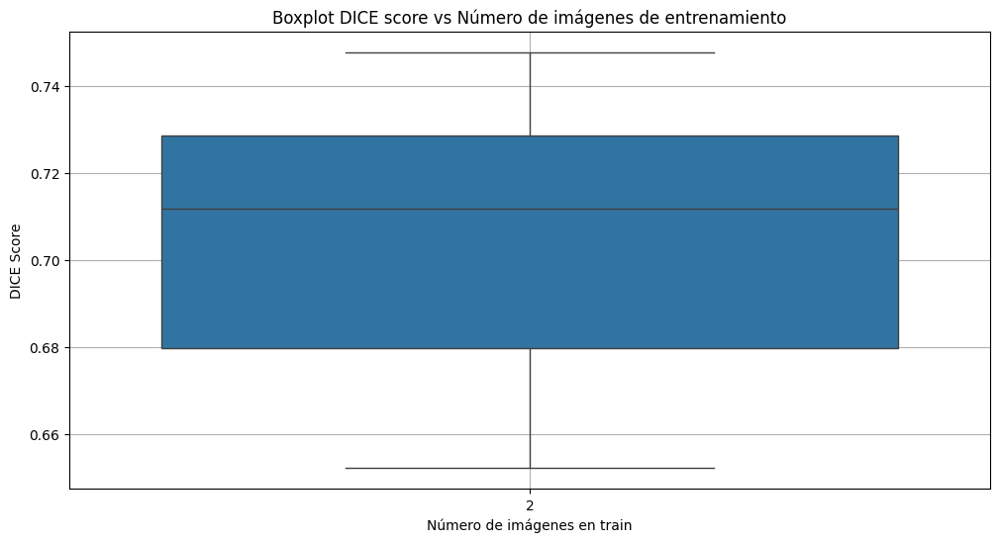

In [ ]:
# ---------------------------------------------
# Individual training continuation with mask visualization
# ---------------------------------------------
# Load trained model

# Paths
dataset_location = "/content/drive/MyDrive/dataset_v2"
test_images_dir = os.path.join(dataset_location, "test", "images")
test_labels_dir = os.path.join(dataset_location, "test", "labels")
results_dir = os.path.join(dataset_location, "results")

# Create results directory if it doesn't exist
os.makedirs(results_dir, exist_ok=True)

model_path = f"/content/runs/segment/train22/weights/best.pt"
model = YOLO(model_path)

# Process all images
for filename in tqdm(os.listdir(test_images_dir)):
    if not filename.endswith((".jpg", ".png")):
        continue

    image_path = os.path.join(test_images_dir, filename)
    label_path = os.path.join(test_labels_dir, filename.replace(".jpg", ".txt").replace(".png", ".txt"))

    # Load image
    image = Image.open(image_path).convert("RGB")
    image_np = np.array(image)

    # Create ground truth mask
    true_mask = np.zeros((image.height, image.width), dtype=np.uint8)
    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                parts = list(map(float, line.strip().split()))
                if len(parts) < 7:
                    continue  # Invalid polygon

                coords = parts[1:]
                polygon = np.array(coords).reshape(-1, 2)
                polygon[:, 0] *= image.width
                polygon[:, 1] *= image.height
                polygon = polygon.astype(np.int32)

                cv2.fillPoly(true_mask, [polygon], color=255)

    # Predict masks from model
    results = model.predict(image, conf=0.25)
    result = results[0]
    masks = result.masks.data.cpu().numpy() if result.masks else []

    pred_mask = np.zeros((image.height, image.width), dtype=np.uint8)
    if masks is not None and len(masks) > 0:
        for mask in masks:
            mask_resized = cv2.resize((mask * 255).astype(np.uint8), (image.width, image.height), interpolation=cv2.INTER_NEAREST)
            pred_mask = np.maximum(pred_mask, mask_resized)

    # Plot and save figure
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(image_np)
    plt.title("Original Image")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(true_mask, cmap='gray')
    plt.title("Ground Truth Mask")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(pred_mask, cmap='gray')
    plt.title("Predicted Mask")
    plt.axis("off")

    # Save the result figure
    result_filename = os.path.splitext(filename)[0] + "_comparison.png"
    result_path = os.path.join(results_dir, result_filename)
    plt.savefig(result_path, bbox_inches='tight')
    plt.close()

    # Calculate DICE score
    score = dice_score(true_mask, pred_mask)
    dice_example.append(score)

    # Log result
    print(f"{filename}: DICE = {score:.4f} | true = {np.sum(true_mask)} | pred = {np.sum(pred_mask)}")

    # Save result to lists
    dice_alter.append({"version": 2, "train_images": 2, "image": filename, "dice": score})
    dice_all.append({"version": 2, "train_images": 2, "image": filename, "dice": score})

# Create a DataFrame
df = pd.DataFrame(dice_alter)

# Create a boxplot
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x="train_images", y="dice")
plt.title("Boxplot: DICE Score vs Number of Training Images")
plt.xlabel("Number of Training Images")
plt.ylabel("DICE Score")
plt.grid(True)
plt.show()

  0%|          | 0/20 [00:00<?, ?it/s]


0: 640x640 26 cracks, 59 grainss, 764.3ms
Speed: 4.3ms preprocess, 764.3ms inference, 374.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 26 cracks, 59 grainss, 759.8ms
Speed: 4.8ms preprocess, 759.8ms inference, 375.7ms postprocess per image at shape (1, 3, 640, 640)


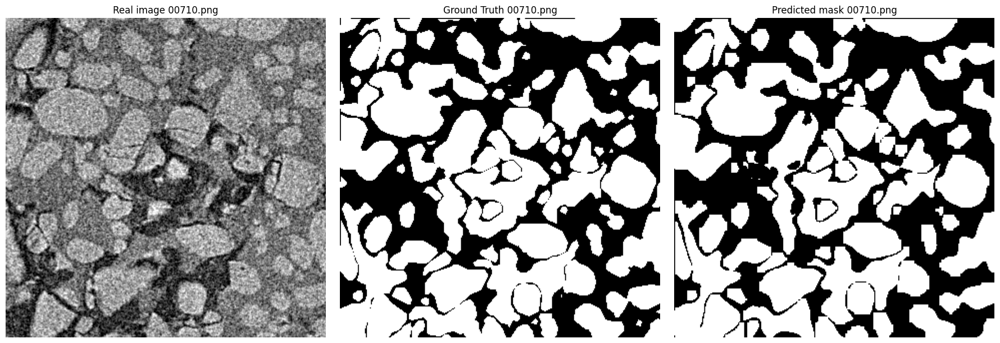

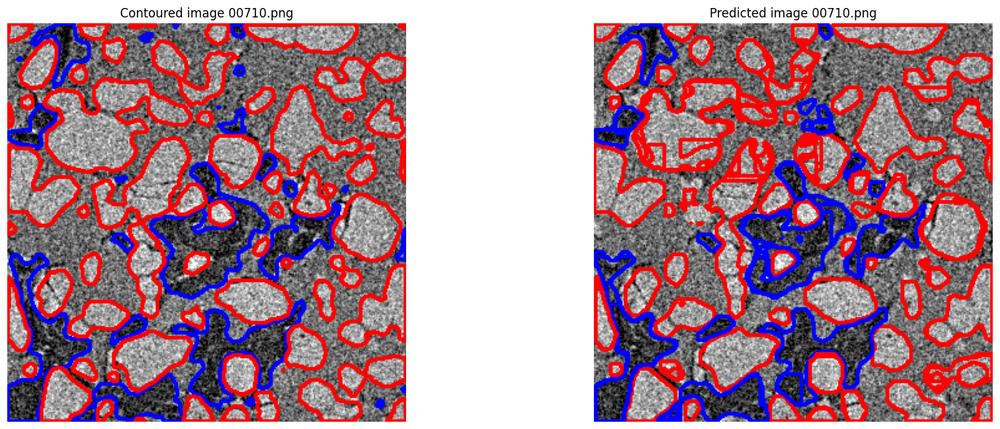

  5%|▌         | 1/20 [00:05<01:43,  5.47s/it]

00710.png: DICE = 0.9300 | true = 15058260 | pred = 14534745

0: 640x640 27 cracks, 46 grainss, 855.8ms
Speed: 5.6ms preprocess, 855.8ms inference, 497.2ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 27 cracks, 46 grainss, 1259.3ms
Speed: 9.5ms preprocess, 1259.3ms inference, 496.5ms postprocess per image at shape (1, 3, 640, 640)


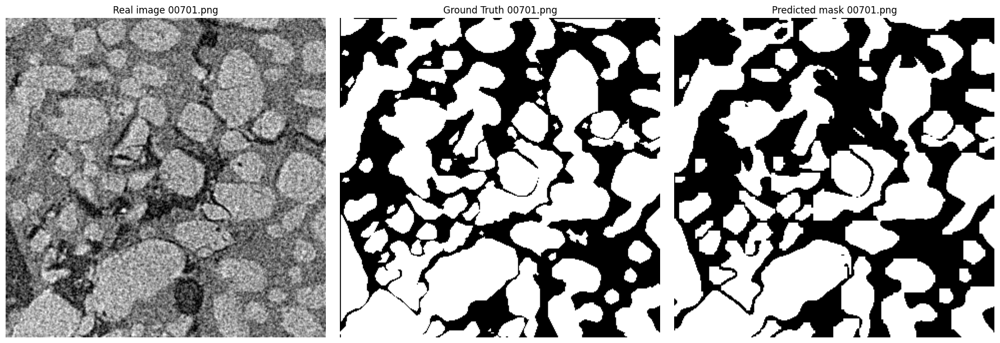

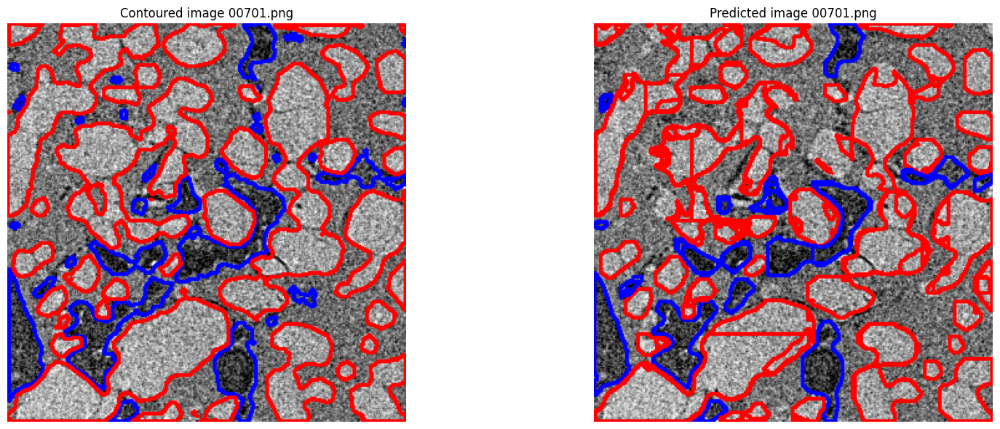

 10%|█         | 2/20 [00:12<01:52,  6.25s/it]

00701.png: DICE = 0.9101 | true = 15581775 | pred = 14002815

0: 640x640 26 cracks, 52 grainss, 882.8ms
Speed: 5.6ms preprocess, 882.8ms inference, 325.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 26 cracks, 52 grainss, 799.8ms
Speed: 6.3ms preprocess, 799.8ms inference, 324.3ms postprocess per image at shape (1, 3, 640, 640)


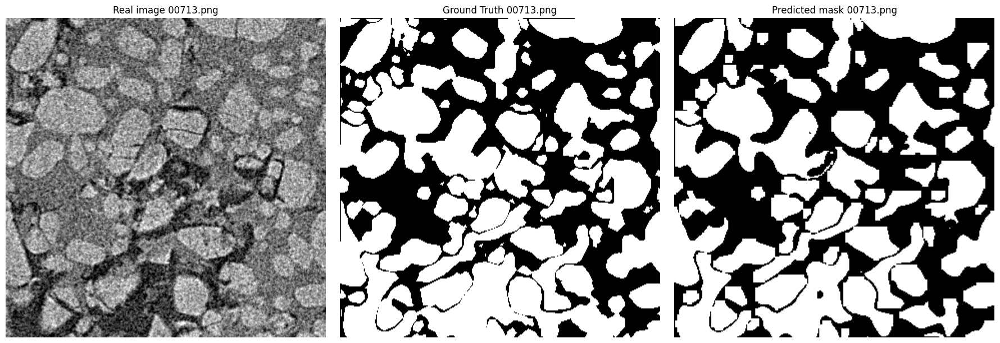

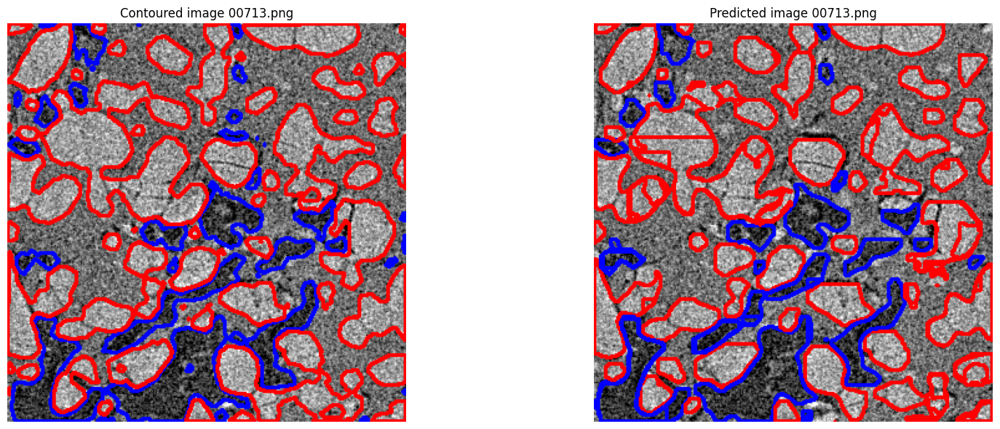

 15%|█▌        | 3/20 [00:17<01:39,  5.83s/it]

00713.png: DICE = 0.9135 | true = 14947335 | pred = 13713900

0: 640x640 24 cracks, 51 grainss, 888.7ms
Speed: 5.8ms preprocess, 888.7ms inference, 311.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 24 cracks, 51 grainss, 818.4ms
Speed: 5.5ms preprocess, 818.4ms inference, 314.4ms postprocess per image at shape (1, 3, 640, 640)


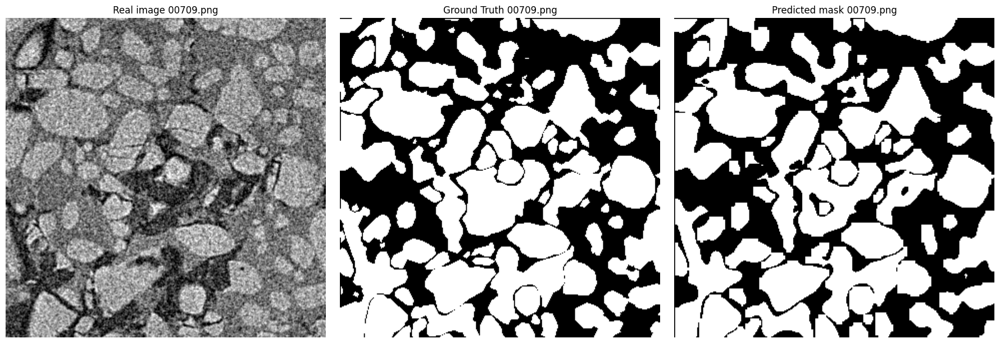

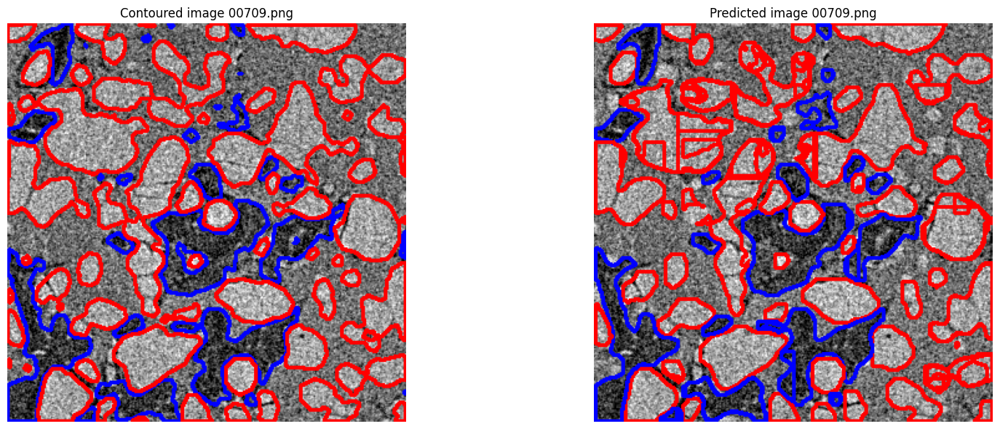

 20%|██        | 4/20 [00:24<01:37,  6.08s/it]

00709.png: DICE = 0.9261 | true = 14984565 | pred = 14379705

0: 640x640 32 cracks, 48 grainss, 1236.6ms
Speed: 5.7ms preprocess, 1236.6ms inference, 352.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 32 cracks, 48 grainss, 828.5ms
Speed: 5.3ms preprocess, 828.5ms inference, 343.7ms postprocess per image at shape (1, 3, 640, 640)


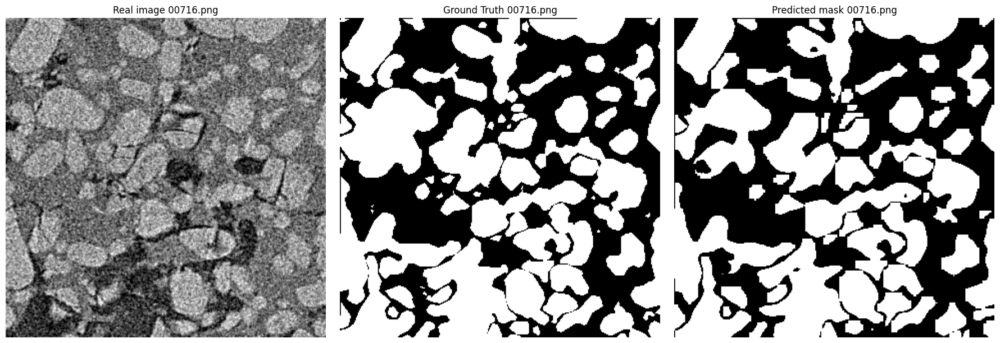

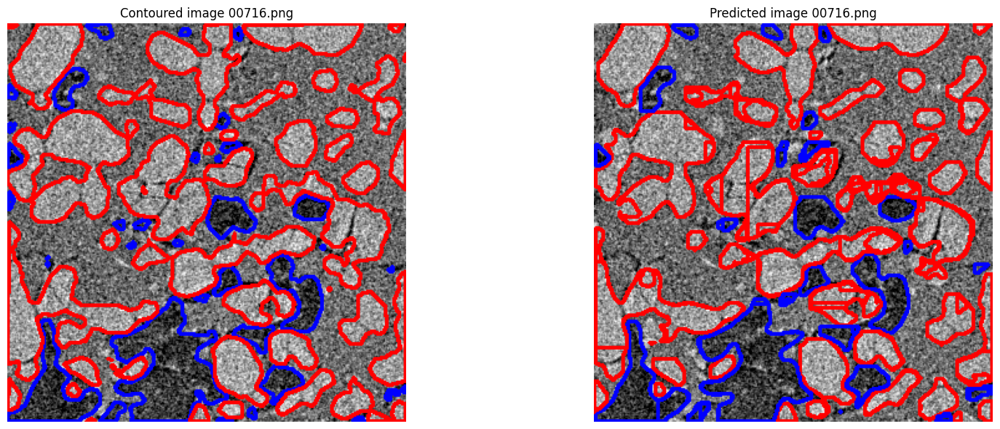

 25%|██▌       | 5/20 [00:29<01:29,  6.00s/it]

00716.png: DICE = 0.9215 | true = 14067075 | pred = 13316100

0: 640x640 29 cracks, 58 grainss, 968.4ms
Speed: 5.0ms preprocess, 968.4ms inference, 358.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 29 cracks, 58 grainss, 879.1ms
Speed: 12.6ms preprocess, 879.1ms inference, 437.5ms postprocess per image at shape (1, 3, 640, 640)


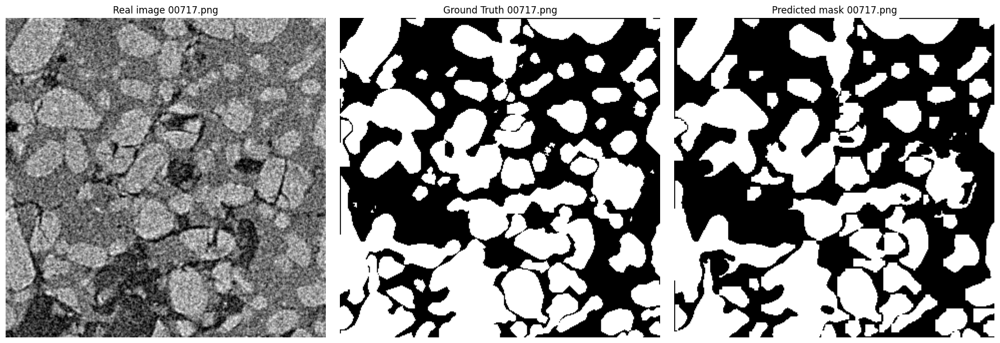

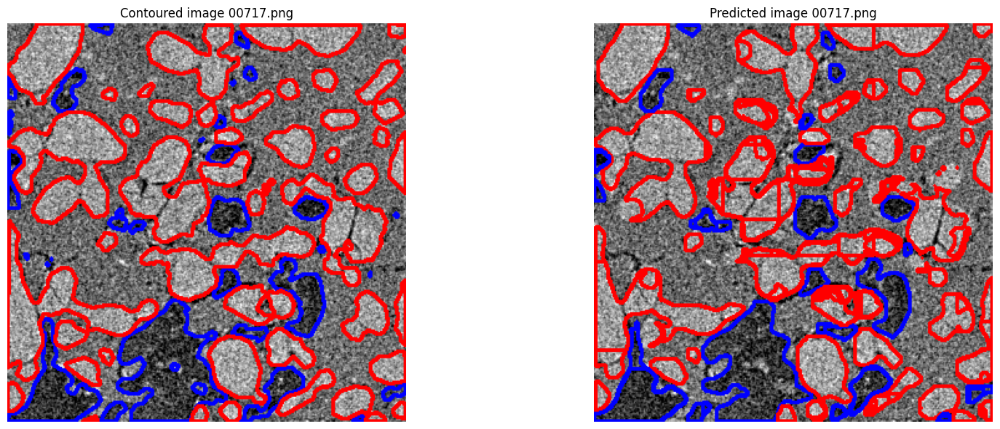

 30%|███       | 6/20 [00:35<01:23,  6.00s/it]

00717.png: DICE = 0.9142 | true = 13657545 | pred = 12710730

0: 640x640 27 cracks, 53 grainss, 1389.8ms
Speed: 10.1ms preprocess, 1389.8ms inference, 571.2ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 27 cracks, 53 grainss, 1269.5ms
Speed: 6.5ms preprocess, 1269.5ms inference, 623.1ms postprocess per image at shape (1, 3, 640, 640)


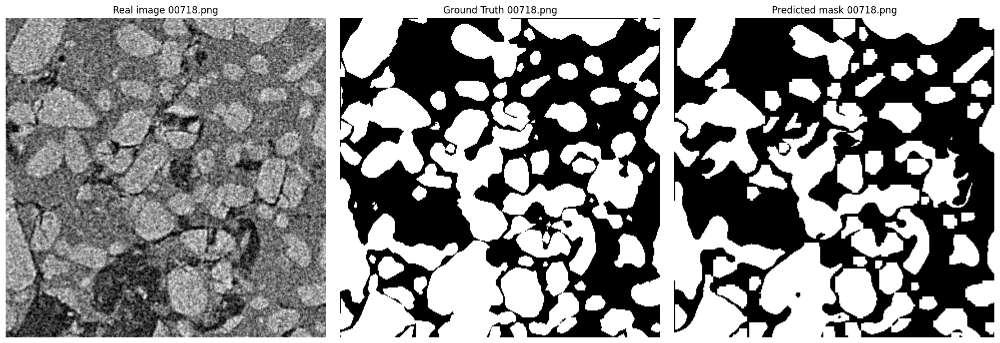

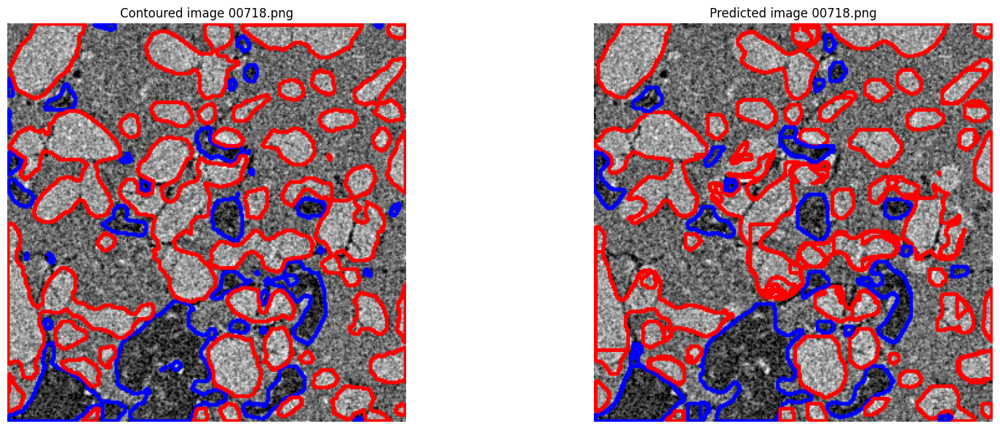

 35%|███▌      | 7/20 [00:43<01:25,  6.62s/it]

00718.png: DICE = 0.9083 | true = 13483635 | pred = 12327975

0: 640x640 23 cracks, 54 grainss, 1029.4ms
Speed: 5.6ms preprocess, 1029.4ms inference, 335.9ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 23 cracks, 54 grainss, 939.9ms
Speed: 5.4ms preprocess, 939.9ms inference, 335.0ms postprocess per image at shape (1, 3, 640, 640)


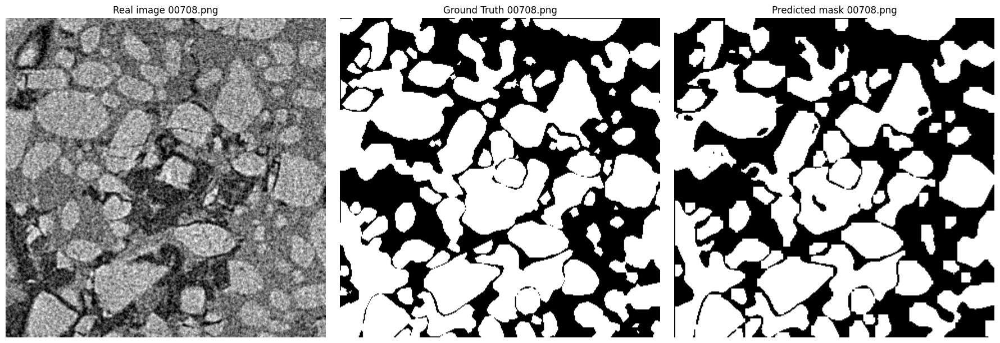

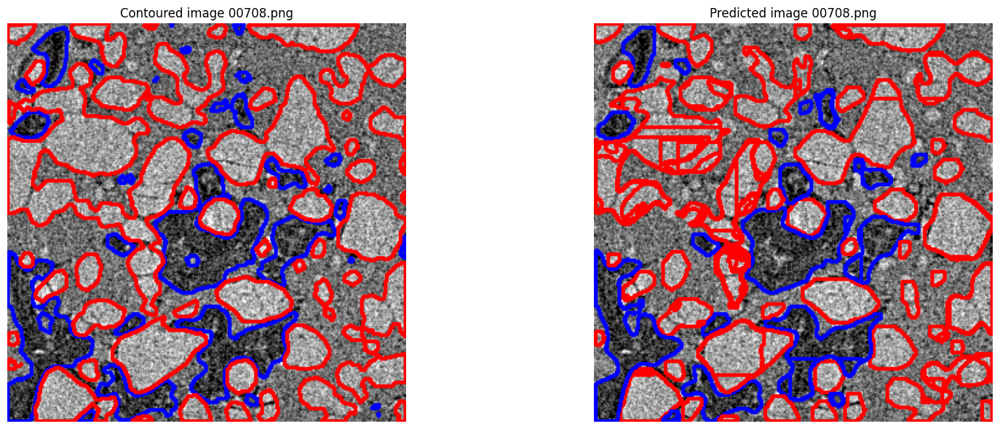

 40%|████      | 8/20 [00:49<01:16,  6.40s/it]

00708.png: DICE = 0.9255 | true = 15428775 | pred = 14333805

0: 640x640 25 cracks, 44 grainss, 1083.1ms
Speed: 6.8ms preprocess, 1083.1ms inference, 450.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 25 cracks, 44 grainss, 1251.9ms
Speed: 5.5ms preprocess, 1251.9ms inference, 481.7ms postprocess per image at shape (1, 3, 640, 640)


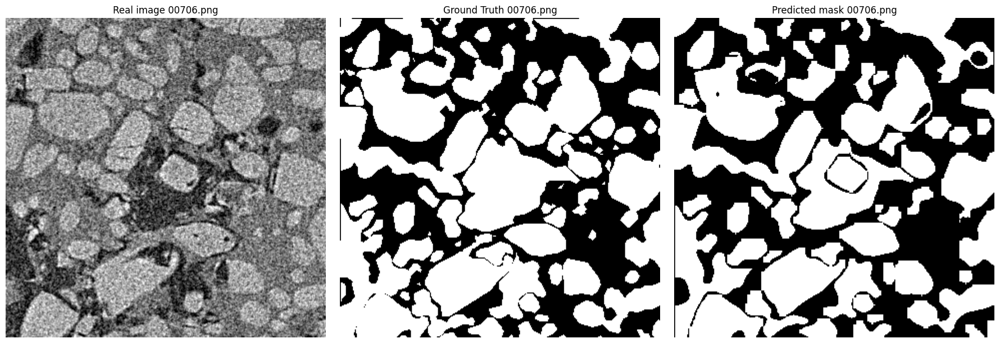

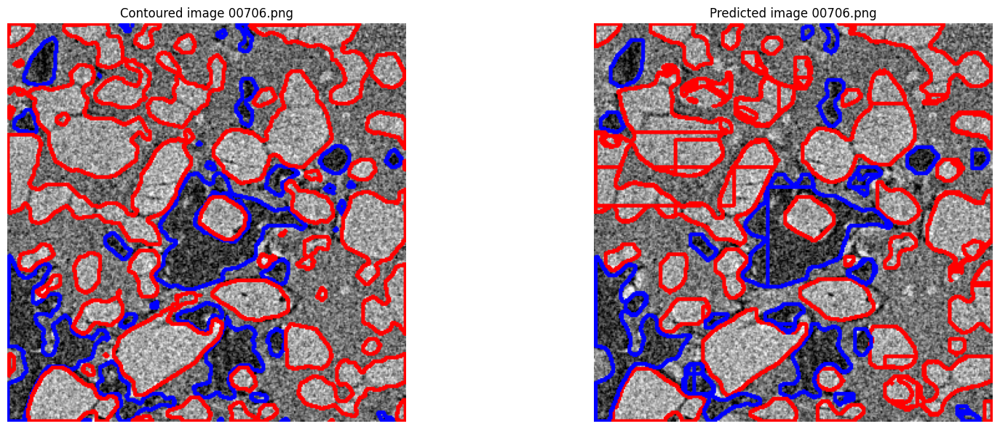

 45%|████▌     | 9/20 [00:57<01:13,  6.72s/it]

00706.png: DICE = 0.9259 | true = 14915970 | pred = 13952580

0: 640x640 27 cracks, 38 grainss, 1090.3ms
Speed: 6.2ms preprocess, 1090.3ms inference, 270.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 27 cracks, 38 grainss, 1040.8ms
Speed: 5.5ms preprocess, 1040.8ms inference, 327.4ms postprocess per image at shape (1, 3, 640, 640)


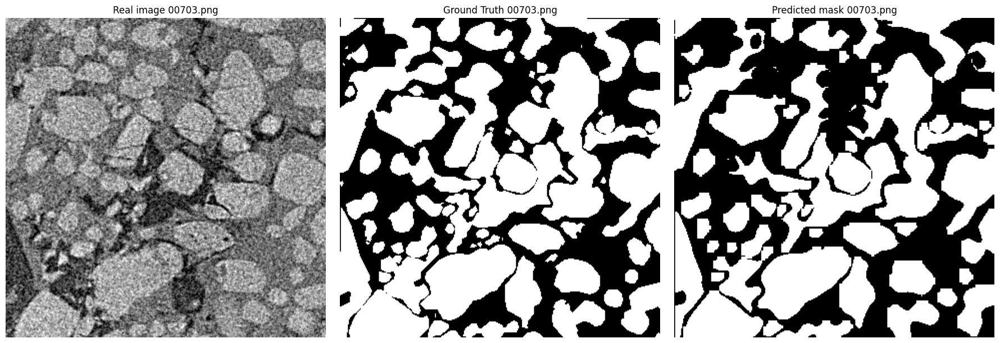

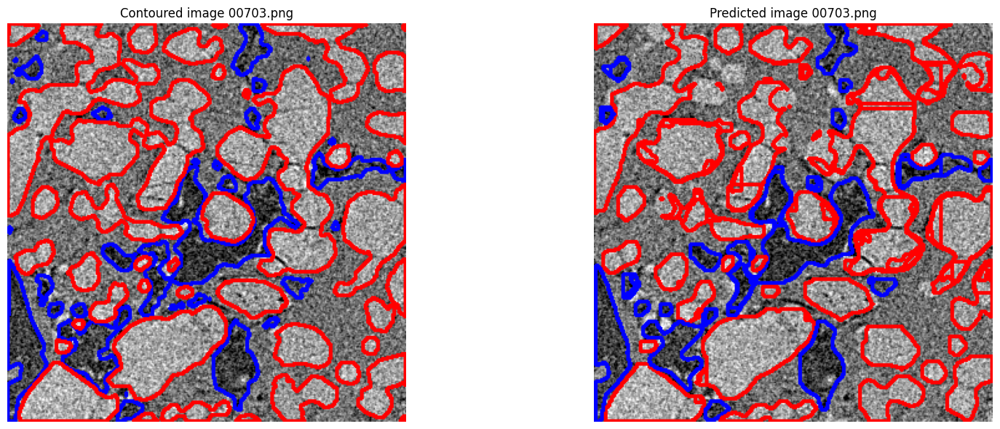

 50%|█████     | 10/20 [01:03<01:04,  6.48s/it]

00703.png: DICE = 0.9147 | true = 15205140 | pred = 13849305

0: 640x640 35 cracks, 41 grainss, 1141.7ms
Speed: 6.2ms preprocess, 1141.7ms inference, 314.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 35 cracks, 41 grainss, 1077.4ms
Speed: 6.1ms preprocess, 1077.4ms inference, 571.8ms postprocess per image at shape (1, 3, 640, 640)


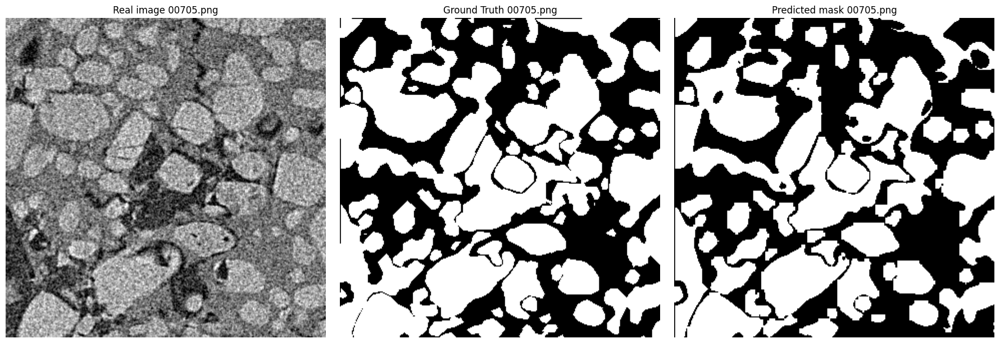

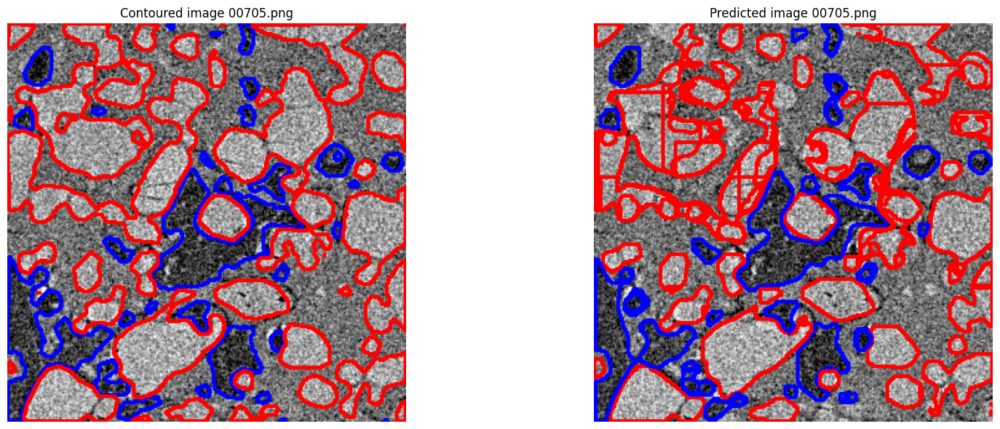

 55%|█████▌    | 11/20 [01:10<01:01,  6.83s/it]

00705.png: DICE = 0.9115 | true = 14798160 | pred = 13628475

0: 640x640 28 cracks, 43 grainss, 1249.8ms
Speed: 5.3ms preprocess, 1249.8ms inference, 396.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 28 cracks, 43 grainss, 1088.8ms
Speed: 5.7ms preprocess, 1088.8ms inference, 288.4ms postprocess per image at shape (1, 3, 640, 640)


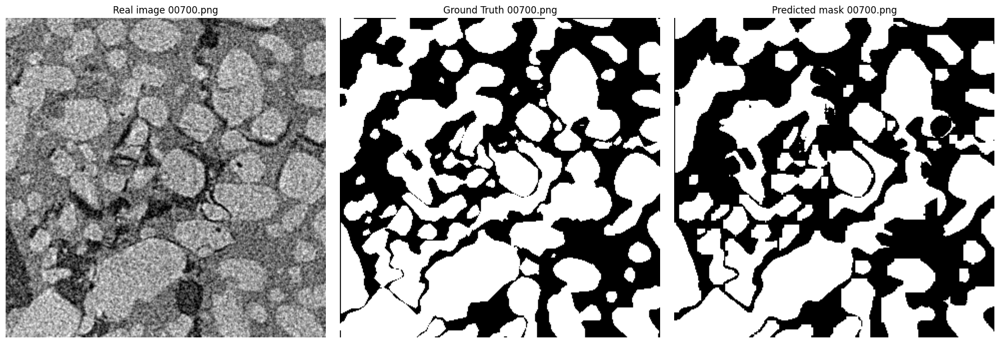

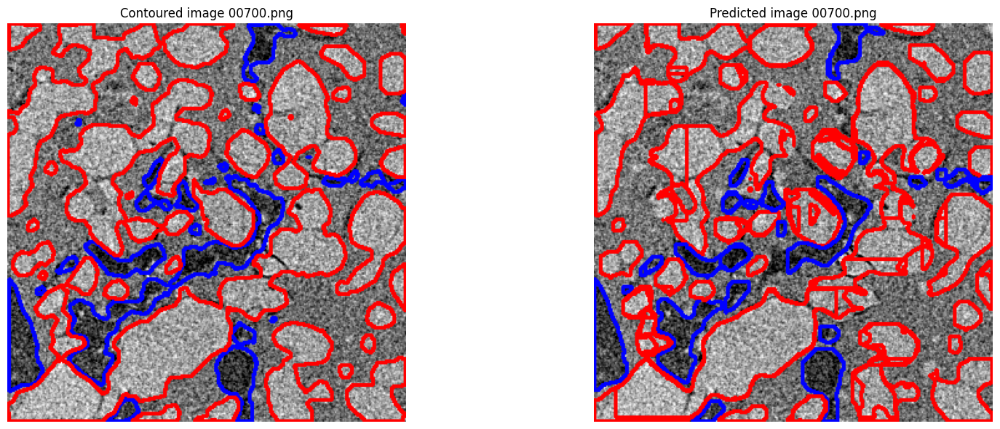

 60%|██████    | 12/20 [01:17<00:53,  6.71s/it]

00700.png: DICE = 0.9129 | true = 15085290 | pred = 13974765

0: 640x640 29 cracks, 57 grainss, 1256.0ms
Speed: 10.2ms preprocess, 1256.0ms inference, 405.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 29 cracks, 57 grainss, 1173.8ms
Speed: 8.3ms preprocess, 1173.8ms inference, 477.8ms postprocess per image at shape (1, 3, 640, 640)


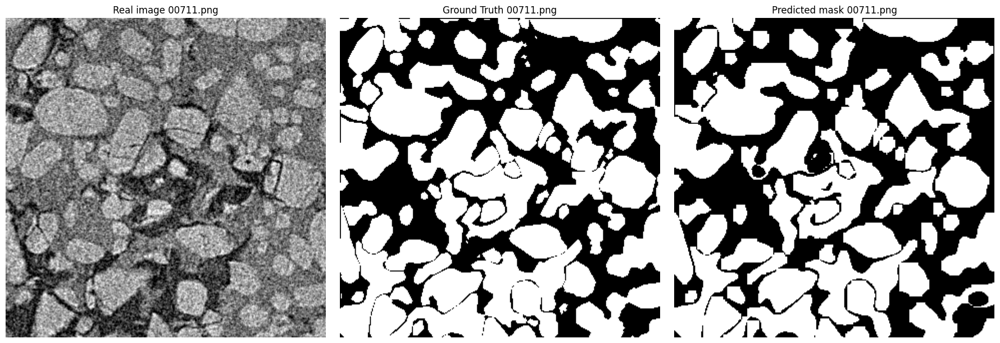

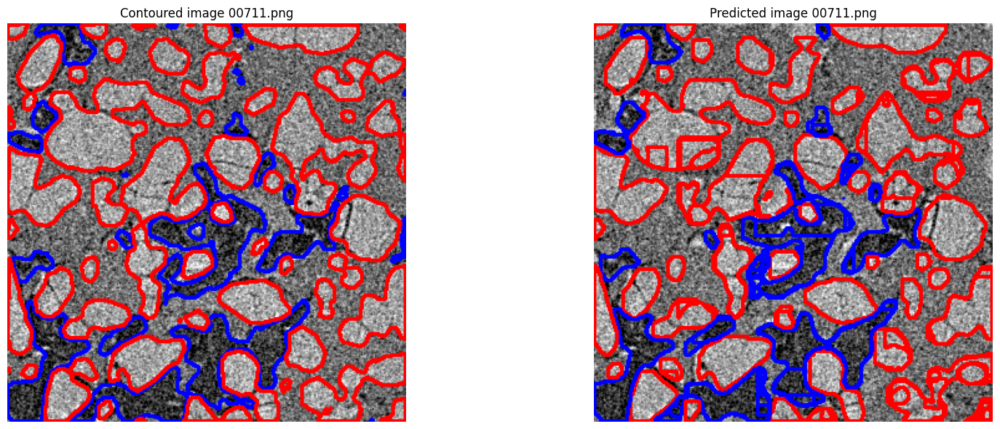

 65%|██████▌   | 13/20 [01:24<00:49,  7.02s/it]

00711.png: DICE = 0.9253 | true = 15396645 | pred = 14370270

0: 640x640 33 cracks, 54 grainss, 1374.2ms
Speed: 5.4ms preprocess, 1374.2ms inference, 669.3ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 33 cracks, 54 grainss, 1179.6ms
Speed: 5.5ms preprocess, 1179.6ms inference, 407.5ms postprocess per image at shape (1, 3, 640, 640)


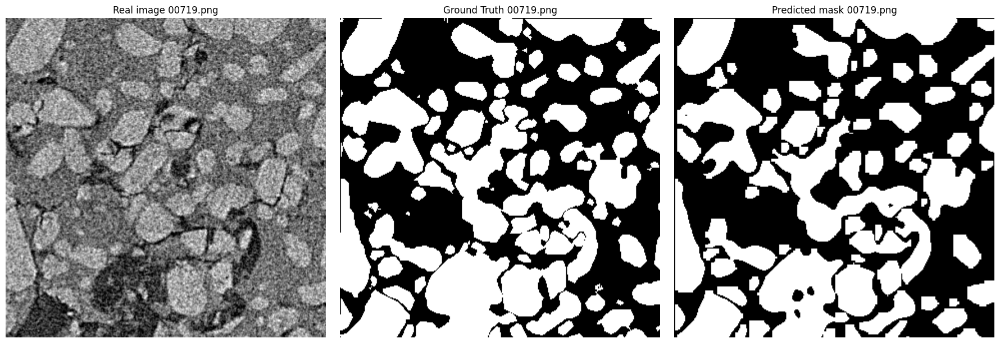

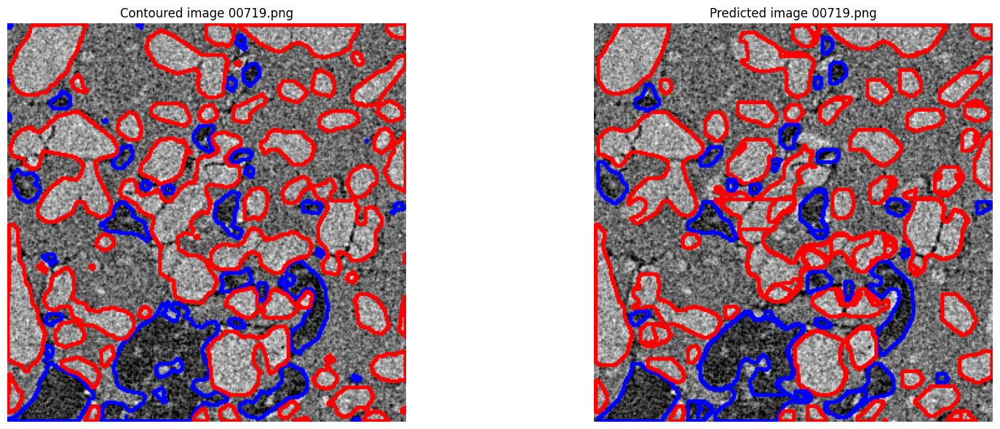

 70%|███████   | 14/20 [01:32<00:42,  7.07s/it]

00719.png: DICE = 0.9135 | true = 13222515 | pred = 12268815

0: 640x640 27 cracks, 55 grainss, 1146.4ms
Speed: 5.2ms preprocess, 1146.4ms inference, 448.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 27 cracks, 55 grainss, 1150.0ms
Speed: 13.5ms preprocess, 1150.0ms inference, 360.4ms postprocess per image at shape (1, 3, 640, 640)


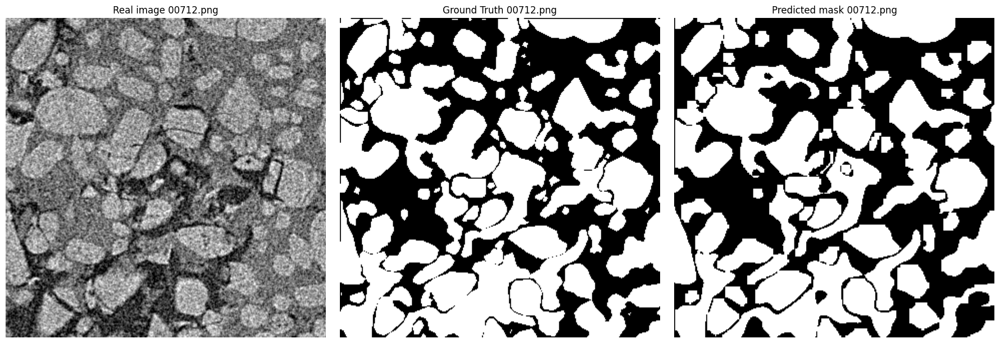

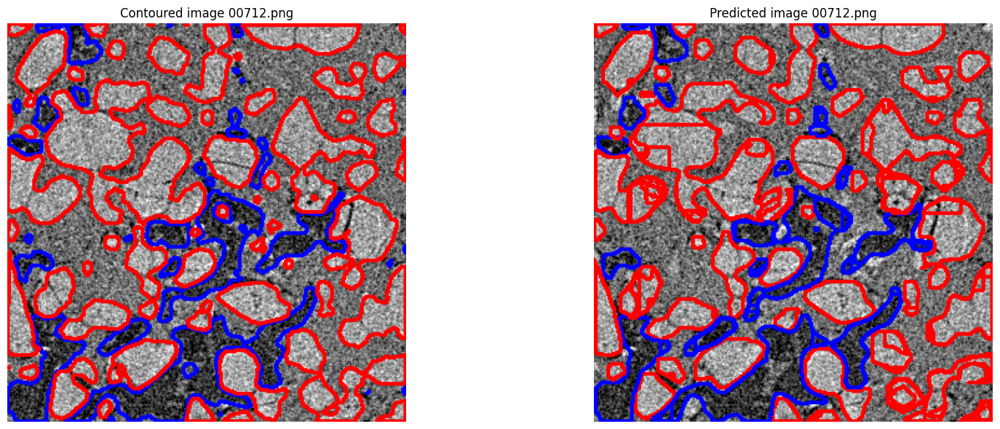

 75%|███████▌  | 15/20 [01:39<00:35,  7.10s/it]

00712.png: DICE = 0.9195 | true = 14895825 | pred = 14070390

0: 640x640 28 cracks, 40 grainss, 1269.1ms
Speed: 12.0ms preprocess, 1269.1ms inference, 457.3ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 28 cracks, 40 grainss, 1345.6ms
Speed: 7.0ms preprocess, 1345.6ms inference, 550.6ms postprocess per image at shape (1, 3, 640, 640)


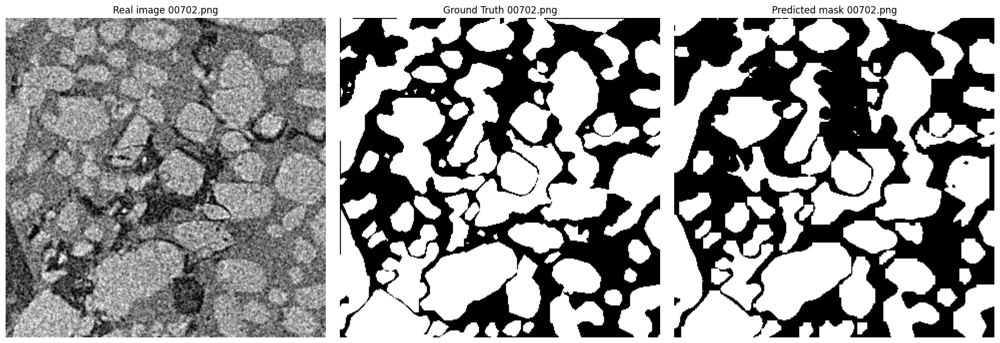

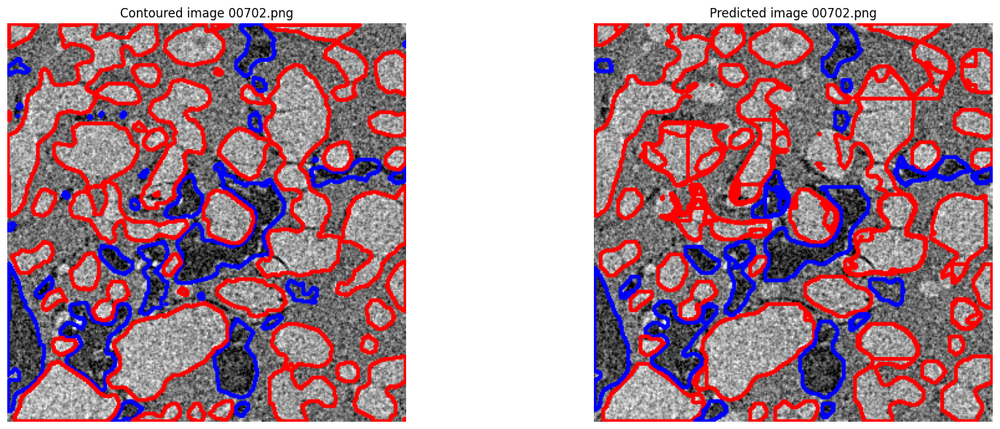

 80%|████████  | 16/20 [01:46<00:29,  7.26s/it]

00702.png: DICE = 0.9081 | true = 15186015 | pred = 13976550

0: 640x640 25 cracks, 49 grainss, 1164.5ms
Speed: 5.4ms preprocess, 1164.5ms inference, 501.3ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 25 cracks, 49 grainss, 1153.9ms
Speed: 8.5ms preprocess, 1153.9ms inference, 466.6ms postprocess per image at shape (1, 3, 640, 640)


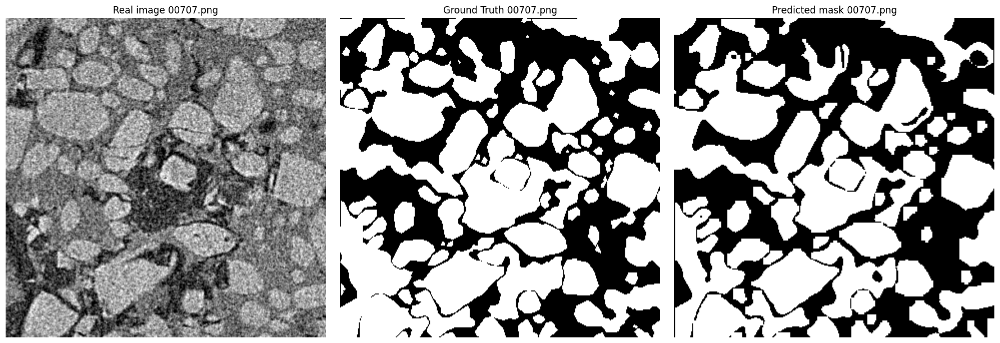

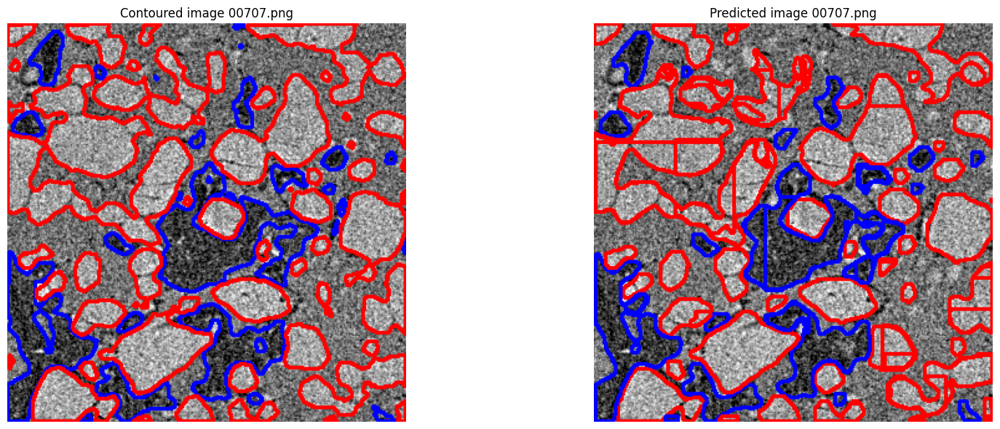

 85%|████████▌ | 17/20 [01:53<00:21,  7.17s/it]

00707.png: DICE = 0.9316 | true = 15273990 | pred = 14431980

0: 640x640 31 cracks, 49 grainss, 1434.3ms
Speed: 6.2ms preprocess, 1434.3ms inference, 659.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 31 cracks, 49 grainss, 1208.2ms
Speed: 9.6ms preprocess, 1208.2ms inference, 783.9ms postprocess per image at shape (1, 3, 640, 640)


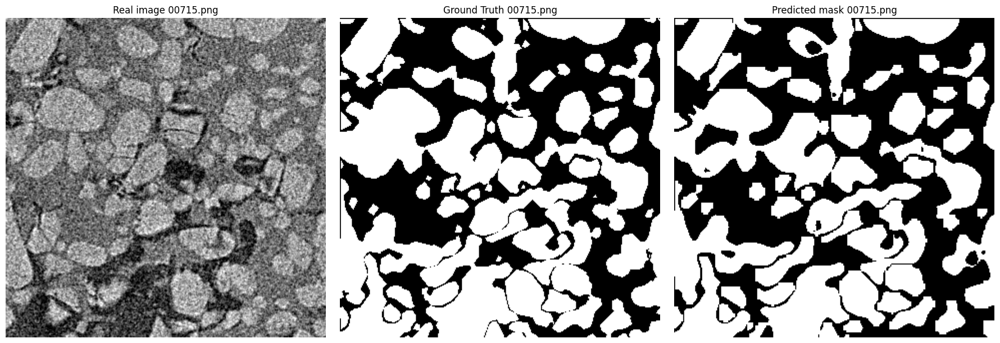

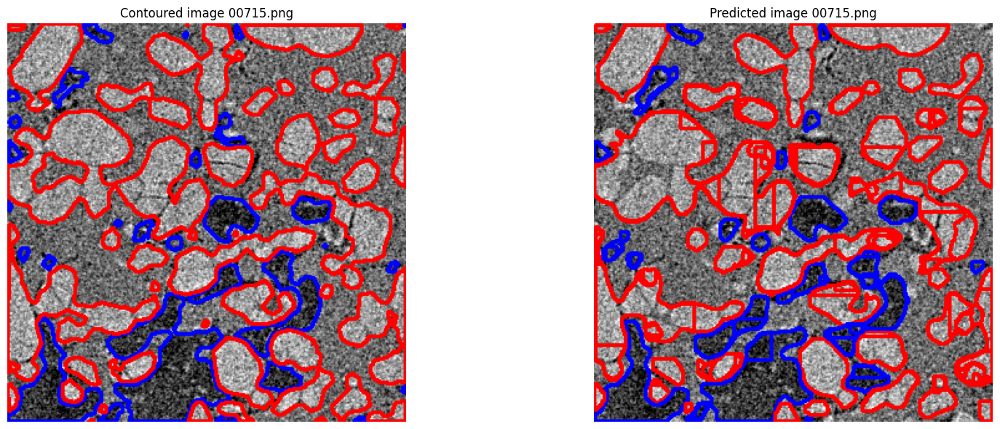

 90%|█████████ | 18/20 [02:02<00:15,  7.66s/it]

00715.png: DICE = 0.9182 | true = 14547495 | pred = 13497150

0: 640x640 27 cracks, 47 grainss, 1229.7ms
Speed: 5.9ms preprocess, 1229.7ms inference, 535.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 27 cracks, 47 grainss, 1181.2ms
Speed: 6.4ms preprocess, 1181.2ms inference, 435.8ms postprocess per image at shape (1, 3, 640, 640)


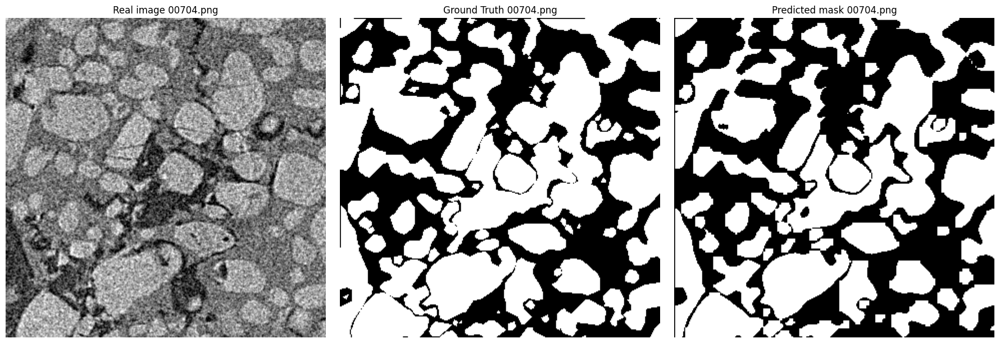

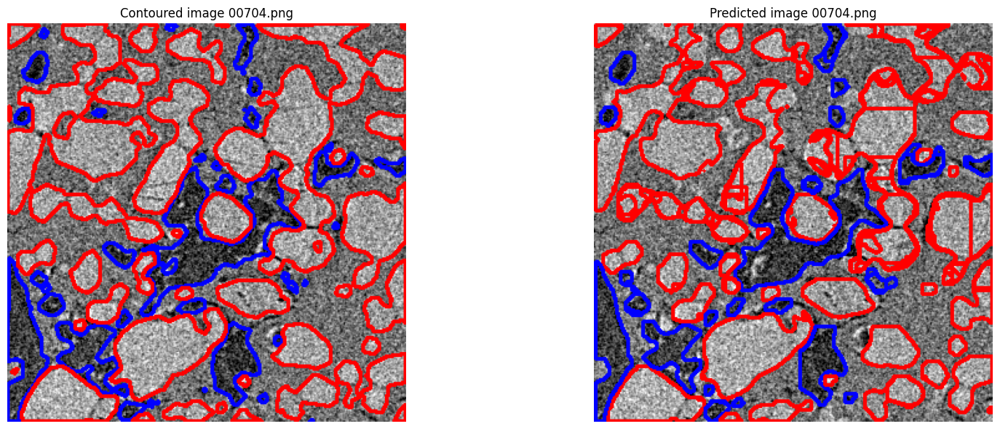

 95%|█████████▌| 19/20 [02:09<00:07,  7.49s/it]

00704.png: DICE = 0.9071 | true = 15148275 | pred = 13574925

0: 640x640 29 cracks, 57 grainss, 1224.5ms
Speed: 7.2ms preprocess, 1224.5ms inference, 602.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 29 cracks, 57 grainss, 1384.6ms
Speed: 8.1ms preprocess, 1384.6ms inference, 649.0ms postprocess per image at shape (1, 3, 640, 640)


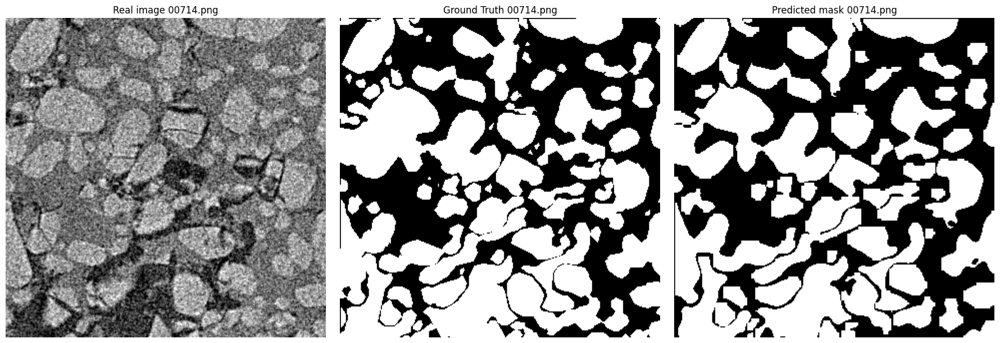

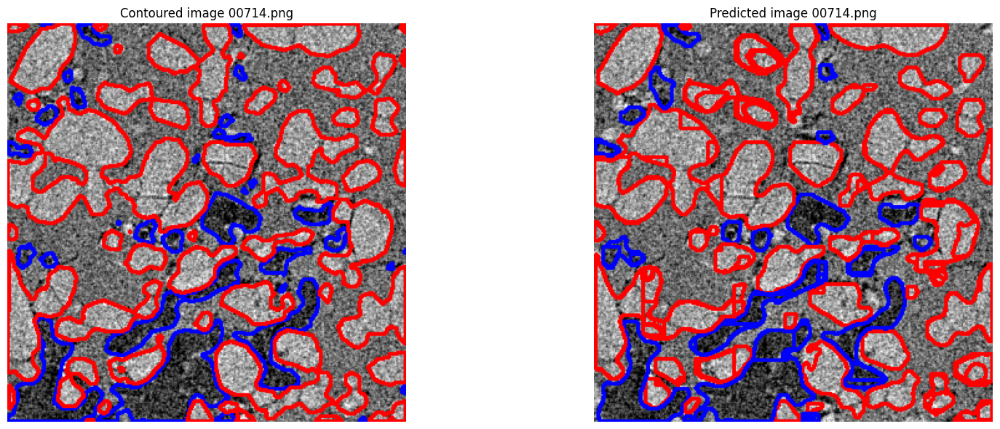

100%|██████████| 20/20 [02:18<00:00,  6.92s/it]

00714.png: DICE = 0.9198 | true = 14578350 | pred = 13854150


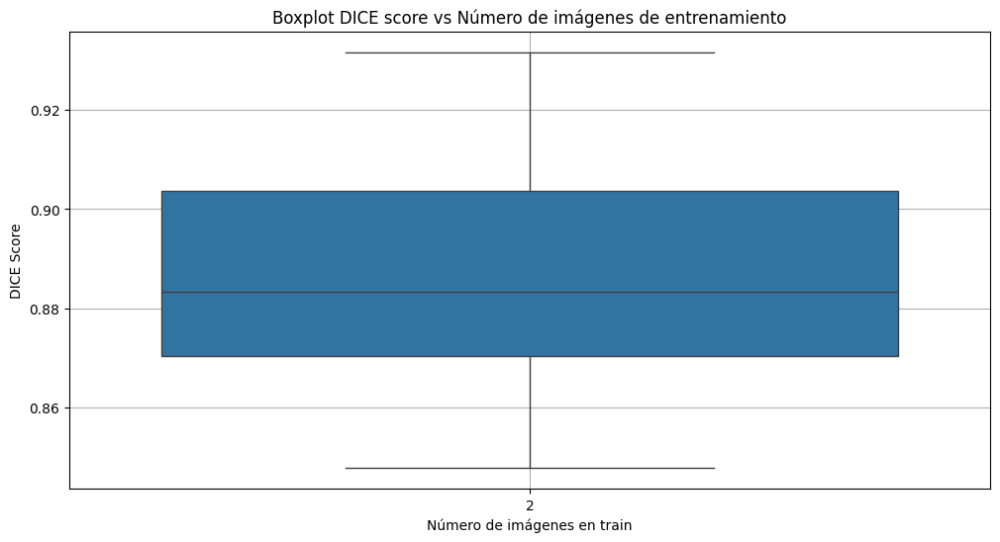

In [ ]:
# ------------------------------------------------
# Save segmented results as contoured images
# ------------------------------------------------

import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm
from ultralytics import YOLO
import pandas as pd
import seaborn as sns

# Function to calculate DICE score
def dice_score(mask_gt, mask_pred):
    intersection = np.logical_and(mask_gt, mask_pred).sum()
    union = mask_gt.sum() + mask_pred.sum()
    if union == 0:
        return 1.0  # both are empty, perfect score
    return 2.0 * intersection / union

# Paths
dataset_location = "/content/drive/MyDrive/all_datasets/dataset-test_v60/nohyper"
model_path = "/content/drive/MyDrive/RespaldoColab_hyperparametros/runs/segment/tune/weights/best.pt"
test_images_dir = os.path.join("/content/drive/MyDrive/all_datasets/dataset-test_v60", "test", "images")
test_labels_dir = os.path.join("/content/drive/MyDrive/all_datasets/dataset-test_v60", "test", "labels")

# Output directories
results_mask_dir = os.path.join(dataset_location, "results_mask")
os.makedirs(results_mask_dir, exist_ok=True)
results_overlay_dir = os.path.join(dataset_location, "results_overlay")
os.makedirs(results_overlay_dir, exist_ok=True)

# Load YOLOv8 segmentation model
model = YOLO(model_path)

# Store results
dice_example = []
dice_alter = []

# Loop through each test image
for filename in tqdm(os.listdir(test_images_dir)):
    if not filename.endswith((".jpg", ".png")):
        continue  # Skip non-image files

    # Image and label paths
    image_path = os.path.join(test_images_dir, filename)
    label_path = os.path.join(test_labels_dir, filename.replace(".jpg", ".txt").replace(".png", ".txt"))

    # Load image and convert to NumPy array
    image = Image.open(image_path).convert("RGB")
    image_np = np.array(image)
    h, w = image_np.shape[:2]

    # -------------------------
    # Ground Truth Contours
    # -------------------------
    gt_overlay = image_np.copy()  # Copy for drawing GT contours
    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                parts = list(map(float, line.strip().split()))
                if len(parts) < 7:
                    continue  # Not a polygon
                cls_id = int(parts[0])
                polygon = np.array(parts[1:]).reshape(-1, 2)
                polygon[:, 0] *= w
                polygon[:, 1] *= h
                polygon = polygon.astype(np.int32)
                mask = np.zeros((h, w), dtype=np.uint8)
                cv2.fillPoly(mask, [polygon], 255)
                contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                color = (255, 0, 0) if cls_id == 0 else (0, 0, 255)  # Blue = cracks, Red = grains
                cv2.drawContours(gt_overlay, contours, -1, color, 2)

    # -------------------------
    # Prediction Contours
    # -------------------------
    pred_overlay = image_np.copy()
    results = model.predict(image, conf=0.25)
    result = results[0]

    # Extract masks and class IDs (needs supervision package)
    detections = sv.Detections.from_ultralytics(result)  # You must have `supervision` installed
    for mask, class_id in zip(detections.mask, detections.class_id):
        mask_uint8 = (mask * 255).astype(np.uint8)
        contours, _ = cv2.findContours(mask_uint8, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        color = (255, 0, 0) if class_id == 0 else (0, 0, 255)
        cv2.drawContours(pred_overlay, contours, -1, color, 2)

    # -------------------------
    # Generate Predicted Binary Mask
    # -------------------------
    results = model.predict(image, conf=0.25)
    result = results[0]
    masks = result.masks.data.cpu().numpy() if result.masks else []

    pred_mask = np.zeros((image.height, image.width), dtype=np.uint8)
    if masks is not None and len(masks) > 0:
        for mask in masks:
            mask_resized = cv2.resize((mask * 255).astype(np.uint8), (image.width, image.height), interpolation=cv2.INTER_NEAREST)
            pred_mask = np.maximum(pred_mask, mask_resized)

    # -------------------------
    # Generate Ground Truth Binary Mask
    # -------------------------
    true_mask = np.zeros((image.height, image.width), dtype=np.uint8)
    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                parts = list(map(float, line.strip().split()))
                if len(parts) < 7:
                    continue  # Not a valid polygon
                polygon = np.array(parts[1:]).reshape(-1, 2)
                polygon[:, 0] *= image.width
                polygon[:, 1] *= image.height
                polygon = polygon.astype(np.int32)
                cv2.fillPoly(true_mask, [polygon], color=255)

    # -------------------------
    # Display Masks and Overlays
    # -------------------------
    plt.figure(figsize=(18, 6))
    plt.subplot(1, 3, 1)
    plt.imshow(image_np)
    plt.title(f"Original image {filename}")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(true_mask, cmap="gray")
    plt.title(f"Ground Truth {filename}")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(pred_mask, cmap="gray")
    plt.title(f"Predicted mask {filename}")
    plt.axis("off")
    plt.tight_layout()

    # Save predicted vs ground truth masks
    result_filename = os.path.splitext(filename)[0] + "_contours.png"
    result_path = os.path.join(results_mask_dir, result_filename)
    plt.savefig(result_path, dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()

    # Show and save overlays
    plt.figure(figsize=(18, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(gt_overlay)
    plt.title(f"GT Contours {filename}")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(pred_overlay)
    plt.title(f"Predicted Contours {filename}")
    plt.axis("off")
    plt.tight_layout()

    result_filename = os.path.splitext(filename)[0] + "_contours_predicted.jpg"
    output_path = os.path.join(results_overlay_dir, result_filename)
    plt.savefig(output_path, dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()

    # -------------------------
    # Calculate DICE Score
    # -------------------------
    score = dice_score(true_mask, pred_mask)
    dice_example.append(score)
    print(f"{filename}: DICE = {score:.4f} | GT pixels = {np.sum(true_mask)} | Predicted pixels = {np.sum(pred_mask)}")
    dice_alter.append({
        "version": 2,
        "train_images": 2,
        "image": filename,
        "dice": score
    })

# -------------------------
# Plot DICE Score Results
# -------------------------
df = pd.DataFrame(dice_alter)
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x="train_images", y="dice")
plt.title("Boxplot: DICE score vs Number of training images")
plt.xlabel("Number of training images")
plt.ylabel("DICE Score")
plt.grid(True)
plt.show()

In [ ]:
# ------------------------------------------------
# Save contoured prediction images to a Drive folder
# ------------------------------------------------

import os
import cv2
import numpy as np
from PIL import Image
from ultralytics import YOLO
import supervision as sv  # For easier handling of YOLO outputs

# Load the trained YOLOv11 segmentation model
model_path = "/content/runs/segment/train22/weights/best.pt"
model = YOLO(model_path)

# Define directories
dataset_location = "/content/drive/MyDrive/dataset_v2"
test_images_dir = os.path.join(dataset_location, "test", "images")  # Folder with test images
results_dir = os.path.join(dataset_location, "results_contours")   # Output folder for results
os.makedirs(results_dir, exist_ok=True)  # Create the results folder if it doesn't exist

# Process each image in the test directory
for image_filename in os.listdir(test_images_dir):
    # Skip files that are not images
    if not image_filename.endswith((".jpg", ".png")):
        continue

    image_path = os.path.join(test_images_dir, image_filename)

    # Load the image and convert it to RGB format
    image = Image.open(image_path).convert("RGB")
    image_np = np.array(image)

    # Run prediction using YOLO (confidence threshold = 0.25)
    results = model.predict(image, conf=0.25)
    result = results[0]  # Get prediction for the single image

    # Extract predicted masks and class IDs using Supervision
    detections = sv.Detections.from_ultralytics(result)
    for mask, class_id in zip(detections.mask, detections.class_id):
        # Convert boolean mask to uint8 format (values 0 or 255)
        mask_uint8 = (mask * 255).astype(np.uint8)

        # Find contours in the binary mask
        contours, _ = cv2.findContours(mask_uint8, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Define color based on class:
        # Red for class 0, Blue for class 1
        color = (0, 0, 255) if class_id == 0 else (255, 0, 0)

        # Draw the contours on the original image
        cv2.drawContours(image_np, contours, -1, color, 2)

    # Save the final image with drawn contours
    result_filename = os.path.splitext(image_filename)[0] + "_contours_predicted.jpg"
    output_path = os.path.join(results_dir, result_filename)

    # Convert image back to BGR before saving with OpenCV
    cv2.imwrite(output_path, cv2.cvtColor(image_np, cv2.COLOR_RGB2BGR))

print("Predicted contours successfully saved.")


0: 320x320 300 grainss, 245.4ms
Speed: 4.1ms preprocess, 245.4ms inference, 371.2ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 300 grainss, 233.2ms
Speed: 1.2ms preprocess, 233.2ms inference, 349.2ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 300 grainss, 248.4ms
Speed: 1.2ms preprocess, 248.4ms inference, 340.7ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 300 grainss, 219.0ms
Speed: 1.3ms preprocess, 219.0ms inference, 337.5ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 300 grainss, 210.9ms
Speed: 1.2ms preprocess, 210.9ms inference, 337.1ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 300 grainss, 254.4ms
Speed: 1.3ms preprocess, 254.4ms inference, 343.4ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 300 grainss, 226.8ms
Speed: 1.8ms preprocess, 226.8ms inference, 369.7ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 300 grainss, 231.8ms
Speed: 1.5ms preprocess, 231.8ms inf

In [ ]:
#SEGMENTATION MASKS IN A OUTPUT FOLDER
import os
from PIL import Image
import cv2
import numpy as np
from ultralytics import YOLO
import supervision as sv

# Path to the input test images
input_images_directory = "/content/drive/MyDrive/dataset_v2/test/images"

# Path where the segmented output images will be saved
output_directory = "/content/drive/MyDrive/dataset_v2/results1"
os.makedirs(output_directory, exist_ok=True)

# Load the trained YOLOv11 segmentation model
model_path = "/content/runs/segment/train22/weights/best.pt"
model = YOLO(model_path)

# Create annotator for segmentation masks (no boxes or labels initially)
mask_annotator = sv.MaskAnnotator()

# Process each image in the input directory
for image_filename in os.listdir(input_images_directory):
    image_path = os.path.join(input_images_directory, image_filename)

    # Load the image and convert it to a NumPy array
    image = Image.open(image_path).convert("RGB")
    image_np = np.array(image)

    # Run YOLOv11 segmentation prediction
    results = model.predict(image, conf=0.25)
    result = results[0]

    # Convert to Supervision format
    detections = sv.Detections.from_ultralytics(result)

    # Annotate the masks on a copy of the image
    annotated_image = mask_annotator.annotate(image_np.copy(), detections=detections)

    # Add class labels on top of the masks (centered text, black color)
    label_annotator = sv.LabelAnnotator(text_color=sv.Color.BLACK, text_position=sv.Position.CENTER)
    label_annotator.annotate(annotated_image, detections=detections)

    # Optional: Scale the image (e.g., double size for visibility)
    scale = 2
    height, width = annotated_image.shape[:2]
    annotated_image = cv2.resize(annotated_image, (width * scale, height * scale), interpolation=cv2.INTER_NEAREST)

    # Save the final annotated image
    result_filename = os.path.splitext(image_filename)[0] + "_mask_only.jpg"
    output_path = os.path.join(output_directory, result_filename)
    cv2.imwrite(output_path, cv2.cvtColor(annotated_image, cv2.COLOR_RGB2BGR))

print("Segmented masks with class labels saved successfully.")


0: 320x320 300 grainss, 225.2ms
Speed: 1.3ms preprocess, 225.2ms inference, 323.1ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 300 grainss, 220.8ms
Speed: 1.2ms preprocess, 220.8ms inference, 366.3ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 300 grainss, 233.7ms
Speed: 1.8ms preprocess, 233.7ms inference, 344.6ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 300 grainss, 207.8ms
Speed: 1.2ms preprocess, 207.8ms inference, 314.9ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 300 grainss, 221.3ms
Speed: 1.4ms preprocess, 221.3ms inference, 356.0ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 300 grainss, 354.6ms
Speed: 1.5ms preprocess, 354.6ms inference, 521.0ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 300 grainss, 324.9ms
Speed: 1.4ms preprocess, 324.9ms inference, 536.1ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 300 grainss, 317.8ms
Speed: 1.2ms preprocess, 317.8ms inf

In [ ]:
# ----------------------------------------------------------
# SEGMENT ANY IMAGE FOLDER WITHOUT BOUNDING BOXES OR LABELS
# ----------------------------------------------------------

import os
from PIL import Image
import cv2
import numpy as np
from ultralytics import YOLO
import supervision as sv  # Library to simplify working with YOLO outputs

# Path to the input image folder
input_images_directory = "/content/drive/MyDrive/recherche-MachineLearning/YOLOv11_dataset/RDX_grains"

# Path where segmented mask images will be saved
output_directory = "/content/drive/MyDrive/YOLOv11_dataset_v1/RDX_grains_segmented"
os.makedirs(output_directory, exist_ok=True)  # Create output folder if it doesn't exist

# Load the trained YOLOv11 segmentation model
model_path = "/content/drive/MyDrive/RespaldoColab_hyperparametros/runs/segment/train/weights/best.pt"
model = YOLO(model_path)

# Initialize the mask annotator (only draws segmentation masks, no boxes or labels)
mask_annotator = sv.MaskAnnotator()

# Process each image in the input directory
for image_filename in os.listdir(input_images_directory):
    image_path = os.path.join(input_images_directory, image_filename)

    # Load the image using PIL and convert to NumPy array
    image = Image.open(image_path).convert("RGB")
    image_np = np.array(image)

    # Run segmentation prediction using the YOLO model
    results = model.predict(image, conf=0.25)
    result = results[0]

    # Convert YOLO output to Supervision format for easy mask handling
    detections = sv.Detections.from_ultralytics(result)

    # Draw only segmentation masks (no boxes or class labels)
    annotated_image = mask_annotator.annotate(image_np.copy(), detections=detections)

    # Optional: Scale the image up (here doubled in size for better visualization)
    scale = 2
    height, width = annotated_image.shape[:2]
    annotated_image = cv2.resize(annotated_image, (width * scale, height * scale), interpolation=cv2.INTER_NEAREST)

    # Save the final annotated image with masks
    result_filename = os.path.splitext(image_filename)[0] + "_mask_only.jpg"
    output_path = os.path.join(output_directory, result_filename)
    cv2.imwrite(output_path, cv2.cvtColor(annotated_image, cv2.COLOR_RGB2BGR))

print("Segmented masks saved successfully.")


0: 320x320 8 cracks, 39 grainss, 16.2ms
Speed: 1.0ms preprocess, 16.2ms inference, 6.4ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 20 cracks, 56 grainss, 26.4ms
Speed: 1.1ms preprocess, 26.4ms inference, 8.7ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 31 cracks, 56 grainss, 14.5ms
Speed: 1.0ms preprocess, 14.5ms inference, 8.9ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 29 cracks, 43 grainss, 12.5ms
Speed: 0.9ms preprocess, 12.5ms inference, 8.0ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 22 cracks, 63 grainss, 12.5ms
Speed: 1.0ms preprocess, 12.5ms inference, 8.7ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 7 cracks, 37 grainss, 12.0ms
Speed: 0.8ms preprocess, 12.0ms inference, 5.8ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 25 cracks, 66 grainss, 12.4ms
Speed: 0.9ms preprocess, 12.4ms inference, 9.1ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 23 cracks, 54 gra

In [ ]:
base_save_path = "/content/experimentos_dice_final_nodamas"
os.makedirs(base_save_path, exist_ok=True)

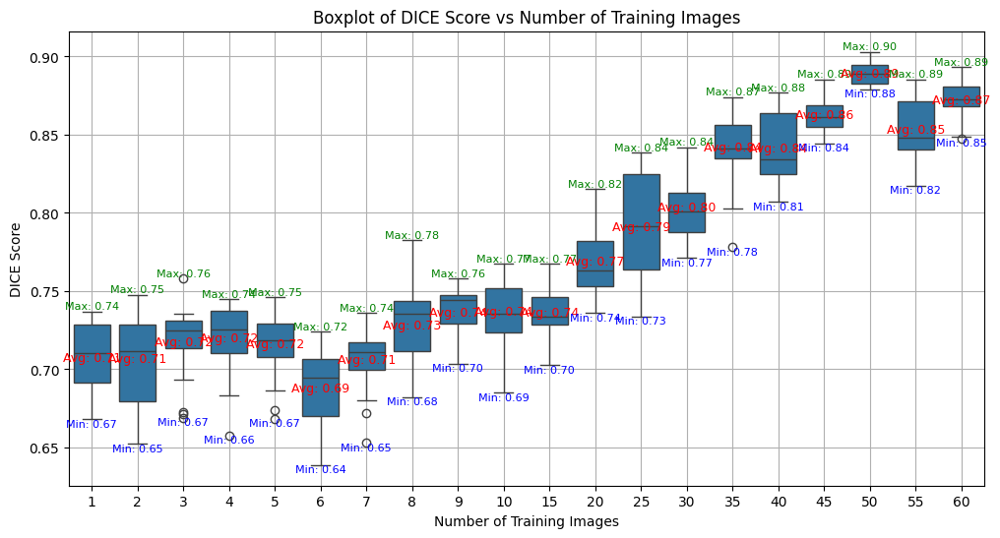

In [ ]:
# ---------------------------------------------
# SAVE RESULTS AND PLOT WITH LABELS
# ---------------------------------------------

data_path = '/content/drive/MyDrive/RespaldoColab_finalResults_YOLO/experimentos_dice_final_verdadero_v/dice_scores.csv'

# Leer el CSV original
df = pd.read_csv(data_path)
# Create plot
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x="train_images", y="dice")
plt.title("Boxplot of DICE Score vs Number of Training Images")
plt.xlabel("Number of Training Images")
plt.ylabel("DICE Score")
plt.grid(True)

# Calculate and annotate min, max, and average
grouped = df.groupby("train_images")["dice"]
positions = range(len(grouped))

for pos, (label, values) in zip(positions, grouped):
    min_val = values.min()
    max_val = values.max()
    avg_val = values.mean()

    # Annotate on the plot
    plt.text(pos, min_val, f"Min: {min_val:.2f}", ha='center', va='top', fontsize=8, color='blue')
    plt.text(pos, max_val, f"Max: {max_val:.2f}", ha='center', va='bottom', fontsize=8, color='green')
    plt.text(pos, avg_val, f"Avg: {avg_val:.2f}", ha='center', va='center', fontsize=9, color='red')

# Save and show
plt.savefig(os.path.join("/content/drive/MyDrive/RespaldoColab_finalResults_YOLO/experimentos_dice_final_verdadero_v", "dice_boxplot_labeled.png"))
plt.show()

Fitted equation (Power Law): y = 5.2853 * x^-0.2200


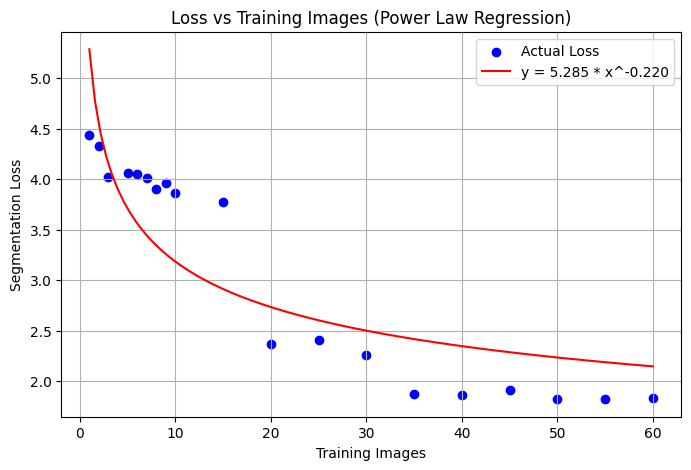

Fitted equation (sigmoid): y = 0.4728 / (1 + exp(-0.1203 * (x - 22.2009)))


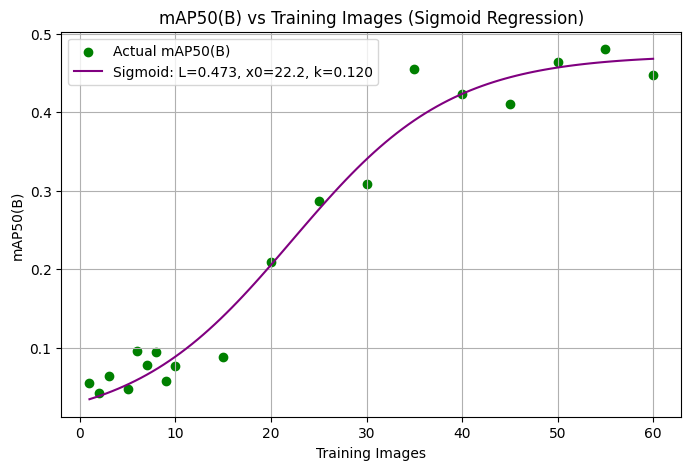

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.optimize import curve_fit

# Regression functions
def power_law(x, a, b):
    return a * x ** b

def sigmoid(x, L, x0, k):
    return L / (1 + np.exp(-k * (x - x0)))

# Version IDs to check
version_ids = list(range(1, 11)) + list(range(15, 65, 5))
results = []

for version in version_ids:
    if version == 4:
        continue
    csv_path = f"/content/drive/MyDrive/RespaldoColab_finalResults_YOLO/runs/segment/train{version}/results.csv"

    if not os.path.exists(csv_path):
        print(f"File not found for version {version}")
        continue

    df = pd.read_csv(csv_path)

    if 'train/seg_loss' not in df.columns or 'metrics/mAP50(B)' not in df.columns:
        print(f"Missing columns in train{version}")
        continue

    min_idx = df['train/seg_loss'].idxmin()
    min_loss = df.loc[min_idx, 'train/seg_loss']
    corresponding_map50 = df.loc[min_idx, 'metrics/mAP50(B)']

    results.append({
        "train_images": version,
        "loss": min_loss,
        "map50": corresponding_map50
    })

# Convert results to DataFrame
results_df = pd.DataFrame(results)

# Create output directory if it doesn't exist
output_dir = "/content/drive/MyDrive/RespaldoColab_finalResults_YOLO/experimentos_dice_final_verdadero_v"
os.makedirs(output_dir, exist_ok=True)

# -----------------------------------------------------
# Plot 1: Loss vs train_images (Power Law Regression)
# -----------------------------------------------------
x = results_df["train_images"].values
y = results_df["loss"].values

# Fit power law
popt_power, _ = curve_fit(power_law, x, y)
a_power, b_power = popt_power
x_fit = np.linspace(min(x), max(x), 100)
y_fit_power = power_law(x_fit, *popt_power)

print(f"Fitted equation (Power Law): y = {a_power:.4f} * x^{b_power:.4f}")

plt.figure(figsize=(8, 5))
plt.scatter(x, y, label="Actual Loss", color="blue")
plt.plot(x_fit, y_fit_power, label=f"y = {a_power:.3f} * x^{b_power:.3f}", color="red")
plt.xlabel("Training Images")
plt.ylabel("Segmentation Loss")
plt.title("Loss vs Training Images (Power Law Regression)")
plt.legend()
plt.grid(True)
plt.savefig(os.path.join(output_dir, "loss_train.png"))
plt.show()

# ----------------------------------------------------------------
# Plot 2: mAP50(B) vs train_images (sigmoid/logistic regression)
# ----------------------------------------------------------------
y2 = results_df["map50"].values

# Initial guess for sigmoid fit
initial_guess = [1.0, np.median(x), 0.05]  # L, x0, k
popt_sigmoid, _ = curve_fit(sigmoid, x, y2, p0=initial_guess, maxfev=10000)
L, x0, k = popt_sigmoid
y_fit_sigmoid = sigmoid(x_fit, *popt_sigmoid)

print(f"Fitted equation (sigmoid): y = {L:.4f} / (1 + exp(-{k:.4f} * (x - {x0:.4f})))")

plt.figure(figsize=(8, 5))
plt.scatter(x, y2, label="Actual mAP50(B)", color="green")
plt.plot(x_fit, y_fit_sigmoid, label=f"Sigmoid: L={L:.3f}, x0={x0:.1f}, k={k:.3f}", color="purple")
plt.xlabel("Training Images")
plt.ylabel("mAP50(B)")
plt.title("mAP50(B) vs Training Images (Sigmoid Regression)")
plt.legend()
plt.grid(True)
plt.savefig(os.path.join(output_dir, "map_train.png"))
plt.show()

# Optional: save results to CSV
results_df.to_csv(os.path.join(output_dir, "summary_results.csv"), index=False)


In [ ]:
import os
base_save_path = "/content/experimentos_dice_revision_curvas"
os.makedirs(base_save_path, exist_ok=True)

In [ ]:
#Create a local folder in drive
!mkdir -p /content/drive/MyDrive/RespaldoColab_correccionTrain2

In [ ]:
#Save every running session variable in the content folder excluding drive it self
!rsync -av --progress /content/ /content/drive/MyDrive/RespaldoColab_correccionTrain2 --exclude drive

sending incremental file list
./
yolo11s-seg.pt
     20,669,228 100%  126.97MB/s    0:00:00 (xfr#1, to-chk=59/61)
.config/
.config/.last_opt_in_prompt.yaml
              3 100%    0.02kB/s    0:00:00 (xfr#2, to-chk=55/61)
.config/.last_survey_prompt.yaml
             37 100%    0.22kB/s    0:00:00 (xfr#3, to-chk=54/61)
.config/.last_update_check.json
            135 100%    0.82kB/s    0:00:00 (xfr#4, to-chk=53/61)
.config/active_config
              7 100%    0.04kB/s    0:00:00 (xfr#5, to-chk=52/61)
.config/config_sentinel
              0 100%    0.00kB/s    0:00:00 (xfr#6, to-chk=51/61)
.config/default_configs.db
         12,288 100%   72.73kB/s    0:00:00 (xfr#7, to-chk=50/61)
.config/gce
              5 100%    0.03kB/s    0:00:00 (xfr#8, to-chk=49/61)
.config/hidden_gcloud_config_universe_descriptor_data_cache_configs.db
         12,288 100%   72.73kB/s    0:00:00 (xfr#9, to-chk=48/61)
.config/configurations/
.config/configurations/config_default
             94 100%    0.55kB/s 